In [2]:
import math
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from tensorflow import keras 

from tensorflow.python.keras import backend as K
import seaborn as sns

from tensorflow.python.keras.layers import Input, Dense,LSTM,GRU
from tensorflow.keras.models import Sequential
import matplotlib.pyplot as plt
from skopt import gbrt_minimize, gp_minimize
from skopt.utils import use_named_args
from skopt.space import Real, Categorical, Integer 
plt.style.use('fivethirtyeight')

In [3]:
df = pd.read_excel('oil_date.xlsx')
df.head()

,date,oil
0,2021-06-24,0.19
1,2021-06-25,0.57
2,2021-06-26,1.03
3,2021-06-27,1.38
4,2021-06-28,1.42


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 633 entries, 0 to 632
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    633 non-null    datetime64[ns]
 1   oil     633 non-null    float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 10.0 KB


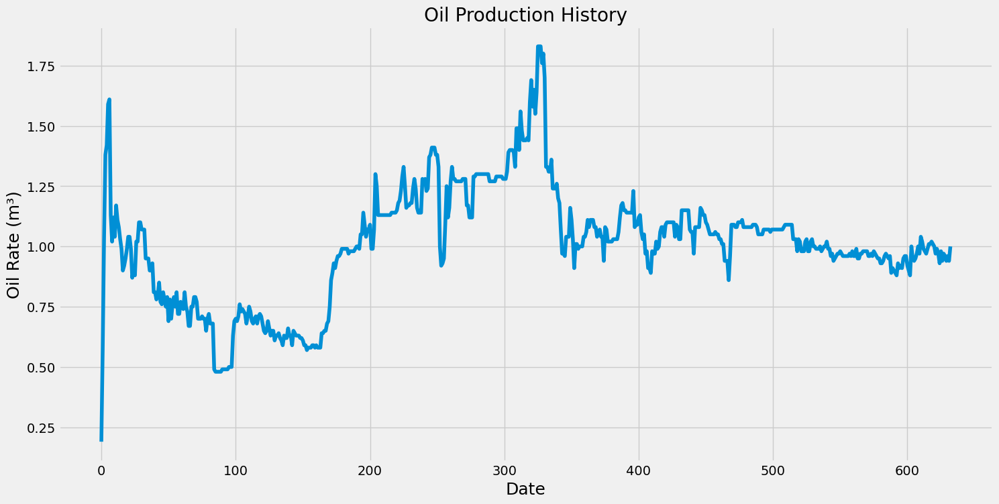

In [5]:
plt.figure(figsize=(16,8))
plt.title('Oil Production History')
plt.plot(df['oil'])
plt.xlabel('Date',fontsize=18)
plt.ylabel('Oil Rate (m³)',fontsize=18)
plt.show()

In [6]:
#Create a new dataframe with only the 'Close' column
data = df.filter(['oil'])
#Converting the dataframe to a numpy array
dataset = data.values
#Get /Compute the number of rows to train the model on
training_data_len = math.ceil( len(dataset) *.8) 

In [7]:
#Scale the all of the data to be values between 0 and 1 
scaler = MinMaxScaler(feature_range=(0, 1)) 
scaled_data = scaler.fit_transform(dataset)

In [8]:
#Create the scaled training data set 
train_data = scaled_data[0:training_data_len  , : ]
#Split the data into x_train and y_train data sets
x_train = []
y_train = []
for i in range(100,len(train_data)):
    x_train.append(train_data[i-100:i,0])
    y_train.append(train_data[i,0])

In [9]:
#Convert x_train and y_train to numpy arrays
x_train, y_train = np.array(x_train), np.array(y_train)

In [10]:
#Reshape the data into the shape accepted by the LSTM
x_train = np.reshape(x_train, (x_train.shape[0],x_train.shape[1],1))

In [11]:
print(x_train.shape)

(407, 100, 1)


In [12]:
'''
dim_learning_rate = Real(low=1e-4, high=1e-3, prior='log-uniform',
                         name='learning_rate')
dim_batch_size = Integer(low=16, high=32, name='batch_size')
dim_adam_decay = Real(low=1e-2,high=1e-1,name="decay")
dimensions = [dim_learning_rate,
              dim_batch_size,
              dim_decay,
             ]
default_parameters = [0.001, 15, 0.08]
'''

'\ndim_learning_rate = Real(low=1e-4, high=1e-3, prior=\'log-uniform\',\n                         name=\'learning_rate\')\ndim_batch_size = Integer(low=16, high=32, name=\'batch_size\')\ndim_adam_decay = Real(low=1e-2,high=1e-1,name="decay")\ndimensions = [dim_learning_rate,\n              dim_batch_size,\n              dim_decay,\n             ]\ndefault_parameters = [0.001, 15, 0.08]\n'

In [13]:
#Build the LSTM network model
#to have two LSTM layers with 50 neurons and two Dense layers, one with 25 neurons and the other with 1 neuron.
def LSTM_model(learning_rate,decay):
    model = Sequential()
    model.add(keras.layers.LSTM(64, input_shape = (x_train.shape[1], 1),kernel_regularizer= 'l2',  return_sequences=True))
    
    model.add(keras.layers.Dense(32,activation='selu'))
    model.add(keras.layers.Dense(1,activation='linear'))
    optimizer = keras.optimizers.Adam(learning_rate = 0.0007,decay = 0.9242461402242185)
    model.compile(loss = 'mse', optimizer = optimizer, metrics=['accuracy'])
    model.summary()
    return model

In [14]:
def fitness(x):
    
    batch_size = x
    
    model = LSTM_model(learning_rate=0.0007,
                       decay = 0.9242461402242185
                       )
    

    #named blackbox becuase it represents the structure
    blackbox = model.fit(x=x_train,
                        y=y_train,
                        epochs=50,
                        batch_size= batch_size,
                        validation_split=0.25,
                        )
    #return the validation accuracy for the last epoch.
    accuracy = blackbox.history['val_loss'][-1]

    # Print the classification accuracy.
    print()
    print("loss: {0:.2%}".format(accuracy))
    print()
    
    plt.plot(blackbox.history['loss'], label='train')
    plt.plot(blackbox.history['val_loss'], label='test')
    plt.legend()
    plt.show()
    # Delete the Keras model with these hyper-parameters from memory.
    del model
    
    # Clear the Keras session, otherwise it will keep adding new
    # models to the same TensorFlow graph each time we create
    # a model with a different set of hyper-parameters.
    K.clear_session()
    tf.compat.v1.reset_default_graph()
    
    # the optimizer aims for the lowest score, so we return our negative accuracy
    return accuracy

0.1
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 100, 64)           16896     
                                                                 
 dense_2 (Dense)             (None, 100, 32)           2080      
                                                                 
 dense_3 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 8s 559ms/step - loss: 0.3343 - accuracy: 0.0000e+00 - val_loss: 0.2281 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 229ms/step - loss: 0.2469 - accuracy: 0.0000e+00 - val_loss: 0.1901 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8

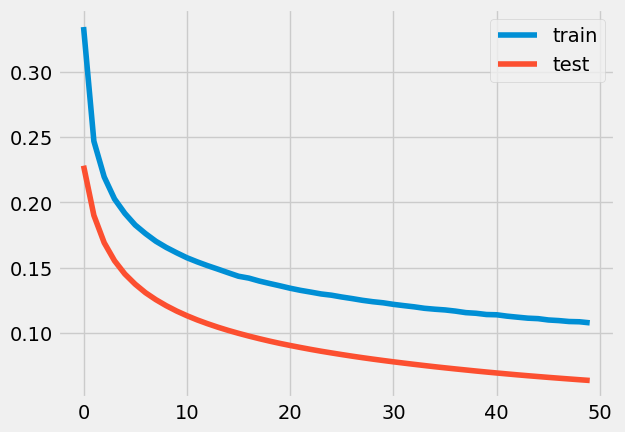

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 6s 301ms/step - loss: 0.1842 - accuracy: 0.0000e+00 - val_loss: 0.0875 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 2s 191ms/step - loss: 0.1260 - accuracy: 1.2079e-05 - val_loss: 0.0661 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====

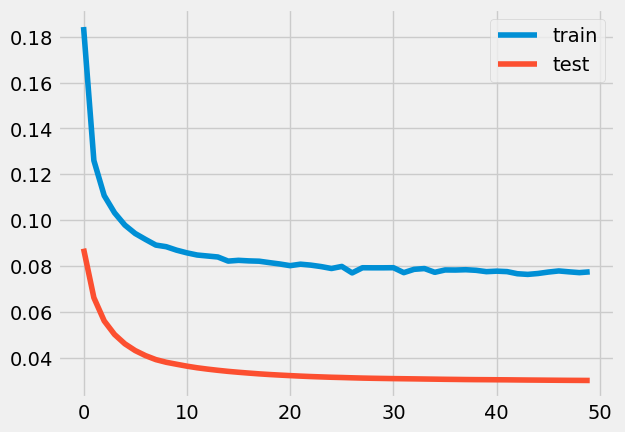

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 6s 302ms/step - loss: 0.3150 - accuracy: 0.0000e+00 - val_loss: 0.2116 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 2s 178ms/step - loss: 0.2312 - accuracy: 0.0000e+00 - val_loss: 0.1729 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====

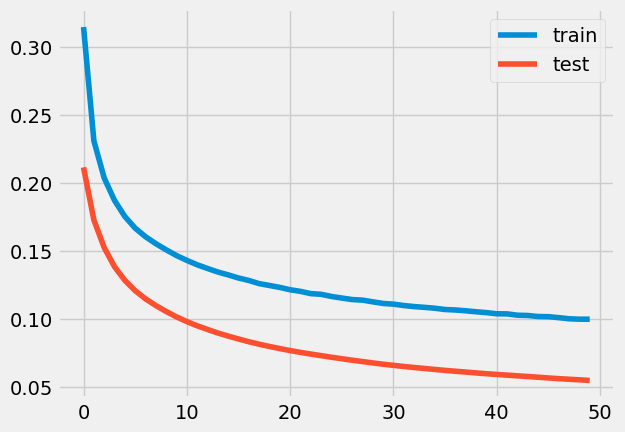

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 7s 485ms/step - loss: 0.2897 - accuracy: 0.0000e+00 - val_loss: 0.1985 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 214ms/step - loss: 0.2218 - accuracy: 0.0000e+00 - val_loss: 0.1654 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

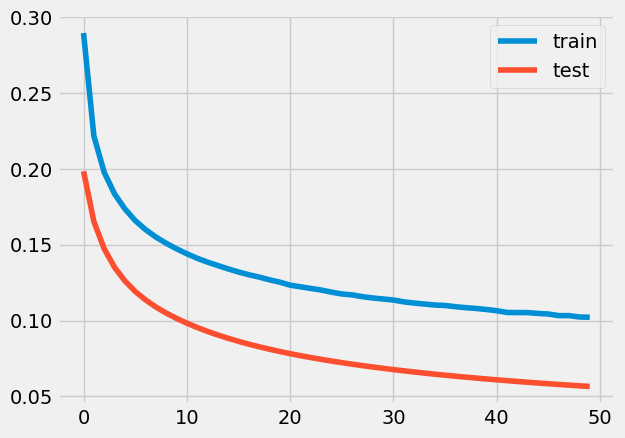

0.9815623302460428
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 6s 352ms/step - loss: 0.4099 - accuracy: 0.0000e+00 - val_loss: 0.2830 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 191ms/step - loss: 0.2857 - accuracy: 0.0000e+00 - val_loss: 0.2259 - val_accuracy: 0.0000e+00
E

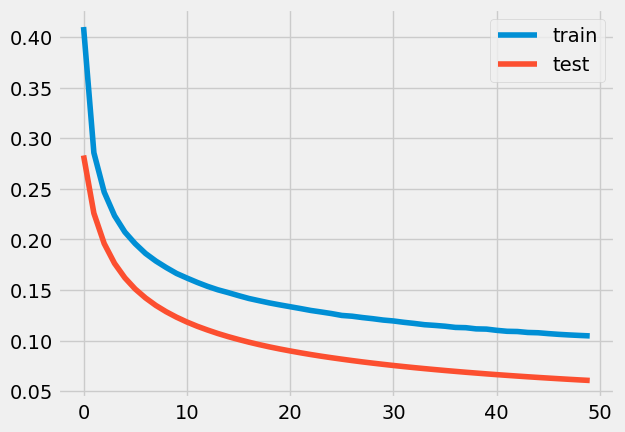

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 6s 293ms/step - loss: 0.3173 - accuracy: 0.0000e+00 - val_loss: 0.2120 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 2s 184ms/step - loss: 0.2306 - accuracy: 0.0000e+00 - val_loss: 0.1716 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====

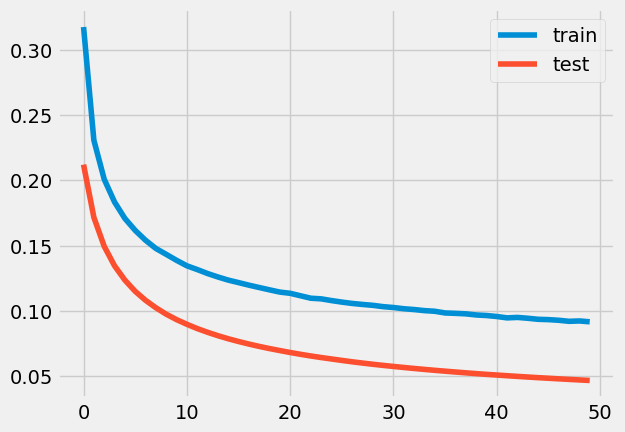

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 8s 347ms/step - loss: 0.1381 - accuracy: 2.8356e-05 - val_loss: 0.0536 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 2s 194ms/step - loss: 0.0980 - accuracy: 4.4750e-04 - val_loss: 0.0406 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====

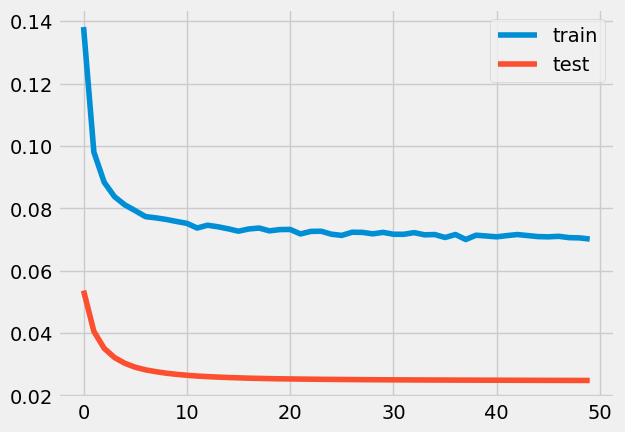

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 5s 191ms/step - loss: 0.1355 - accuracy: 2.4342e-04 - val_loss: 0.0531 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 109ms/step - loss: 0.0980 - accuracy: 6.1401e-04 - val_loss: 0.0402 - val_accuracy: 0.0000e+00
Epoch 3/50
10/10

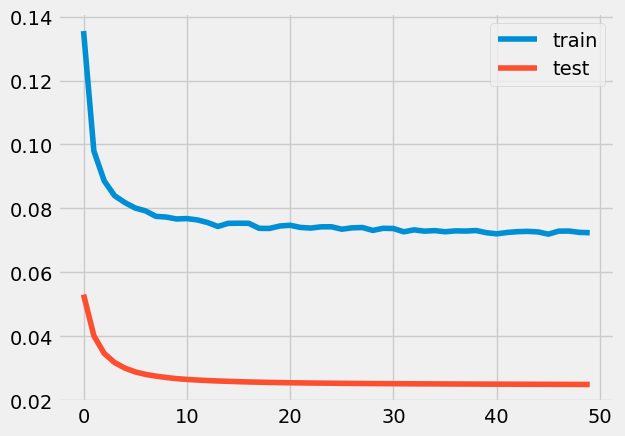

0.9987401374306002
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 6s 208ms/step - loss: 0.1310 - accuracy: 5.7625e-05 - val_loss: 0.0539 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 106ms/step - loss: 0.1000 - accuracy: 6.0308e-04 - val_loss: 0.0425 - val_accuracy: 0.0000e+

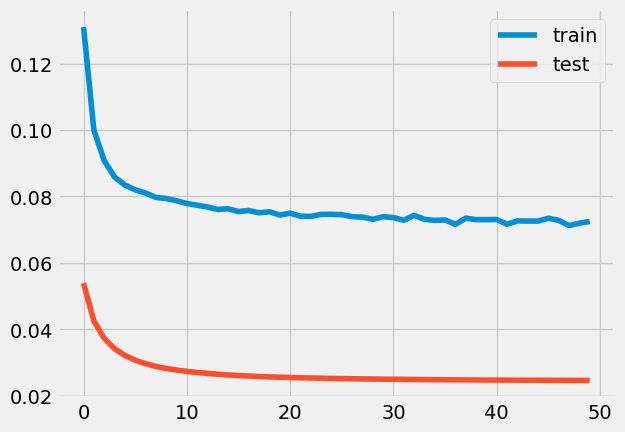

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 6s 221ms/step - loss: 0.2547 - accuracy: 0.0000e+00 - val_loss: 0.1551 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 109ms/step - loss: 0.1819 - accuracy: 0.0000e+00 - val_loss: 0.1233 - val_accuracy: 0.0000e+00
Epoch 3/50
10/10

10/10 [==============================] - 1s 113ms/step - loss: 0.0848 - accuracy: 0.0011 - val_loss: 0.0382 - val_accuracy: 0.0000e+00

loss: 3.82%



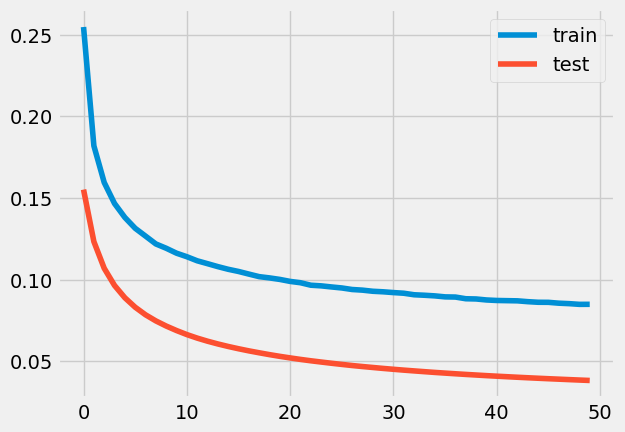

0.8730557744157516
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 6s 214ms/step - loss: 0.1581 - accuracy: 0.0000e+00 - val_loss: 0.0694 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 107ms/step - loss: 0.1108 - accuracy: 1.1823e-04 - val_loss: 0.0515 - val_accuracy: 0.0000e+

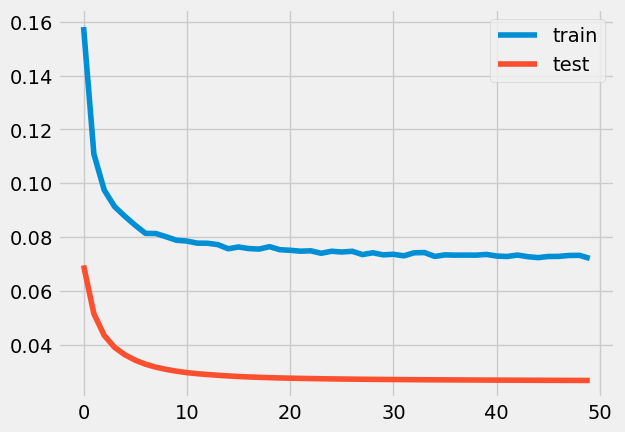

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 7s 288ms/step - loss: 0.2298 - accuracy: 0.0000e+00 - val_loss: 0.1217 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 143ms/step - loss: 0.1516 - accuracy: 0.0000e+00 - val_loss: 0.0914 - val_accuracy: 0.0000e+00
Epoch 3/50
10/10


loss: 2.98%



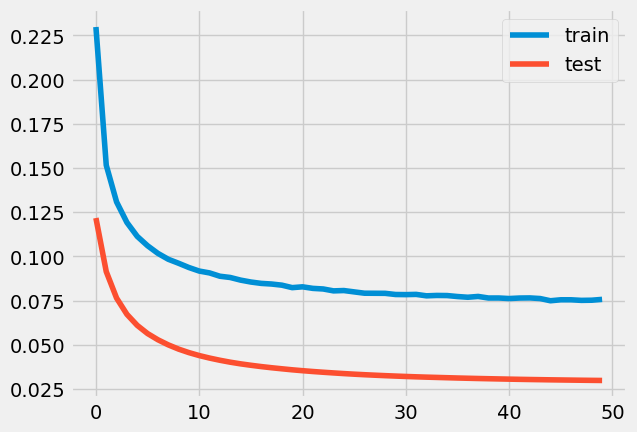

0.9690024242782498
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 6s 235ms/step - loss: 0.1875 - accuracy: 0.0000e+00 - val_loss: 0.0897 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 123ms/step - loss: 0.1262 - accuracy: 0.0000e+00 - val_loss: 0.0659 - val_accuracy: 0.0000e+


loss: 2.93%



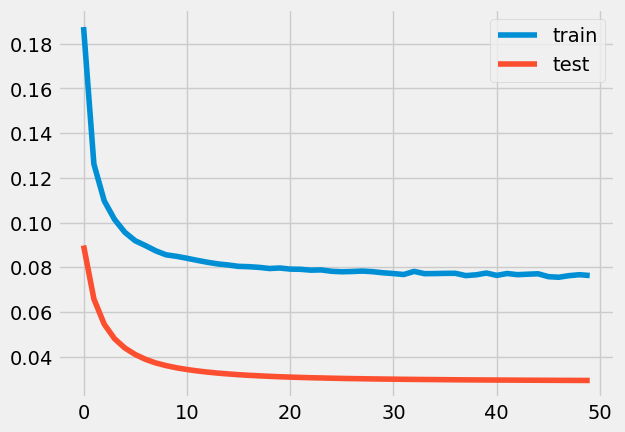

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 6s 305ms/step - loss: 0.3992 - accuracy: 0.0000e+00 - val_loss: 0.2876 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 2s 253ms/step - loss: 0.2963 - accuracy: 0.0000e+00 - val_loss: 0.2412 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====

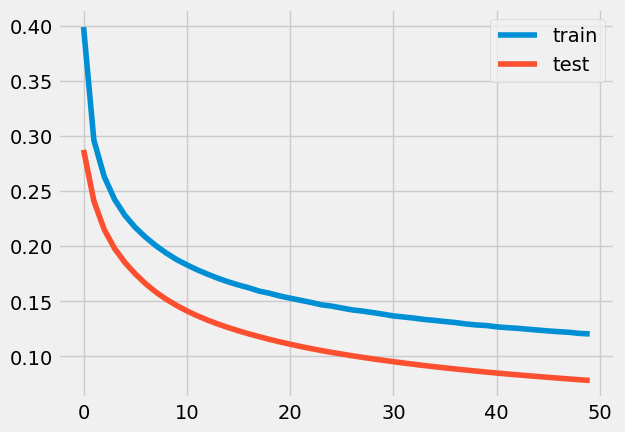

0.6139908329031193
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 6s 232ms/step - loss: 0.2307 - accuracy: 0.0000e+00 - val_loss: 0.1297 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 128ms/step - loss: 0.1584 - accuracy: 0.0000e+00 - val_loss: 0.1005 - val_accuracy: 0.0000e+

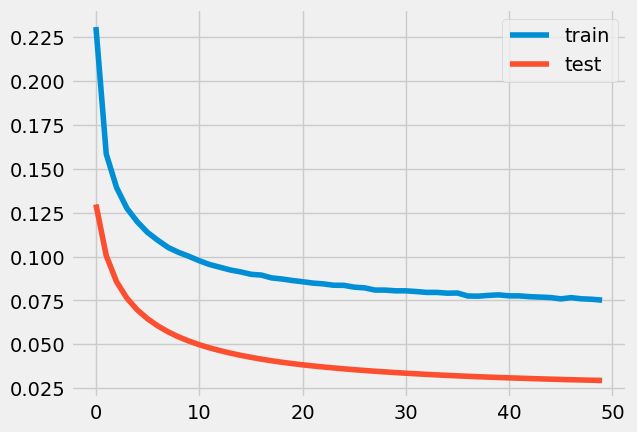

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 5s 223ms/step - loss: 0.5228 - accuracy: 0.0000e+00 - val_loss: 0.4100 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 111ms/step - loss: 0.4005 - accuracy: 0.0000e+00 - val_loss: 0.3525 - val_accuracy: 0.0000e+00
Epoch 3/50
10/10

Epoch 50/50
10/10 [==============================] - 1s 107ms/step - loss: 0.1862 - accuracy: 0.0000e+00 - val_loss: 0.1491 - val_accuracy: 0.0000e+00

loss: 14.91%



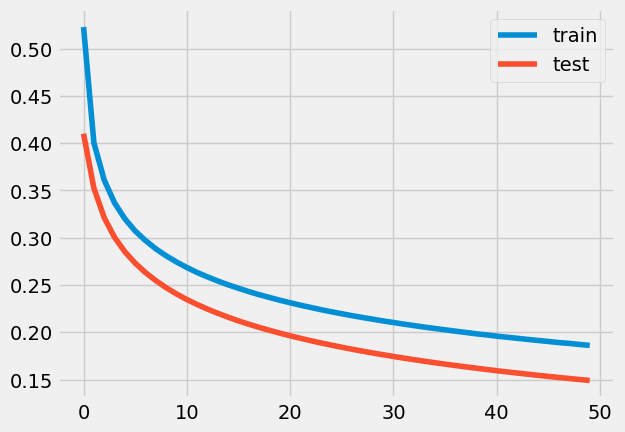

0.3022482773065416
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 5s 186ms/step - loss: 0.2291 - accuracy: 0.0000e+00 - val_loss: 0.1186 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 92ms/step - loss: 0.1472 - accuracy: 0.0000e+00 - val_loss: 0.0862 - val_accuracy: 0.0000e+0

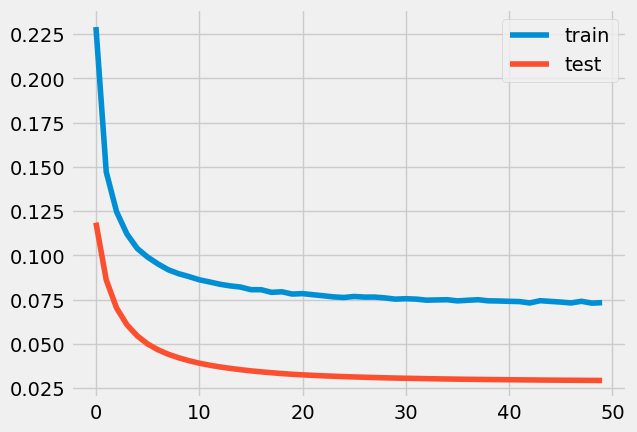

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 5s 194ms/step - loss: 0.2259 - accuracy: 0.0000e+00 - val_loss: 0.1225 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 1s 101ms/step - loss: 0.1536 - accuracy: 0.0000e+00 - val_loss: 0.0929 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====

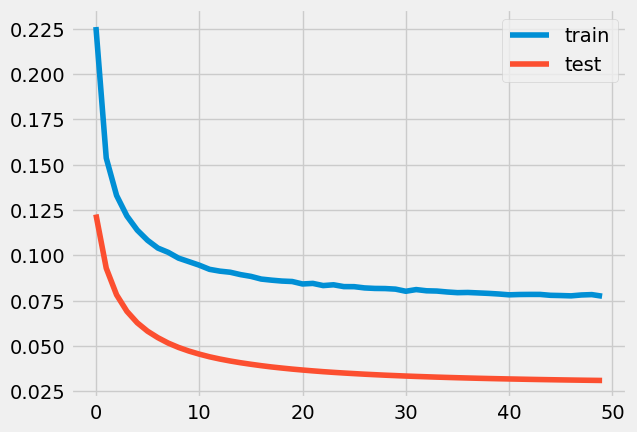

0.9840104765609796
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 5s 197ms/step - loss: 0.1977 - accuracy: 0.0000e+00 - val_loss: 0.0975 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 1s 96ms/step - loss: 0.1318 - accuracy: 0.0000e+00 - val_loss: 0.0717 - val_accuracy: 0.0000e+00
Ep

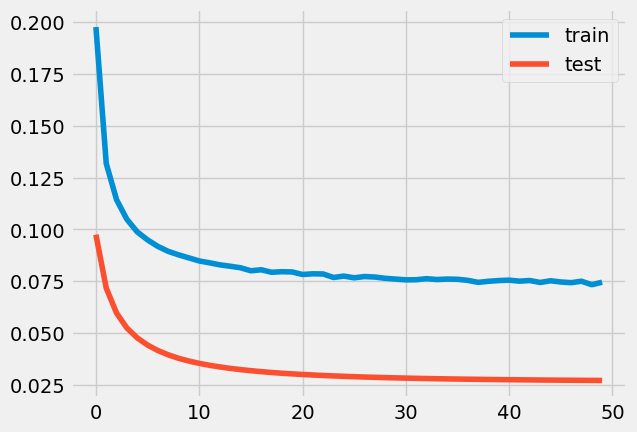

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 6s 316ms/step - loss: 0.3038 - accuracy: 0.0000e+00 - val_loss: 0.1974 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 1s 177ms/step - loss: 0.2182 - accuracy: 0.0000e+00 - val_loss: 0.1606 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

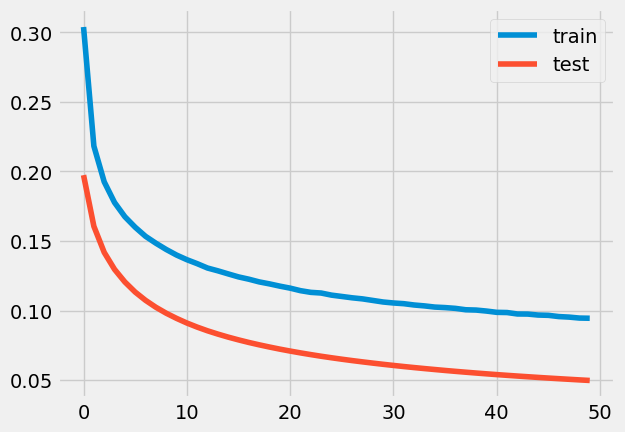

0.7978692673325887
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 8s 430ms/step - loss: 0.1146 - accuracy: 4.8256e-04 - val_loss: 0.0370 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 304ms/step - loss: 0.0844 - accuracy: 0.0035 - val_loss: 0.0298 - val_accuracy: 0.0000e+00
Epoch

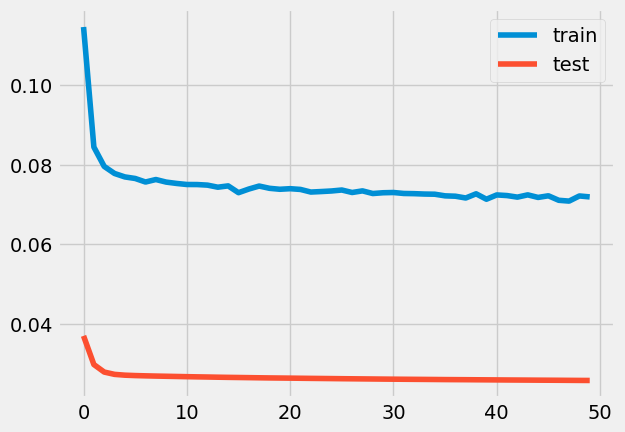

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 7s 374ms/step - loss: 0.3510 - accuracy: 0.0000e+00 - val_loss: 0.2424 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 225ms/step - loss: 0.2559 - accuracy: 0.0000e+00 - val_loss: 0.1975 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

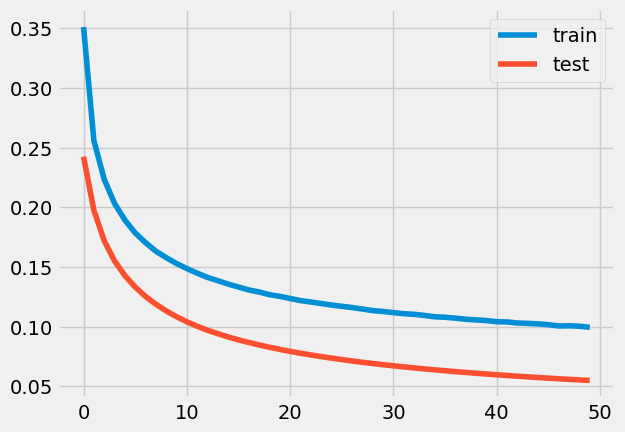

0.7473569041367071
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 7s 452ms/step - loss: 0.2909 - accuracy: 0.0000e+00 - val_loss: 0.1719 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 248ms/step - loss: 0.1931 - accuracy: 0.0000e+00 - val_loss: 0.1307 - val_accuracy: 0.0000e+00
E

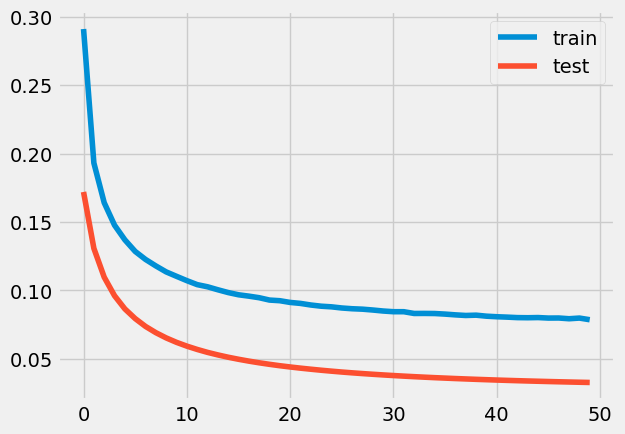

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 6s 329ms/step - loss: 0.1117 - accuracy: 0.0011 - val_loss: 0.0342 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 192ms/step - loss: 0.0848 - accuracy: 0.0034 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [============

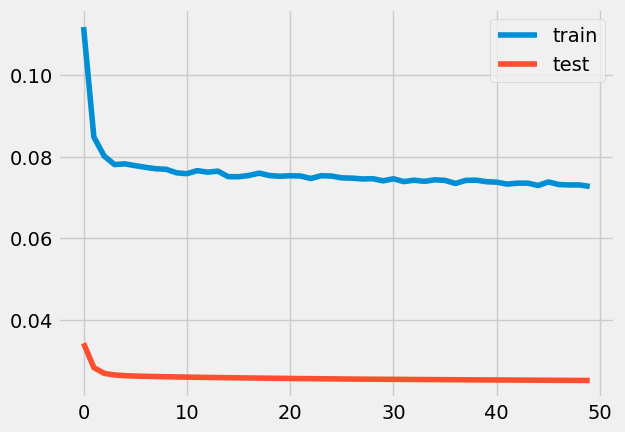

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 7s 416ms/step - loss: 0.3279 - accuracy: 0.0000e+00 - val_loss: 0.2147 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 200ms/step - loss: 0.2335 - accuracy: 0.0000e+00 - val_loss: 0.1734 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

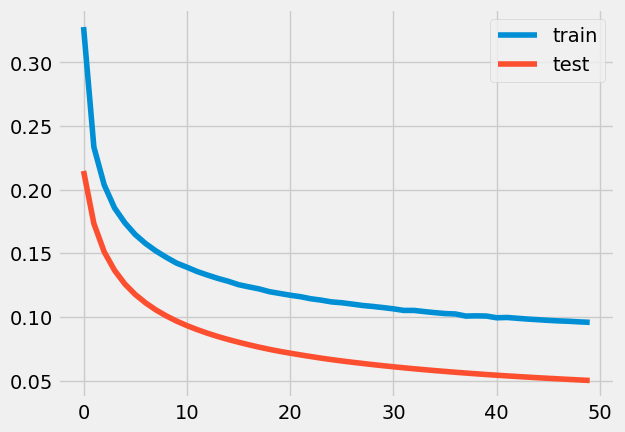

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
7/7 [==============================] - 7s 430ms/step - loss: 0.2445 - accuracy: 0.0000e+00 - val_loss: 0.1442 - val_accuracy: 0.0000e+00
Epoch 2/50
7/7 [==============================] - 1s 193ms/step - loss: 0.1725 - accuracy: 0.0000e+00 - val_loss: 0.1135 - val_accuracy: 0.0000e+00
Epoch 3/50
7/7 [====

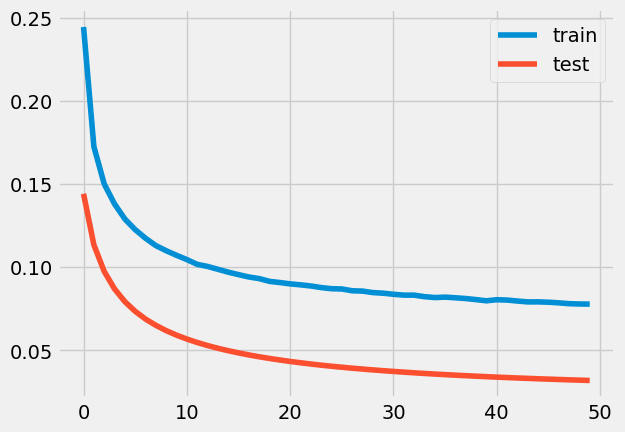

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
7/7 [==============================] - 6s 392ms/step - loss: 0.2714 - accuracy: 0.0000e+00 - val_loss: 0.1737 - val_accuracy: 0.0000e+00
Epoch 2/50
7/7 [==============================] - 1s 211ms/step - loss: 0.2004 - accuracy: 0.0000e+00 - val_loss: 0.1421 - val_accuracy: 0.0000e+00
Epoch 3/50
7/7 [====

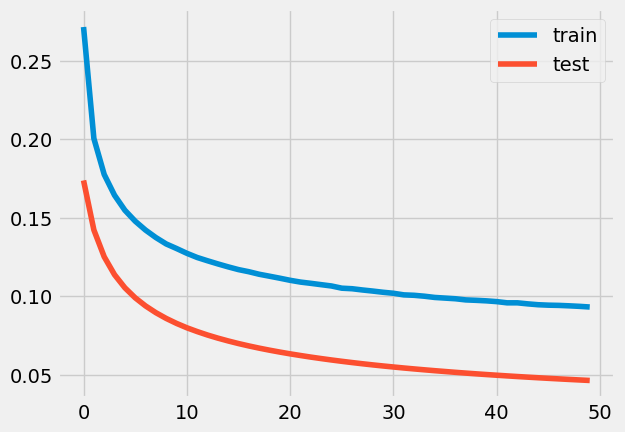

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 6s 342ms/step - loss: 0.4185 - accuracy: 0.0000e+00 - val_loss: 0.2934 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 204ms/step - loss: 0.2977 - accuracy: 0.0000e+00 - val_loss: 0.2351 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

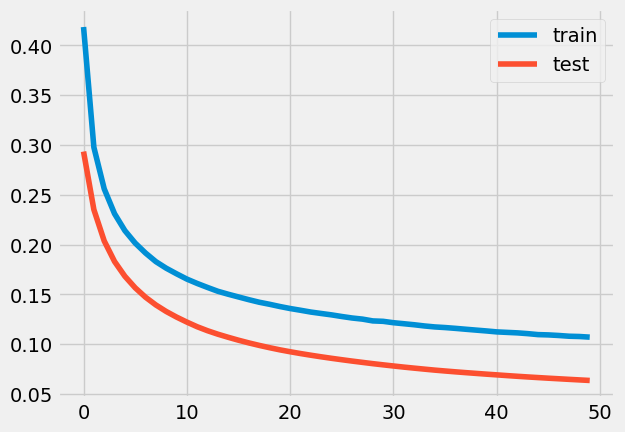

0.8415054842059368
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 6s 356ms/step - loss: 0.2712 - accuracy: 0.0000e+00 - val_loss: 0.1681 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 221ms/step - loss: 0.1964 - accuracy: 0.0000e+00 - val_loss: 0.1364 - val_accuracy: 0.0000e+00
E


loss: 4.03%



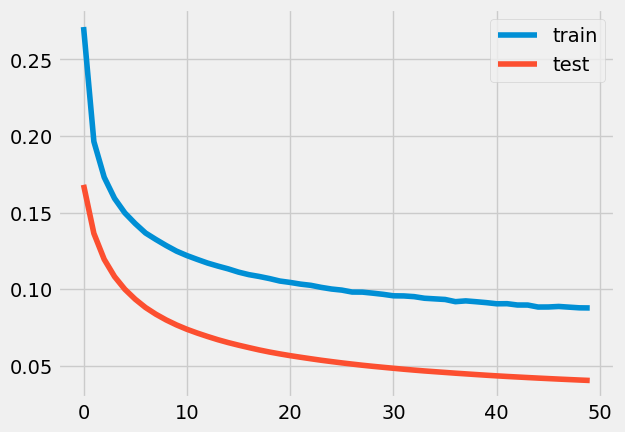

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 7s 345ms/step - loss: 0.1762 - accuracy: 0.0000e+00 - val_loss: 0.0928 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 190ms/step - loss: 0.1332 - accuracy: 0.0000e+00 - val_loss: 0.0741 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

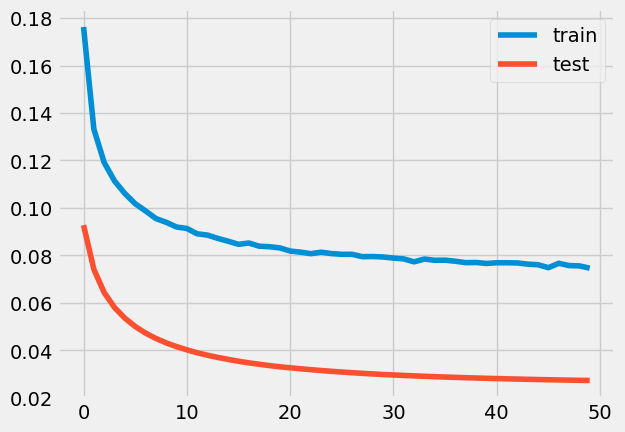

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 6s 344ms/step - loss: 0.1984 - accuracy: 0.0000e+00 - val_loss: 0.0970 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 203ms/step - loss: 0.1333 - accuracy: 0.0000e+00 - val_loss: 0.0720 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

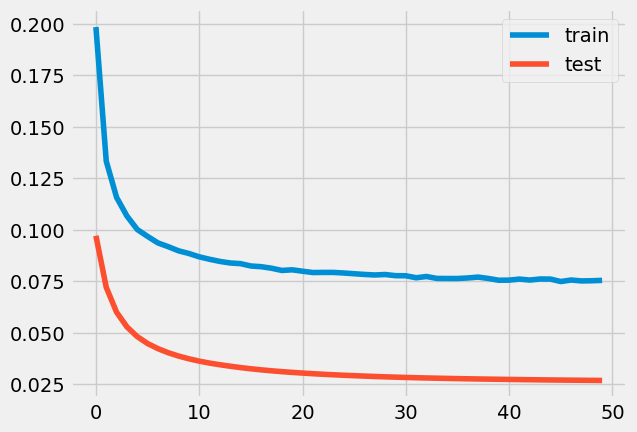

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 6s 336ms/step - loss: 0.2142 - accuracy: 0.0000e+00 - val_loss: 0.1225 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 196ms/step - loss: 0.1571 - accuracy: 0.0000e+00 - val_loss: 0.0993 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

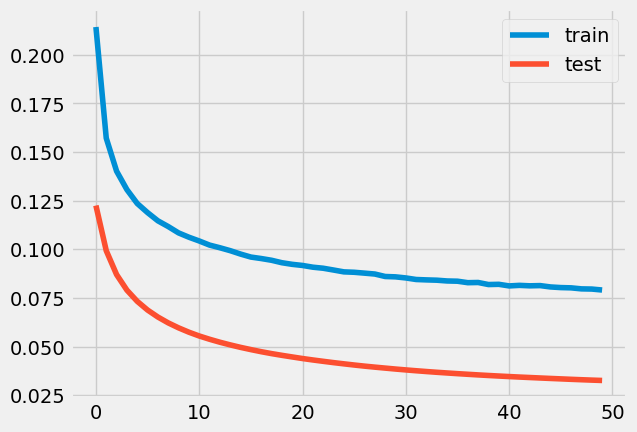

0.9427439846966013
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 6s 322ms/step - loss: 0.3032 - accuracy: 0.0000e+00 - val_loss: 0.2039 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 211ms/step - loss: 0.2273 - accuracy: 0.0000e+00 - val_loss: 0.1695 - val_accuracy: 0.0000e+00
E

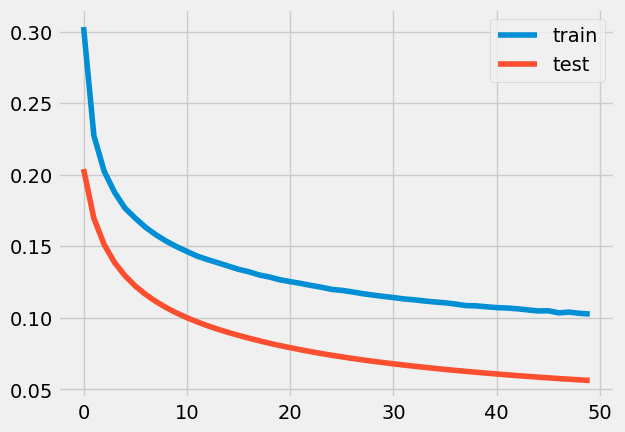

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 6s 339ms/step - loss: 0.2261 - accuracy: 0.0000e+00 - val_loss: 0.1357 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 212ms/step - loss: 0.1704 - accuracy: 0.0000e+00 - val_loss: 0.1127 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====


loss: 3.73%



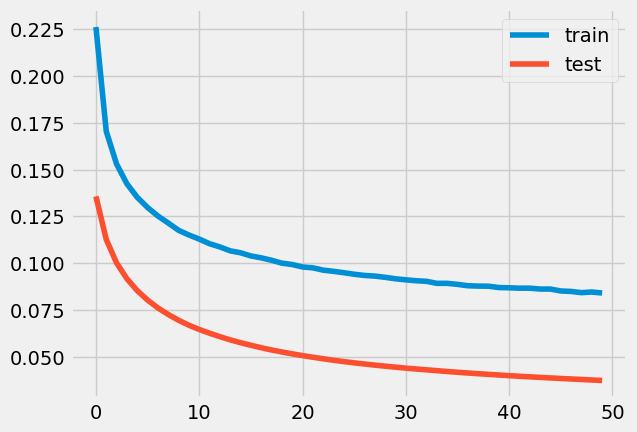

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 9s 539ms/step - loss: 0.2686 - accuracy: 0.0000e+00 - val_loss: 0.1692 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 228ms/step - loss: 0.1974 - accuracy: 0.0000e+00 - val_loss: 0.1373 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

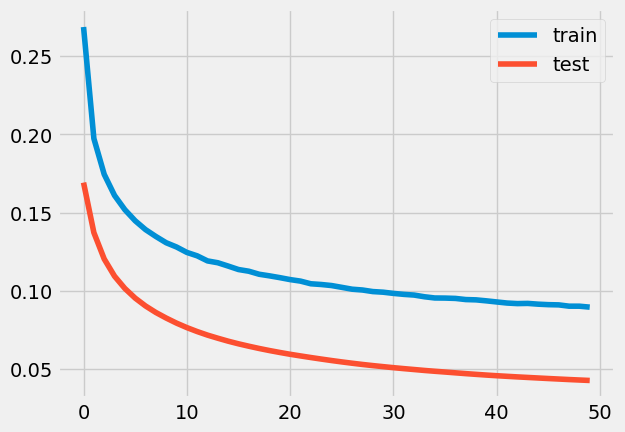

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 8s 393ms/step - loss: 0.1742 - accuracy: 0.0000e+00 - val_loss: 0.0830 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 215ms/step - loss: 0.1235 - accuracy: 0.0000e+00 - val_loss: 0.0628 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

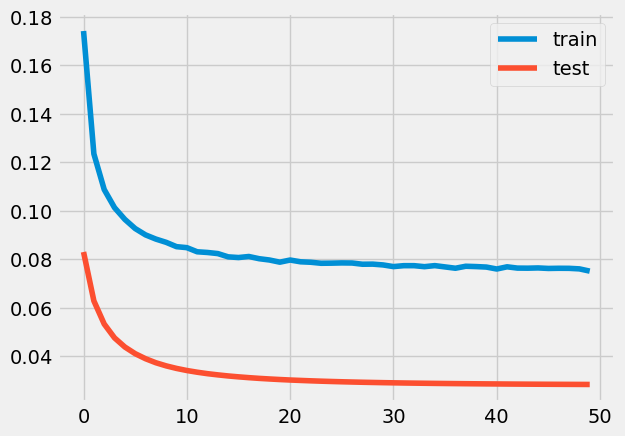

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
8/8 [==============================] - 7s 402ms/step - loss: 0.1747 - accuracy: 0.0000e+00 - val_loss: 0.0822 - val_accuracy: 0.0000e+00
Epoch 2/50
8/8 [==============================] - 2s 209ms/step - loss: 0.1198 - accuracy: 8.1967e-06 - val_loss: 0.0602 - val_accuracy: 0.0000e+00
Epoch 3/50
8/8 [====

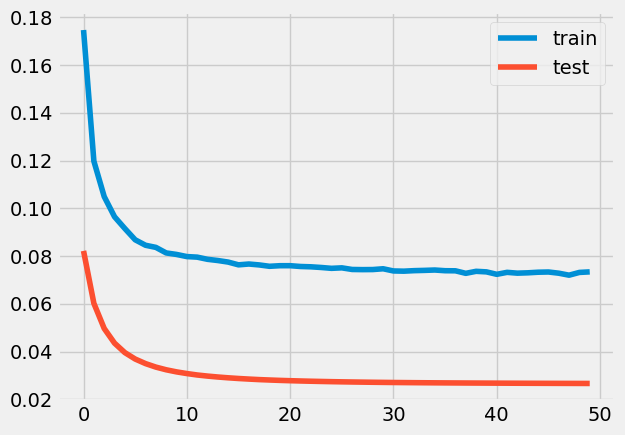

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 7s 256ms/step - loss: 0.3813 - accuracy: 0.0000e+00 - val_loss: 0.2708 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 1s 123ms/step - loss: 0.2802 - accuracy: 0.0000e+00 - val_loss: 0.2240 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====

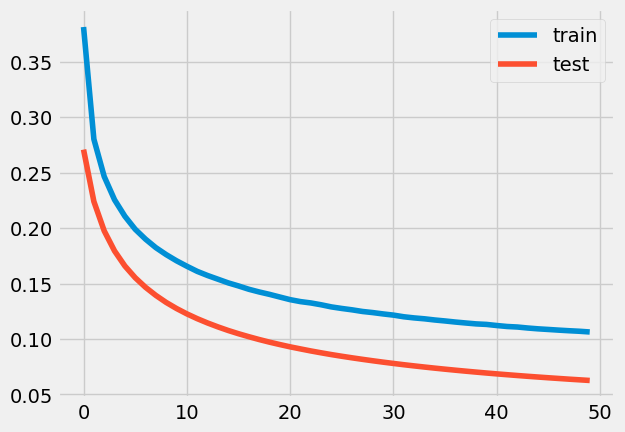

0.697549995659403
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 5s 235ms/step - loss: 0.1619 - accuracy: 0.0000e+00 - val_loss: 0.0739 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 1s 123ms/step - loss: 0.1145 - accuracy: 2.3953e-04 - val_loss: 0.0552 - val_accuracy: 0.0000e+00
Ep

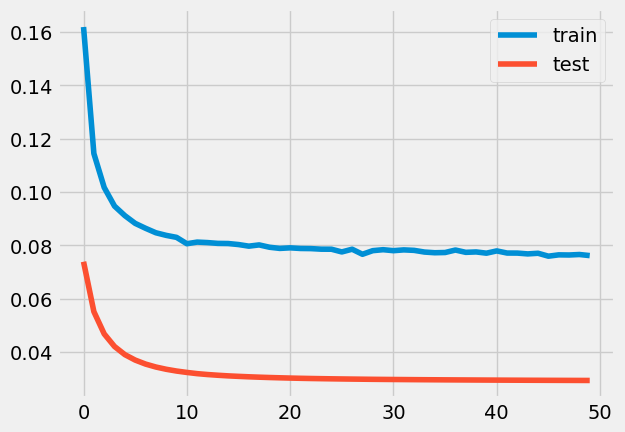

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 7s 366ms/step - loss: 0.1799 - accuracy: 0.0000e+00 - val_loss: 0.0787 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 2s 195ms/step - loss: 0.1157 - accuracy: 3.1901e-05 - val_loss: 0.0551 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====

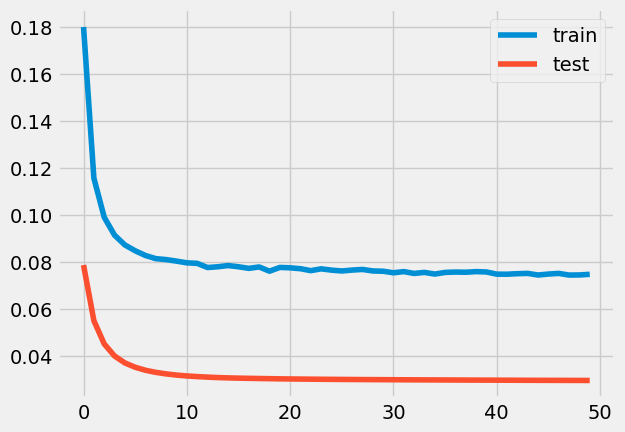

0.9967701478827521
0.05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 7s 321ms/step - loss: 0.2353 - accuracy: 0.0000e+00 - val_loss: 0.1477 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 2s 209ms/step - loss: 0.1808 - accuracy: 0.0000e+00 - val_loss: 0.1239 - val_accuracy: 0.0000e

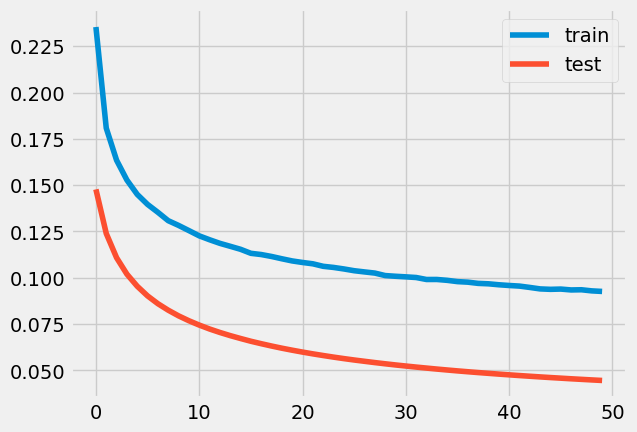

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 6s 219ms/step - loss: 0.2791 - accuracy: 0.0000e+00 - val_loss: 0.1829 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 1s 108ms/step - loss: 0.2072 - accuracy: 0.0000e+00 - val_loss: 0.1500 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====

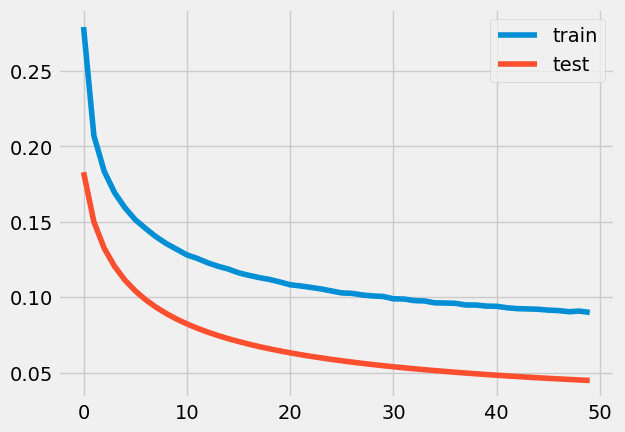

0.9943486705447673
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 5s 234ms/step - loss: 0.1198 - accuracy: 6.8852e-04 - val_loss: 0.0372 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 1s 120ms/step - loss: 0.0843 - accuracy: 0.0041 - val_loss: 0.0296 - val_accuracy: 0.0000e+00
Epoch

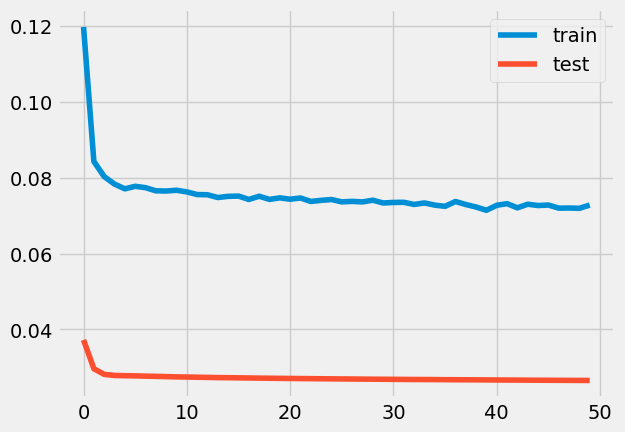

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 5s 248ms/step - loss: 0.2520 - accuracy: 0.0000e+00 - val_loss: 0.1581 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 1s 123ms/step - loss: 0.1855 - accuracy: 0.0000e+00 - val_loss: 0.1276 - val_accuracy: 0.0000e+00
Epoch 3/50
9/9 [====


loss: 3.79%



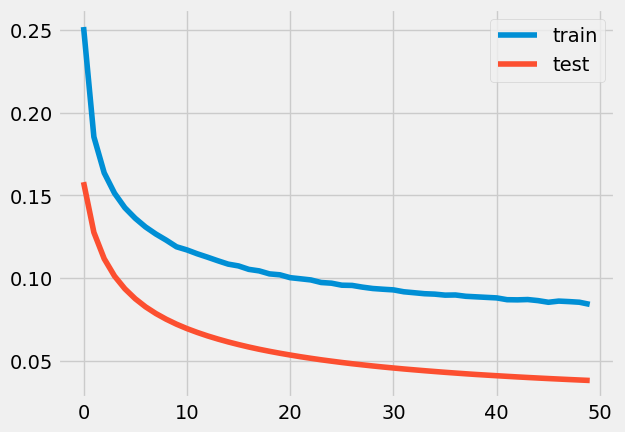

0.7959719926459851
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
9/9 [==============================] - 6s 231ms/step - loss: 0.2550 - accuracy: 0.0000e+00 - val_loss: 0.1600 - val_accuracy: 0.0000e+00
Epoch 2/50
9/9 [==============================] - 1s 123ms/step - loss: 0.1867 - accuracy: 0.0000e+00 - val_loss: 0.1277 - val_accuracy: 0.0000e+00
E

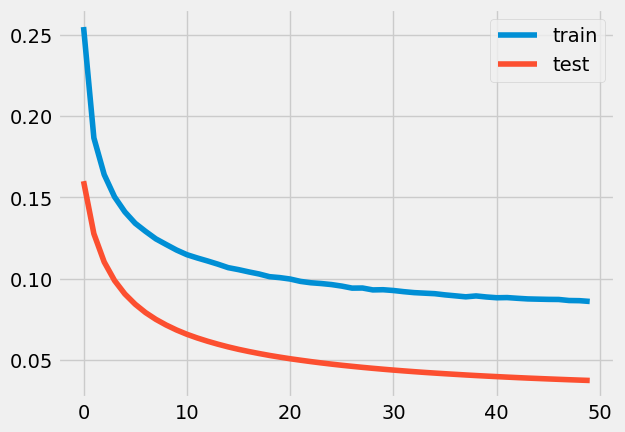

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 7s 237ms/step - loss: 0.1353 - accuracy: 0.0000e+00 - val_loss: 0.0509 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 1s 113ms/step - loss: 0.0952 - accuracy: 9.4287e-04 - val_loss: 0.0378 - val_accuracy: 0.0000e+00
Epoch 3/50
10/10

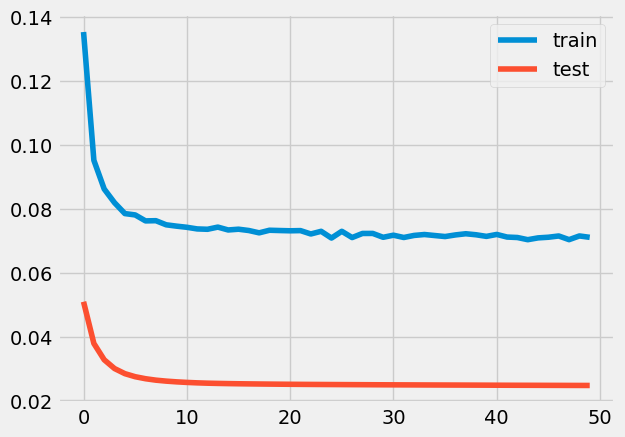

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
10/10 [==============================] - 6s 327ms/step - loss: 0.2263 - accuracy: 0.0000e+00 - val_loss: 0.1238 - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - 2s 160ms/step - loss: 0.1541 - accuracy: 0.0000e+00 - val_loss: 0.0944 - val_accuracy: 0.0000e+00
Epoch 3/50
10/10


loss: 3.23%



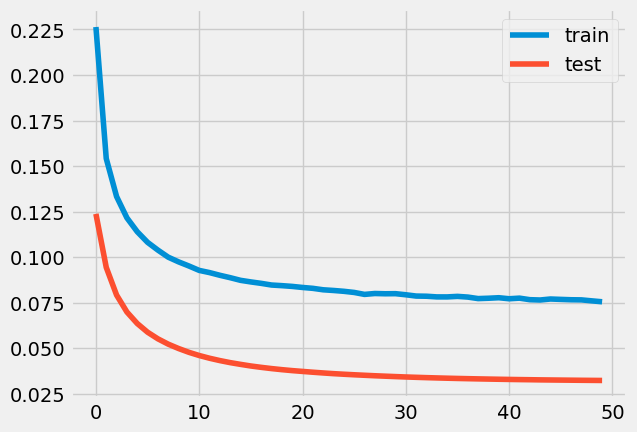

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
11/11 [==============================] - 5s 194ms/step - loss: 0.2016 - accuracy: 0.0000e+00 - val_loss: 0.1129 - val_accuracy: 0.0000e+00
Epoch 2/50
11/11 [==============================] - 1s 113ms/step - loss: 0.1459 - accuracy: 0.0000e+00 - val_loss: 0.0888 - val_accuracy: 0.0000e+00
Epoch 3/50
11/11


loss: 2.84%



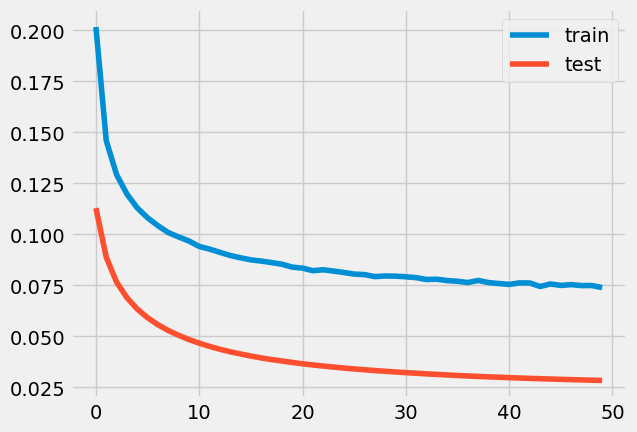

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
11/11 [==============================] - 5s 216ms/step - loss: 0.1913 - accuracy: 0.0000e+00 - val_loss: 0.1043 - val_accuracy: 0.0000e+00
Epoch 2/50
11/11 [==============================] - 1s 116ms/step - loss: 0.1408 - accuracy: 0.0000e+00 - val_loss: 0.0825 - val_accuracy: 0.0000e+00
Epoch 3/50
11/11


loss: 3.04%



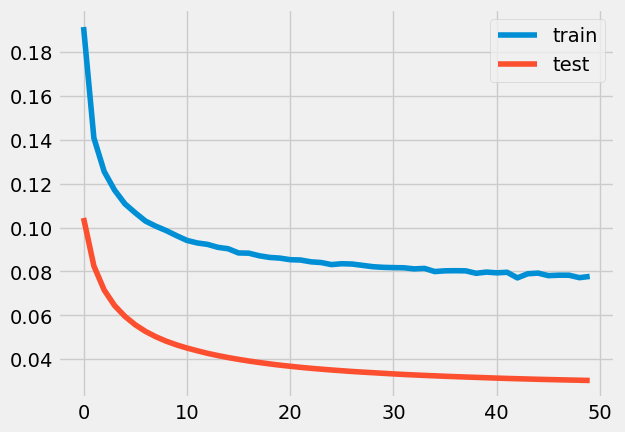

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
11/11 [==============================] - 6s 270ms/step - loss: 0.2744 - accuracy: 0.0000e+00 - val_loss: 0.1741 - val_accuracy: 0.0000e+00
Epoch 2/50
11/11 [==============================] - 1s 136ms/step - loss: 0.1963 - accuracy: 0.0000e+00 - val_loss: 0.1377 - val_accuracy: 0.0000e+00
Epoch 3/50
11/11

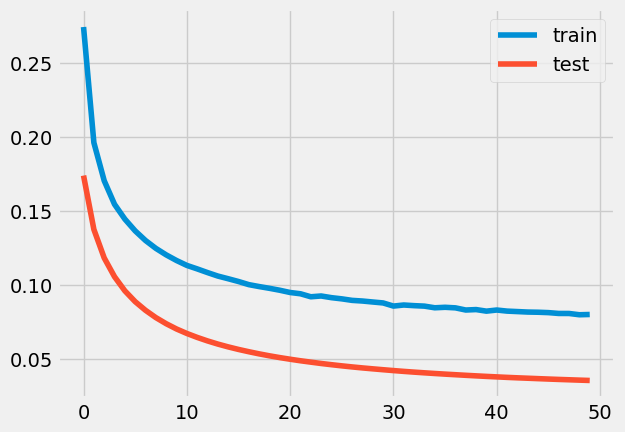

0.8998502046062433
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
11/11 [==============================] - 7s 215ms/step - loss: 0.2860 - accuracy: 0.0000e+00 - val_loss: 0.1871 - val_accuracy: 0.0000e+00
Epoch 2/50
11/11 [==============================] - 1s 109ms/step - loss: 0.2102 - accuracy: 0.0000e+00 - val_loss: 0.1531 - val_accuracy: 0.0000e+

Epoch 50/50
11/11 [==============================] - 1s 130ms/step - loss: 0.0910 - accuracy: 5.0537e-04 - val_loss: 0.0455 - val_accuracy: 0.0000e+00

loss: 4.55%



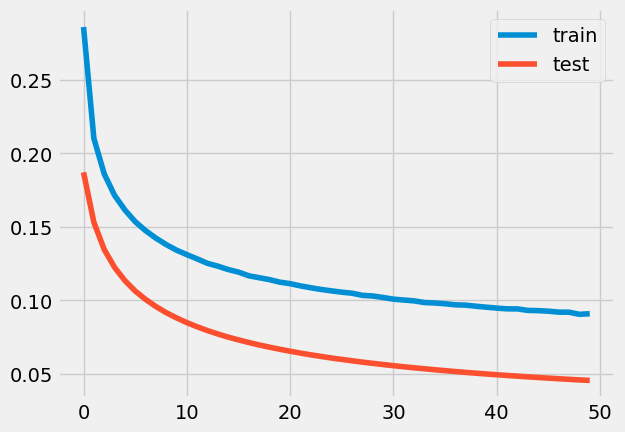

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
13/13 [==============================] - 8s 222ms/step - loss: 0.3788 - accuracy: 0.0000e+00 - val_loss: 0.2550 - val_accuracy: 0.0000e+00
Epoch 2/50
13/13 [==============================] - 2s 129ms/step - loss: 0.2608 - accuracy: 0.0000e+00 - val_loss: 0.2003 - val_accuracy: 0.0000e+00
Epoch 3/50
13/13

Epoch 50/50
13/13 [==============================] - 1s 100ms/step - loss: 0.0888 - accuracy: 7.8557e-04 - val_loss: 0.0458 - val_accuracy: 0.0000e+00

loss: 4.58%



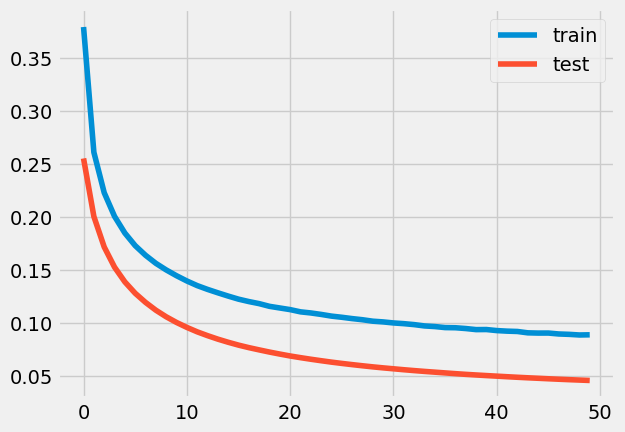

0.9949375222509396
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
13/13 [==============================] - 9s 253ms/step - loss: 0.2102 - accuracy: 0.0000e+00 - val_loss: 0.0976 - val_accuracy: 0.0000e+00
Epoch 2/50
13/13 [==============================] - 1s 114ms/step - loss: 0.1290 - accuracy: 0.0000e+00 - val_loss: 0.0689 - val_accuracy: 0.0000e+


loss: 2.78%



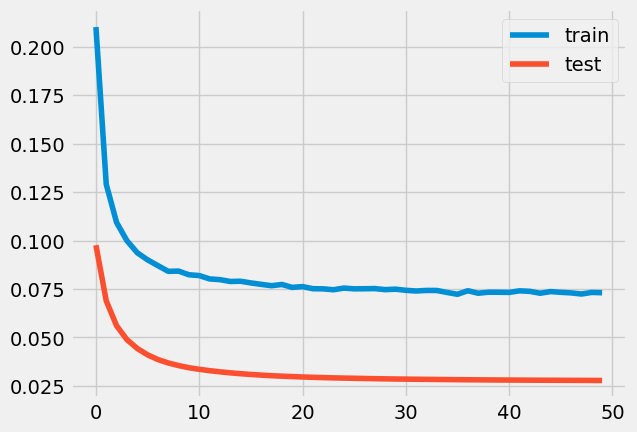

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 8s 246ms/step - loss: 0.2567 - accuracy: 0.0000e+00 - val_loss: 0.1706 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 122ms/step - loss: 0.1958 - accuracy: 0.0000e+00 - val_loss: 0.1407 - val_accuracy: 0.0000e+00
Epoch 3/50
14/14

Epoch 50/50
14/14 [==============================] - 2s 116ms/step - loss: 0.0935 - accuracy: 3.3979e-04 - val_loss: 0.0486 - val_accuracy: 0.0000e+00

loss: 4.86%



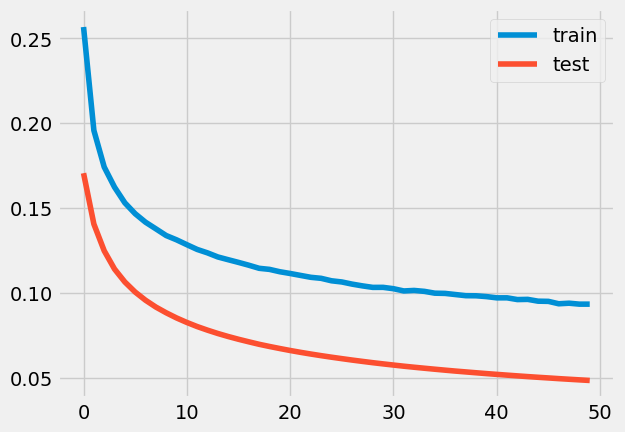

0.659539126009629
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 7s 212ms/step - loss: 0.3324 - accuracy: 0.0000e+00 - val_loss: 0.2405 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 111ms/step - loss: 0.2557 - accuracy: 0.0000e+00 - val_loss: 0.2011 - val_accuracy: 0.0000e+0

Epoch 50/50
14/14 [==============================] - 2s 118ms/step - loss: 0.1154 - accuracy: 0.0000e+00 - val_loss: 0.0702 - val_accuracy: 0.0000e+00

loss: 7.02%



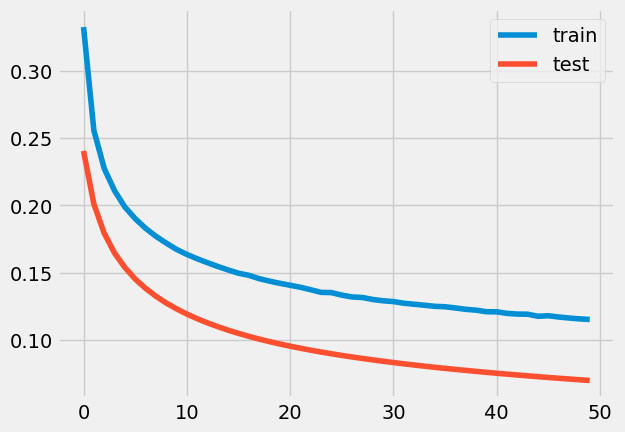

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
12/12 [==============================] - 7s 220ms/step - loss: 0.1744 - accuracy: 0.0000e+00 - val_loss: 0.0807 - val_accuracy: 0.0000e+00
Epoch 2/50
12/12 [==============================] - 1s 120ms/step - loss: 0.1162 - accuracy: 2.6482e-05 - val_loss: 0.0588 - val_accuracy: 0.0000e+00
Epoch 3/50
12/12

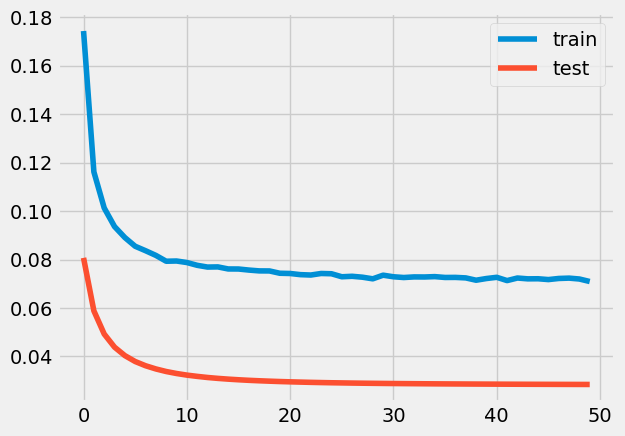

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
12/12 [==============================] - 5s 194ms/step - loss: 0.0975 - accuracy: 0.0023 - val_loss: 0.0301 - val_accuracy: 0.0000e+00
Epoch 2/50
12/12 [==============================] - 1s 109ms/step - loss: 0.0809 - accuracy: 0.0042 - val_loss: 0.0300 - val_accuracy: 0.0000e+00
Epoch 3/50
12/12 [======

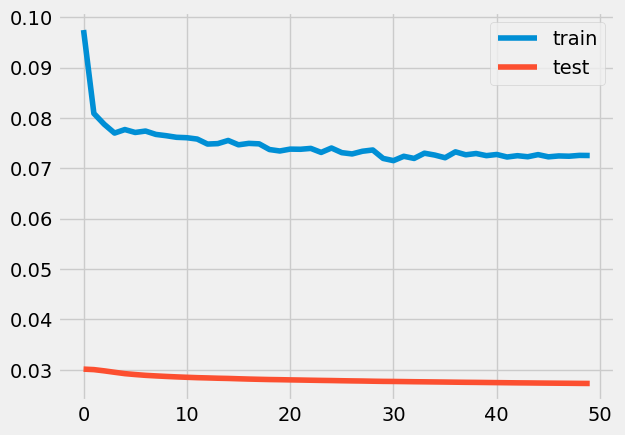

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
11/11 [==============================] - 7s 248ms/step - loss: 0.2175 - accuracy: 0.0000e+00 - val_loss: 0.1283 - val_accuracy: 0.0000e+00
Epoch 2/50
11/11 [==============================] - 1s 115ms/step - loss: 0.1608 - accuracy: 0.0000e+00 - val_loss: 0.1047 - val_accuracy: 0.0000e+00
Epoch 3/50
11/11

11/11 [==============================] - 2s 138ms/step - loss: 0.0857 - accuracy: 0.0013 - val_loss: 0.0393 - val_accuracy: 0.0000e+00

loss: 3.93%



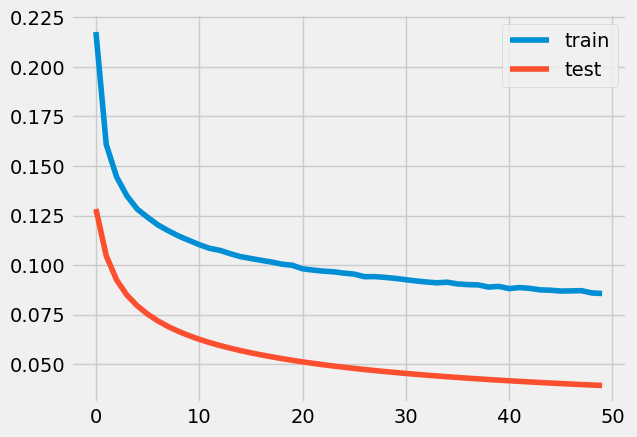

0.7863727786765133
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
11/11 [==============================] - 6s 203ms/step - loss: 0.2405 - accuracy: 0.0000e+00 - val_loss: 0.1371 - val_accuracy: 0.0000e+00
Epoch 2/50
11/11 [==============================] - 1s 109ms/step - loss: 0.1675 - accuracy: 0.0000e+00 - val_loss: 0.1090 - val_accuracy: 0.0000e+

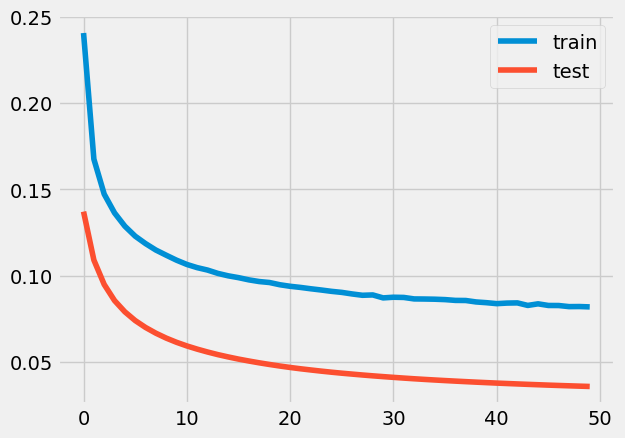

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
13/13 [==============================] - 7s 190ms/step - loss: 0.1815 - accuracy: 0.0000e+00 - val_loss: 0.0879 - val_accuracy: 0.0000e+00
Epoch 2/50
13/13 [==============================] - 1s 107ms/step - loss: 0.1256 - accuracy: 1.3115e-05 - val_loss: 0.0664 - val_accuracy: 0.0000e+00
Epoch 3/50
13/13

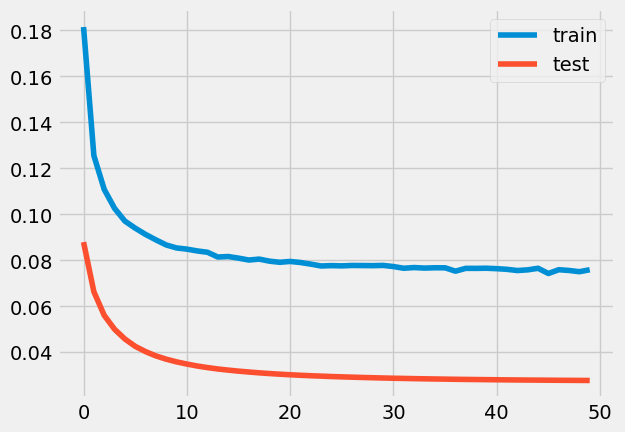

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
13/13 [==============================] - 9s 256ms/step - loss: 0.1900 - accuracy: 0.0000e+00 - val_loss: 0.0934 - val_accuracy: 0.0000e+00
Epoch 2/50
13/13 [==============================] - 2s 135ms/step - loss: 0.1278 - accuracy: 0.0000e+00 - val_loss: 0.0703 - val_accuracy: 0.0000e+00
Epoch 3/50
13/13

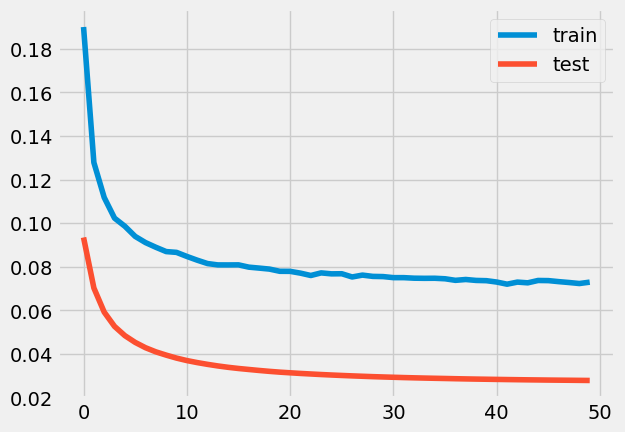

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
15/15 [==============================] - 7s 186ms/step - loss: 0.2513 - accuracy: 0.0000e+00 - val_loss: 0.1583 - val_accuracy: 0.0000e+00
Epoch 2/50
15/15 [==============================] - 2s 102ms/step - loss: 0.1836 - accuracy: 0.0000e+00 - val_loss: 0.1288 - val_accuracy: 0.0000e+00
Epoch 3/50
15/15

Epoch 50/50
15/15 [==============================] - 1s 91ms/step - loss: 0.0835 - accuracy: 5.5681e-04 - val_loss: 0.0403 - val_accuracy: 0.0000e+00

loss: 4.03%



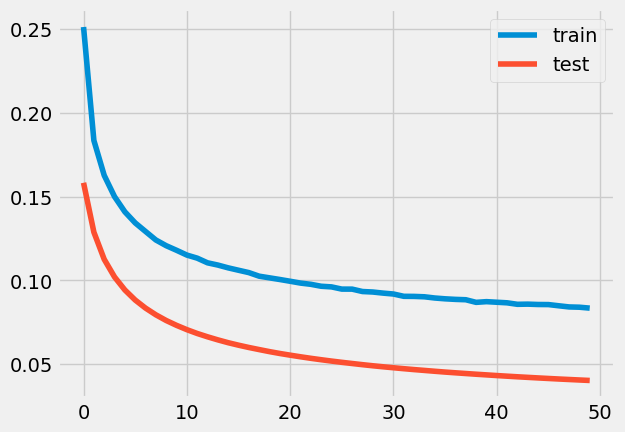

0.7798039702818268
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
15/15 [==============================] - 6s 159ms/step - loss: 0.1273 - accuracy: 4.9961e-04 - val_loss: 0.0427 - val_accuracy: 0.0000e+00
Epoch 2/50
15/15 [==============================] - 1s 97ms/step - loss: 0.0877 - accuracy: 0.0029 - val_loss: 0.0336 - val_accuracy: 0.0000e+00
Ep

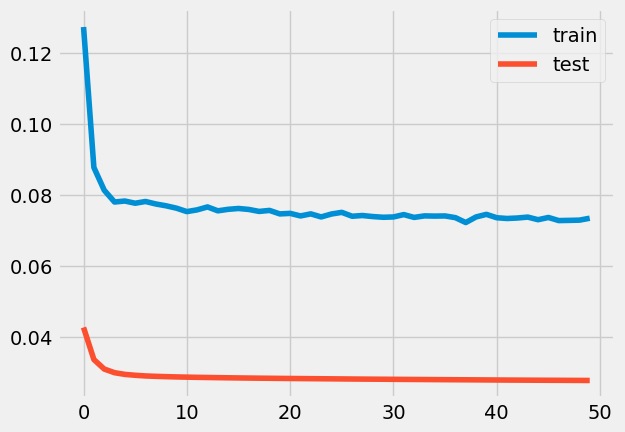

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
13/13 [==============================] - 7s 215ms/step - loss: 0.1373 - accuracy: 3.6885e-05 - val_loss: 0.0528 - val_accuracy: 0.0000e+00
Epoch 2/50
13/13 [==============================] - 1s 103ms/step - loss: 0.0958 - accuracy: 6.9262e-04 - val_loss: 0.0397 - val_accuracy: 0.0000e+00
Epoch 3/50
13/13

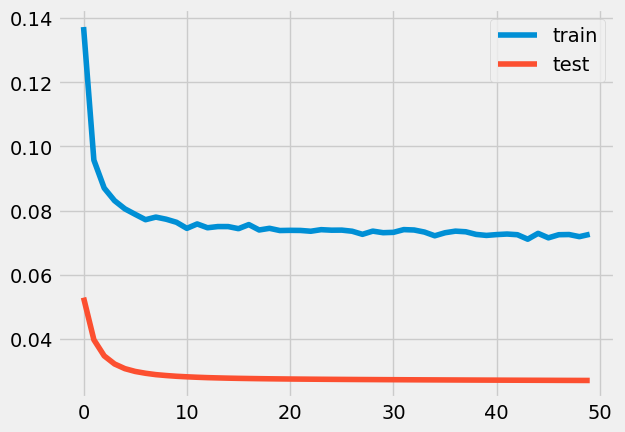

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
13/13 [==============================] - 5s 178ms/step - loss: 0.1681 - accuracy: 0.0000e+00 - val_loss: 0.0743 - val_accuracy: 0.0000e+00
Epoch 2/50
13/13 [==============================] - 1s 102ms/step - loss: 0.1133 - accuracy: 2.3497e-04 - val_loss: 0.0546 - val_accuracy: 0.0000e+00
Epoch 3/50
13/13

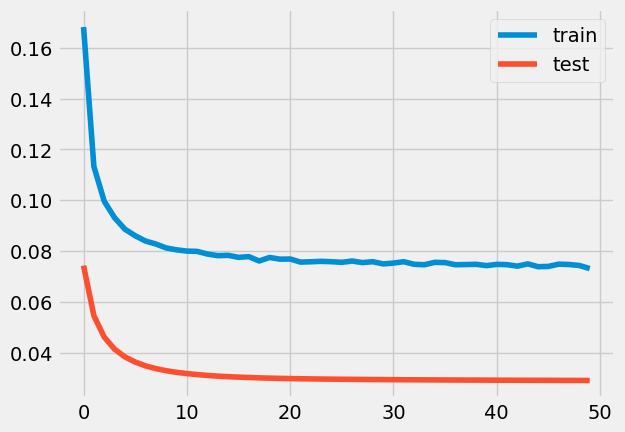

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
13/13 [==============================] - 6s 175ms/step - loss: 0.1921 - accuracy: 0.0000e+00 - val_loss: 0.0944 - val_accuracy: 0.0000e+00
Epoch 2/50
13/13 [==============================] - 1s 98ms/step - loss: 0.1289 - accuracy: 0.0000e+00 - val_loss: 0.0700 - val_accuracy: 0.0000e+00
Epoch 3/50
13/13 

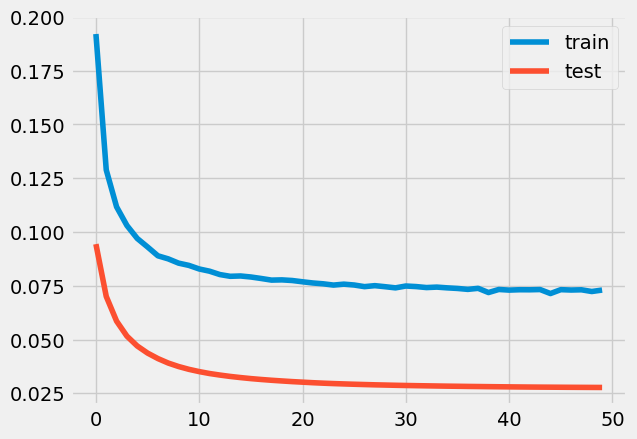

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
13/13 [==============================] - 5s 167ms/step - loss: 0.1686 - accuracy: 0.0000e+00 - val_loss: 0.0755 - val_accuracy: 0.0000e+00
Epoch 2/50
13/13 [==============================] - 1s 94ms/step - loss: 0.1124 - accuracy: 1.8230e-04 - val_loss: 0.0548 - val_accuracy: 0.0000e+00
Epoch 3/50
13/13 

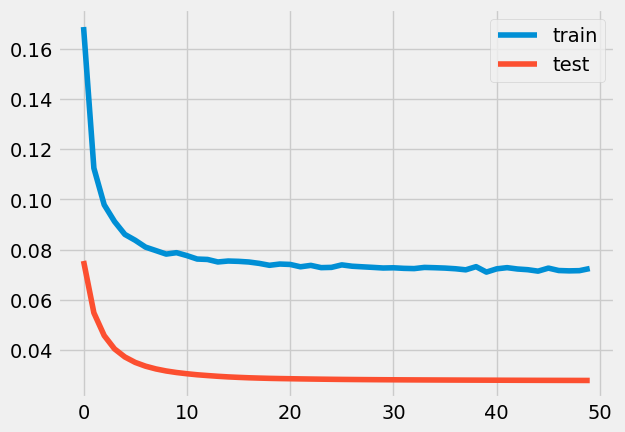

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 11s 244ms/step - loss: 0.3081 - accuracy: 0.0000e+00 - val_loss: 0.1995 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 114ms/step - loss: 0.2153 - accuracy: 0.0000e+00 - val_loss: 0.1583 - val_accuracy: 0.0000e+00
Epoch 3/50
14/1

Epoch 50/50
14/14 [==============================] - 2s 109ms/step - loss: 0.0881 - accuracy: 6.4232e-04 - val_loss: 0.0444 - val_accuracy: 0.0000e+00

loss: 4.44%



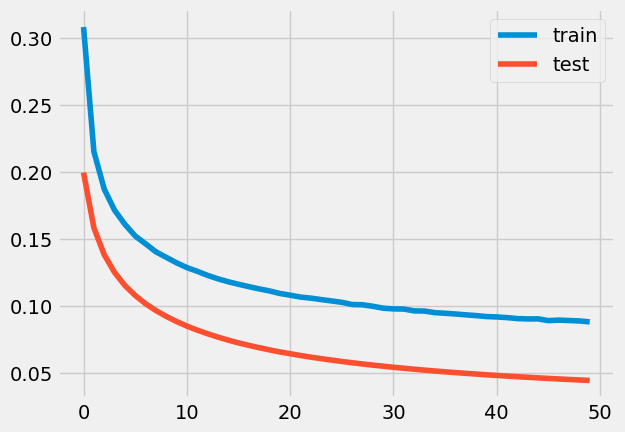

0.7195710522091497
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 6s 172ms/step - loss: 0.2411 - accuracy: 0.0000e+00 - val_loss: 0.1393 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 1s 98ms/step - loss: 0.1638 - accuracy: 0.0000e+00 - val_loss: 0.1070 - val_accuracy: 0.0000e+0


loss: 2.97%



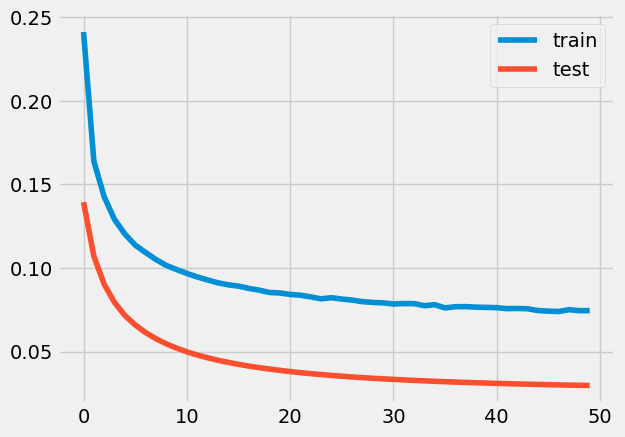

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
12/12 [==============================] - 6s 198ms/step - loss: 0.3819 - accuracy: 0.0000e+00 - val_loss: 0.2949 - val_accuracy: 0.0000e+00
Epoch 2/50
12/12 [==============================] - 1s 120ms/step - loss: 0.3070 - accuracy: 0.0000e+00 - val_loss: 0.2588 - val_accuracy: 0.0000e+00
Epoch 3/50
12/12

Epoch 50/50
12/12 [==============================] - 1s 115ms/step - loss: 0.1551 - accuracy: 0.0000e+00 - val_loss: 0.1136 - val_accuracy: 0.0000e+00

loss: 11.36%



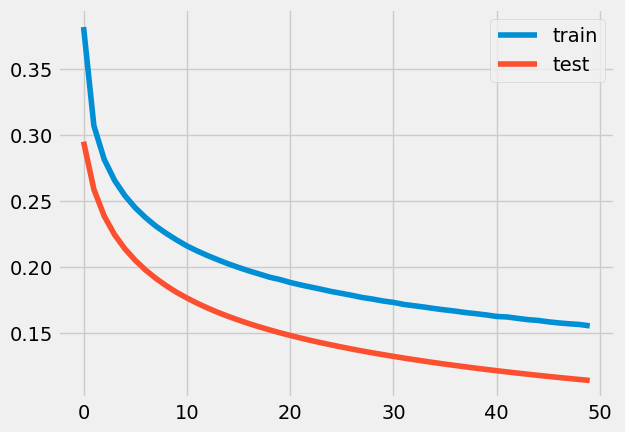

0.18671037886901856
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 7s 192ms/step - loss: 0.3785 - accuracy: 0.0000e+00 - val_loss: 0.2905 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 111ms/step - loss: 0.3016 - accuracy: 0.0000e+00 - val_loss: 0.2539 - val_accuracy: 0.0000e

Epoch 50/50
14/14 [==============================] - 1s 108ms/step - loss: 0.1530 - accuracy: 0.0000e+00 - val_loss: 0.1120 - val_accuracy: 0.0000e+00

loss: 11.20%



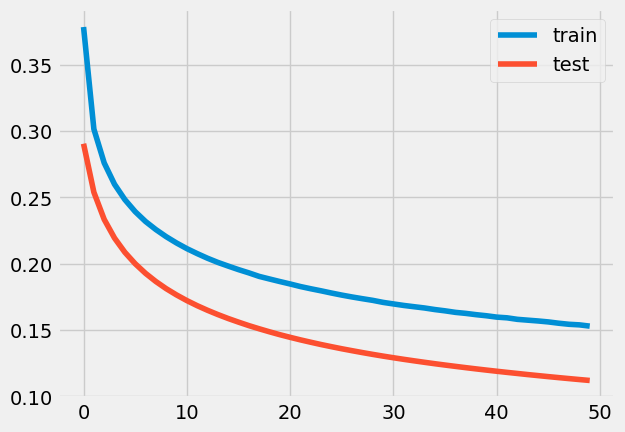

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 6s 158ms/step - loss: 0.3161 - accuracy: 0.0000e+00 - val_loss: 0.2194 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 98ms/step - loss: 0.2370 - accuracy: 0.0000e+00 - val_loss: 0.1820 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16 

Epoch 50/50
16/16 [==============================] - 2s 103ms/step - loss: 0.0967 - accuracy: 3.0492e-04 - val_loss: 0.0519 - val_accuracy: 0.0000e+00

loss: 5.19%



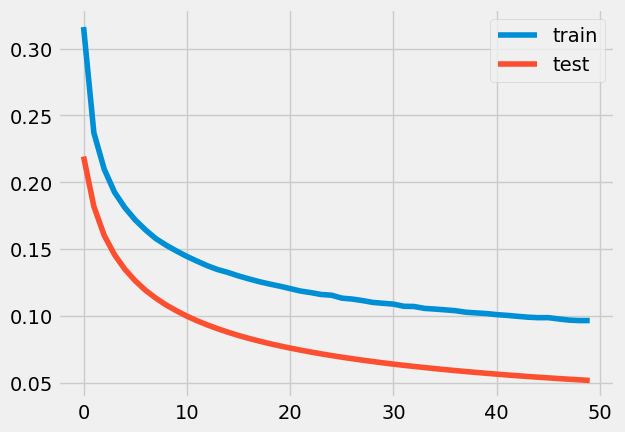

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 6s 157ms/step - loss: 0.2052 - accuracy: 0.0000e+00 - val_loss: 0.1099 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 98ms/step - loss: 0.1421 - accuracy: 0.0000e+00 - val_loss: 0.0842 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16 

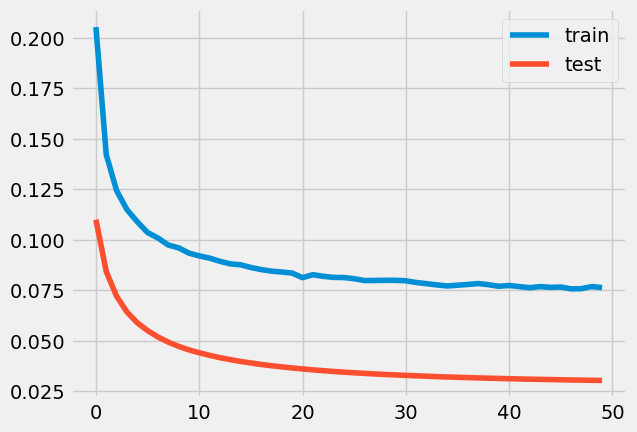

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 6s 149ms/step - loss: 0.2185 - accuracy: 0.0000e+00 - val_loss: 0.1245 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 90ms/step - loss: 0.1559 - accuracy: 0.0000e+00 - val_loss: 0.0992 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 


loss: 3.41%



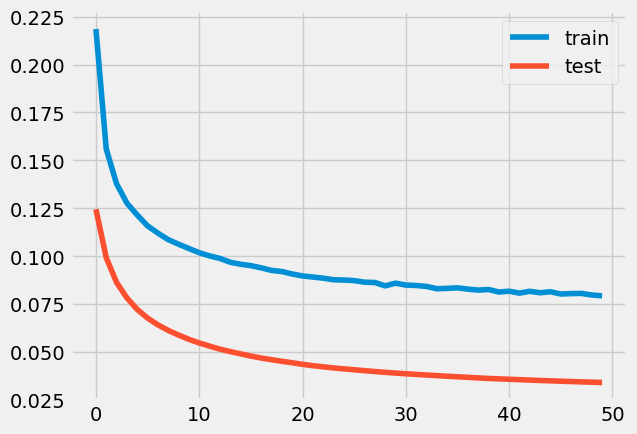

0.9267209686550607
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 6s 149ms/step - loss: 0.3583 - accuracy: 0.0000e+00 - val_loss: 0.2495 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 97ms/step - loss: 0.2621 - accuracy: 0.0000e+00 - val_loss: 0.2069 - val_accuracy: 0.0000e+0

17/17 [==============================] - 2s 93ms/step - loss: 0.1035 - accuracy: 2.2778e-04 - val_loss: 0.0606 - val_accuracy: 0.0000e+00

loss: 6.06%



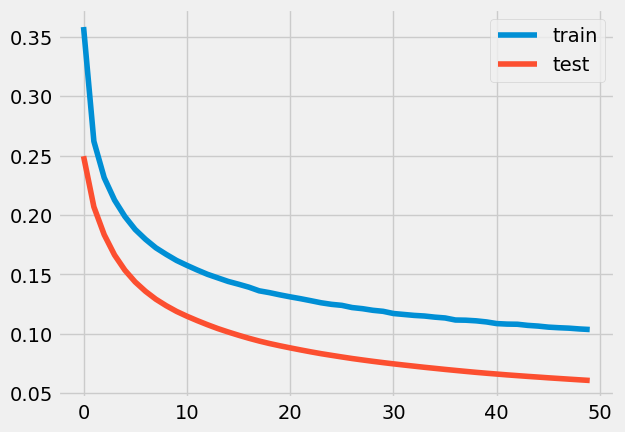

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 6s 152ms/step - loss: 0.2503 - accuracy: 0.0000e+00 - val_loss: 0.1507 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 95ms/step - loss: 0.1763 - accuracy: 0.0000e+00 - val_loss: 0.1195 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16 


loss: 3.50%



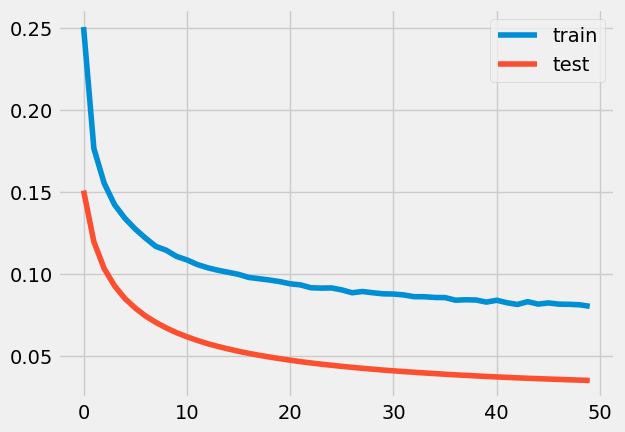

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 5s 145ms/step - loss: 0.0930 - accuracy: 0.0027 - val_loss: 0.0290 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 98ms/step - loss: 0.0790 - accuracy: 0.0050 - val_loss: 0.0280 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16 [=======

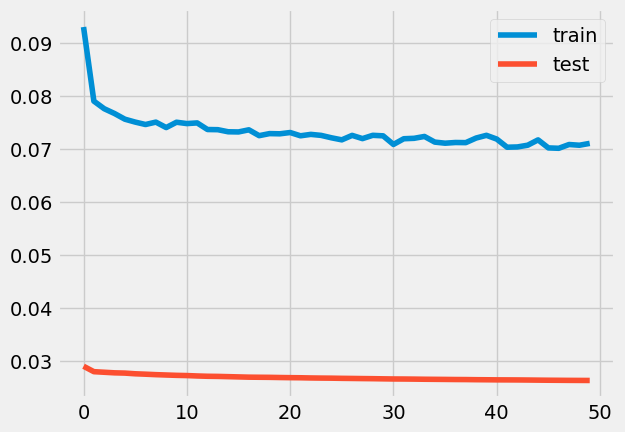

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 6s 148ms/step - loss: 0.1191 - accuracy: 7.2476e-05 - val_loss: 0.0406 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 96ms/step - loss: 0.0844 - accuracy: 0.0019 - val_loss: 0.0318 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [===

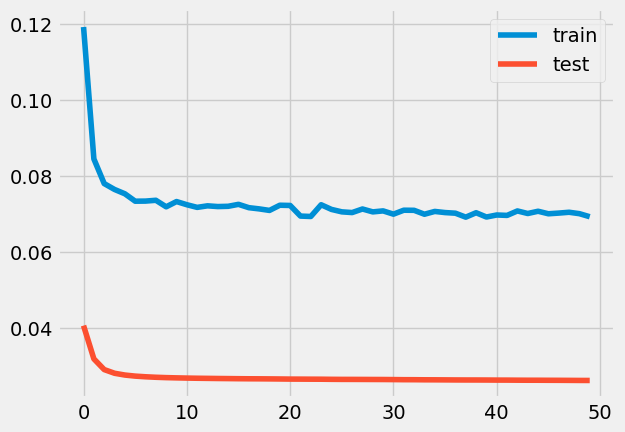

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 6s 145ms/step - loss: 0.1976 - accuracy: 0.0000e+00 - val_loss: 0.1018 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 96ms/step - loss: 0.1358 - accuracy: 0.0000e+00 - val_loss: 0.0782 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 

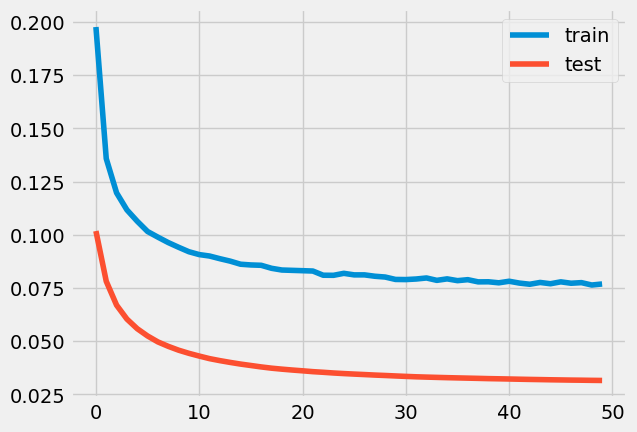

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 6s 175ms/step - loss: 0.1629 - accuracy: 0.0000e+00 - val_loss: 0.0669 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 104ms/step - loss: 0.1052 - accuracy: 4.0035e-04 - val_loss: 0.0482 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17

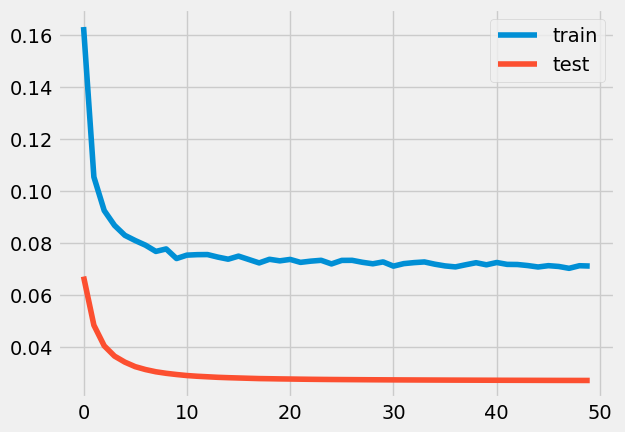

0.025
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 6s 155ms/step - loss: 0.2506 - accuracy: 0.0000e+00 - val_loss: 0.1532 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 96ms/step - loss: 0.1790 - accuracy: 0.0000e+00 - val_loss: 0.1205 - val_accuracy: 0.0000e+00
Epoch 3/50


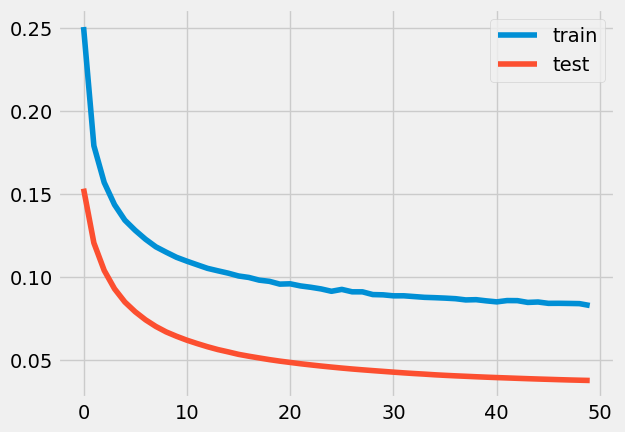

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 6s 141ms/step - loss: 0.2811 - accuracy: 0.0000e+00 - val_loss: 0.1672 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 99ms/step - loss: 0.1853 - accuracy: 0.0000e+00 - val_loss: 0.1264 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 


loss: 3.49%



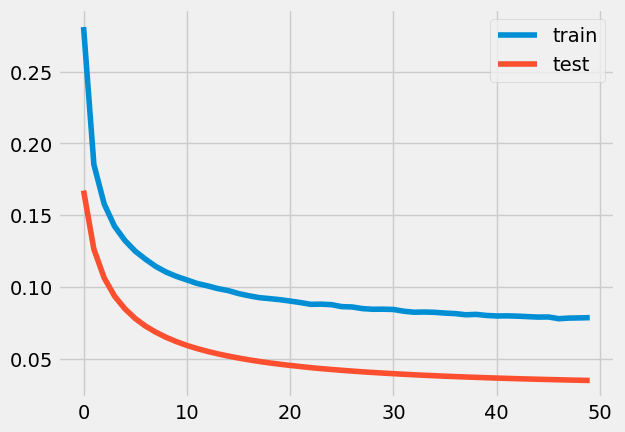

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 6s 142ms/step - loss: 0.3760 - accuracy: 0.0000e+00 - val_loss: 0.2646 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 95ms/step - loss: 0.2714 - accuracy: 0.0000e+00 - val_loss: 0.2181 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 

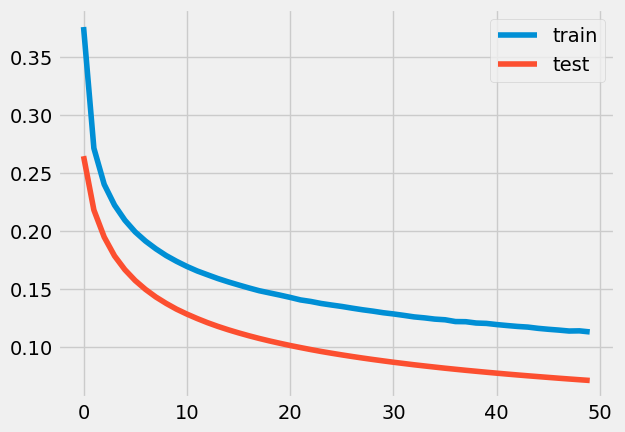

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 5s 153ms/step - loss: 0.2295 - accuracy: 0.0000e+00 - val_loss: 0.1220 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 97ms/step - loss: 0.1503 - accuracy: 0.0000e+00 - val_loss: 0.0913 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16 

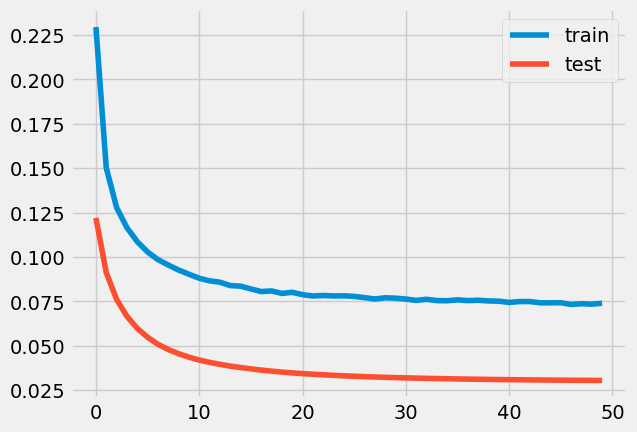

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 6s 166ms/step - loss: 0.1846 - accuracy: 0.0000e+00 - val_loss: 0.0850 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 100ms/step - loss: 0.1192 - accuracy: 8.1967e-05 - val_loss: 0.0621 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16

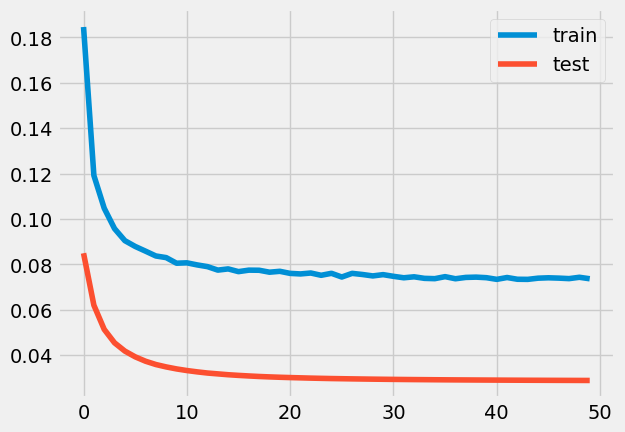

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 6s 153ms/step - loss: 0.2889 - accuracy: 0.0000e+00 - val_loss: 0.1875 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 100ms/step - loss: 0.2100 - accuracy: 0.0000e+00 - val_loss: 0.1535 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16

Epoch 50/50
16/16 [==============================] - 2s 104ms/step - loss: 0.0962 - accuracy: 2.9672e-04 - val_loss: 0.0508 - val_accuracy: 0.0000e+00

loss: 5.08%



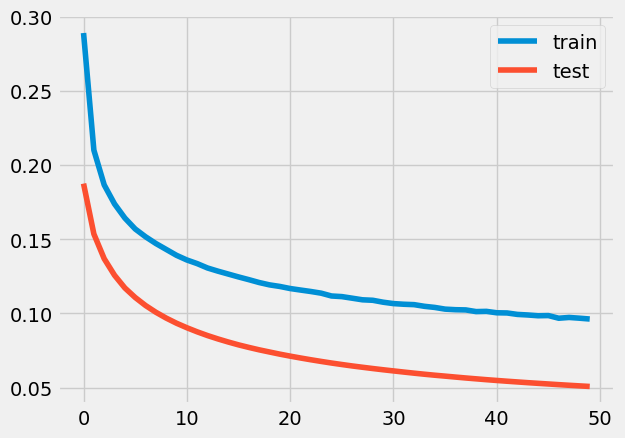

0.4172056138639017
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 6s 160ms/step - loss: 0.1930 - accuracy: 0.0000e+00 - val_loss: 0.0944 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 100ms/step - loss: 0.1302 - accuracy: 0.0000e+00 - val_loss: 0.0711 - val_accuracy: 0.0000e+


loss: 3.20%



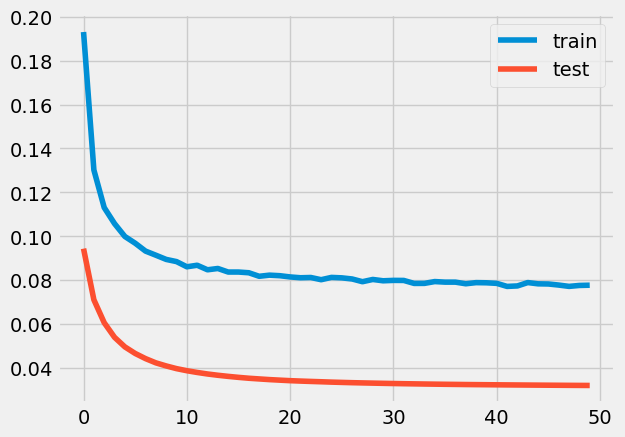

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 6s 146ms/step - loss: 0.1452 - accuracy: 0.0000e+00 - val_loss: 0.0633 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 98ms/step - loss: 0.1025 - accuracy: 3.7030e-04 - val_loss: 0.0488 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 

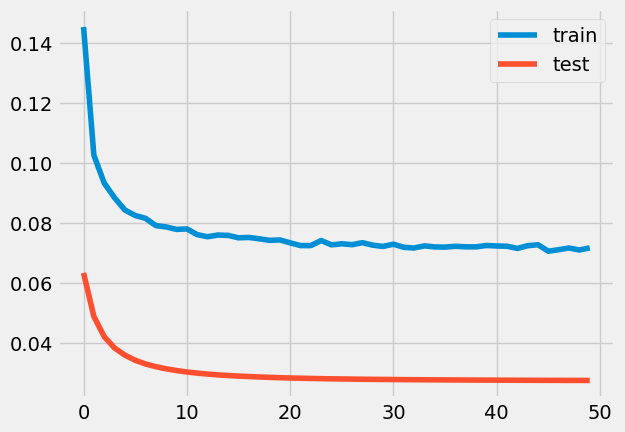

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 6s 138ms/step - loss: 0.1197 - accuracy: 7.9195e-04 - val_loss: 0.0409 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 90ms/step - loss: 0.0857 - accuracy: 0.0027 - val_loss: 0.0326 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 [===

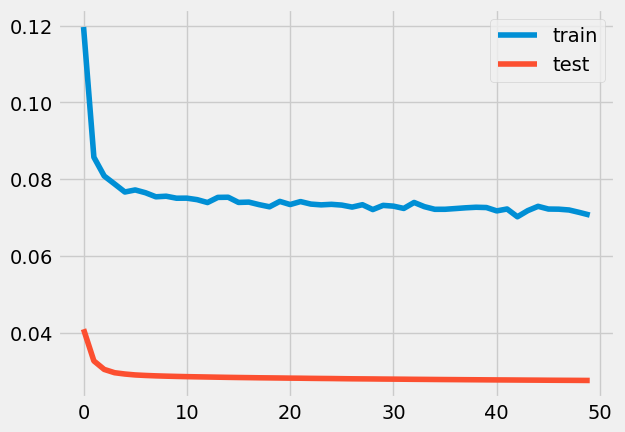

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 135ms/step - loss: 0.2512 - accuracy: 0.0000e+00 - val_loss: 0.1527 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.1786 - accuracy: 0.0000e+00 - val_loss: 0.1238 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

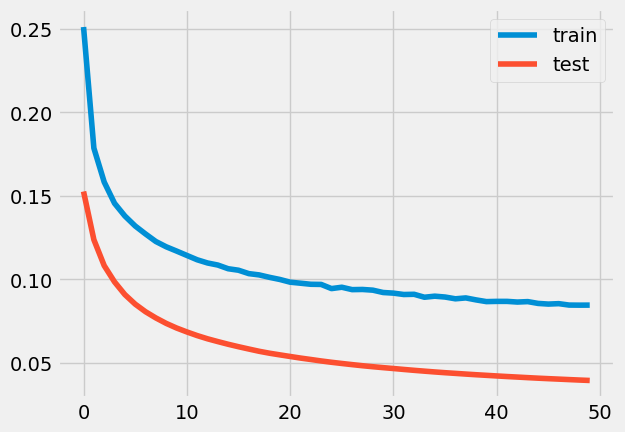

0.6177862949726528
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 139ms/step - loss: 0.1941 - accuracy: 0.0000e+00 - val_loss: 0.0996 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.1303 - accuracy: 0.0000e+00 - val_loss: 0.0748 - val_accuracy: 0.0000e+0

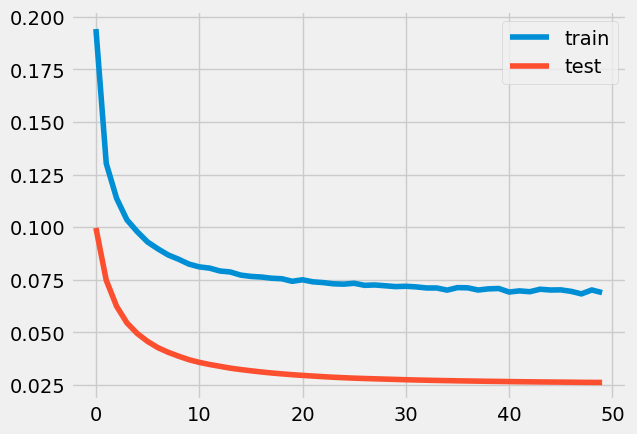

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 6s 134ms/step - loss: 0.1045 - accuracy: 8.0094e-04 - val_loss: 0.0327 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 90ms/step - loss: 0.0790 - accuracy: 0.0047 - val_loss: 0.0299 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [===

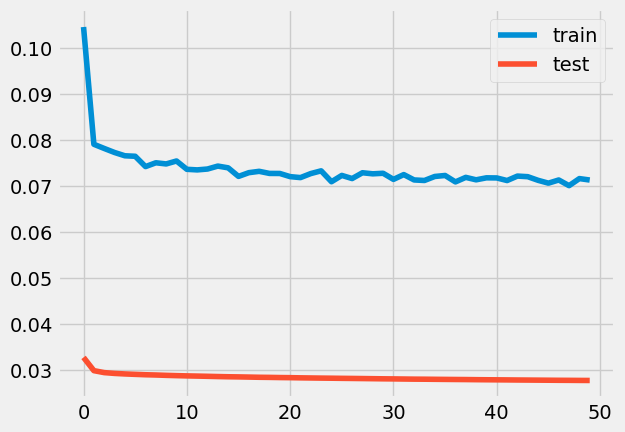

0.940970604646076
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 6s 129ms/step - loss: 0.1132 - accuracy: 4.6370e-04 - val_loss: 0.0378 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 93ms/step - loss: 0.0817 - accuracy: 0.0034 - val_loss: 0.0305 - val_accuracy: 0.0000e+00
Epo

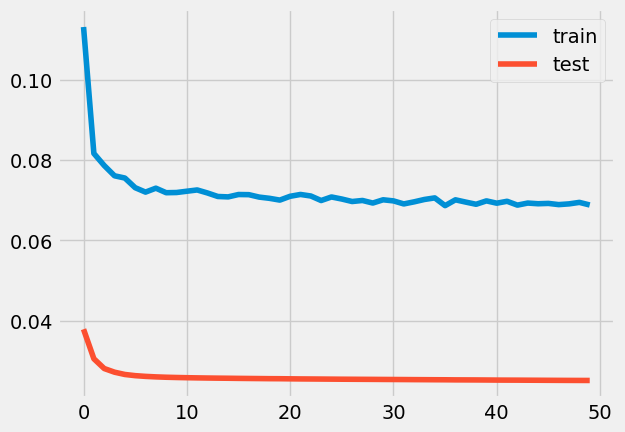

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 7s 141ms/step - loss: 0.2943 - accuracy: 0.0000e+00 - val_loss: 0.1878 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 96ms/step - loss: 0.2045 - accuracy: 0.0000e+00 - val_loss: 0.1474 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 

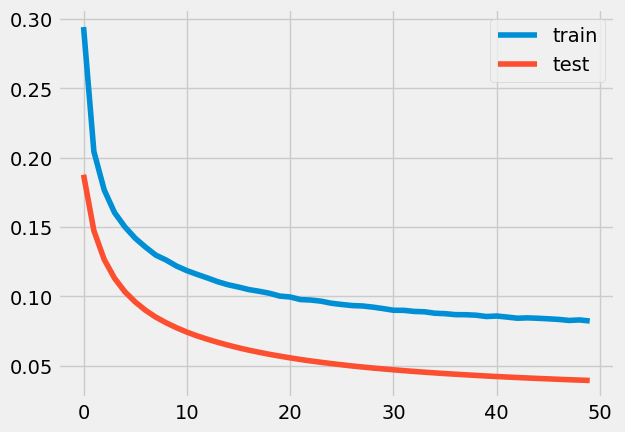

0.5636974890360171
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 7s 152ms/step - loss: 0.5270 - accuracy: 0.0000e+00 - val_loss: 0.4132 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 104ms/step - loss: 0.3996 - accuracy: 0.0000e+00 - val_loss: 0.3534 - val_accuracy: 0.0000e+

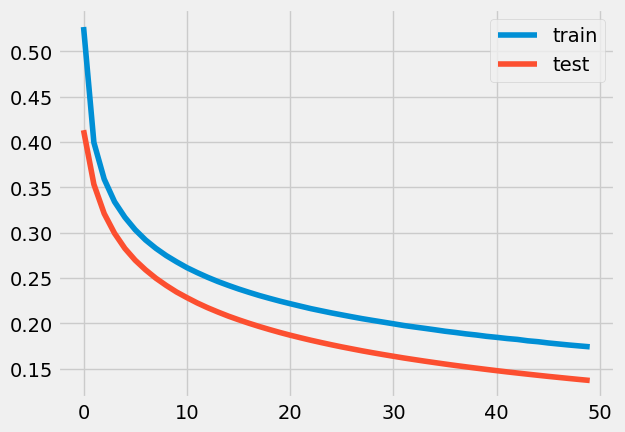

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 7s 119ms/step - loss: 0.2309 - accuracy: 0.0000e+00 - val_loss: 0.1411 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 89ms/step - loss: 0.1689 - accuracy: 0.0000e+00 - val_loss: 0.1143 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 

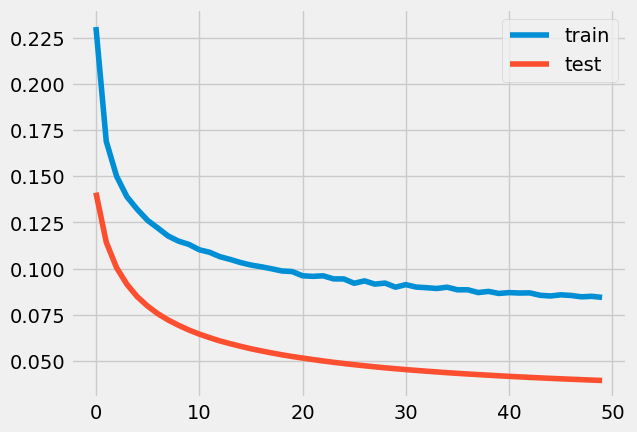

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 9s 186ms/step - loss: 0.1046 - accuracy: 5.3770e-04 - val_loss: 0.0323 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 5s 152ms/step - loss: 0.0758 - accuracy: 0.0028 - val_loss: 0.0281 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [==

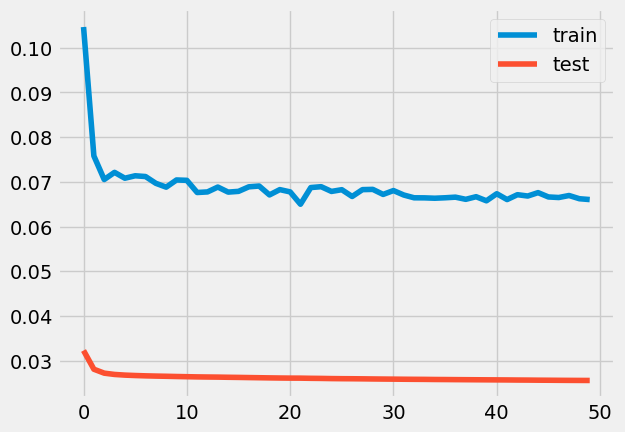

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 9s 161ms/step - loss: 0.2245 - accuracy: 0.0000e+00 - val_loss: 0.1319 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 111ms/step - loss: 0.1598 - accuracy: 0.0000e+00 - val_loss: 0.1026 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24


loss: 3.39%



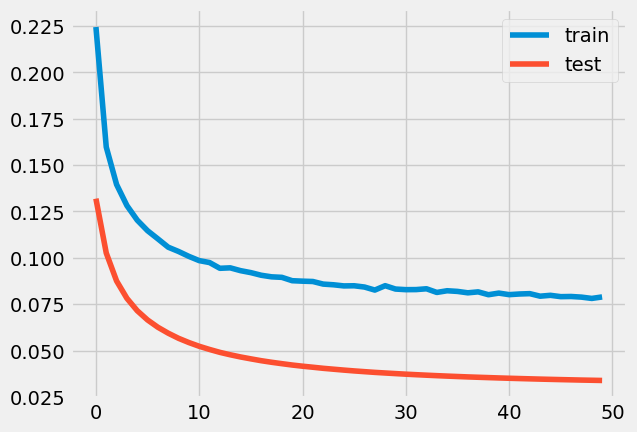

0.7175844911994124
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 9s 168ms/step - loss: 0.2781 - accuracy: 0.0000e+00 - val_loss: 0.1747 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 122ms/step - loss: 0.1922 - accuracy: 0.0000e+00 - val_loss: 0.1373 - val_accuracy: 0.0000e+

Epoch 50/50
24/24 [==============================] - 3s 105ms/step - loss: 0.0806 - accuracy: 0.0013 - val_loss: 0.0377 - val_accuracy: 0.0000e+00

loss: 3.77%



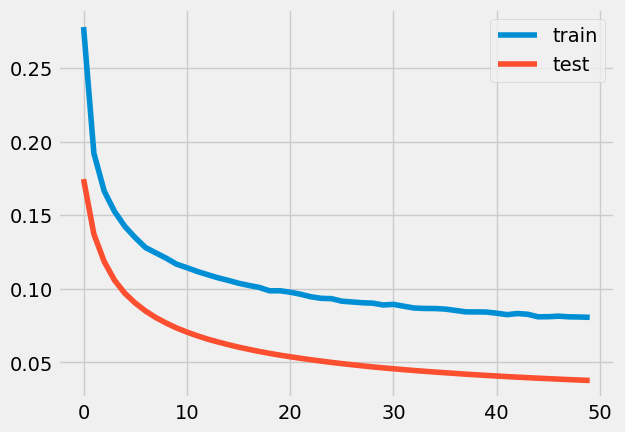

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 8s 145ms/step - loss: 0.2333 - accuracy: 0.0000e+00 - val_loss: 0.1332 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 99ms/step - loss: 0.1583 - accuracy: 0.0000e+00 - val_loss: 0.1030 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 


loss: 2.96%



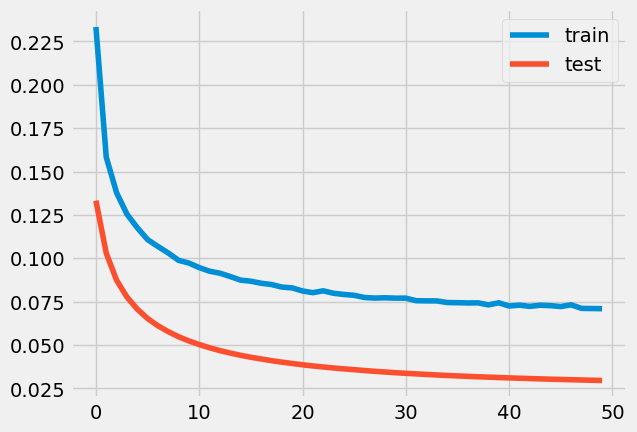

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 7s 152ms/step - loss: 0.1336 - accuracy: 2.9781e-04 - val_loss: 0.0494 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 103ms/step - loss: 0.0900 - accuracy: 0.0012 - val_loss: 0.0383 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [==

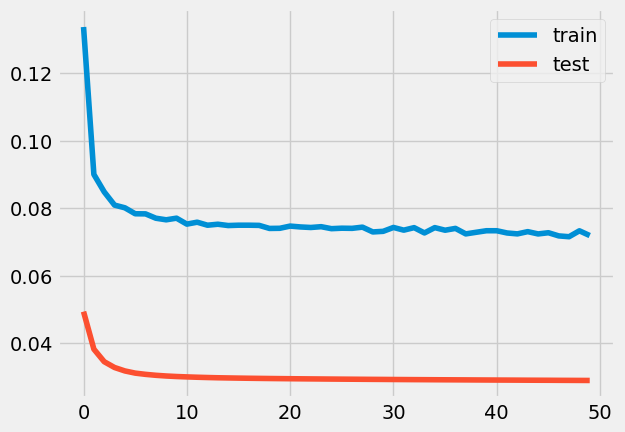

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 9s 150ms/step - loss: 0.1354 - accuracy: 7.6503e-05 - val_loss: 0.0585 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 105ms/step - loss: 0.1005 - accuracy: 3.5519e-04 - val_loss: 0.0470 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26

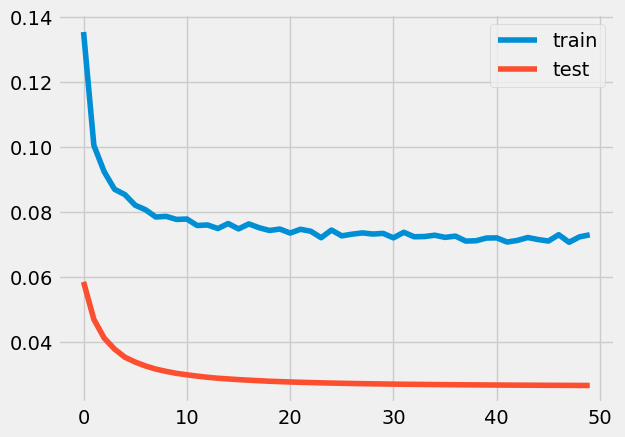

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 8s 182ms/step - loss: 0.1769 - accuracy: 0.0000e+00 - val_loss: 0.0897 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 118ms/step - loss: 0.1232 - accuracy: 0.0000e+00 - val_loss: 0.0663 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21

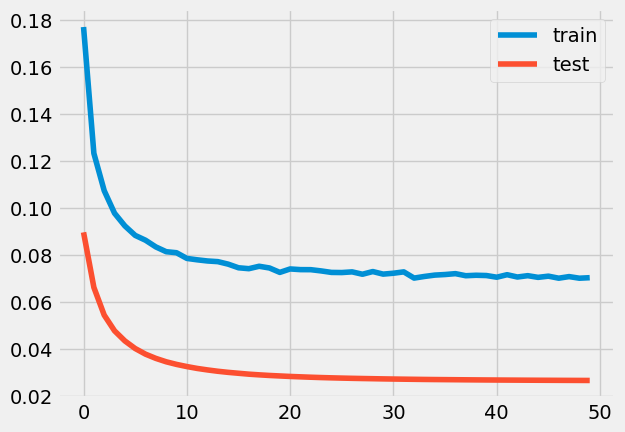

0.9958127730028646
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 12s 305ms/step - loss: 0.2217 - accuracy: 0.0000e+00 - val_loss: 0.1261 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 3s 150ms/step - loss: 0.1554 - accuracy: 0.0000e+00 - val_loss: 0.0992 - val_accuracy: 0.0000e

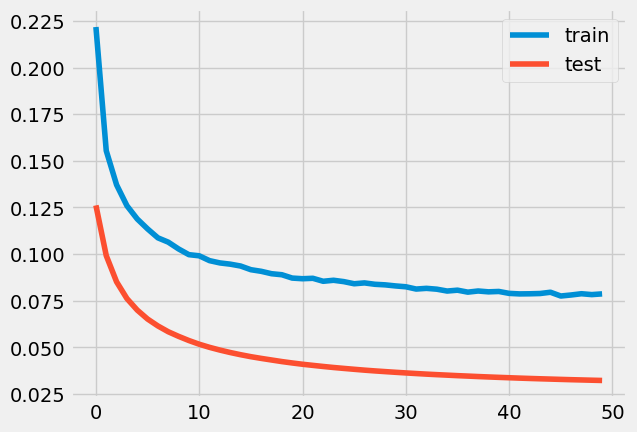

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 8s 126ms/step - loss: 0.1739 - accuracy: 0.0000e+00 - val_loss: 0.0822 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 107ms/step - loss: 0.1170 - accuracy: 0.0000e+00 - val_loss: 0.0614 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26

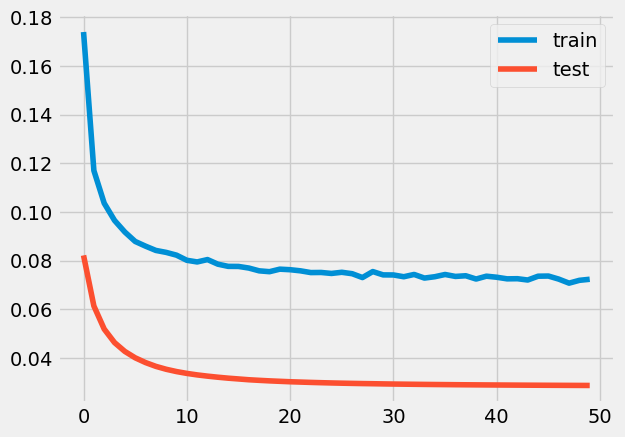

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 15s 266ms/step - loss: 0.1545 - accuracy: 0.0000e+00 - val_loss: 0.0721 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 5s 192ms/step - loss: 0.1102 - accuracy: 1.7486e-04 - val_loss: 0.0551 - val_accuracy: 0.0000e+00
Epoch 3/50
26/2

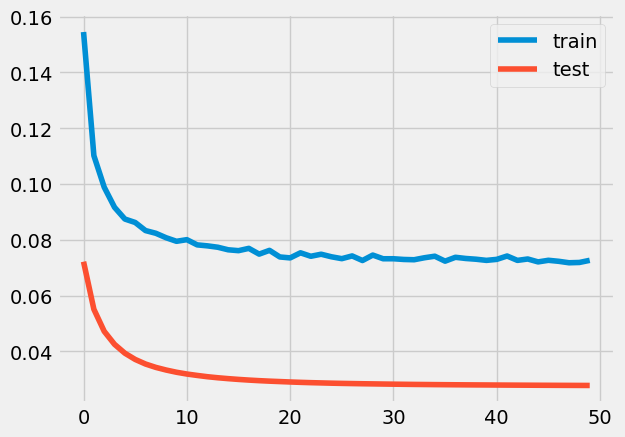

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 164ms/step - loss: 0.1906 - accuracy: 0.0000e+00 - val_loss: 0.1089 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 108ms/step - loss: 0.1452 - accuracy: 0.0000e+00 - val_loss: 0.0891 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.34%



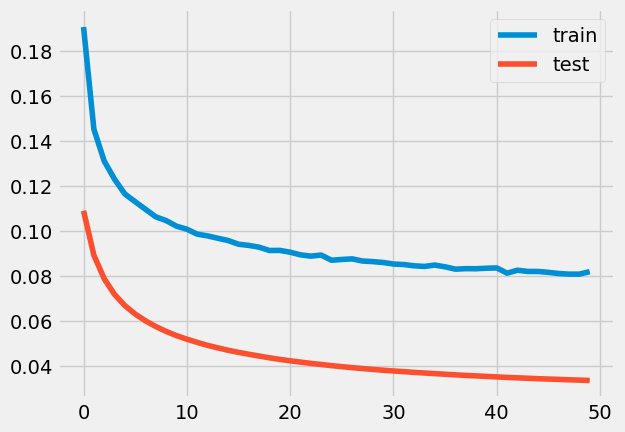

0.7970298279335432
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 142ms/step - loss: 0.0944 - accuracy: 0.0043 - val_loss: 0.0293 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.0778 - accuracy: 0.0042 - val_loss: 0.0280 - val_accuracy: 0.0000e+00
Epoch

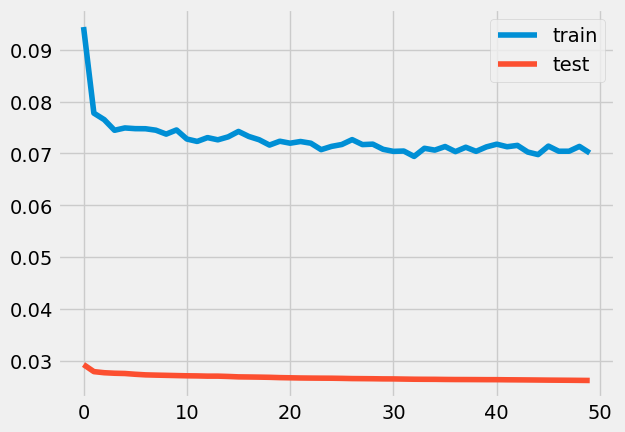

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 7s 200ms/step - loss: 0.1623 - accuracy: 0.0000e+00 - val_loss: 0.0786 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 118ms/step - loss: 0.1173 - accuracy: 0.0000e+00 - val_loss: 0.0604 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16

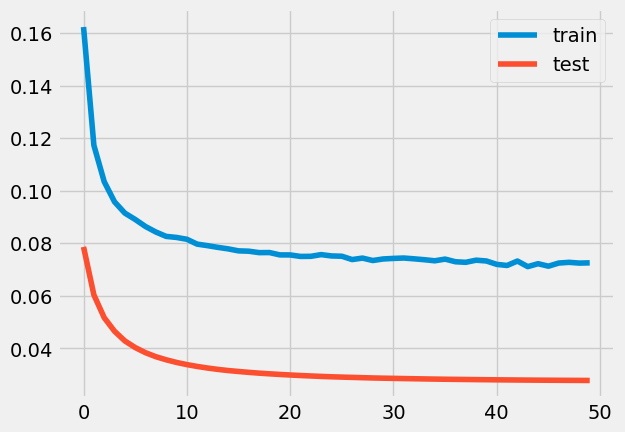

0.9394430057516421
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 7s 158ms/step - loss: 0.2420 - accuracy: 0.0000e+00 - val_loss: 0.1313 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 107ms/step - loss: 0.1555 - accuracy: 0.0000e+00 - val_loss: 0.0968 - val_accuracy: 0.0000e+


loss: 2.87%



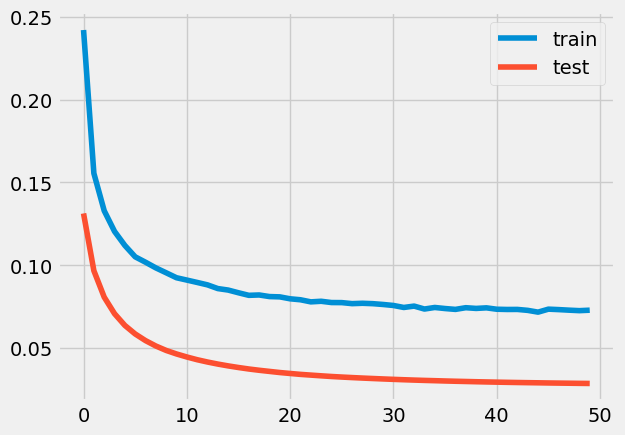

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 8s 232ms/step - loss: 0.1337 - accuracy: 1.1923e-05 - val_loss: 0.0538 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 126ms/step - loss: 0.0969 - accuracy: 5.9707e-04 - val_loss: 0.0408 - val_accuracy: 0.0000e+00
Epoch 3/50
14/14

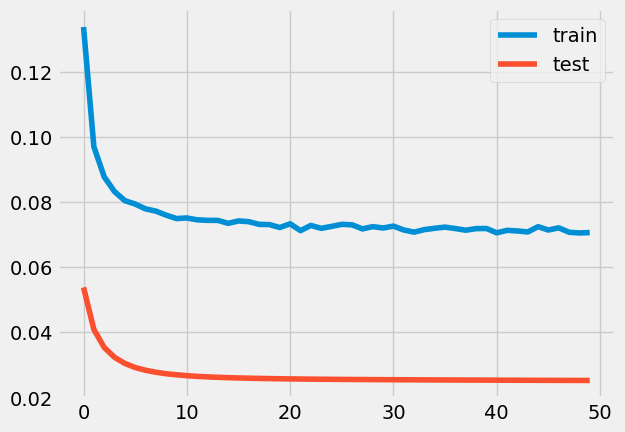

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 8s 225ms/step - loss: 0.1926 - accuracy: 0.0000e+00 - val_loss: 0.1079 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 144ms/step - loss: 0.1432 - accuracy: 0.0000e+00 - val_loss: 0.0863 - val_accuracy: 0.0000e+00
Epoch 3/50
14/14


loss: 3.05%



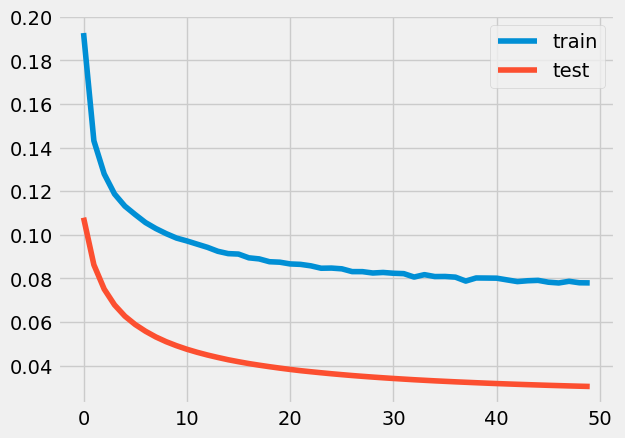

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 192ms/step - loss: 0.2379 - accuracy: 0.0000e+00 - val_loss: 0.1234 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 118ms/step - loss: 0.1467 - accuracy: 0.0000e+00 - val_loss: 0.0890 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17


loss: 2.69%



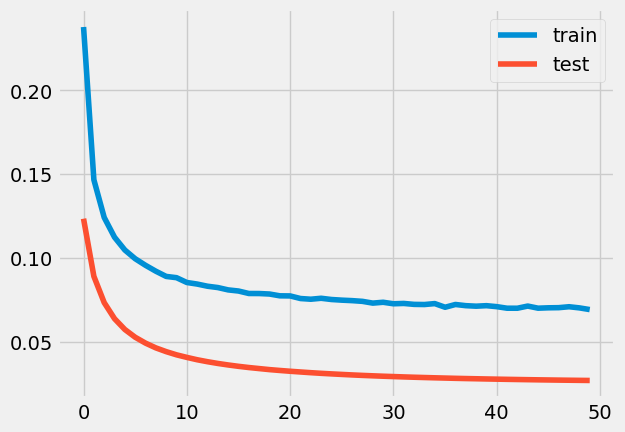

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 190ms/step - loss: 0.1302 - accuracy: 2.1129e-04 - val_loss: 0.0482 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 127ms/step - loss: 0.0916 - accuracy: 8.2514e-04 - val_loss: 0.0370 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17

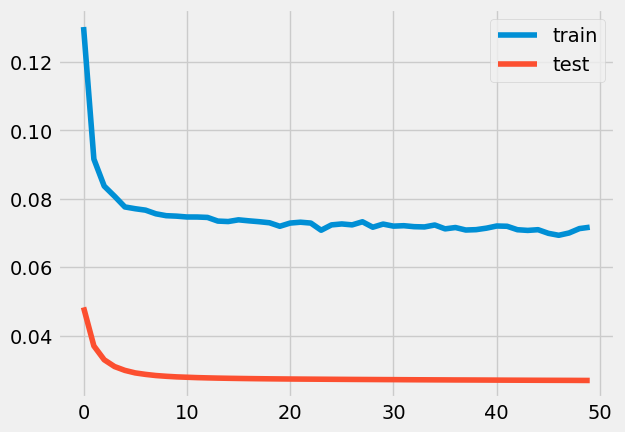

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 9s 228ms/step - loss: 0.2271 - accuracy: 0.0000e+00 - val_loss: 0.1290 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 142ms/step - loss: 0.1585 - accuracy: 0.0000e+00 - val_loss: 0.1007 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16


loss: 3.30%



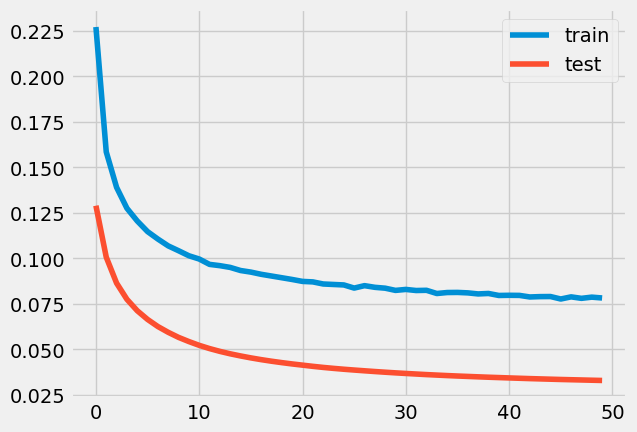

0.7831793359749455
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 9s 226ms/step - loss: 0.1338 - accuracy: 9.5082e-05 - val_loss: 0.0475 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 138ms/step - loss: 0.0908 - accuracy: 0.0020 - val_loss: 0.0369 - val_accuracy: 0.0000e+00
E

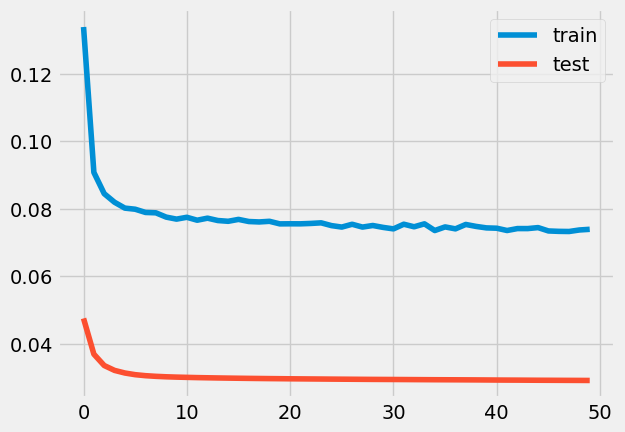

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
15/15 [==============================] - 8s 235ms/step - loss: 0.3352 - accuracy: 0.0000e+00 - val_loss: 0.2501 - val_accuracy: 0.0000e+00
Epoch 2/50
15/15 [==============================] - 2s 138ms/step - loss: 0.2680 - accuracy: 0.0000e+00 - val_loss: 0.2179 - val_accuracy: 0.0000e+00
Epoch 3/50
15/15

Epoch 50/50
15/15 [==============================] - 2s 147ms/step - loss: 0.1385 - accuracy: 0.0000e+00 - val_loss: 0.0959 - val_accuracy: 0.0000e+00

loss: 9.59%



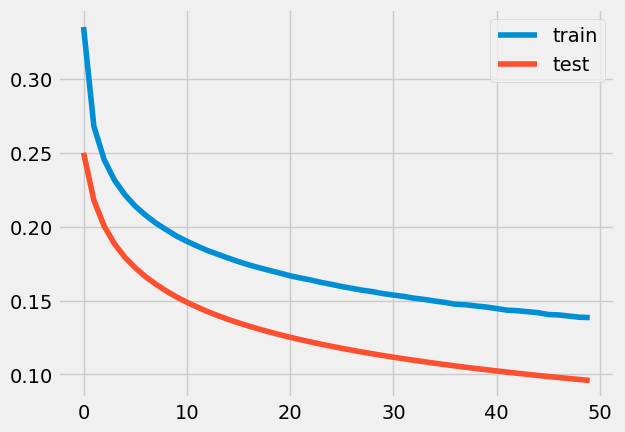

0.0691482189444862
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 10s 214ms/step - loss: 0.1979 - accuracy: 0.0000e+00 - val_loss: 0.1102 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 135ms/step - loss: 0.1446 - accuracy: 0.0000e+00 - val_loss: 0.0880 - val_accuracy: 0.0000e


loss: 3.15%



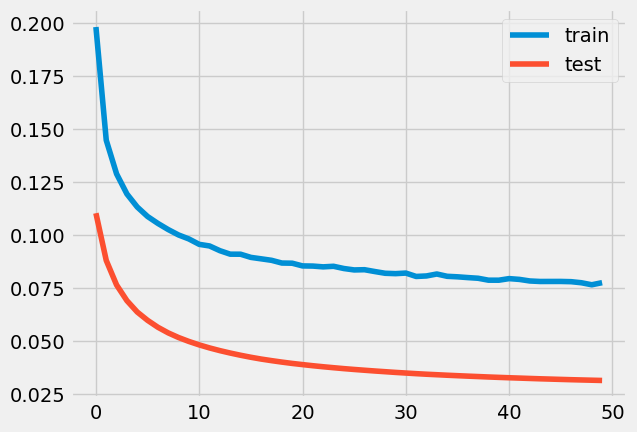

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 175ms/step - loss: 0.1640 - accuracy: 1.2295e-05 - val_loss: 0.0573 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 113ms/step - loss: 0.0937 - accuracy: 5.4713e-04 - val_loss: 0.0400 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

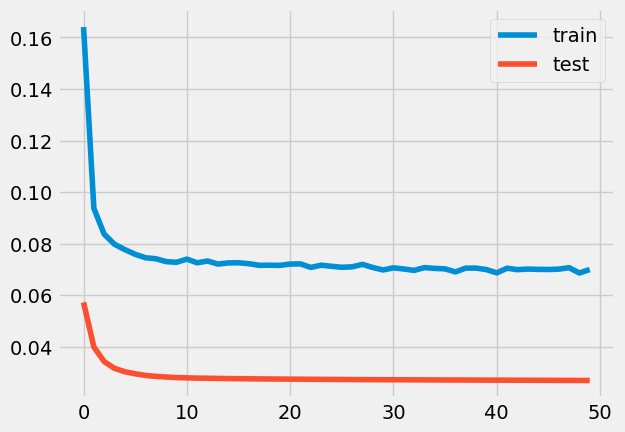

0.0125
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 174ms/step - loss: 0.1925 - accuracy: 0.0000e+00 - val_loss: 0.1055 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.1387 - accuracy: 0.0000e+00 - val_loss: 0.0841 - val_accuracy: 0.0000e+00
Epoch 3/5


loss: 3.17%



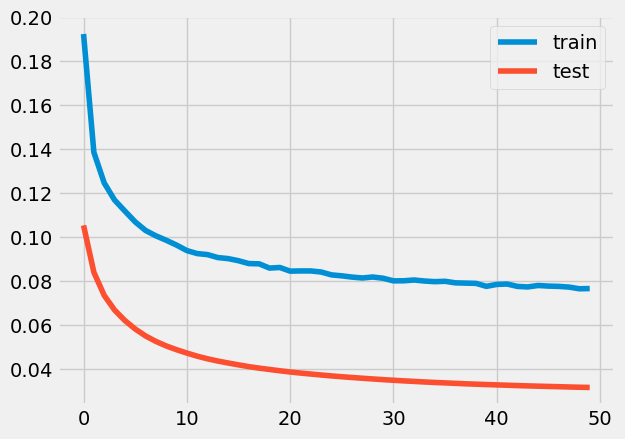

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 8s 163ms/step - loss: 0.2844 - accuracy: 0.0000e+00 - val_loss: 0.1736 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 94ms/step - loss: 0.1923 - accuracy: 0.0000e+00 - val_loss: 0.1353 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 

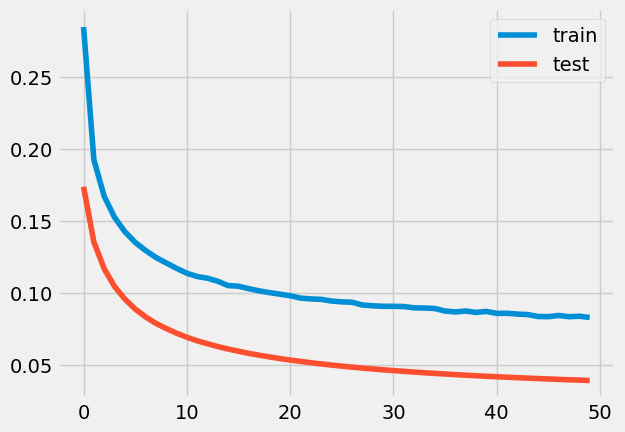

0.5455119738193197
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 9s 171ms/step - loss: 0.2722 - accuracy: 0.0000e+00 - val_loss: 0.1868 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 112ms/step - loss: 0.2120 - accuracy: 0.0000e+00 - val_loss: 0.1581 - val_accuracy: 0.0000e+

Epoch 50/50
21/21 [==============================] - 3s 131ms/step - loss: 0.0987 - accuracy: 4.8525e-04 - val_loss: 0.0524 - val_accuracy: 0.0000e+00

loss: 5.24%



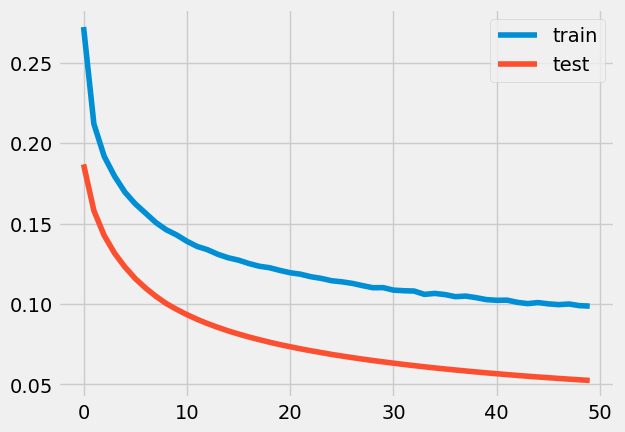

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 8s 172ms/step - loss: 0.0921 - accuracy: 0.0035 - val_loss: 0.0297 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 110ms/step - loss: 0.0800 - accuracy: 0.0056 - val_loss: 0.0294 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [======

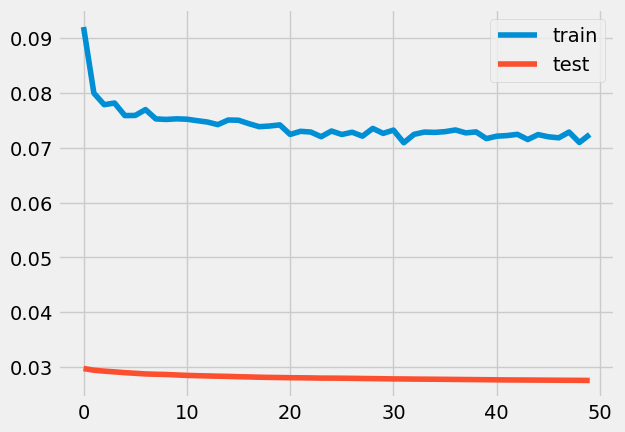

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 8s 170ms/step - loss: 0.2664 - accuracy: 0.0000e+00 - val_loss: 0.1692 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 108ms/step - loss: 0.1919 - accuracy: 0.0000e+00 - val_loss: 0.1357 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21

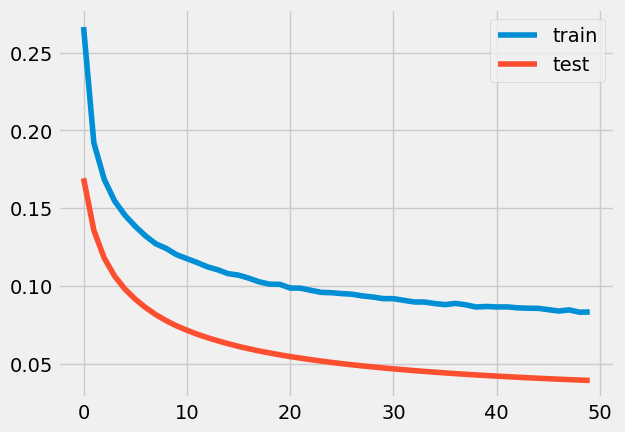

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 9s 171ms/step - loss: 0.1925 - accuracy: 0.0000e+00 - val_loss: 0.1047 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 3s 121ms/step - loss: 0.1384 - accuracy: 0.0000e+00 - val_loss: 0.0825 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22


loss: 3.05%



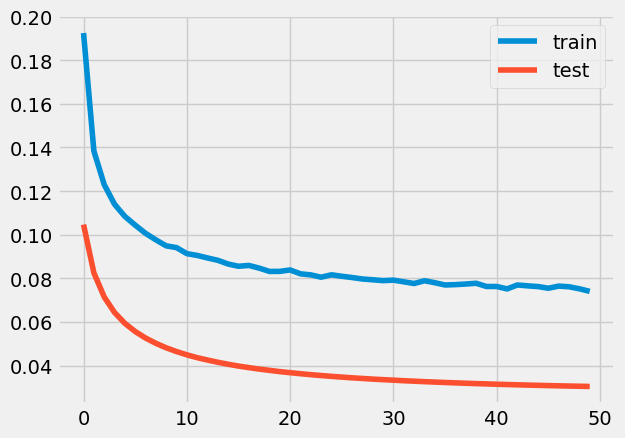

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 10s 190ms/step - loss: 0.3444 - accuracy: 0.0000e+00 - val_loss: 0.2493 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 3s 123ms/step - loss: 0.2629 - accuracy: 0.0000e+00 - val_loss: 0.2121 - val_accuracy: 0.0000e+00
Epoch 3/50
22/2

Epoch 50/50
22/22 [==============================] - 3s 131ms/step - loss: 0.1273 - accuracy: 0.0000e+00 - val_loss: 0.0853 - val_accuracy: 0.0000e+00

loss: 8.53%



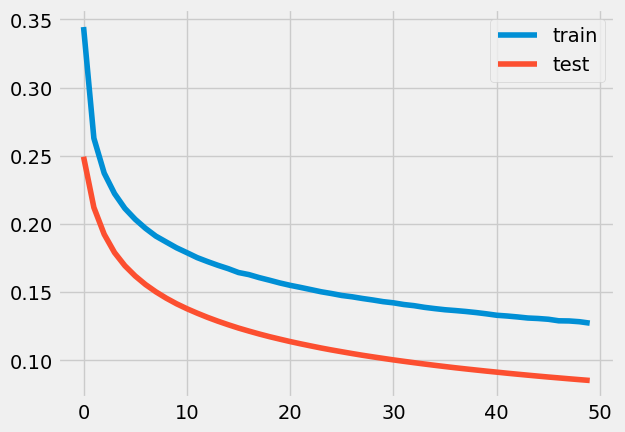

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 10s 203ms/step - loss: 0.1135 - accuracy: 2.4716e-04 - val_loss: 0.0372 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 130ms/step - loss: 0.0818 - accuracy: 0.0036 - val_loss: 0.0306 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [=

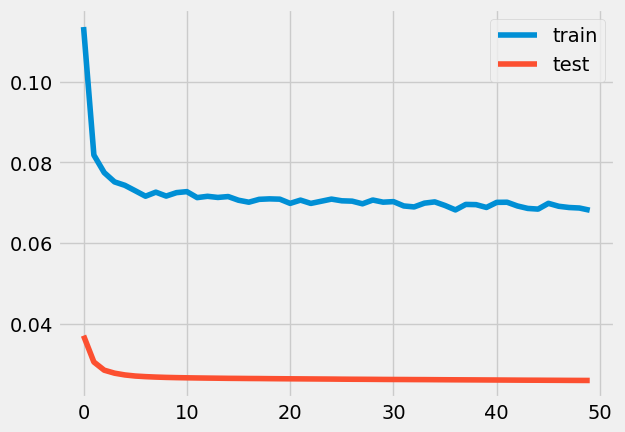

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 12s 228ms/step - loss: 0.1692 - accuracy: 0.0000e+00 - val_loss: 0.0848 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 130ms/step - loss: 0.1196 - accuracy: 4.3716e-05 - val_loss: 0.0641 - val_accuracy: 0.0000e+00
Epoch 3/50
24/2

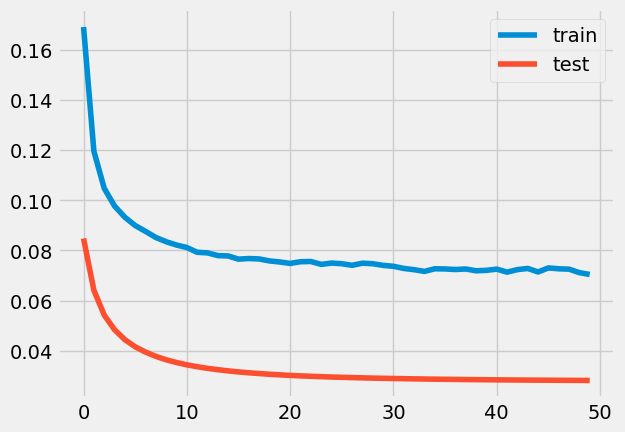

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 9s 155ms/step - loss: 0.1402 - accuracy: 2.1759e-04 - val_loss: 0.0553 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 3s 109ms/step - loss: 0.0969 - accuracy: 0.0012 - val_loss: 0.0423 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [==

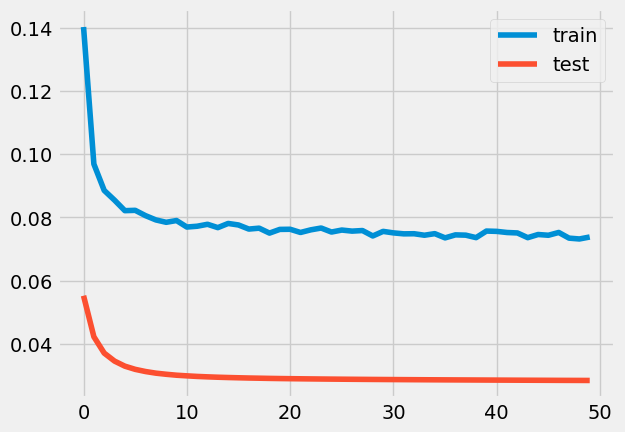

0.9740141402253121
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 11s 163ms/step - loss: 0.1215 - accuracy: 1.9672e-04 - val_loss: 0.0468 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 3s 120ms/step - loss: 0.0906 - accuracy: 0.0013 - val_loss: 0.0369 - val_accuracy: 0.0000e+00


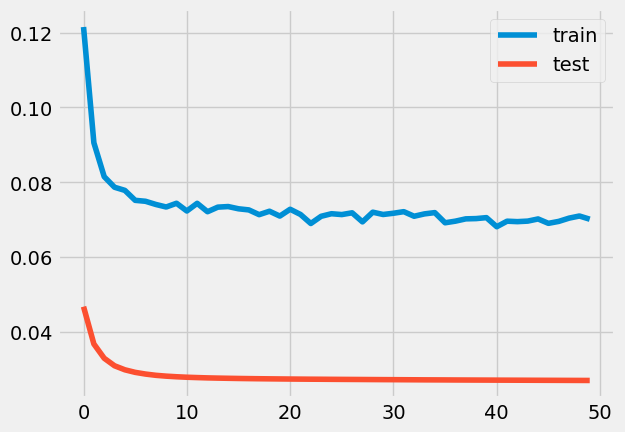

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 10s 167ms/step - loss: 0.1969 - accuracy: 0.0000e+00 - val_loss: 0.0976 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 118ms/step - loss: 0.1291 - accuracy: 0.0000e+00 - val_loss: 0.0724 - val_accuracy: 0.0000e+00
Epoch 3/50
26/2

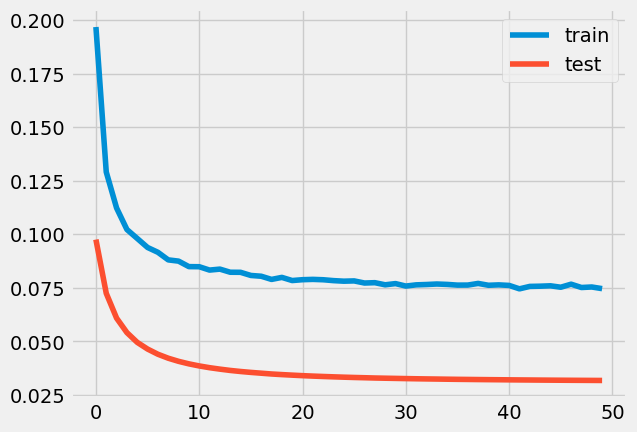

0.6928839080781029
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 12s 238ms/step - loss: 0.1430 - accuracy: 0.0000e+00 - val_loss: 0.0584 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 4s 143ms/step - loss: 0.0989 - accuracy: 5.9016e-04 - val_loss: 0.0445 - val_accuracy: 0.0000e

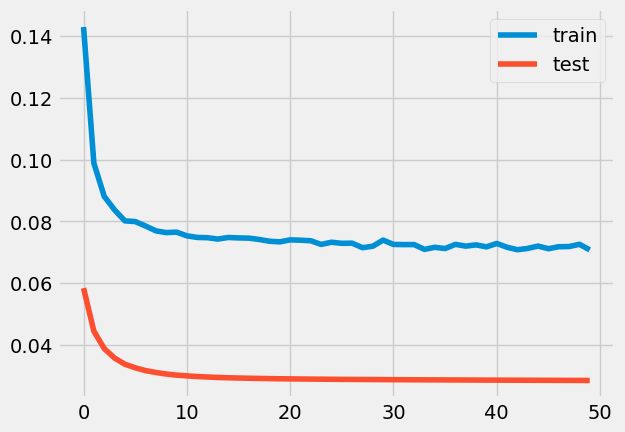

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 9s 164ms/step - loss: 0.1162 - accuracy: 9.2076e-04 - val_loss: 0.0399 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 124ms/step - loss: 0.0829 - accuracy: 0.0035 - val_loss: 0.0321 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [==

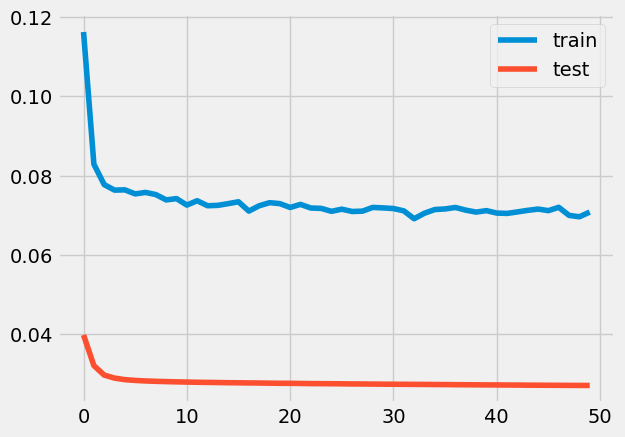

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 11s 203ms/step - loss: 0.1315 - accuracy: 0.0000e+00 - val_loss: 0.0476 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 4s 140ms/step - loss: 0.0905 - accuracy: 0.0012 - val_loss: 0.0368 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [=

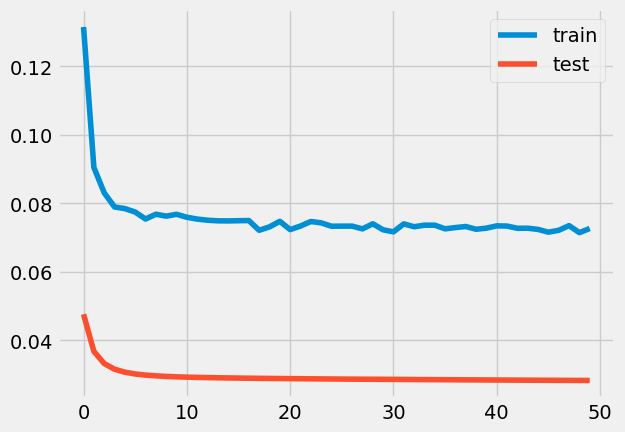

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 9s 167ms/step - loss: 0.2735 - accuracy: 0.0000e+00 - val_loss: 0.1729 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 117ms/step - loss: 0.1937 - accuracy: 0.0000e+00 - val_loss: 0.1380 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26

26/26 [==============================] - 3s 118ms/step - loss: 0.0841 - accuracy: 0.0015 - val_loss: 0.0395 - val_accuracy: 0.0000e+00

loss: 3.95%



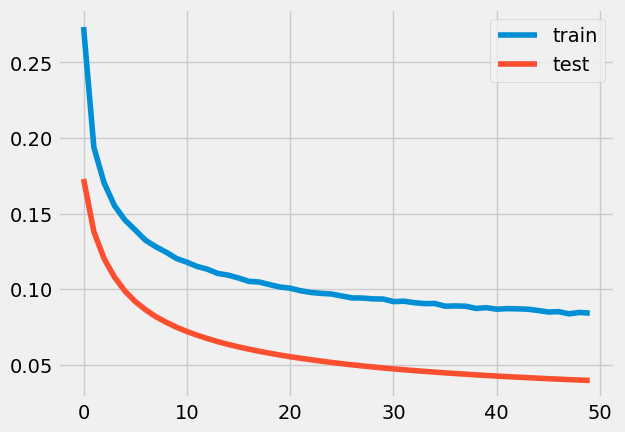

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 211ms/step - loss: 0.3611 - accuracy: 0.0000e+00 - val_loss: 0.2522 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 124ms/step - loss: 0.2612 - accuracy: 0.0000e+00 - val_loss: 0.2068 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 3s 130ms/step - loss: 0.1021 - accuracy: 1.4344e-04 - val_loss: 0.0584 - val_accuracy: 0.0000e+00

loss: 5.84%



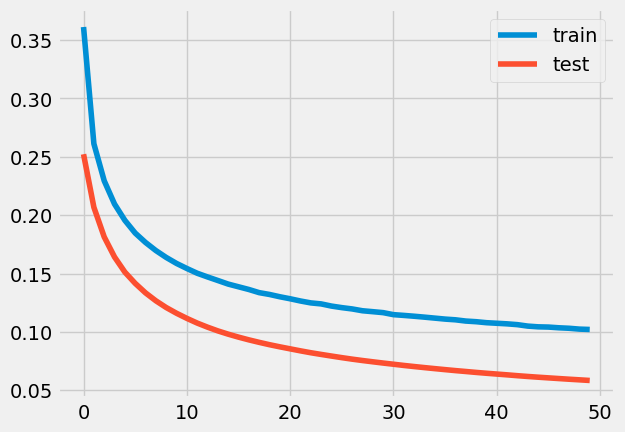

0.21995788529278723
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 10s 165ms/step - loss: 0.2424 - accuracy: 0.0000e+00 - val_loss: 0.1402 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 111ms/step - loss: 0.1632 - accuracy: 0.0000e+00 - val_loss: 0.1072 - val_accuracy: 0.0000

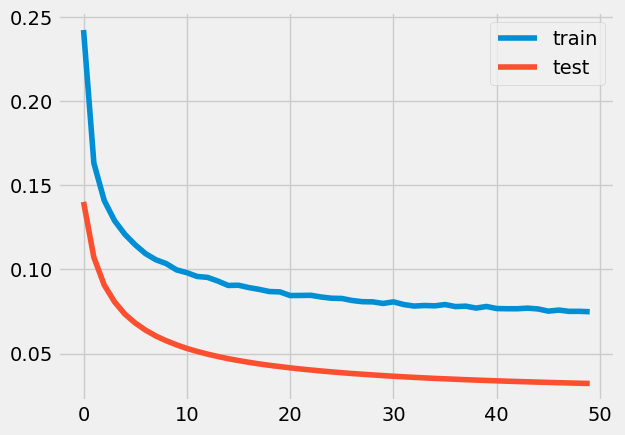

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 10s 167ms/step - loss: 0.3200 - accuracy: 0.0000e+00 - val_loss: 0.2073 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 130ms/step - loss: 0.2194 - accuracy: 0.0000e+00 - val_loss: 0.1637 - val_accuracy: 0.0000e+00
Epoch 3/50
26/2

Epoch 50/50
26/26 [==============================] - 3s 128ms/step - loss: 0.0849 - accuracy: 0.0012 - val_loss: 0.0427 - val_accuracy: 0.0000e+00

loss: 4.27%



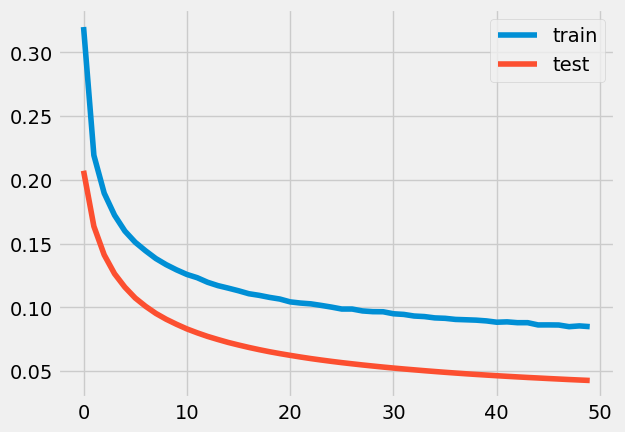

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 10s 183ms/step - loss: 0.1606 - accuracy: 0.0000e+00 - val_loss: 0.0692 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 4s 138ms/step - loss: 0.1054 - accuracy: 3.4426e-04 - val_loss: 0.0501 - val_accuracy: 0.0000e+00
Epoch 3/50
26/2

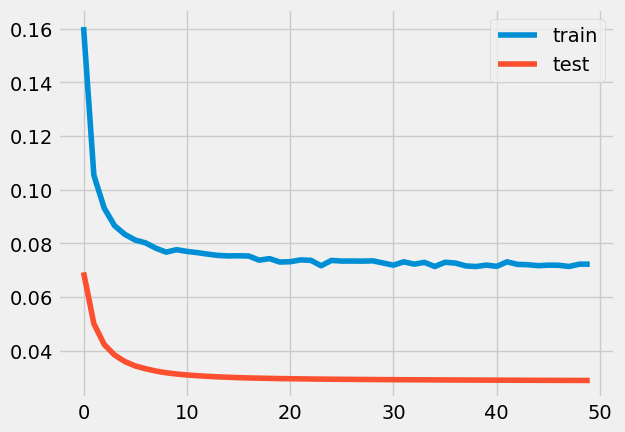

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 11s 141ms/step - loss: 0.1801 - accuracy: 0.0000e+00 - val_loss: 0.0941 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 94ms/step - loss: 0.1293 - accuracy: 0.0000e+00 - val_loss: 0.0737 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31

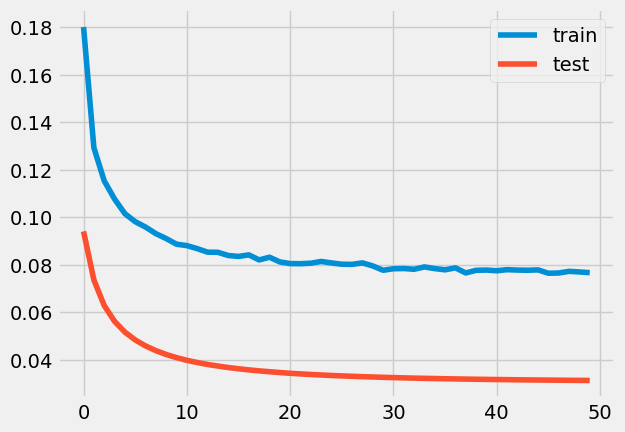

0.8271014008383594
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 7s 121ms/step - loss: 0.2562 - accuracy: 0.0000e+00 - val_loss: 0.1588 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 93ms/step - loss: 0.1804 - accuracy: 0.0000e+00 - val_loss: 0.1262 - val_accuracy: 0.0000e+0


loss: 3.69%



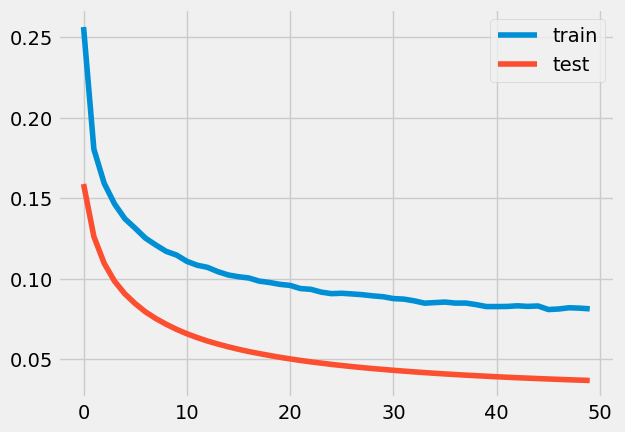

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 8s 125ms/step - loss: 0.1554 - accuracy: 0.0000e+00 - val_loss: 0.0657 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 3s 90ms/step - loss: 0.1023 - accuracy: 7.8092e-04 - val_loss: 0.0473 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 

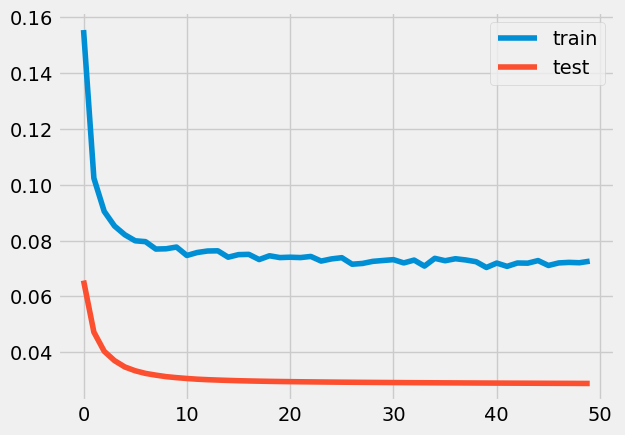

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 7s 126ms/step - loss: 0.2085 - accuracy: 0.0000e+00 - val_loss: 0.1118 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 3s 94ms/step - loss: 0.1417 - accuracy: 0.0000e+00 - val_loss: 0.0847 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 

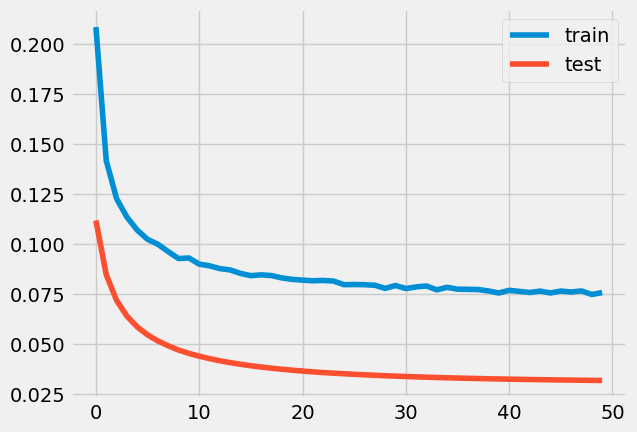

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 6s 147ms/step - loss: 0.1652 - accuracy: 0.0000e+00 - val_loss: 0.0753 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 92ms/step - loss: 0.1124 - accuracy: 6.9945e-05 - val_loss: 0.0560 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 

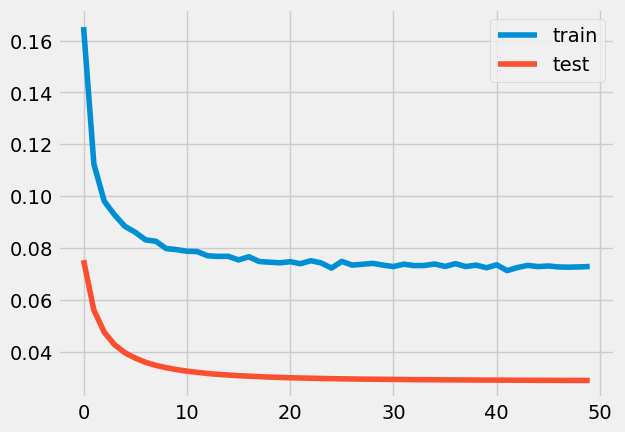

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 6s 132ms/step - loss: 0.1695 - accuracy: 0.0000e+00 - val_loss: 0.0722 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 85ms/step - loss: 0.1083 - accuracy: 1.7486e-04 - val_loss: 0.0524 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 

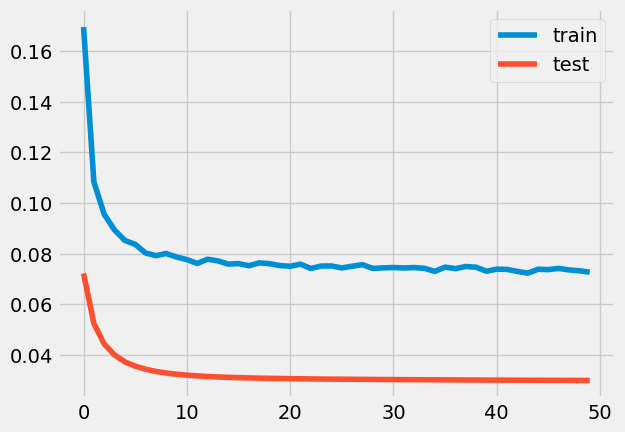

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 7s 129ms/step - loss: 0.1903 - accuracy: 0.0000e+00 - val_loss: 0.0927 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 2s 96ms/step - loss: 0.1242 - accuracy: 0.0000e+00 - val_loss: 0.0687 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 

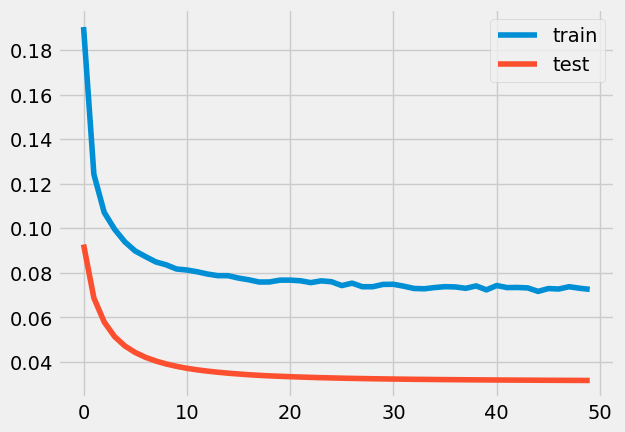

0.8667097377593299
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 7s 128ms/step - loss: 0.2858 - accuracy: 0.0000e+00 - val_loss: 0.1909 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 2s 91ms/step - loss: 0.2093 - accuracy: 0.0000e+00 - val_loss: 0.1575 - val_accuracy: 0.0000e+0

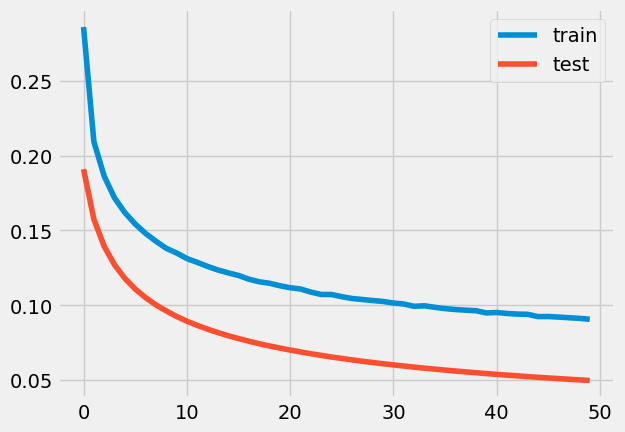

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 7s 130ms/step - loss: 0.0797 - accuracy: 0.0052 - val_loss: 0.0288 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 90ms/step - loss: 0.0783 - accuracy: 0.0053 - val_loss: 0.0281 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [=======

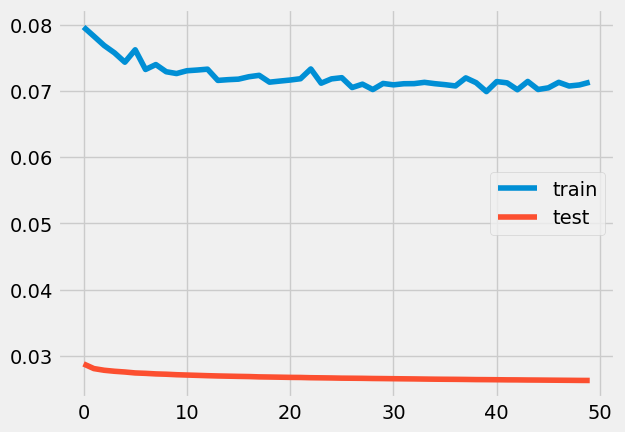

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 8s 120ms/step - loss: 0.0845 - accuracy: 0.0047 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 85ms/step - loss: 0.0755 - accuracy: 0.0059 - val_loss: 0.0280 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [=======

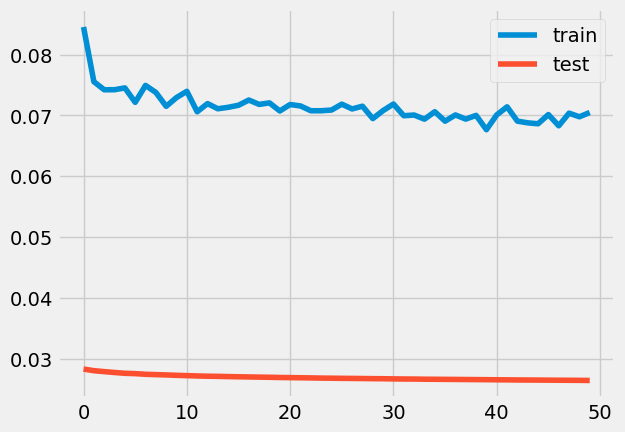

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 8s 114ms/step - loss: 0.1614 - accuracy: 0.0000e+00 - val_loss: 0.0704 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 85ms/step - loss: 0.1051 - accuracy: 8.5246e-05 - val_loss: 0.0514 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 

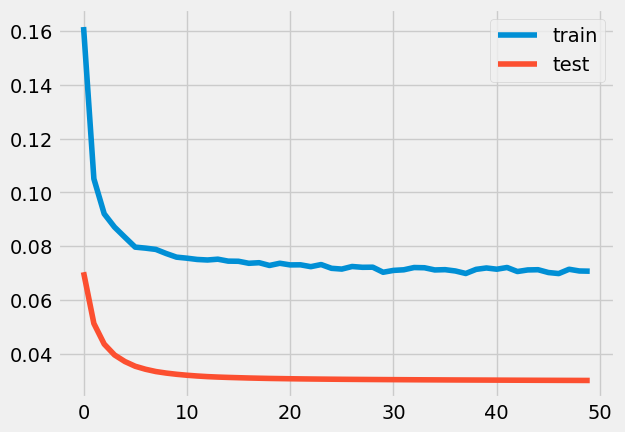

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 7s 125ms/step - loss: 0.0785 - accuracy: 0.0047 - val_loss: 0.0276 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 2s 87ms/step - loss: 0.0749 - accuracy: 0.0044 - val_loss: 0.0266 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [=======

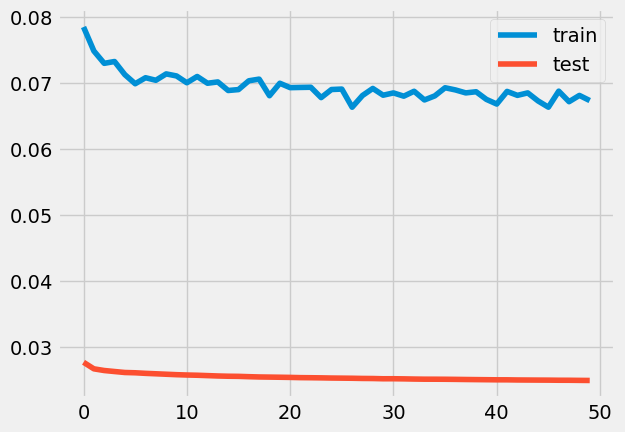

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 8s 138ms/step - loss: 0.2283 - accuracy: 0.0000e+00 - val_loss: 0.1362 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 96ms/step - loss: 0.1631 - accuracy: 0.0000e+00 - val_loss: 0.1069 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 

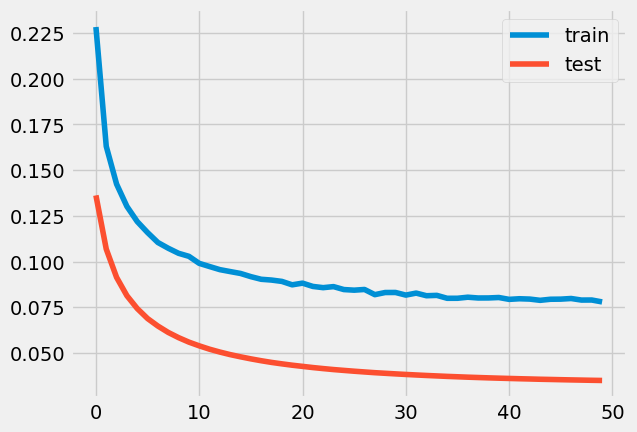

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 161ms/step - loss: 0.2659 - accuracy: 0.0000e+00 - val_loss: 0.1697 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.1930 - accuracy: 0.0000e+00 - val_loss: 0.1360 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

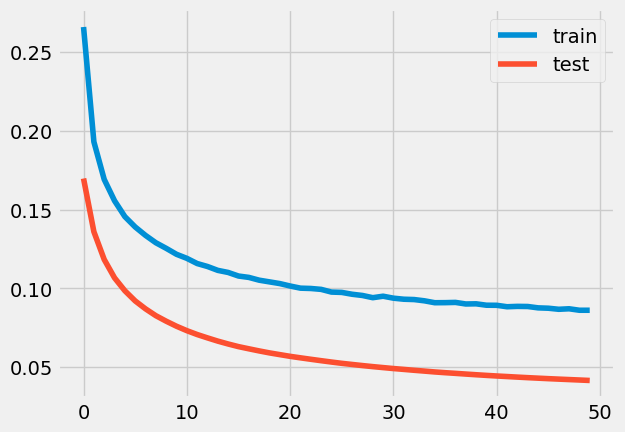

0.5924427479635013
0.00625
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 9s 147ms/step - loss: 0.2042 - accuracy: 0.0000e+00 - val_loss: 0.1207 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 103ms/step - loss: 0.1517 - accuracy: 0.0000e+00 - val_loss: 0.0976 - val_accuracy: 

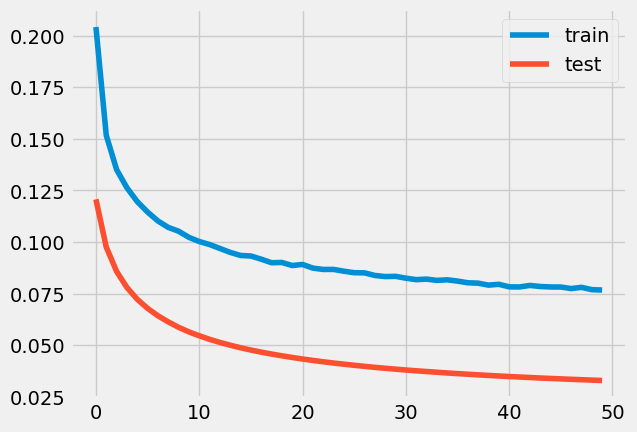

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 8s 160ms/step - loss: 0.2403 - accuracy: 0.0000e+00 - val_loss: 0.1423 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 109ms/step - loss: 0.1670 - accuracy: 0.0000e+00 - val_loss: 0.1120 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22

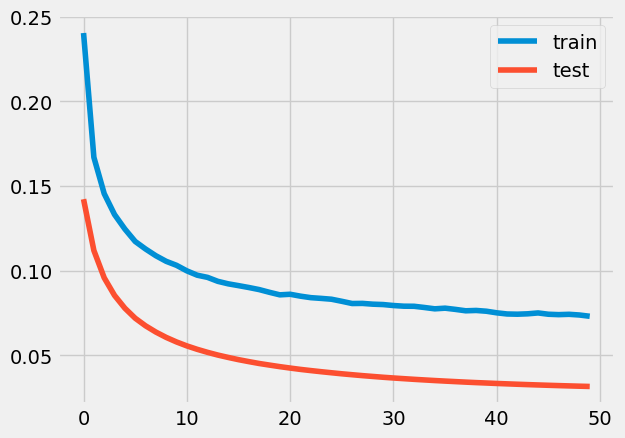

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 7s 157ms/step - loss: 0.1549 - accuracy: 0.0000e+00 - val_loss: 0.0725 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 104ms/step - loss: 0.1116 - accuracy: 2.8146e-04 - val_loss: 0.0562 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22

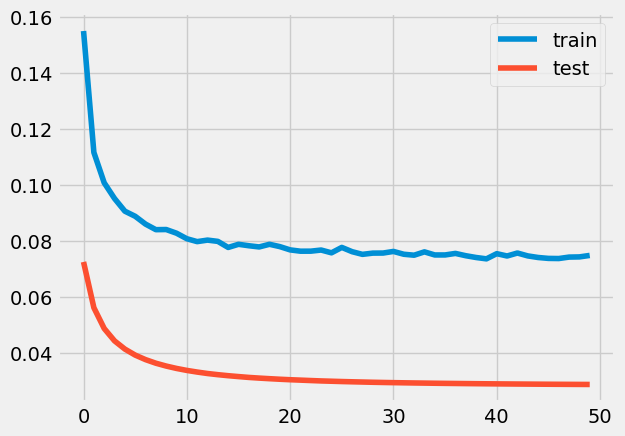

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 8s 137ms/step - loss: 0.1823 - accuracy: 0.0000e+00 - val_loss: 0.0848 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 104ms/step - loss: 0.1187 - accuracy: 6.5574e-06 - val_loss: 0.0641 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31

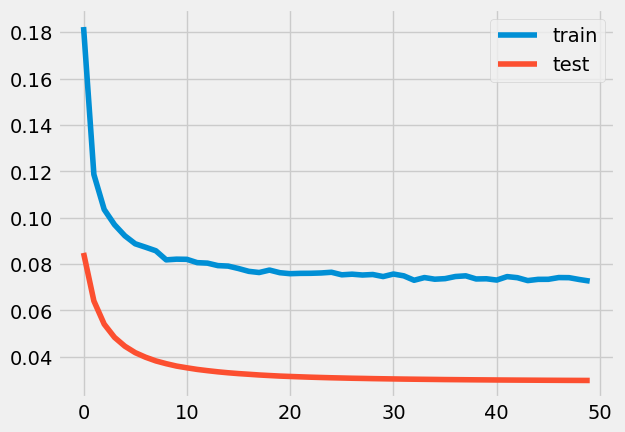

0.8489293949534177
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 9s 146ms/step - loss: 0.1097 - accuracy: 4.3091e-04 - val_loss: 0.0370 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 111ms/step - loss: 0.0830 - accuracy: 0.0033 - val_loss: 0.0310 - val_accuracy: 0.0000e+00
E

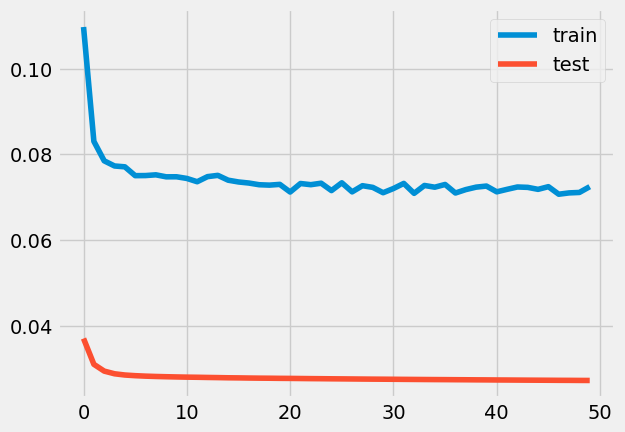

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 9s 240ms/step - loss: 0.2027 - accuracy: 0.0000e+00 - val_loss: 0.1127 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 3s 160ms/step - loss: 0.1440 - accuracy: 0.0000e+00 - val_loss: 0.0886 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17


loss: 2.89%



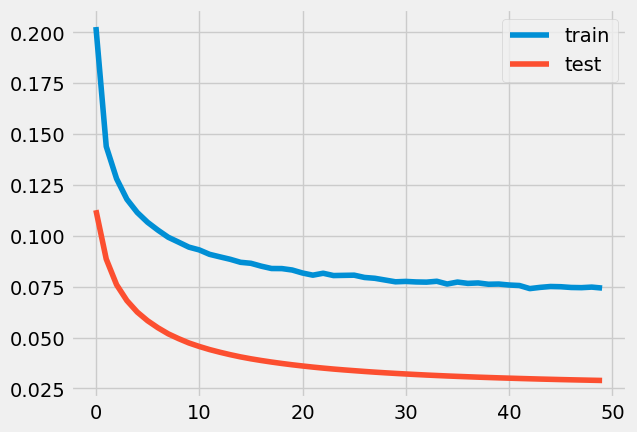

0.7573555510269974
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 6s 133ms/step - loss: 0.0993 - accuracy: 0.0019 - val_loss: 0.0308 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 88ms/step - loss: 0.0780 - accuracy: 0.0049 - val_loss: 0.0274 - val_accuracy: 0.0000e+00
Epoch 

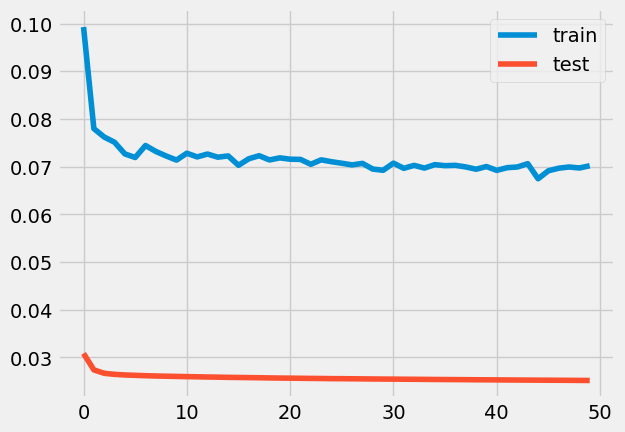

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 135ms/step - loss: 0.1033 - accuracy: 0.0017 - val_loss: 0.0313 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0785 - accuracy: 0.0046 - val_loss: 0.0282 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

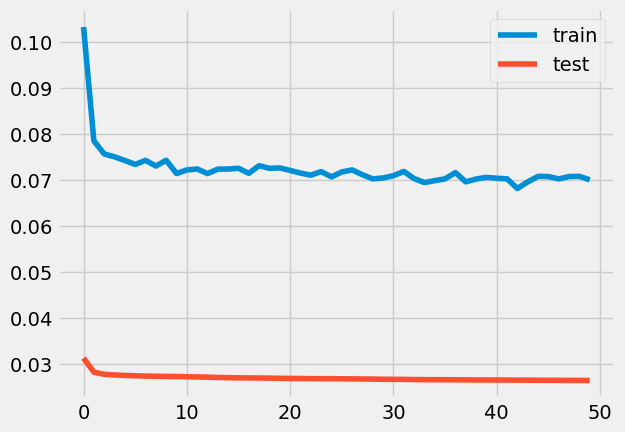

0.8174798977454817
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 159ms/step - loss: 0.1269 - accuracy: 5.5328e-04 - val_loss: 0.0488 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 96ms/step - loss: 0.0928 - accuracy: 0.0011 - val_loss: 0.0385 - val_accuracy: 0.0000e+00
Ep

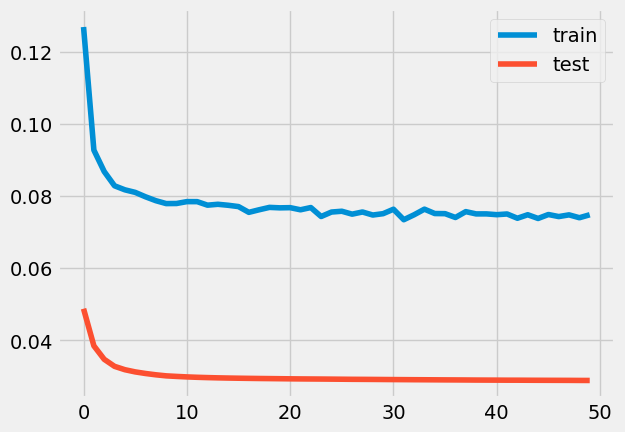

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 8s 158ms/step - loss: 0.3340 - accuracy: 0.0000e+00 - val_loss: 0.2475 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 107ms/step - loss: 0.2636 - accuracy: 0.0000e+00 - val_loss: 0.2141 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22

Epoch 50/50
22/22 [==============================] - 2s 108ms/step - loss: 0.1302 - accuracy: 0.0000e+00 - val_loss: 0.0892 - val_accuracy: 0.0000e+00

loss: 8.92%



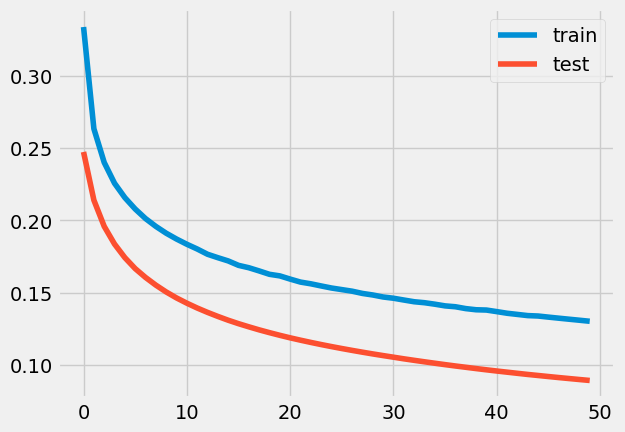

6.517350111233231e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 162ms/step - loss: 0.1649 - accuracy: 0.0000e+00 - val_loss: 0.0809 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 99ms/step - loss: 0.1177 - accuracy: 3.6885e-05 - val_loss: 0.0619 - val_accuracy: 0.0000

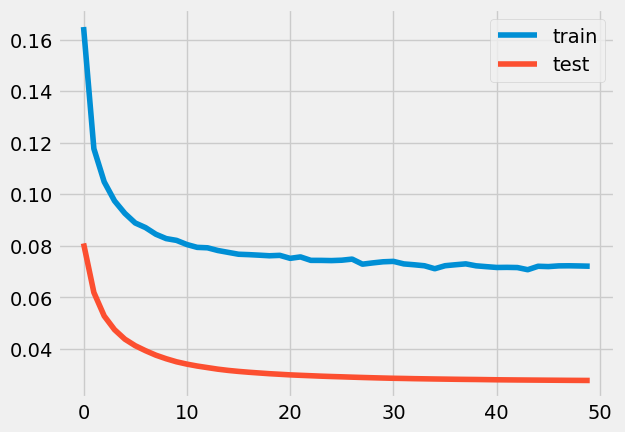

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 8s 138ms/step - loss: 0.2003 - accuracy: 0.0000e+00 - val_loss: 0.1113 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 3s 94ms/step - loss: 0.1430 - accuracy: 0.0000e+00 - val_loss: 0.0885 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 

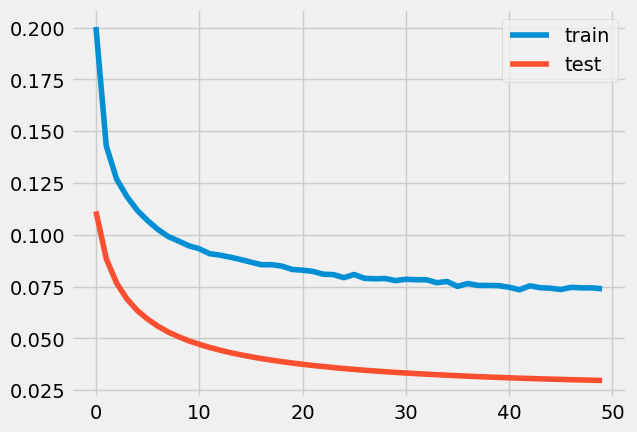

0.7355929564730106
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 9s 135ms/step - loss: 0.2355 - accuracy: 0.0000e+00 - val_loss: 0.1392 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 3s 99ms/step - loss: 0.1638 - accuracy: 0.0000e+00 - val_loss: 0.1082 - val_accuracy: 0.0000e+0

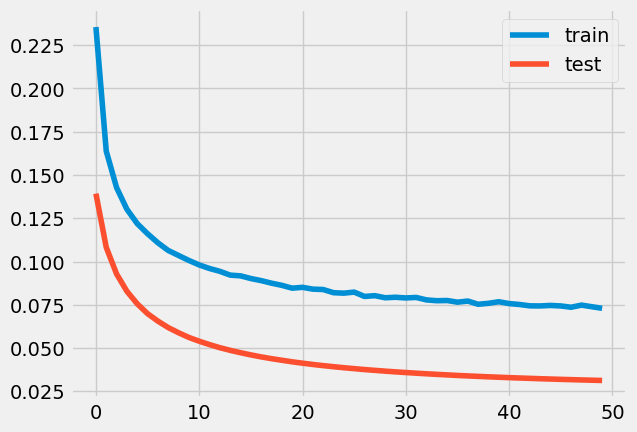

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 10s 216ms/step - loss: 0.1048 - accuracy: 0.0019 - val_loss: 0.0328 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 3s 134ms/step - loss: 0.0788 - accuracy: 0.0043 - val_loss: 0.0289 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [=====

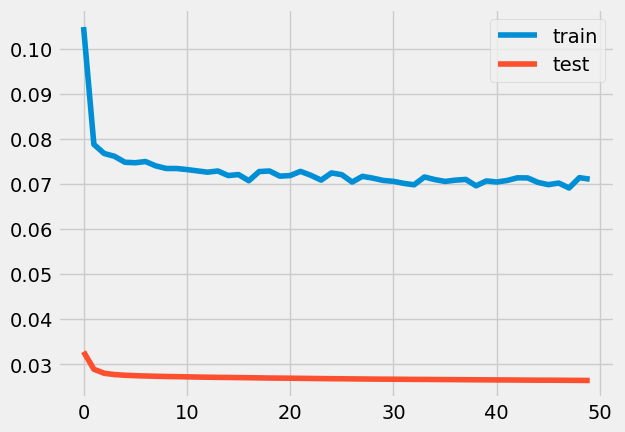

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 9s 156ms/step - loss: 0.2615 - accuracy: 0.0000e+00 - val_loss: 0.1664 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 97ms/step - loss: 0.1901 - accuracy: 0.0000e+00 - val_loss: 0.1342 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 

Epoch 50/50
21/21 [==============================] - 2s 112ms/step - loss: 0.0880 - accuracy: 6.9727e-04 - val_loss: 0.0435 - val_accuracy: 0.0000e+00

loss: 4.35%



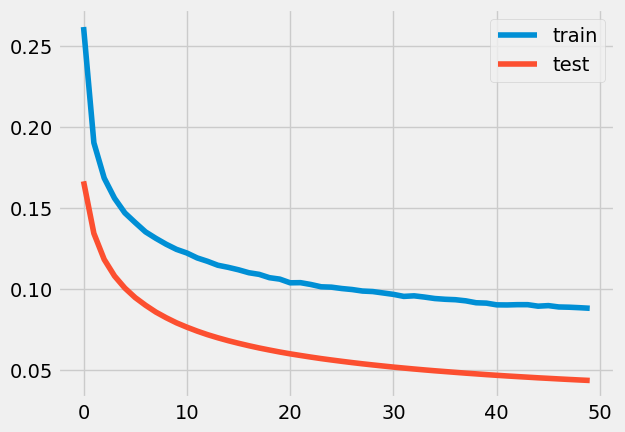

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 163ms/step - loss: 0.1559 - accuracy: 0.0000e+00 - val_loss: 0.0629 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 96ms/step - loss: 0.1019 - accuracy: 4.3648e-04 - val_loss: 0.0465 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

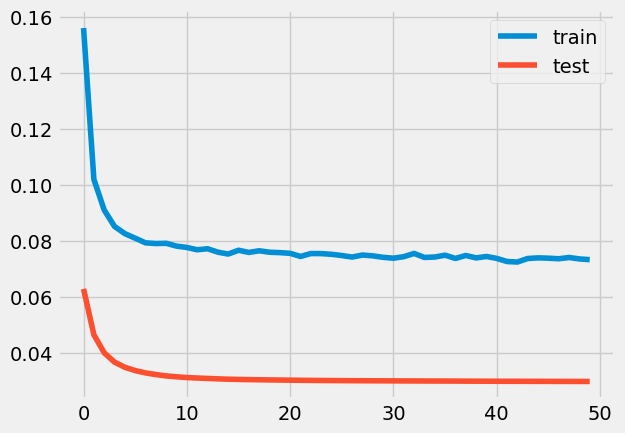

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 250ms/step - loss: 0.2535 - accuracy: 0.0000e+00 - val_loss: 0.1539 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 149ms/step - loss: 0.1789 - accuracy: 0.0000e+00 - val_loss: 0.1232 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

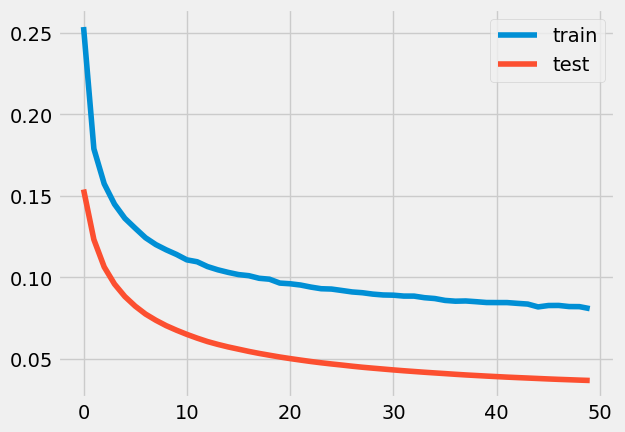

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 7s 158ms/step - loss: 0.1466 - accuracy: 4.7690e-05 - val_loss: 0.0648 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 115ms/step - loss: 0.1033 - accuracy: 1.9438e-04 - val_loss: 0.0496 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22

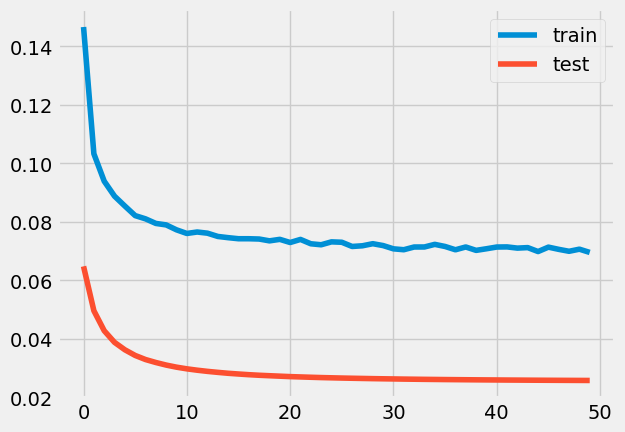

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 7s 149ms/step - loss: 0.2138 - accuracy: 0.0000e+00 - val_loss: 0.1343 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 103ms/step - loss: 0.1665 - accuracy: 0.0000e+00 - val_loss: 0.1118 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22

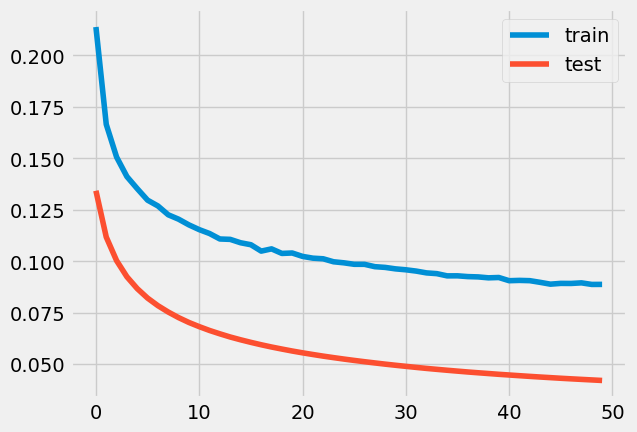

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 13s 395ms/step - loss: 0.1721 - accuracy: 0.0000e+00 - val_loss: 0.0867 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 3s 157ms/step - loss: 0.1236 - accuracy: 0.0000e+00 - val_loss: 0.0671 - val_accuracy: 0.0000e+00
Epoch 3/50
17/1

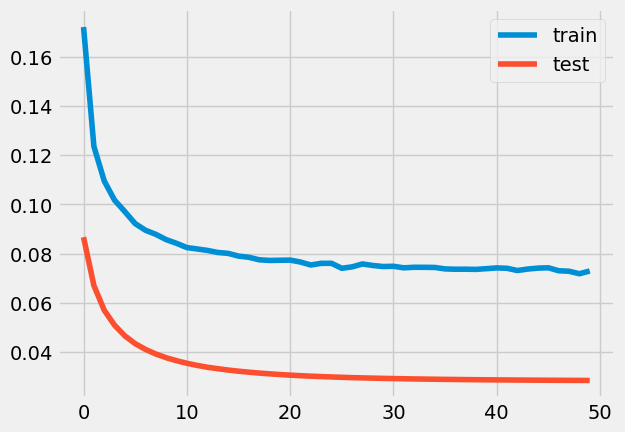

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 9s 206ms/step - loss: 0.2793 - accuracy: 0.0000e+00 - val_loss: 0.1793 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 3s 158ms/step - loss: 0.1998 - accuracy: 0.0000e+00 - val_loss: 0.1433 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17

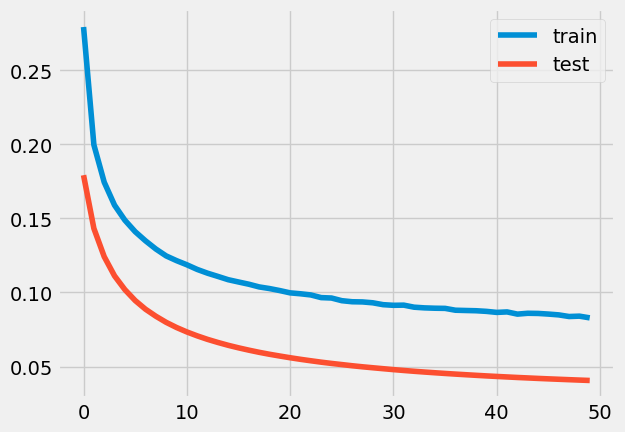

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 8s 183ms/step - loss: 0.2331 - accuracy: 0.0000e+00 - val_loss: 0.1467 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 3s 131ms/step - loss: 0.1756 - accuracy: 0.0000e+00 - val_loss: 0.1208 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22

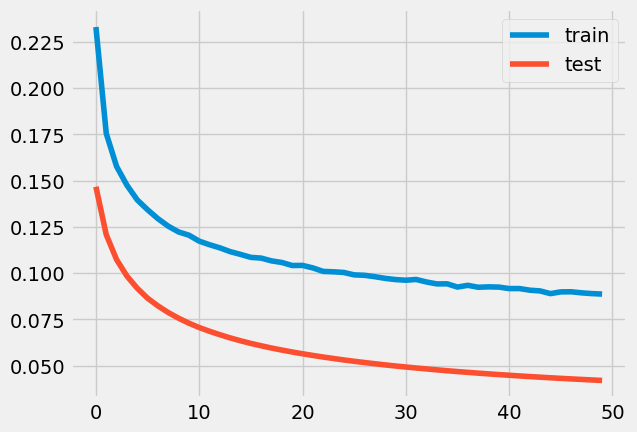

0.7983426862052232
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 9s 191ms/step - loss: 0.1799 - accuracy: 0.0000e+00 - val_loss: 0.0881 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 3s 128ms/step - loss: 0.1233 - accuracy: 0.0000e+00 - val_loss: 0.0677 - val_accuracy: 0.0000e+


loss: 2.96%



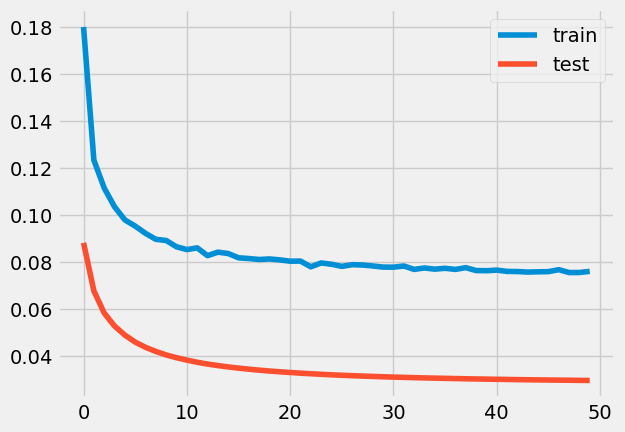

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 177ms/step - loss: 0.2793 - accuracy: 0.0000e+00 - val_loss: 0.1733 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.1937 - accuracy: 0.0000e+00 - val_loss: 0.1386 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

Epoch 50/50
20/20 [==============================] - 3s 129ms/step - loss: 0.0859 - accuracy: 9.0164e-04 - val_loss: 0.0412 - val_accuracy: 0.0000e+00

loss: 4.12%



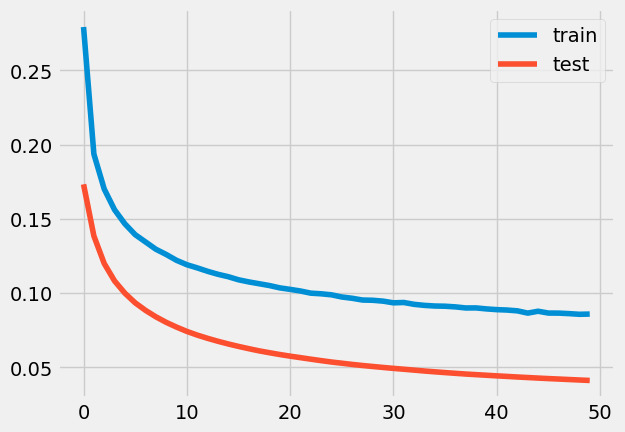

0.15529314265131602
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 200ms/step - loss: 0.1121 - accuracy: 0.0013 - val_loss: 0.0379 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 157ms/step - loss: 0.0846 - accuracy: 0.0035 - val_loss: 0.0314 - val_accuracy: 0.0000e+00
Epo

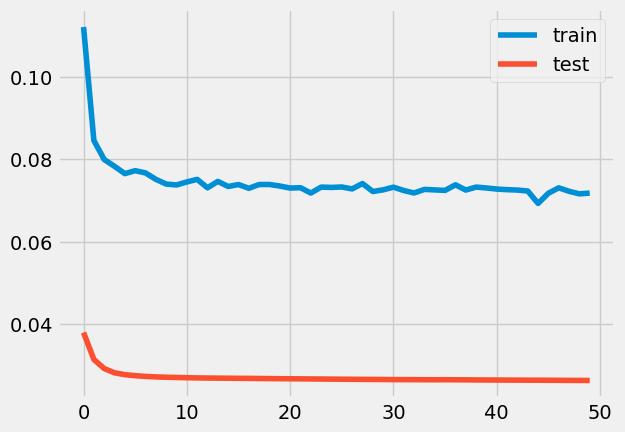

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 201ms/step - loss: 0.1752 - accuracy: 0.0000e+00 - val_loss: 0.0789 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 139ms/step - loss: 0.1130 - accuracy: 0.0000e+00 - val_loss: 0.0565 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

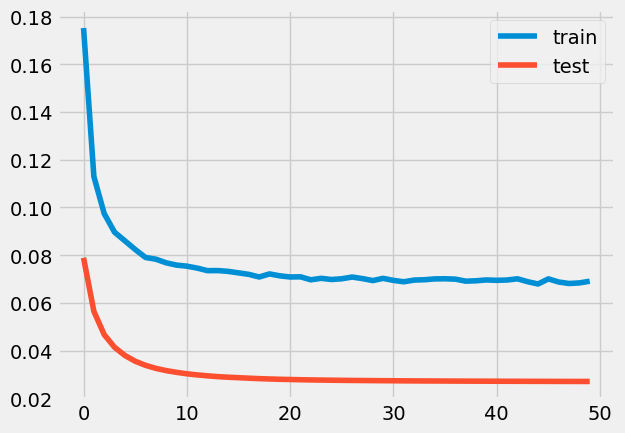

0.8780762270638331
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 231ms/step - loss: 0.2006 - accuracy: 0.0000e+00 - val_loss: 0.1016 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 142ms/step - loss: 0.1333 - accuracy: 0.0000e+00 - val_loss: 0.0757 - val_accuracy: 0.0000e+


loss: 2.85%



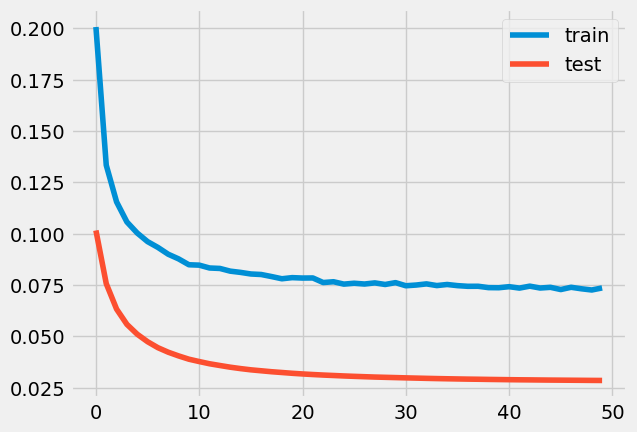

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 9s 153ms/step - loss: 0.1708 - accuracy: 0.0000e+00 - val_loss: 0.0835 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 114ms/step - loss: 0.1163 - accuracy: 2.7322e-05 - val_loss: 0.0629 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26

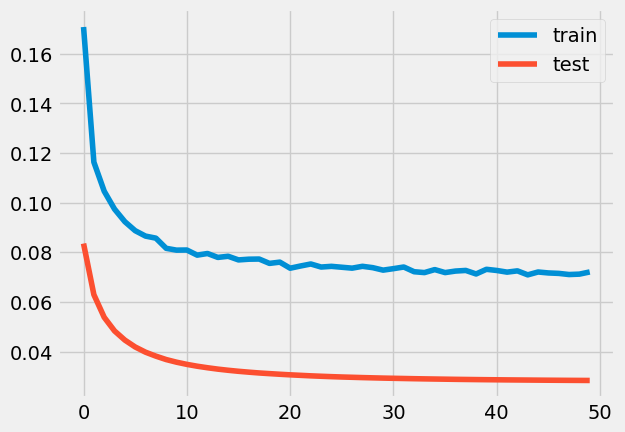

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 8s 143ms/step - loss: 0.2206 - accuracy: 0.0000e+00 - val_loss: 0.1269 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 102ms/step - loss: 0.1540 - accuracy: 0.0000e+00 - val_loss: 0.0979 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26


loss: 3.22%



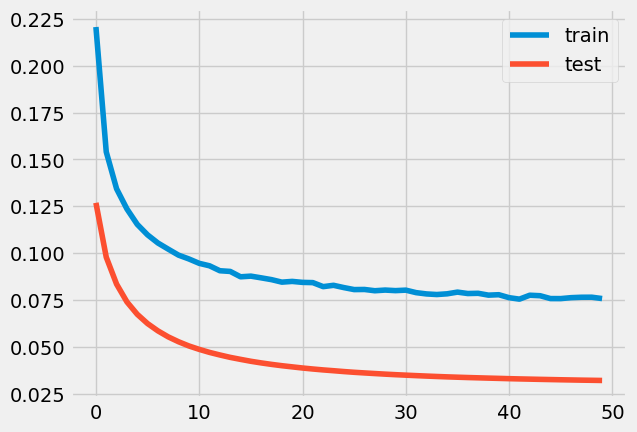

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 8s 148ms/step - loss: 0.2007 - accuracy: 0.0000e+00 - val_loss: 0.1156 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 101ms/step - loss: 0.1484 - accuracy: 0.0000e+00 - val_loss: 0.0927 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26


loss: 3.23%



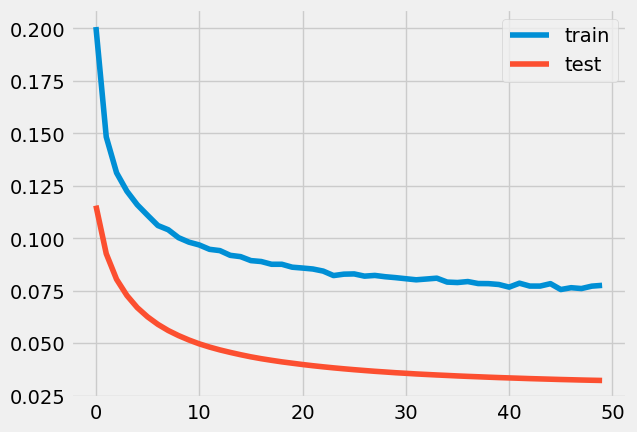

0.9827307984300327
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 8s 145ms/step - loss: 0.2995 - accuracy: 0.0000e+00 - val_loss: 0.2017 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 103ms/step - loss: 0.2196 - accuracy: 0.0000e+00 - val_loss: 0.1653 - val_accuracy: 0.0000e+

Epoch 50/50
26/26 [==============================] - 3s 105ms/step - loss: 0.0932 - accuracy: 6.7814e-04 - val_loss: 0.0490 - val_accuracy: 0.0000e+00

loss: 4.90%



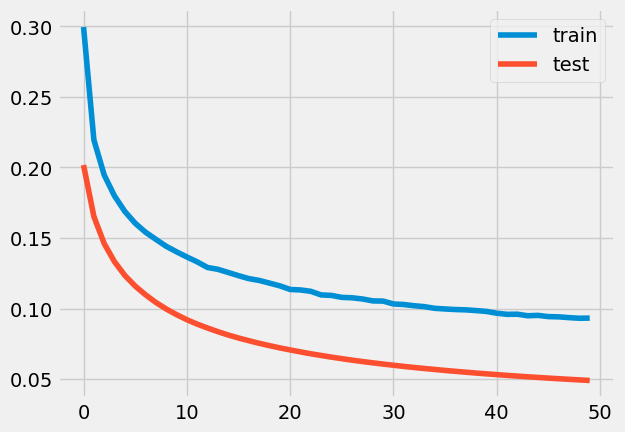

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 8s 149ms/step - loss: 0.1286 - accuracy: 4.3716e-05 - val_loss: 0.0480 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 103ms/step - loss: 0.0917 - accuracy: 0.0026 - val_loss: 0.0378 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [==

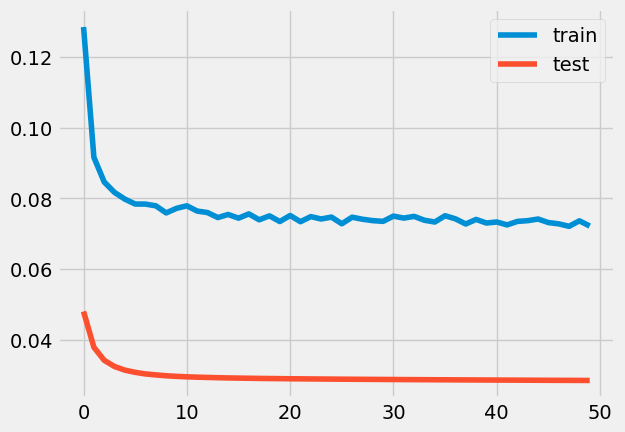

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 9s 152ms/step - loss: 0.1546 - accuracy: 0.0000e+00 - val_loss: 0.0670 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 105ms/step - loss: 0.1045 - accuracy: 3.1148e-04 - val_loss: 0.0496 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26

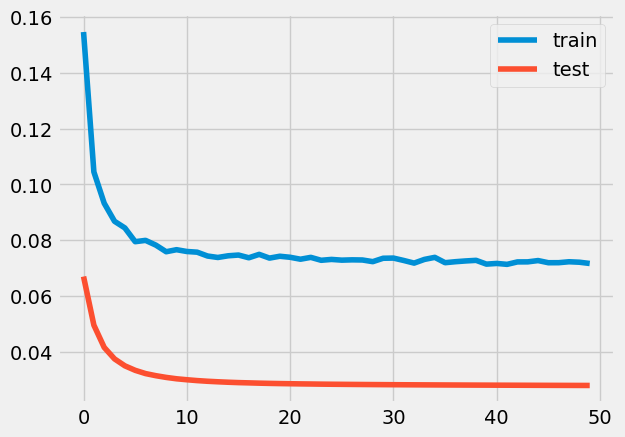

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 227ms/step - loss: 0.1110 - accuracy: 7.5205e-04 - val_loss: 0.0371 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 139ms/step - loss: 0.0834 - accuracy: 0.0035 - val_loss: 0.0310 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

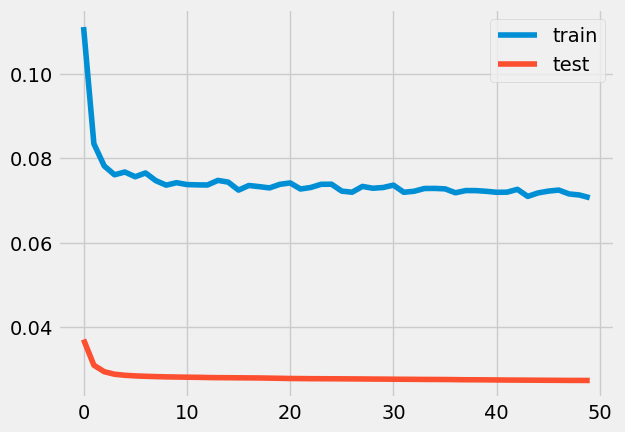

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 154ms/step - loss: 0.3279 - accuracy: 0.0000e+00 - val_loss: 0.2082 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 105ms/step - loss: 0.2213 - accuracy: 0.0000e+00 - val_loss: 0.1648 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

Epoch 50/50
20/20 [==============================] - 2s 102ms/step - loss: 0.0865 - accuracy: 8.6885e-04 - val_loss: 0.0444 - val_accuracy: 0.0000e+00

loss: 4.44%



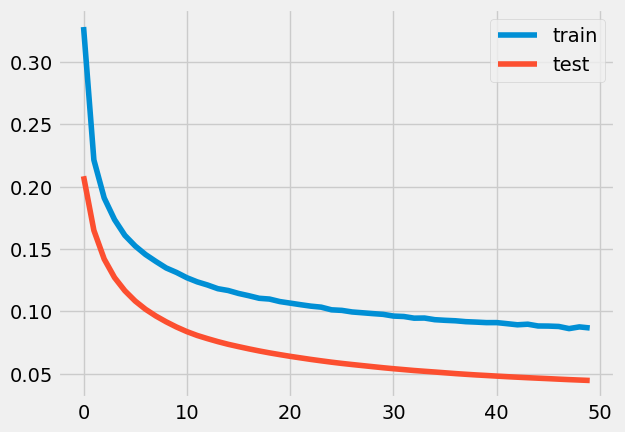

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 7s 146ms/step - loss: 0.1628 - accuracy: 0.0000e+00 - val_loss: 0.0778 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 96ms/step - loss: 0.1153 - accuracy: 1.8970e-04 - val_loss: 0.0598 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 

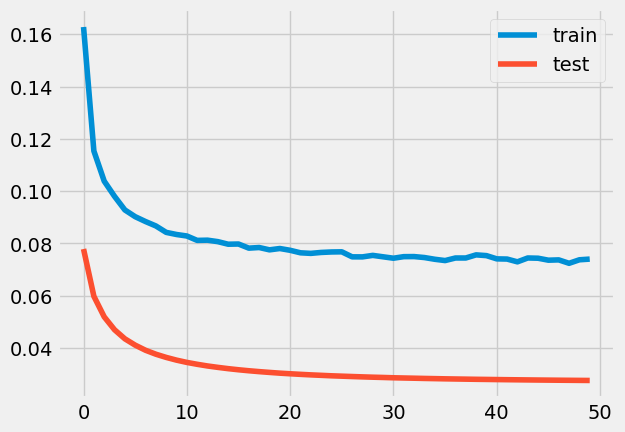

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 8s 152ms/step - loss: 0.1033 - accuracy: 0.0018 - val_loss: 0.0321 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 104ms/step - loss: 0.0800 - accuracy: 0.0049 - val_loss: 0.0301 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [======

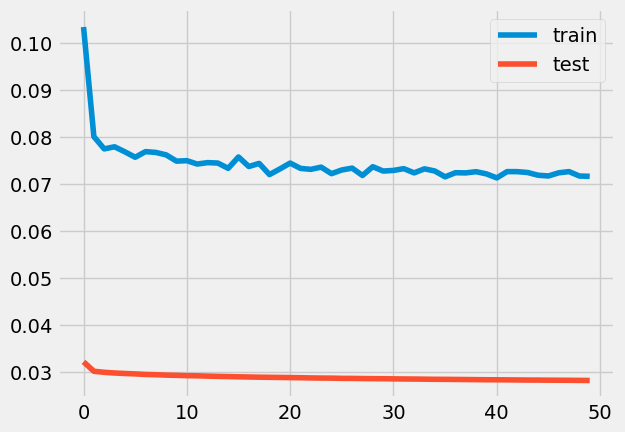

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 8s 145ms/step - loss: 0.1347 - accuracy: 7.5662e-05 - val_loss: 0.0545 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 2s 101ms/step - loss: 0.0951 - accuracy: 8.1715e-04 - val_loss: 0.0415 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24

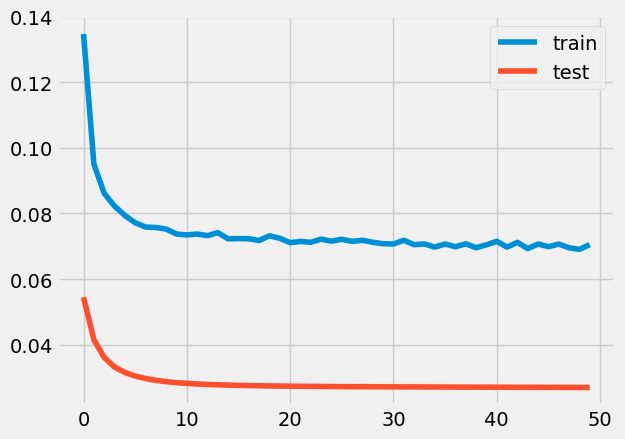

0.003125
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 9s 167ms/step - loss: 0.1679 - accuracy: 0.0000e+00 - val_loss: 0.0811 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 116ms/step - loss: 0.1157 - accuracy: 3.0265e-05 - val_loss: 0.0612 - val_accuracy: 0.0000e+00
Epoch 3

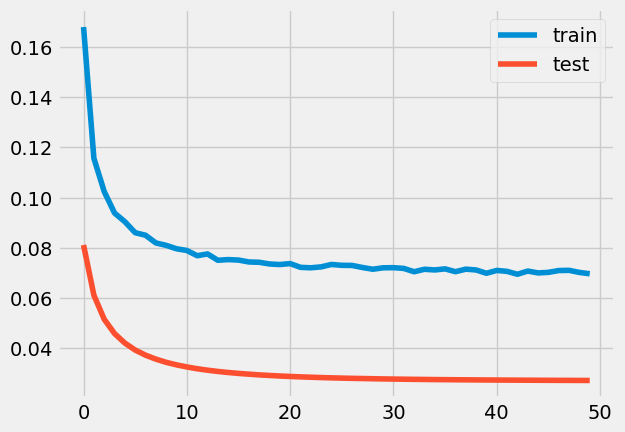

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 7s 139ms/step - loss: 0.1663 - accuracy: 0.0000e+00 - val_loss: 0.0755 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 97ms/step - loss: 0.1066 - accuracy: 1.5027e-04 - val_loss: 0.0544 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 

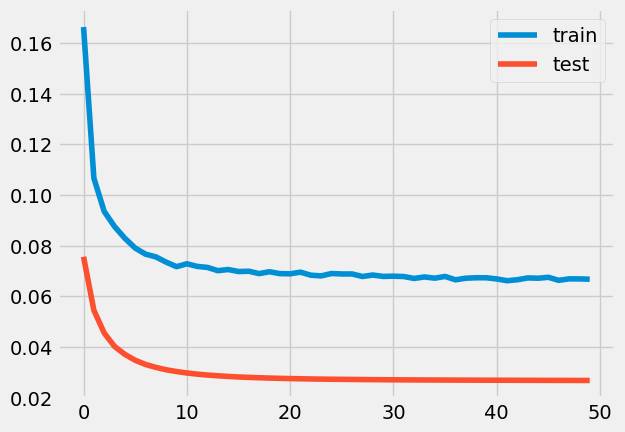

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 10s 172ms/step - loss: 0.3332 - accuracy: 0.0000e+00 - val_loss: 0.2386 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 111ms/step - loss: 0.2520 - accuracy: 0.0000e+00 - val_loss: 0.1994 - val_accuracy: 0.0000e+00
Epoch 3/50
26/2

Epoch 50/50
26/26 [==============================] - 3s 105ms/step - loss: 0.1060 - accuracy: 1.1093e-04 - val_loss: 0.0626 - val_accuracy: 0.0000e+00

loss: 6.26%



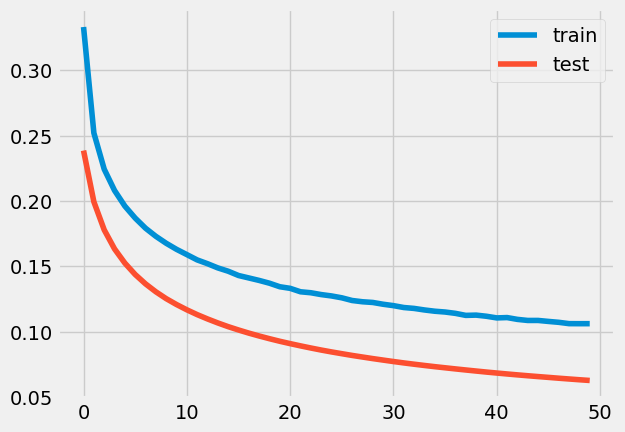

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 7s 159ms/step - loss: 0.1594 - accuracy: 0.0000e+00 - val_loss: 0.0678 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 106ms/step - loss: 0.1054 - accuracy: 3.1913e-04 - val_loss: 0.0504 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21

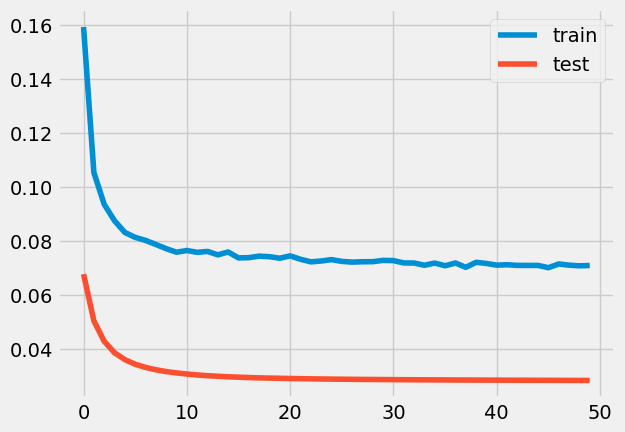

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 7s 163ms/step - loss: 0.1963 - accuracy: 0.0000e+00 - val_loss: 0.1108 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 107ms/step - loss: 0.1445 - accuracy: 0.0000e+00 - val_loss: 0.0894 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21


loss: 3.32%



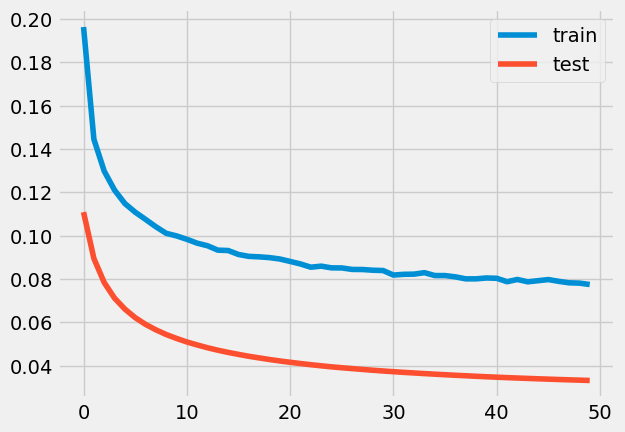

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 7s 174ms/step - loss: 0.2117 - accuracy: 0.0000e+00 - val_loss: 0.1258 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 107ms/step - loss: 0.1568 - accuracy: 0.0000e+00 - val_loss: 0.1021 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17

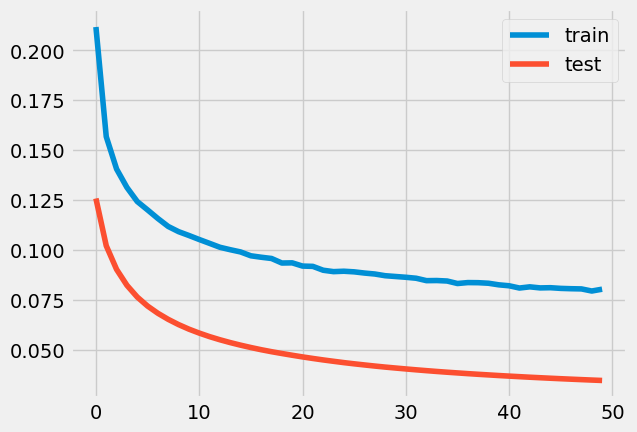

0.6342700033738072
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 181ms/step - loss: 0.2046 - accuracy: 0.0000e+00 - val_loss: 0.1110 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 122ms/step - loss: 0.1422 - accuracy: 0.0000e+00 - val_loss: 0.0855 - val_accuracy: 0.0000e+


loss: 3.06%



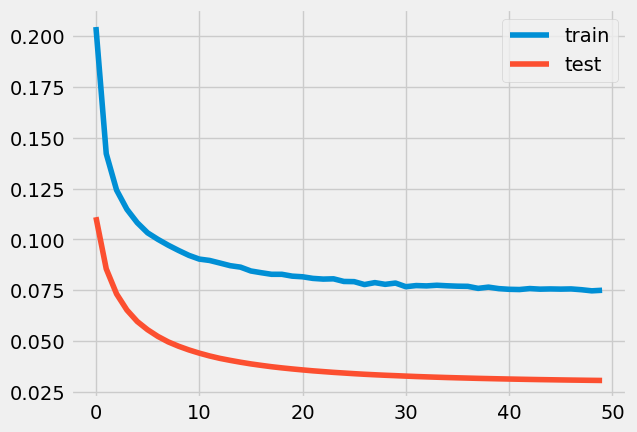

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 9s 170ms/step - loss: 0.2714 - accuracy: 0.0000e+00 - val_loss: 0.1799 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 2s 99ms/step - loss: 0.2031 - accuracy: 0.0000e+00 - val_loss: 0.1488 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 

Epoch 50/50
24/24 [==============================] - 3s 116ms/step - loss: 0.0945 - accuracy: 4.7415e-04 - val_loss: 0.0507 - val_accuracy: 0.0000e+00

loss: 5.07%



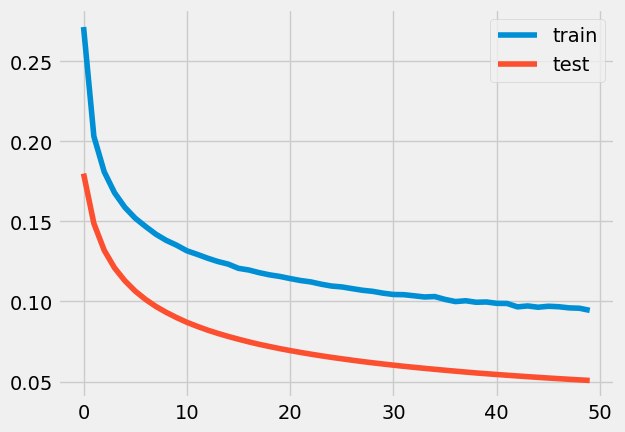

0.0016025760367778881
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 222ms/step - loss: 0.2325 - accuracy: 0.0000e+00 - val_loss: 0.1425 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 3s 165ms/step - loss: 0.1713 - accuracy: 0.0000e+00 - val_loss: 0.1161 - val_accuracy: 0.000

Epoch 50/50
17/17 [==============================] - 2s 117ms/step - loss: 0.0870 - accuracy: 0.0011 - val_loss: 0.0413 - val_accuracy: 0.0000e+00

loss: 4.13%



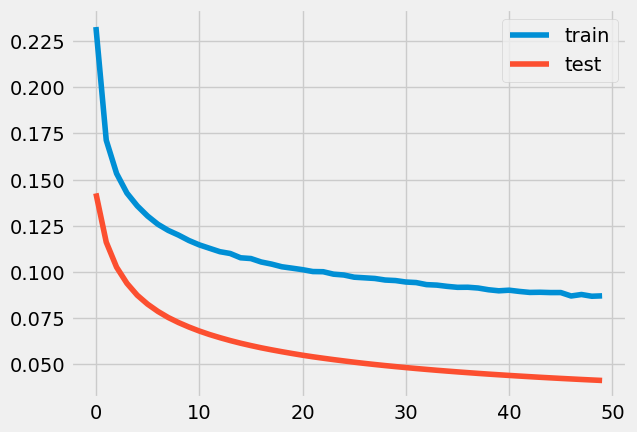

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 6s 190ms/step - loss: 0.2200 - accuracy: 0.0000e+00 - val_loss: 0.1265 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 125ms/step - loss: 0.1553 - accuracy: 0.0000e+00 - val_loss: 0.0981 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16

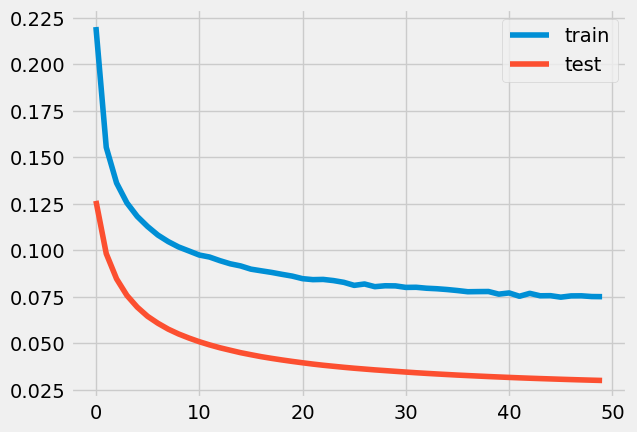

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 7s 189ms/step - loss: 0.1615 - accuracy: 0.0000e+00 - val_loss: 0.0800 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 117ms/step - loss: 0.1198 - accuracy: 1.4262e-04 - val_loss: 0.0631 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16

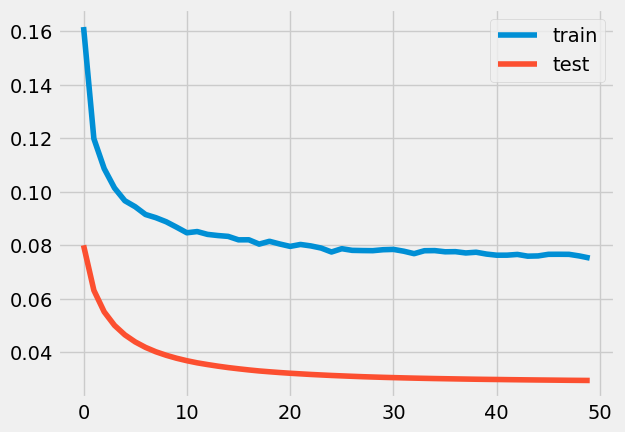

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 168ms/step - loss: 0.2446 - accuracy: 0.0000e+00 - val_loss: 0.1474 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 115ms/step - loss: 0.1728 - accuracy: 0.0000e+00 - val_loss: 0.1166 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

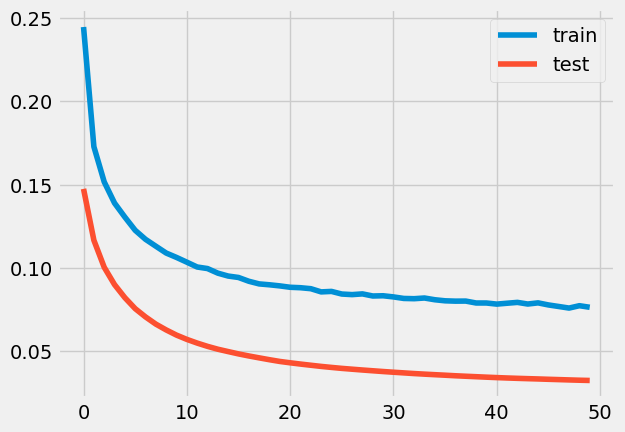

0.38963474375255674
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 7s 189ms/step - loss: 0.2724 - accuracy: 0.0000e+00 - val_loss: 0.1682 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 2s 115ms/step - loss: 0.1891 - accuracy: 0.0000e+00 - val_loss: 0.1299 - val_accuracy: 0.0000e

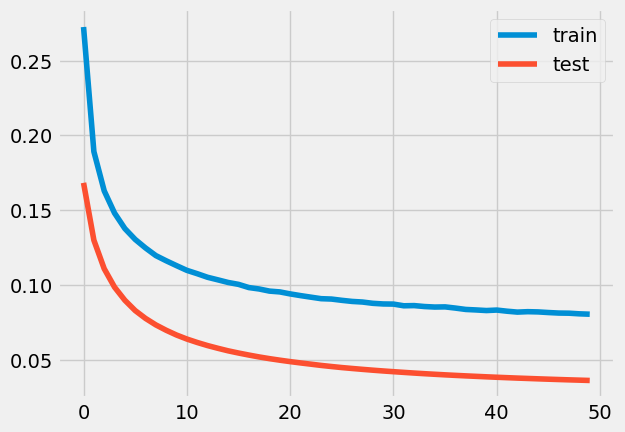

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 7s 206ms/step - loss: 0.1805 - accuracy: 0.0000e+00 - val_loss: 0.0912 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 136ms/step - loss: 0.1275 - accuracy: 0.0000e+00 - val_loss: 0.0705 - val_accuracy: 0.0000e+00
Epoch 3/50
14/14

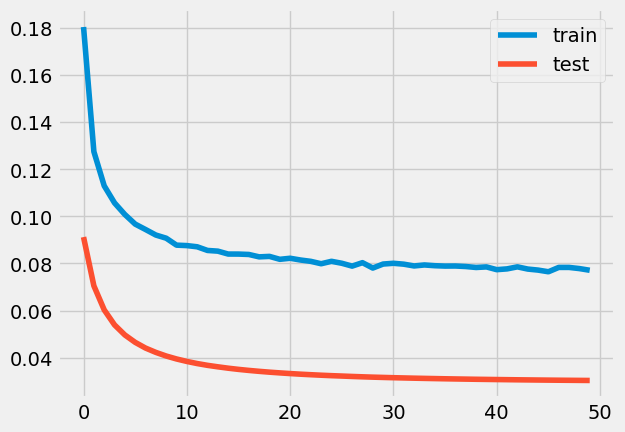

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 7s 212ms/step - loss: 0.1370 - accuracy: 3.7258e-05 - val_loss: 0.0508 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 134ms/step - loss: 0.0931 - accuracy: 0.0010 - val_loss: 0.0374 - val_accuracy: 0.0000e+00
Epoch 3/50
14/14 [==

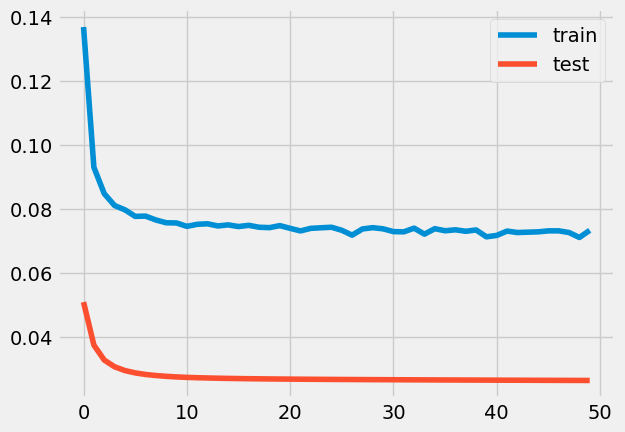

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
13/13 [==============================] - 6s 219ms/step - loss: 0.3161 - accuracy: 0.0000e+00 - val_loss: 0.2037 - val_accuracy: 0.0000e+00
Epoch 2/50
13/13 [==============================] - 2s 135ms/step - loss: 0.2221 - accuracy: 0.0000e+00 - val_loss: 0.1651 - val_accuracy: 0.0000e+00
Epoch 3/50
13/13

Epoch 50/50
13/13 [==============================] - 2s 147ms/step - loss: 0.0948 - accuracy: 6.6098e-04 - val_loss: 0.0493 - val_accuracy: 0.0000e+00

loss: 4.93%



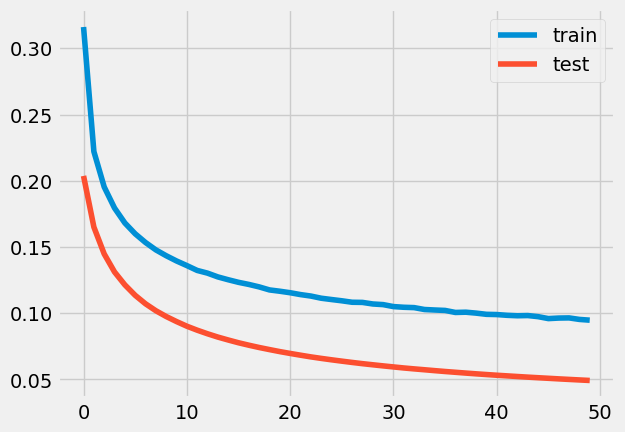

0.0006473202767457799
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 7s 228ms/step - loss: 0.2133 - accuracy: 0.0000e+00 - val_loss: 0.1251 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 133ms/step - loss: 0.1571 - accuracy: 0.0000e+00 - val_loss: 0.0998 - val_accuracy: 0.000

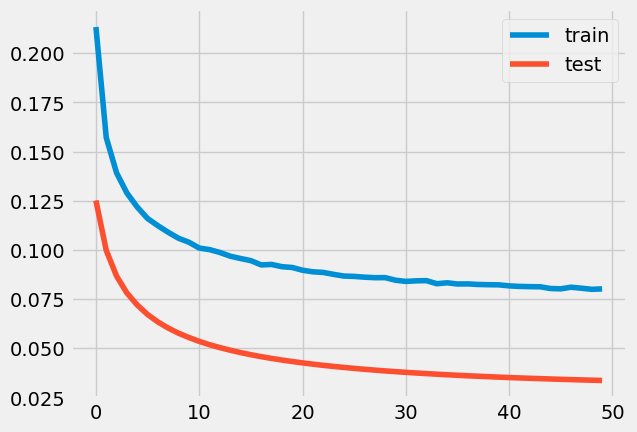

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 209ms/step - loss: 0.1923 - accuracy: 0.0000e+00 - val_loss: 0.1024 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 118ms/step - loss: 0.1363 - accuracy: 0.0000e+00 - val_loss: 0.0795 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17


loss: 2.85%



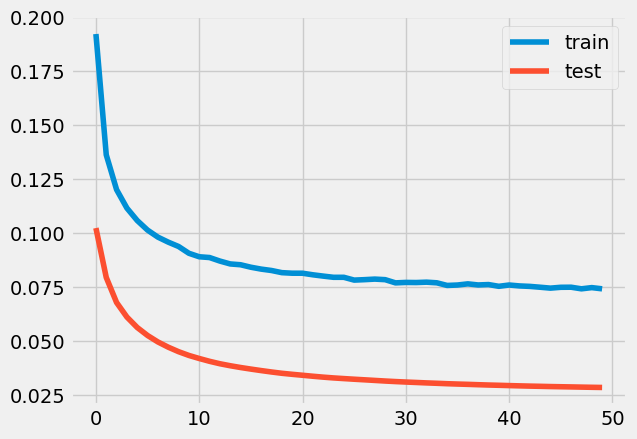

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 10s 210ms/step - loss: 0.2025 - accuracy: 0.0000e+00 - val_loss: 0.1095 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 125ms/step - loss: 0.1412 - accuracy: 0.0000e+00 - val_loss: 0.0844 - val_accuracy: 0.0000e+00
Epoch 3/50
17/1


loss: 3.11%



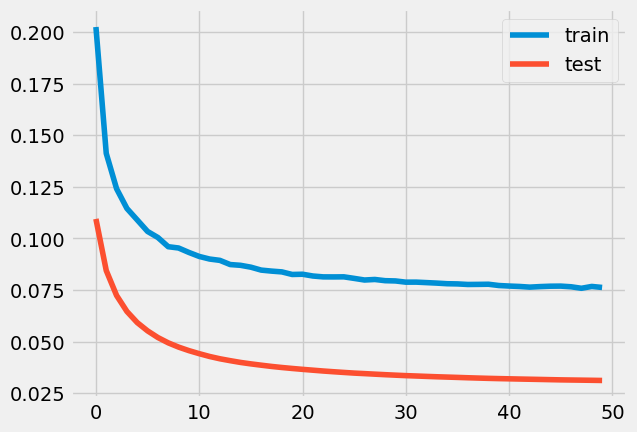

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 7s 187ms/step - loss: 0.1674 - accuracy: 0.0000e+00 - val_loss: 0.0811 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 114ms/step - loss: 0.1193 - accuracy: 8.9253e-05 - val_loss: 0.0623 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17

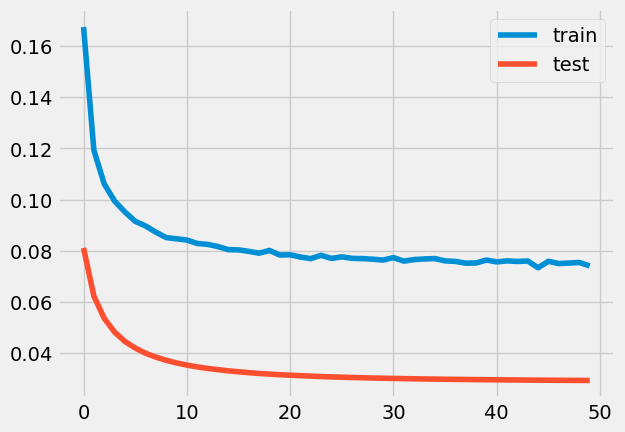

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 7s 176ms/step - loss: 0.1255 - accuracy: 2.5137e-04 - val_loss: 0.0458 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 113ms/step - loss: 0.0895 - accuracy: 0.0016 - val_loss: 0.0356 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [==

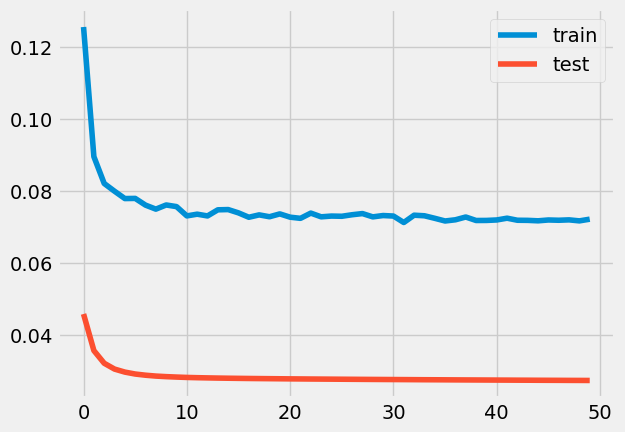

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 165ms/step - loss: 0.1457 - accuracy: 0.0000e+00 - val_loss: 0.0531 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.0937 - accuracy: 6.7008e-04 - val_loss: 0.0394 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

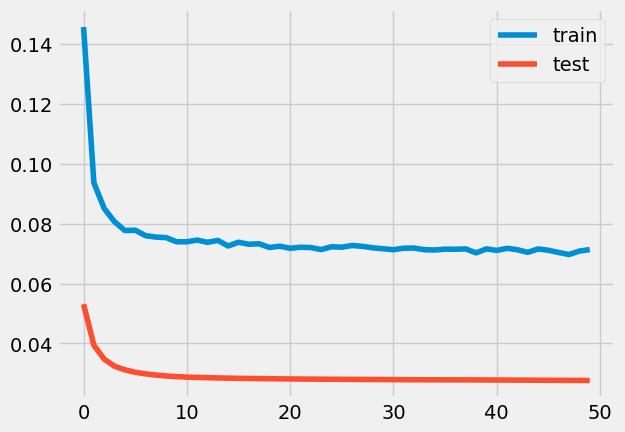

0.9023185930872966
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 151ms/step - loss: 0.2202 - accuracy: 0.0000e+00 - val_loss: 0.1128 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 104ms/step - loss: 0.1417 - accuracy: 0.0000e+00 - val_loss: 0.0839 - val_accuracy: 0.0000e+

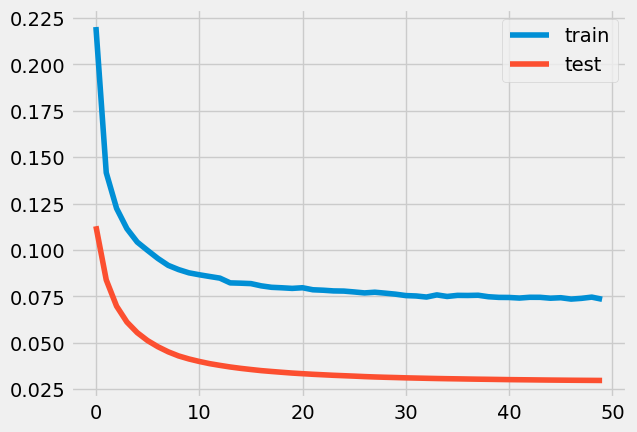

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 7s 159ms/step - loss: 0.0845 - accuracy: 0.0059 - val_loss: 0.0295 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 102ms/step - loss: 0.0806 - accuracy: 0.0053 - val_loss: 0.0280 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [======

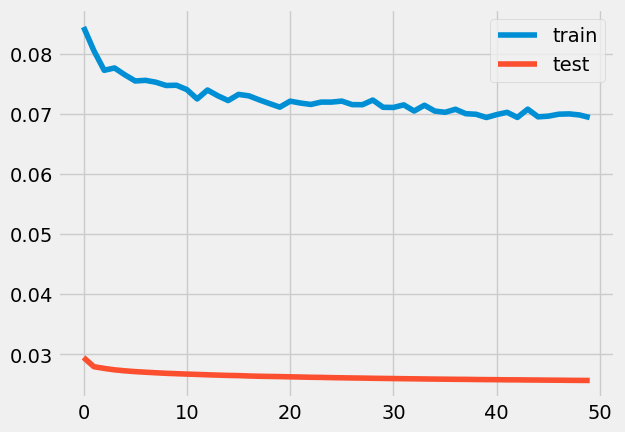

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 181ms/step - loss: 0.1284 - accuracy: 5.2823e-05 - val_loss: 0.0488 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 144ms/step - loss: 0.0922 - accuracy: 0.0012 - val_loss: 0.0372 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [==

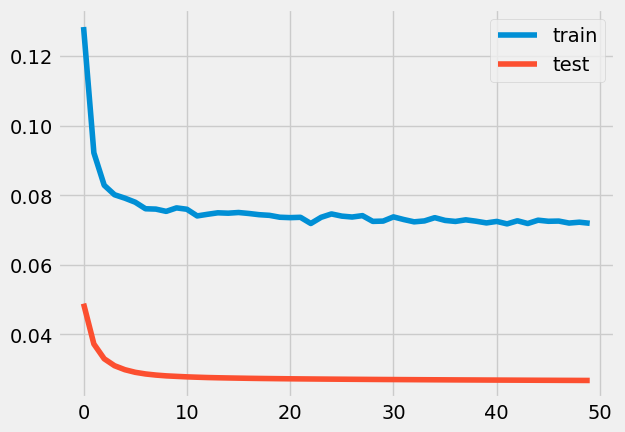

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 13s 249ms/step - loss: 0.3487 - accuracy: 0.0000e+00 - val_loss: 0.2423 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 3s 196ms/step - loss: 0.2574 - accuracy: 0.0000e+00 - val_loss: 0.2059 - val_accuracy: 0.0000e+00
Epoch 3/50
17/1

Epoch 50/50
17/17 [==============================] - 2s 133ms/step - loss: 0.1245 - accuracy: 0.0000e+00 - val_loss: 0.0807 - val_accuracy: 0.0000e+00

loss: 8.07%



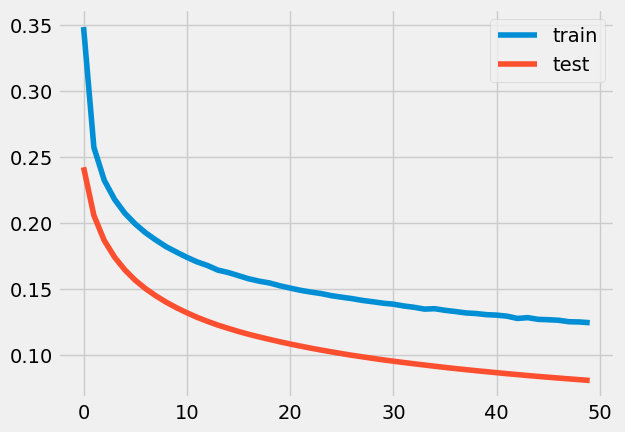

3.1418003530235863e-08
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 9s 217ms/step - loss: 0.1880 - accuracy: 0.0000e+00 - val_loss: 0.0959 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 111ms/step - loss: 0.1290 - accuracy: 0.0000e+00 - val_loss: 0.0726 - val_accuracy: 0.00


loss: 2.62%



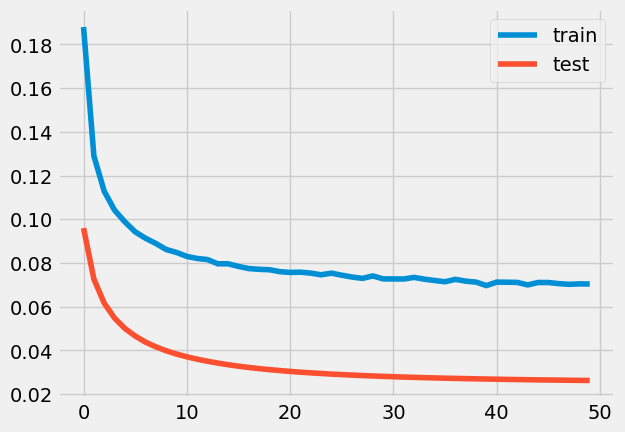

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 9s 165ms/step - loss: 0.2557 - accuracy: 0.0000e+00 - val_loss: 0.1537 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 3s 115ms/step - loss: 0.1755 - accuracy: 0.0000e+00 - val_loss: 0.1190 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22


loss: 3.78%



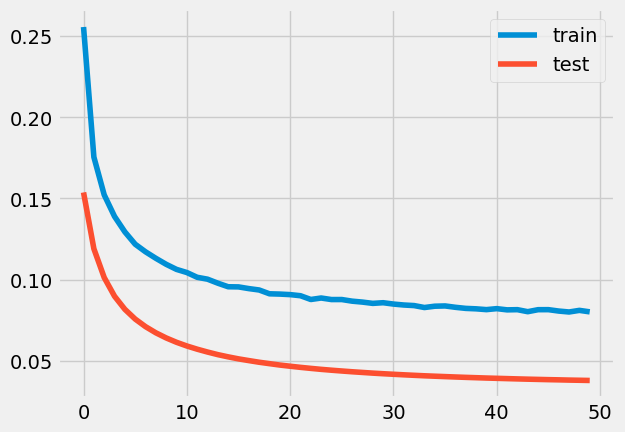

0.024344102282112222
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 11s 241ms/step - loss: 0.1107 - accuracy: 6.9581e-04 - val_loss: 0.0371 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 3s 193ms/step - loss: 0.0816 - accuracy: 0.0035 - val_loss: 0.0302 - val_accuracy: 0.0000e+0

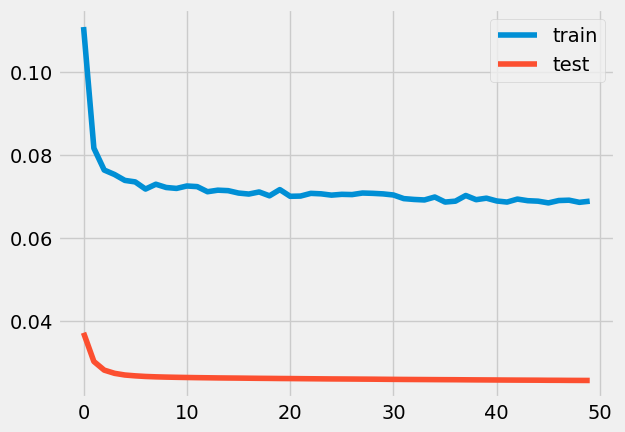

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 12s 217ms/step - loss: 0.1721 - accuracy: 0.0000e+00 - val_loss: 0.0799 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 3s 160ms/step - loss: 0.1160 - accuracy: 3.1061e-05 - val_loss: 0.0596 - val_accuracy: 0.0000e+00
Epoch 3/50
17/1

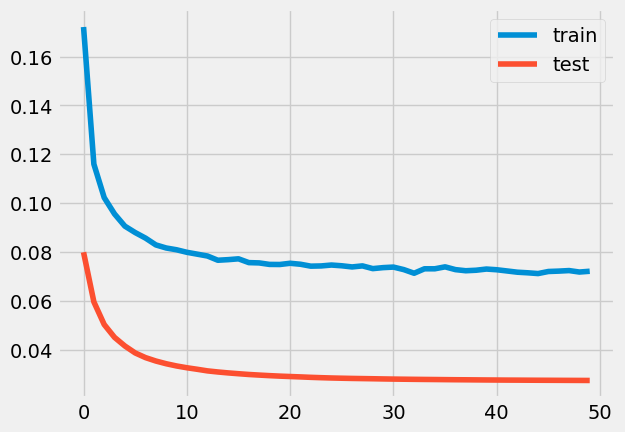

0.5602744438562847
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 10s 223ms/step - loss: 0.0875 - accuracy: 0.0047 - val_loss: 0.0292 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 3s 192ms/step - loss: 0.0803 - accuracy: 0.0051 - val_loss: 0.0292 - val_accuracy: 0.0000e+00
Epoc

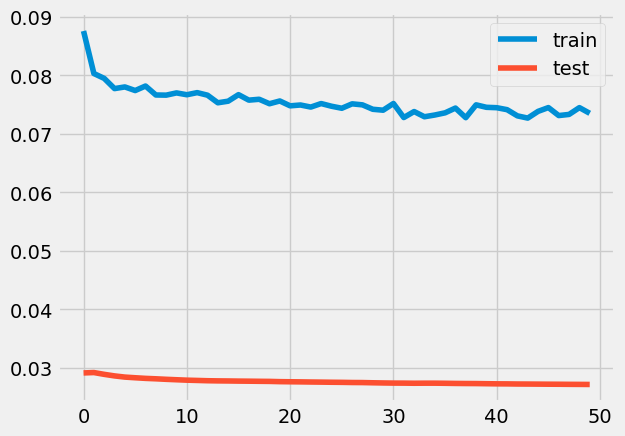

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 8s 244ms/step - loss: 0.2352 - accuracy: 0.0000e+00 - val_loss: 0.1341 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 138ms/step - loss: 0.1626 - accuracy: 0.0000e+00 - val_loss: 0.1038 - val_accuracy: 0.0000e+00
Epoch 3/50
14/14


loss: 3.20%



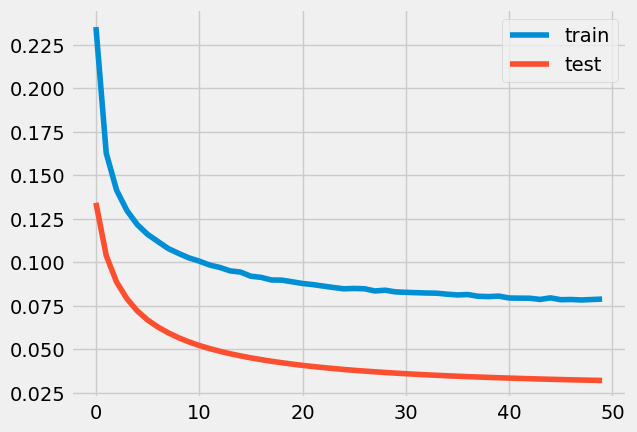

0.2157030003990185
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 215ms/step - loss: 0.1461 - accuracy: 2.7610e-05 - val_loss: 0.0685 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 148ms/step - loss: 0.1109 - accuracy: 1.6048e-04 - val_loss: 0.0551 - val_accuracy: 0.0000e+


loss: 2.76%



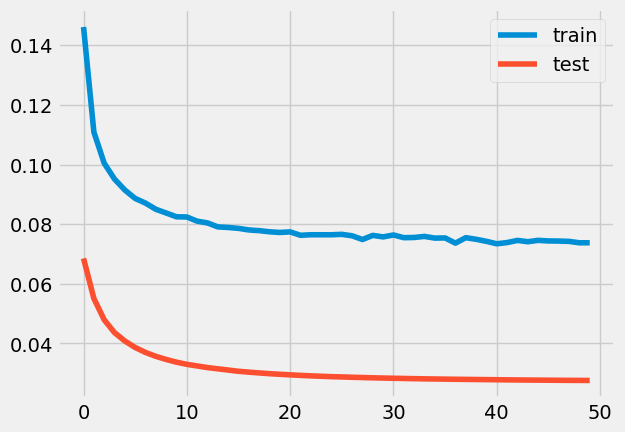

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 14s 361ms/step - loss: 0.2182 - accuracy: 0.0000e+00 - val_loss: 0.1253 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 128ms/step - loss: 0.1543 - accuracy: 0.0000e+00 - val_loss: 0.0978 - val_accuracy: 0.0000e+00
Epoch 3/50
18/1


loss: 3.14%



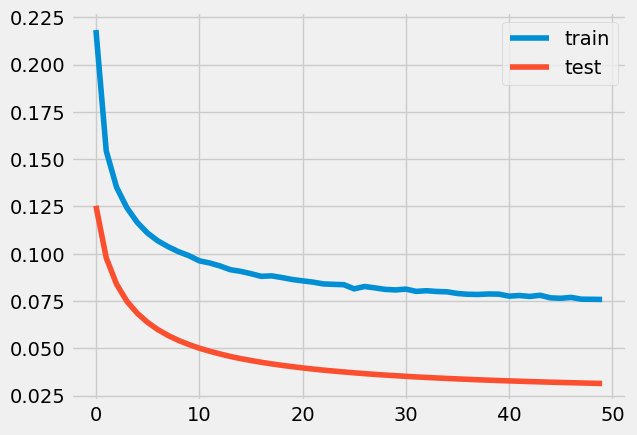

0.2915215525255183
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 11s 241ms/step - loss: 0.2292 - accuracy: 0.0000e+00 - val_loss: 0.1380 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 135ms/step - loss: 0.1679 - accuracy: 0.0000e+00 - val_loss: 0.1120 - val_accuracy: 0.0000e

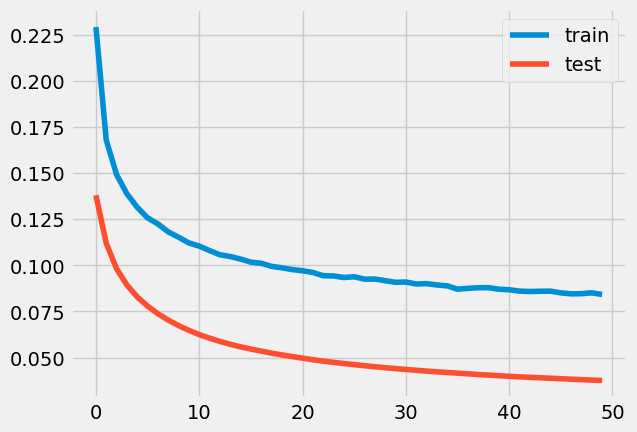

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
14/14 [==============================] - 10s 292ms/step - loss: 0.3734 - accuracy: 0.0000e+00 - val_loss: 0.2801 - val_accuracy: 0.0000e+00
Epoch 2/50
14/14 [==============================] - 2s 163ms/step - loss: 0.2915 - accuracy: 0.0000e+00 - val_loss: 0.2406 - val_accuracy: 0.0000e+00
Epoch 3/50
14/1

Epoch 50/50
14/14 [==============================] - 2s 138ms/step - loss: 0.1393 - accuracy: 0.0000e+00 - val_loss: 0.0976 - val_accuracy: 0.0000e+00

loss: 9.76%



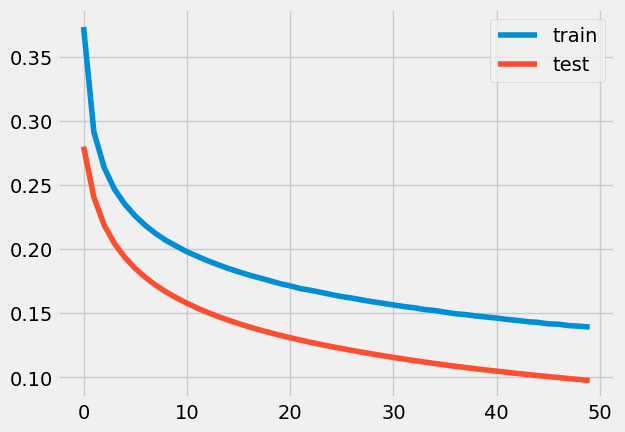

4.6139965326468796e-09
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 9s 220ms/step - loss: 0.2527 - accuracy: 0.0000e+00 - val_loss: 0.1490 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 137ms/step - loss: 0.1728 - accuracy: 0.0000e+00 - val_loss: 0.1164 - val_accuracy: 0.00

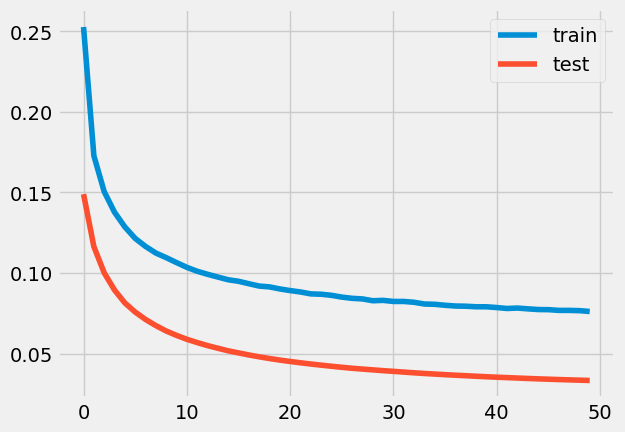

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 12s 315ms/step - loss: 0.2584 - accuracy: 0.0000e+00 - val_loss: 0.1603 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 115ms/step - loss: 0.1839 - accuracy: 0.0000e+00 - val_loss: 0.1281 - val_accuracy: 0.0000e+00
Epoch 3/50
21/2

21/21 [==============================] - 3s 142ms/step - loss: 0.0841 - accuracy: 0.0015 - val_loss: 0.0386 - val_accuracy: 0.0000e+00

loss: 3.86%



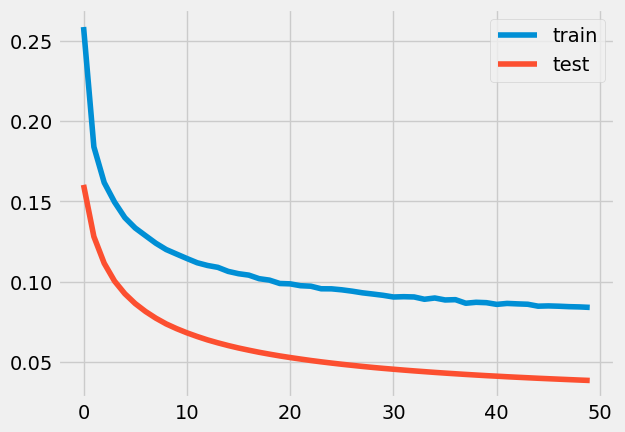

0.18061800545734796
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 13s 262ms/step - loss: 0.1858 - accuracy: 0.0000e+00 - val_loss: 0.0883 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 3s 154ms/step - loss: 0.1220 - accuracy: 0.0000e+00 - val_loss: 0.0643 - val_accuracy: 0.0000


loss: 2.73%



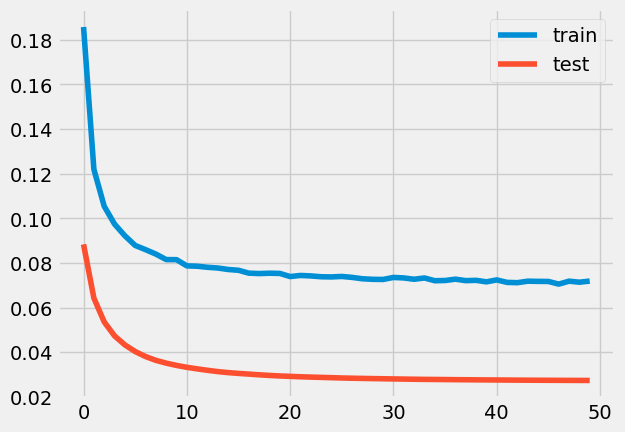

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 10s 187ms/step - loss: 0.2957 - accuracy: 0.0000e+00 - val_loss: 0.1992 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 3s 131ms/step - loss: 0.2190 - accuracy: 0.0000e+00 - val_loss: 0.1637 - val_accuracy: 0.0000e+00
Epoch 3/50
21/2

Epoch 50/50
21/21 [==============================] - 3s 122ms/step - loss: 0.0978 - accuracy: 6.3169e-04 - val_loss: 0.0528 - val_accuracy: 0.0000e+00

loss: 5.28%



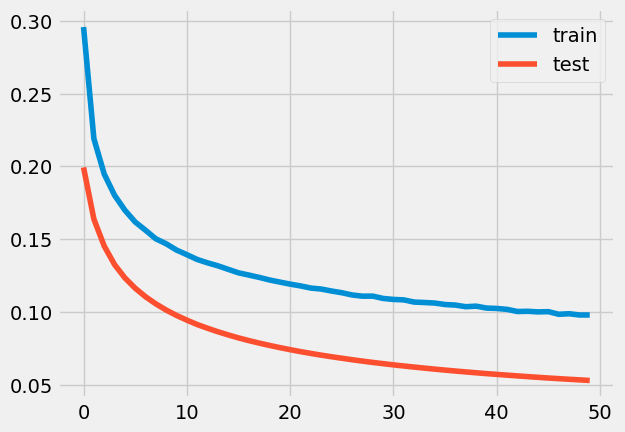

0.00029084350200199823
0.0015625
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 190ms/step - loss: 0.2709 - accuracy: 0.0000e+00 - val_loss: 0.1788 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 122ms/step - loss: 0.2031 - accuracy: 0.0000e+00 - val_loss: 0.1483 - val_accu

Epoch 50/50
17/17 [==============================] - 2s 114ms/step - loss: 0.0928 - accuracy: 6.0569e-04 - val_loss: 0.0465 - val_accuracy: 0.0000e+00

loss: 4.65%



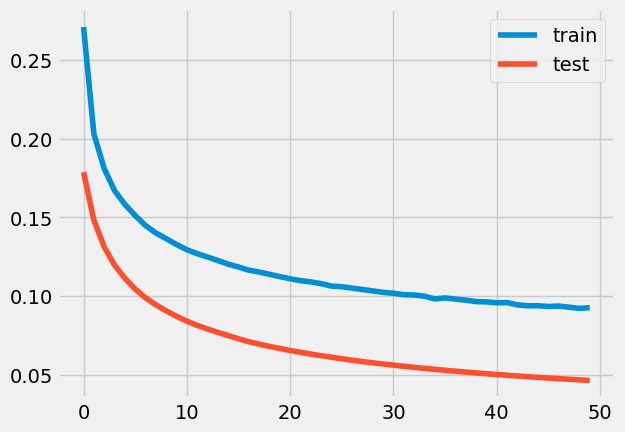

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 9s 191ms/step - loss: 0.1419 - accuracy: 4.3716e-05 - val_loss: 0.0611 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 118ms/step - loss: 0.1023 - accuracy: 4.7650e-04 - val_loss: 0.0474 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21

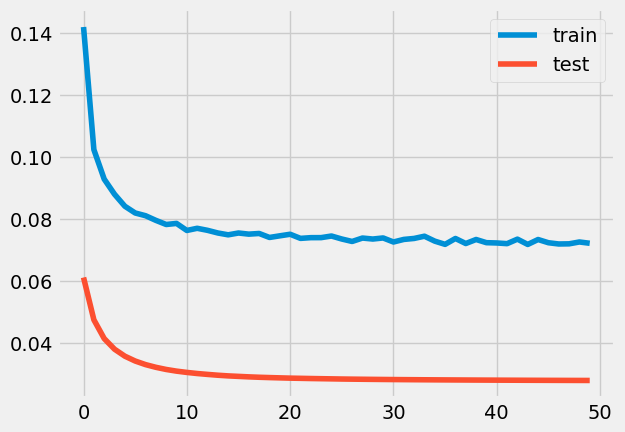

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 9s 165ms/step - loss: 0.1873 - accuracy: 0.0000e+00 - val_loss: 0.0949 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 107ms/step - loss: 0.1283 - accuracy: 0.0000e+00 - val_loss: 0.0720 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21

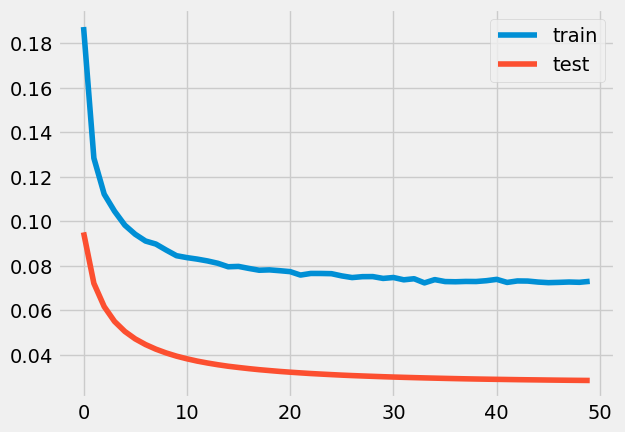

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 8s 177ms/step - loss: 0.2856 - accuracy: 0.0000e+00 - val_loss: 0.1885 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 121ms/step - loss: 0.2089 - accuracy: 0.0000e+00 - val_loss: 0.1541 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18

Epoch 50/50
18/18 [==============================] - 2s 109ms/step - loss: 0.0920 - accuracy: 2.0154e-04 - val_loss: 0.0475 - val_accuracy: 0.0000e+00

loss: 4.75%



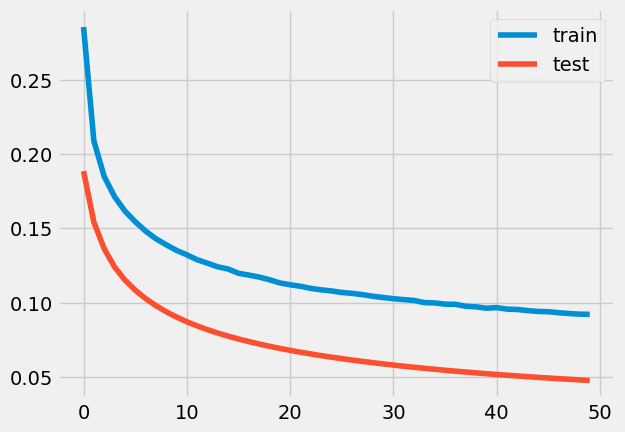

4.789110929907384e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 9s 168ms/step - loss: 0.2665 - accuracy: 0.0000e+00 - val_loss: 0.1804 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 3s 123ms/step - loss: 0.2041 - accuracy: 0.0000e+00 - val_loss: 0.1499 - val_accuracy: 0.000

Epoch 50/50
21/21 [==============================] - 2s 105ms/step - loss: 0.0938 - accuracy: 3.3661e-04 - val_loss: 0.0492 - val_accuracy: 0.0000e+00

loss: 4.92%



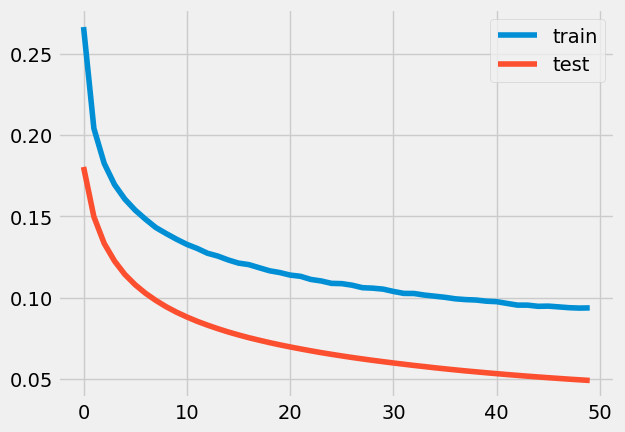

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 8s 176ms/step - loss: 0.2265 - accuracy: 0.0000e+00 - val_loss: 0.1259 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 125ms/step - loss: 0.1529 - accuracy: 0.0000e+00 - val_loss: 0.0955 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18


loss: 3.16%



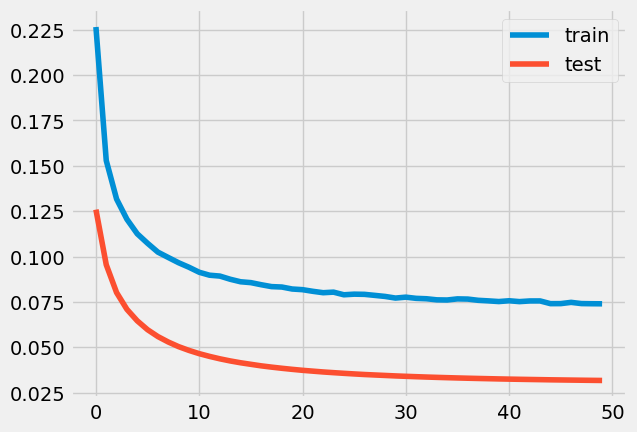

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 9s 175ms/step - loss: 0.1496 - accuracy: 0.0000e+00 - val_loss: 0.0646 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 119ms/step - loss: 0.1016 - accuracy: 2.9508e-04 - val_loss: 0.0478 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18

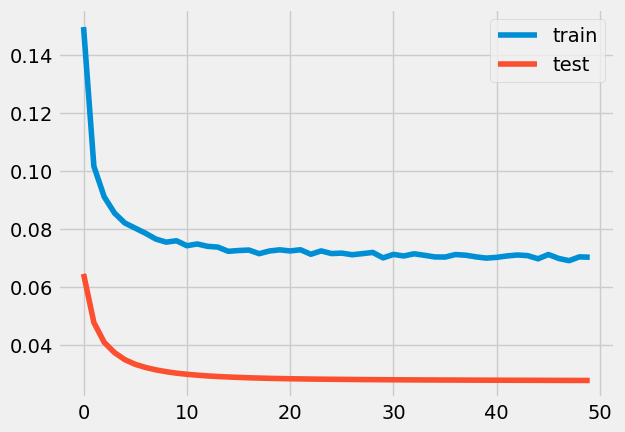

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 176ms/step - loss: 0.1986 - accuracy: 0.0000e+00 - val_loss: 0.1096 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 101ms/step - loss: 0.1438 - accuracy: 0.0000e+00 - val_loss: 0.0871 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.09%



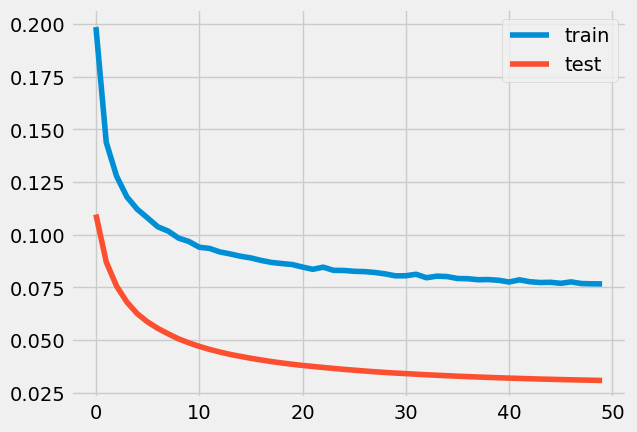

0.14971195522593503
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 7s 169ms/step - loss: 0.2572 - accuracy: 0.0000e+00 - val_loss: 0.1665 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 118ms/step - loss: 0.1889 - accuracy: 0.0000e+00 - val_loss: 0.1332 - val_accuracy: 0.0000e

18/18 [==============================] - 2s 132ms/step - loss: 0.0806 - accuracy: 0.0017 - val_loss: 0.0368 - val_accuracy: 0.0000e+00

loss: 3.68%



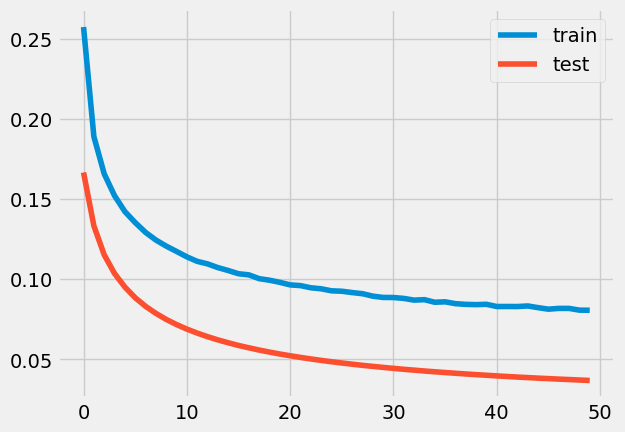

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 8s 169ms/step - loss: 0.1499 - accuracy: 8.7432e-05 - val_loss: 0.0648 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 107ms/step - loss: 0.1024 - accuracy: 2.5221e-04 - val_loss: 0.0485 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24

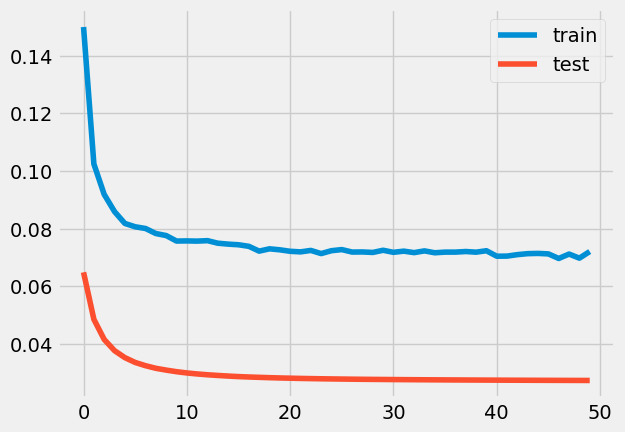

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 10s 159ms/step - loss: 0.2881 - accuracy: 0.0000e+00 - val_loss: 0.1973 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 2s 98ms/step - loss: 0.2184 - accuracy: 0.0000e+00 - val_loss: 0.1651 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24

Epoch 50/50
24/24 [==============================] - 3s 125ms/step - loss: 0.0976 - accuracy: 2.7491e-04 - val_loss: 0.0522 - val_accuracy: 0.0000e+00

loss: 5.22%



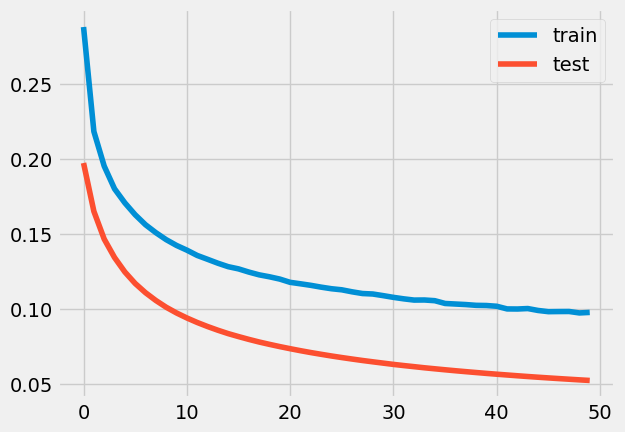

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 8s 169ms/step - loss: 0.2212 - accuracy: 0.0000e+00 - val_loss: 0.1280 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 2s 103ms/step - loss: 0.1575 - accuracy: 0.0000e+00 - val_loss: 0.1006 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24


loss: 3.41%



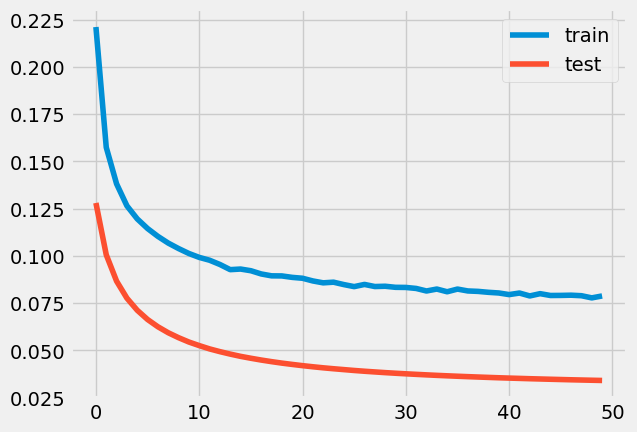

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 8s 174ms/step - loss: 0.1583 - accuracy: 0.0000e+00 - val_loss: 0.0717 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 104ms/step - loss: 0.1085 - accuracy: 1.6056e-04 - val_loss: 0.0544 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18

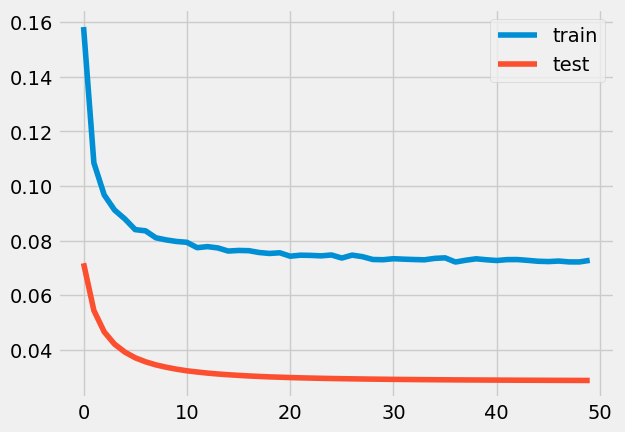

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 7s 177ms/step - loss: 0.2146 - accuracy: 0.0000e+00 - val_loss: 0.1253 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 2s 107ms/step - loss: 0.1547 - accuracy: 0.0000e+00 - val_loss: 0.0995 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18


loss: 3.00%



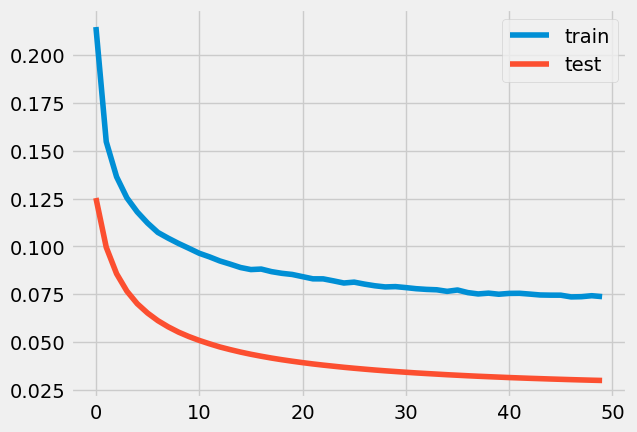

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 173ms/step - loss: 0.1181 - accuracy: 3.8980e-04 - val_loss: 0.0392 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 108ms/step - loss: 0.0833 - accuracy: 0.0030 - val_loss: 0.0311 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [==

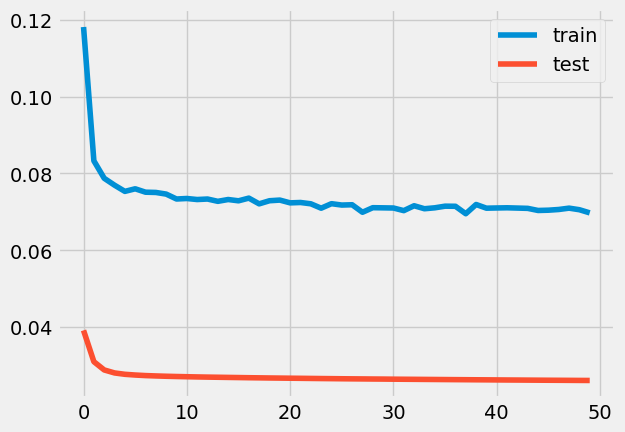

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 6s 165ms/step - loss: 0.1633 - accuracy: 0.0000e+00 - val_loss: 0.0783 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 106ms/step - loss: 0.1153 - accuracy: 1.4754e-04 - val_loss: 0.0598 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17

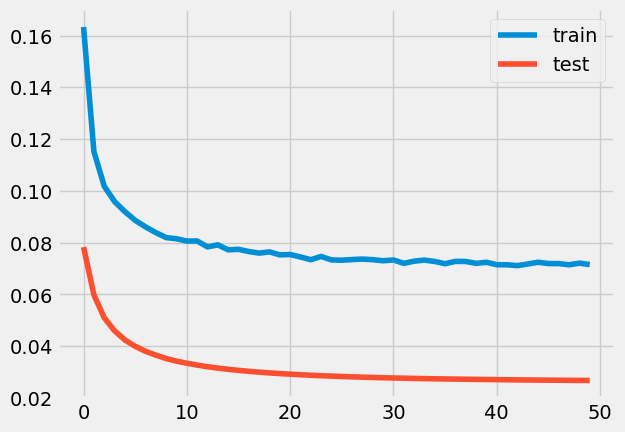

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 9s 207ms/step - loss: 0.1497 - accuracy: 3.2787e-05 - val_loss: 0.0633 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 121ms/step - loss: 0.1022 - accuracy: 4.2278e-04 - val_loss: 0.0465 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17

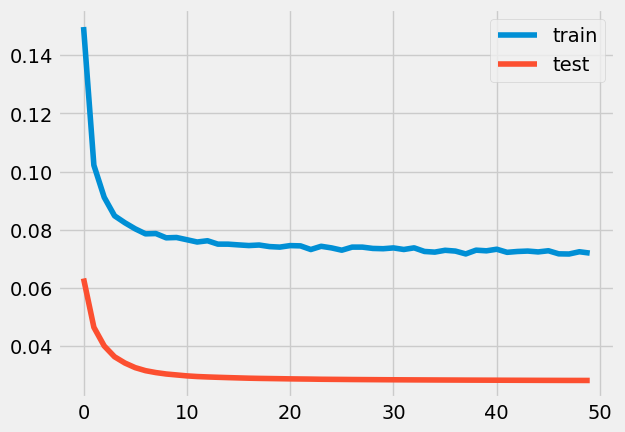

0.3774016239670572
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 8s 211ms/step - loss: 0.1839 - accuracy: 0.0000e+00 - val_loss: 0.0921 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 2s 114ms/step - loss: 0.1278 - accuracy: 0.0000e+00 - val_loss: 0.0695 - val_accuracy: 0.0000e+


loss: 3.07%



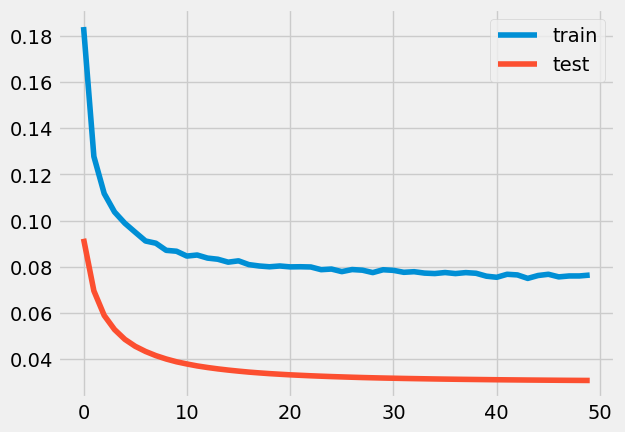

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 181ms/step - loss: 0.1633 - accuracy: 0.0000e+00 - val_loss: 0.0703 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 114ms/step - loss: 0.1058 - accuracy: 5.4098e-04 - val_loss: 0.0511 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

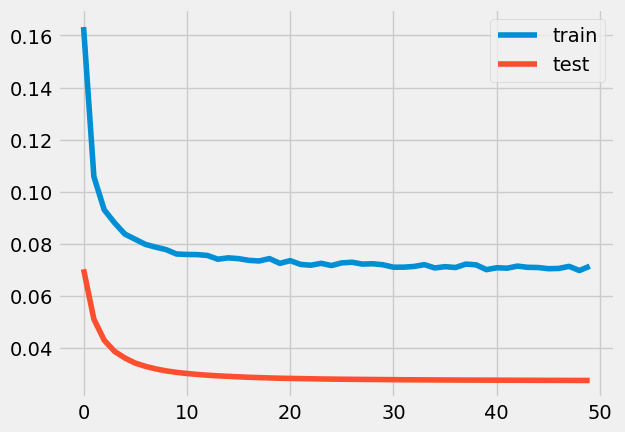

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 188ms/step - loss: 0.2147 - accuracy: 0.0000e+00 - val_loss: 0.1113 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 104ms/step - loss: 0.1409 - accuracy: 0.0000e+00 - val_loss: 0.0841 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.95%



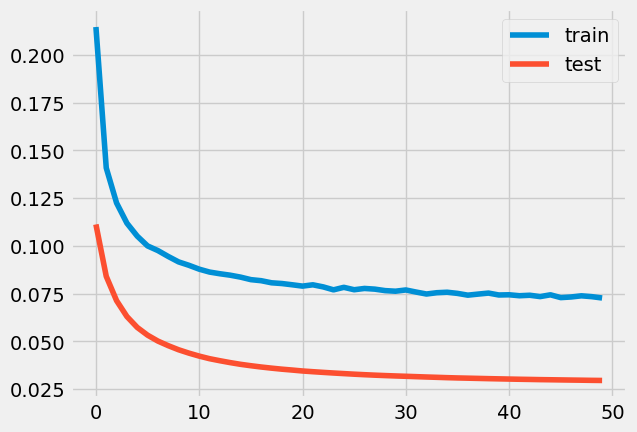

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 8s 148ms/step - loss: 0.0904 - accuracy: 0.0020 - val_loss: 0.0288 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 103ms/step - loss: 0.0749 - accuracy: 0.0050 - val_loss: 0.0286 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [======

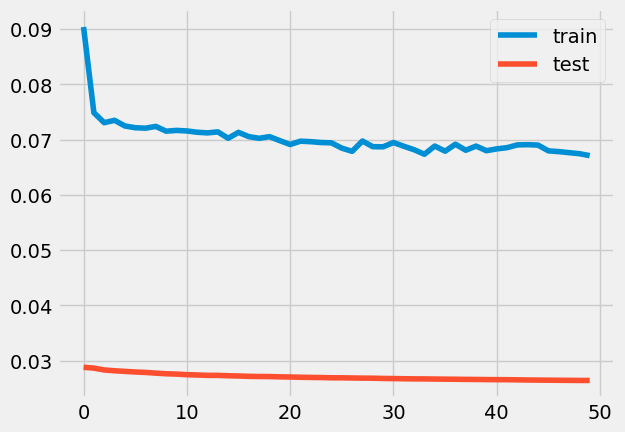

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 7s 132ms/step - loss: 0.1681 - accuracy: 0.0000e+00 - val_loss: 0.0891 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 2s 92ms/step - loss: 0.1247 - accuracy: 0.0000e+00 - val_loss: 0.0703 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 

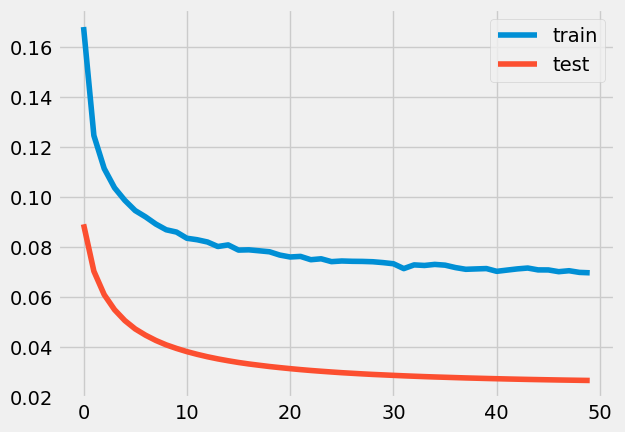

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 10s 193ms/step - loss: 0.2632 - accuracy: 0.0000e+00 - val_loss: 0.1654 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 2s 113ms/step - loss: 0.1870 - accuracy: 0.0000e+00 - val_loss: 0.1301 - val_accuracy: 0.0000e+00
Epoch 3/50
22/2

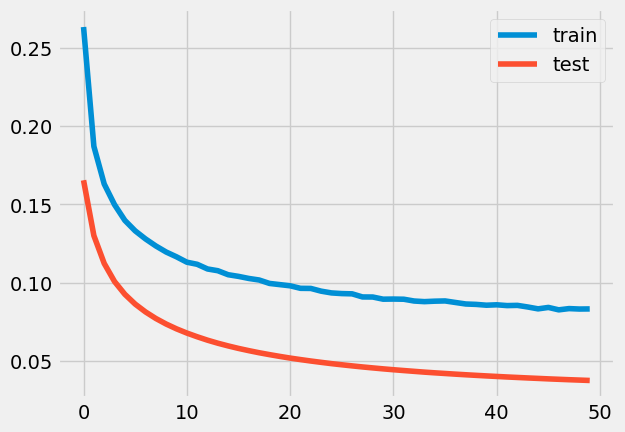

0.000797318478072787
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 9s 151ms/step - loss: 0.1133 - accuracy: 0.0011 - val_loss: 0.0393 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 110ms/step - loss: 0.0839 - accuracy: 0.0034 - val_loss: 0.0327 - val_accuracy: 0.0000e+00
Epo

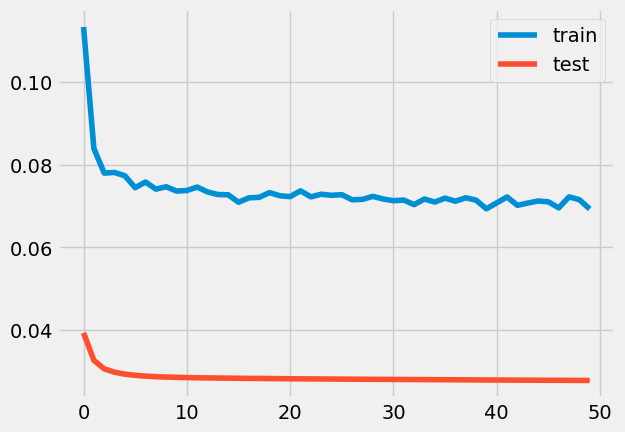

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 9s 162ms/step - loss: 0.1262 - accuracy: 1.9672e-04 - val_loss: 0.0518 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 114ms/step - loss: 0.0948 - accuracy: 8.7158e-04 - val_loss: 0.0409 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26

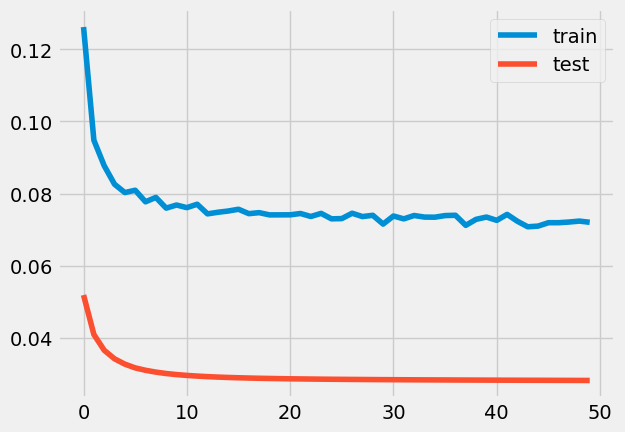

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 9s 172ms/step - loss: 0.2073 - accuracy: 0.0000e+00 - val_loss: 0.1151 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 115ms/step - loss: 0.1464 - accuracy: 0.0000e+00 - val_loss: 0.0916 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26


loss: 3.18%



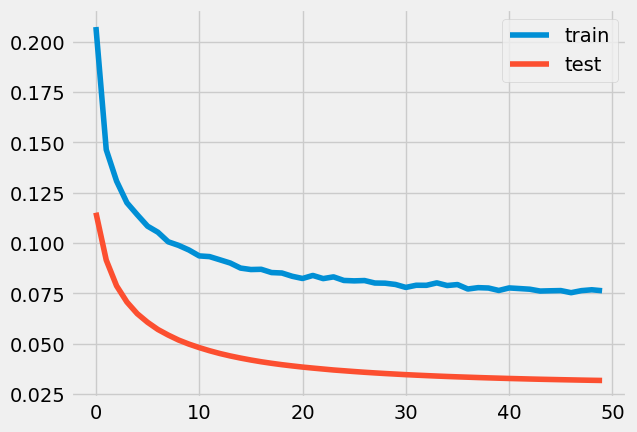

0.09554837676788103
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 7s 130ms/step - loss: 0.1319 - accuracy: 1.4481e-04 - val_loss: 0.0505 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 118ms/step - loss: 0.0939 - accuracy: 0.0015 - val_loss: 0.0394 - val_accuracy: 0.0000e+00


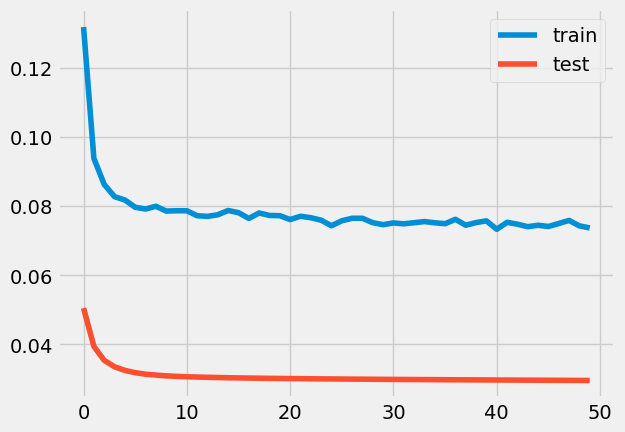

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 8s 121ms/step - loss: 0.0889 - accuracy: 0.0018 - val_loss: 0.0265 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 92ms/step - loss: 0.0702 - accuracy: 0.0050 - val_loss: 0.0260 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [=======

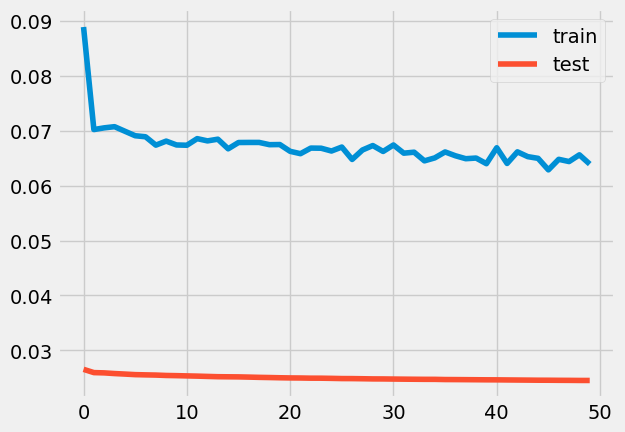

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 6s 93ms/step - loss: 0.1086 - accuracy: 6.6885e-04 - val_loss: 0.0339 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 79ms/step - loss: 0.0761 - accuracy: 0.0029 - val_loss: 0.0275 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [====

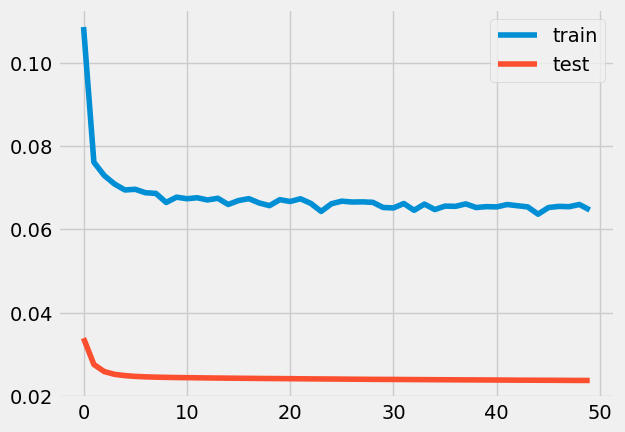

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 7s 119ms/step - loss: 0.1272 - accuracy: 1.3443e-04 - val_loss: 0.0514 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 80ms/step - loss: 0.0922 - accuracy: 0.0017 - val_loss: 0.0402 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [===

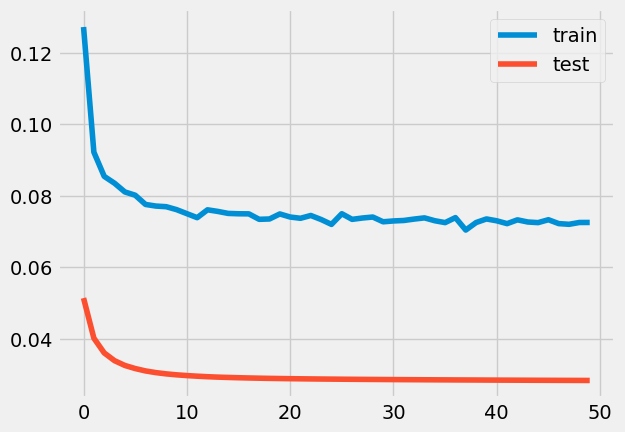

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 7s 136ms/step - loss: 0.2073 - accuracy: 0.0000e+00 - val_loss: 0.1248 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 70ms/step - loss: 0.1565 - accuracy: 0.0000e+00 - val_loss: 0.1022 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 


loss: 3.59%



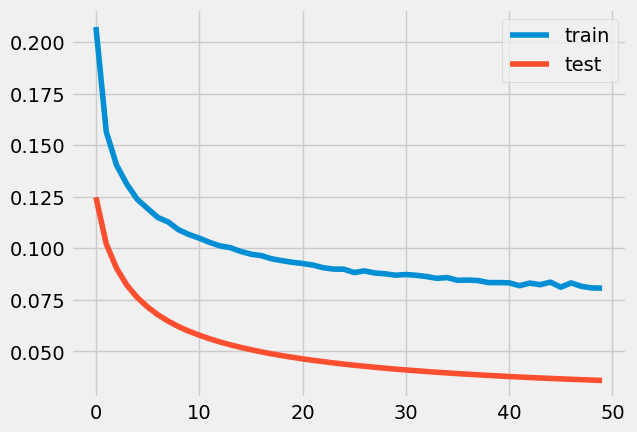

0.007925619205972706
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 7s 101ms/step - loss: 0.1298 - accuracy: 6.8852e-05 - val_loss: 0.0529 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 75ms/step - loss: 0.0940 - accuracy: 6.1311e-04 - val_loss: 0.0403 - val_accuracy: 0.0000e

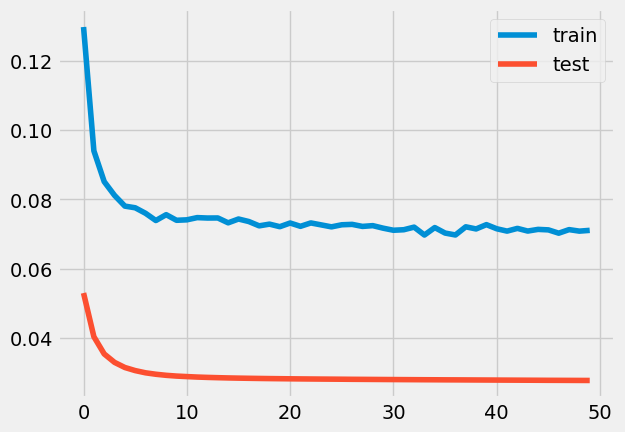

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 7s 113ms/step - loss: 0.2709 - accuracy: 0.0000e+00 - val_loss: 0.1650 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 84ms/step - loss: 0.1851 - accuracy: 0.0000e+00 - val_loss: 0.1301 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 

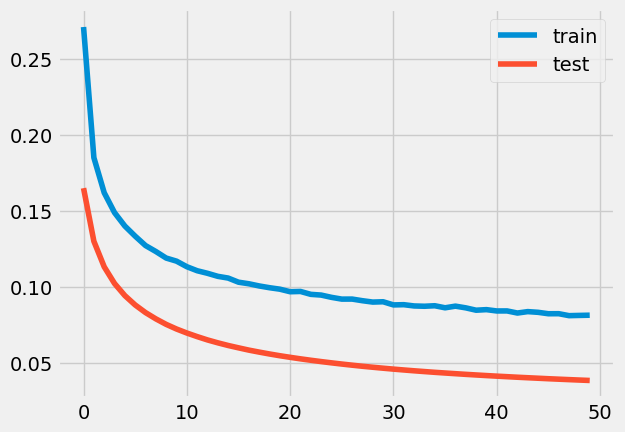

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 63ms/step - loss: 0.2129 - accuracy: 0.0000e+00 - val_loss: 0.1179 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 43ms/step - loss: 0.1459 - accuracy: 0.0000e+00 - val_loss: 0.0892 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

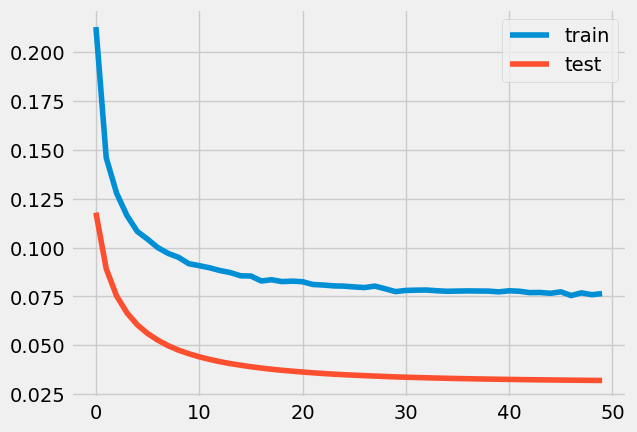

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 10s 212ms/step - loss: 0.1758 - accuracy: 0.0000e+00 - val_loss: 0.0920 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 2s 95ms/step - loss: 0.1277 - accuracy: 0.0000e+00 - val_loss: 0.0735 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26


loss: 2.94%



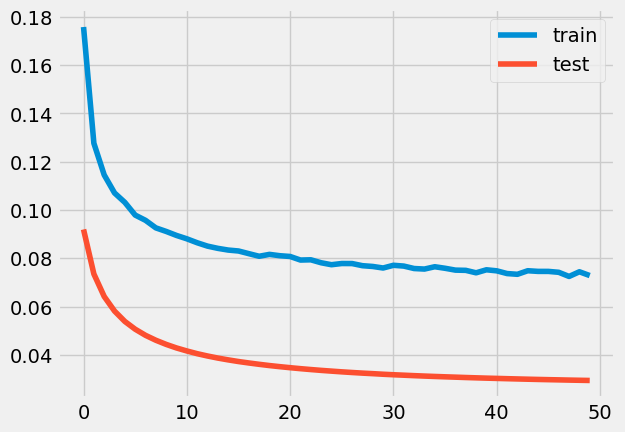

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 11s 152ms/step - loss: 0.1439 - accuracy: 1.6393e-05 - val_loss: 0.0620 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 4s 122ms/step - loss: 0.1010 - accuracy: 1.7705e-04 - val_loss: 0.0472 - val_accuracy: 0.0000e+00
Epoch 3/50
31/3

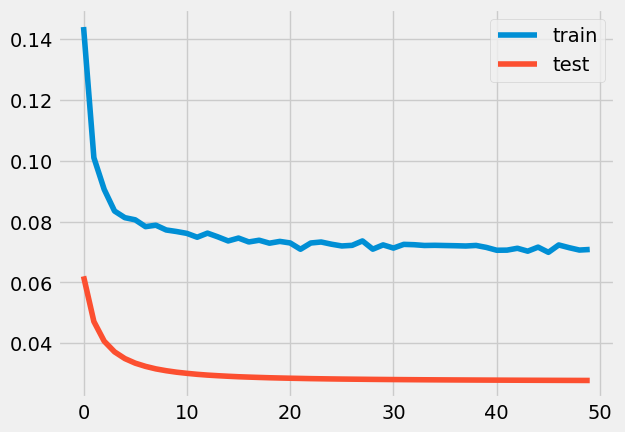

0.00078125
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 13s 201ms/step - loss: 0.0846 - accuracy: 0.0048 - val_loss: 0.0310 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 3s 111ms/step - loss: 0.0769 - accuracy: 0.0059 - val_loss: 0.0302 - val_accuracy: 0.0000e+00
Epoch 3/50
3

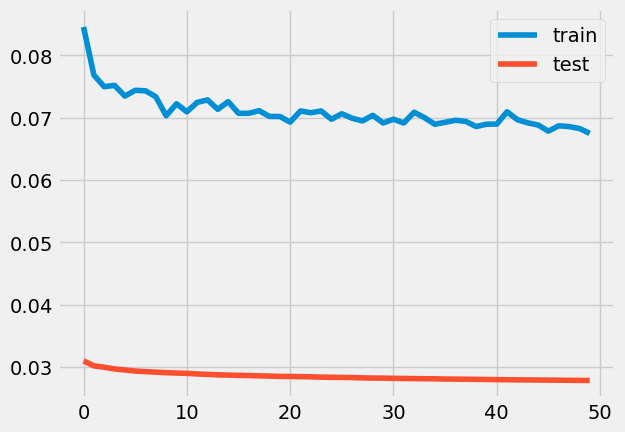

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 11s 166ms/step - loss: 0.2254 - accuracy: 0.0000e+00 - val_loss: 0.1263 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 4s 114ms/step - loss: 0.1507 - accuracy: 0.0000e+00 - val_loss: 0.0940 - val_accuracy: 0.0000e+00
Epoch 3/50
31/3


loss: 2.95%



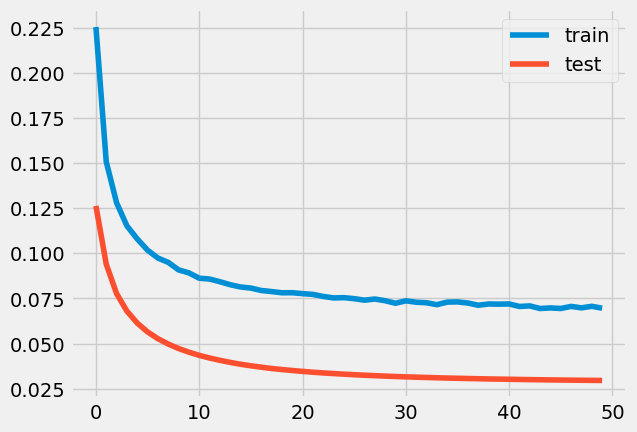

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 10s 166ms/step - loss: 0.2301 - accuracy: 0.0000e+00 - val_loss: 0.1298 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 3s 111ms/step - loss: 0.1550 - accuracy: 0.0000e+00 - val_loss: 0.0998 - val_accuracy: 0.0000e+00
Epoch 3/50
26/2


loss: 3.13%



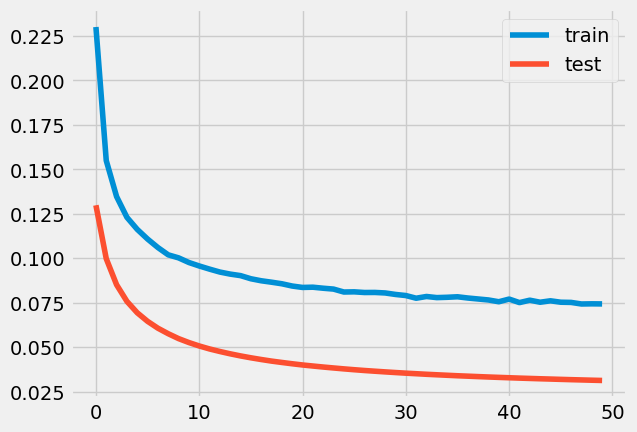

0.10720992796340817
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 11s 161ms/step - loss: 0.2616 - accuracy: 0.0000e+00 - val_loss: 0.1788 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 4s 118ms/step - loss: 0.2041 - accuracy: 0.0000e+00 - val_loss: 0.1513 - val_accuracy: 0.0000

Epoch 50/50
31/31 [==============================] - 4s 117ms/step - loss: 0.1012 - accuracy: 2.1311e-04 - val_loss: 0.0570 - val_accuracy: 0.0000e+00

loss: 5.70%



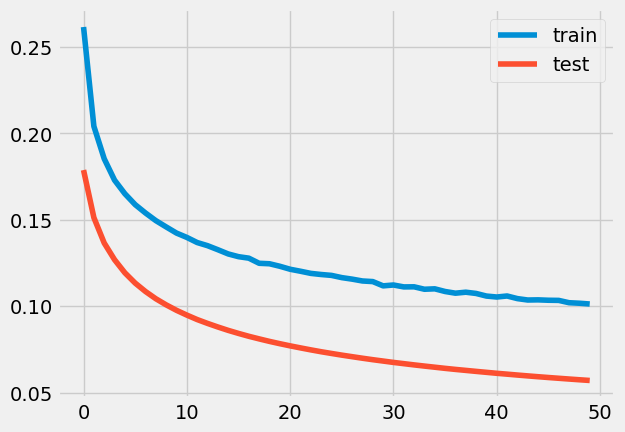

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 10s 207ms/step - loss: 0.2602 - accuracy: 0.0000e+00 - val_loss: 0.1746 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 132ms/step - loss: 0.1984 - accuracy: 0.0000e+00 - val_loss: 0.1449 - val_accuracy: 0.0000e+00
Epoch 3/50
24/2

Epoch 50/50
24/24 [==============================] - 3s 134ms/step - loss: 0.0908 - accuracy: 5.3720e-04 - val_loss: 0.0466 - val_accuracy: 0.0000e+00

loss: 4.66%



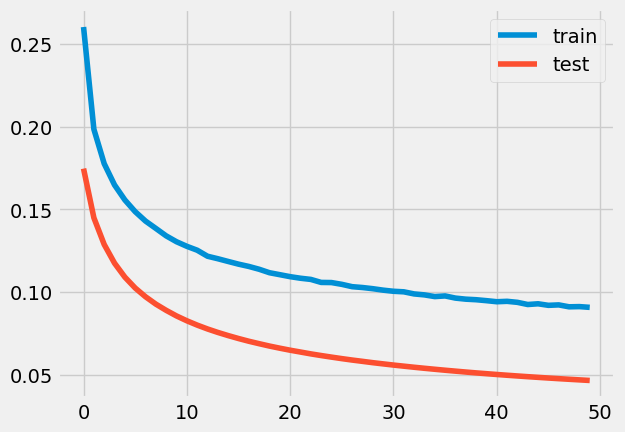

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 10s 196ms/step - loss: 0.1106 - accuracy: 2.8752e-04 - val_loss: 0.0371 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 133ms/step - loss: 0.0837 - accuracy: 0.0027 - val_loss: 0.0306 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [=

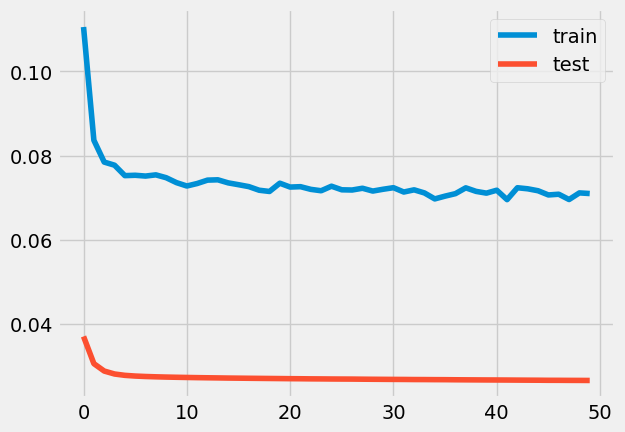

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 9s 177ms/step - loss: 0.3762 - accuracy: 0.0000e+00 - val_loss: 0.2737 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 119ms/step - loss: 0.2797 - accuracy: 0.0000e+00 - val_loss: 0.2278 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24

Epoch 50/50
24/24 [==============================] - 3s 119ms/step - loss: 0.1158 - accuracy: 0.0000e+00 - val_loss: 0.0746 - val_accuracy: 0.0000e+00

loss: 7.46%



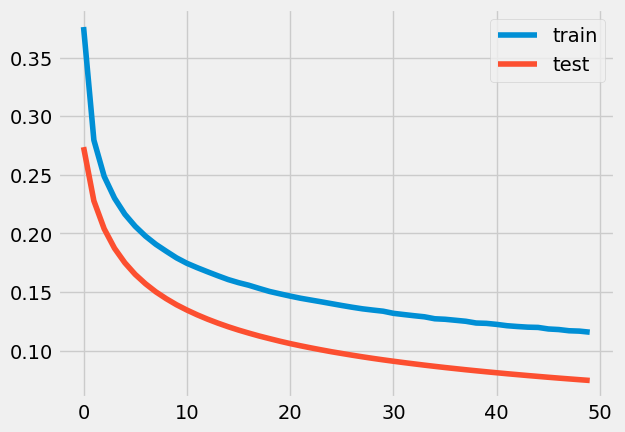

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 9s 182ms/step - loss: 0.0995 - accuracy: 8.4778e-04 - val_loss: 0.0314 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 3s 125ms/step - loss: 0.0778 - accuracy: 0.0043 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [==

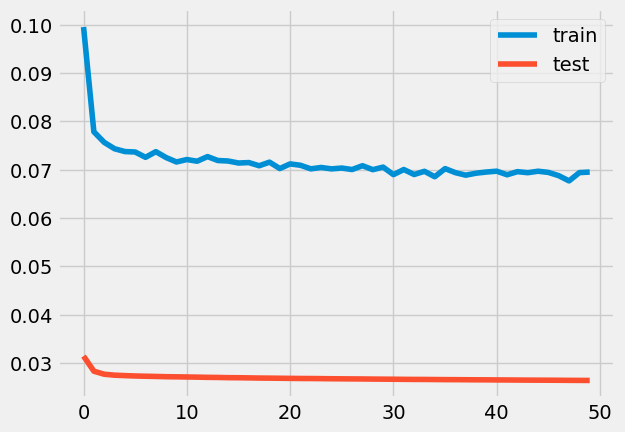

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 8s 178ms/step - loss: 0.1278 - accuracy: 7.0258e-05 - val_loss: 0.0449 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 3s 128ms/step - loss: 0.0858 - accuracy: 0.0024 - val_loss: 0.0343 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [==

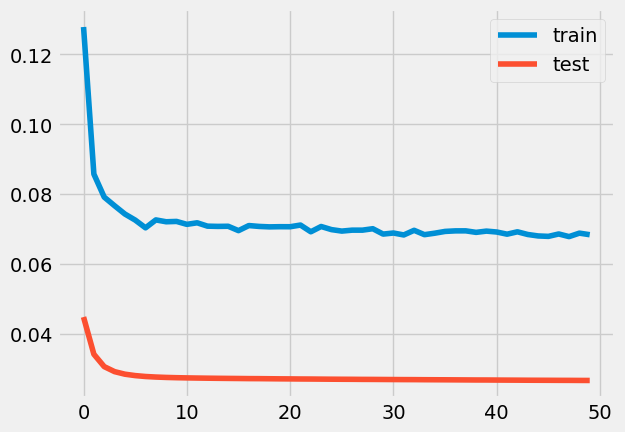

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 8s 180ms/step - loss: 0.2197 - accuracy: 0.0000e+00 - val_loss: 0.1278 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 3s 125ms/step - loss: 0.1573 - accuracy: 0.0000e+00 - val_loss: 0.1025 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22


loss: 3.29%



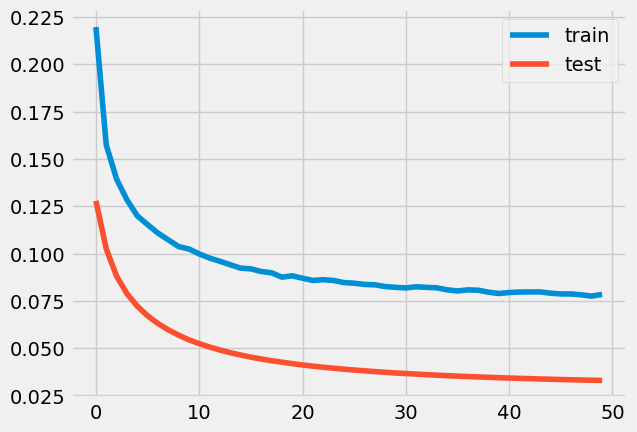

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 7s 159ms/step - loss: 0.1885 - accuracy: 0.0000e+00 - val_loss: 0.0959 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 104ms/step - loss: 0.1284 - accuracy: 0.0000e+00 - val_loss: 0.0729 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21

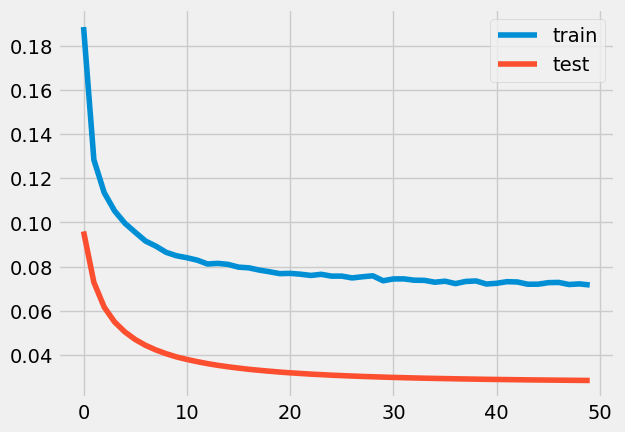

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 9s 180ms/step - loss: 0.1345 - accuracy: 1.2240e-04 - val_loss: 0.0508 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 2s 119ms/step - loss: 0.0926 - accuracy: 7.2787e-04 - val_loss: 0.0390 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21

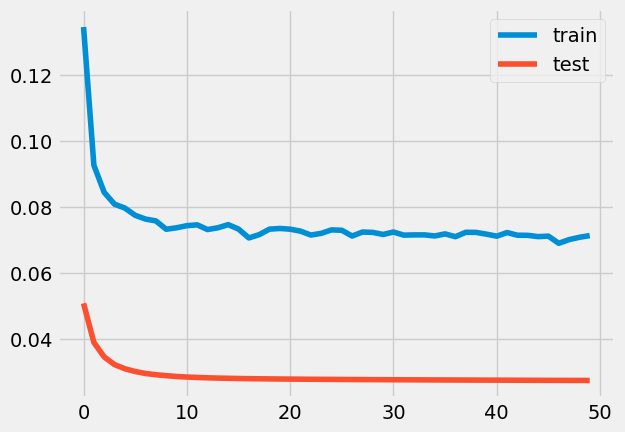

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 9s 175ms/step - loss: 0.0985 - accuracy: 0.0030 - val_loss: 0.0311 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 3s 119ms/step - loss: 0.0769 - accuracy: 0.0041 - val_loss: 0.0288 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [======

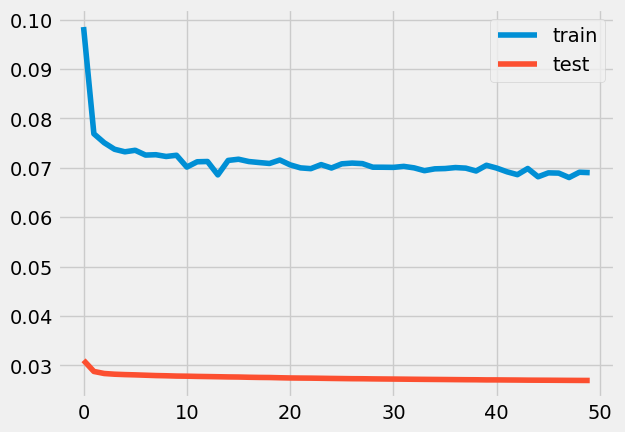

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 6s 97ms/step - loss: 0.1791 - accuracy: 0.0000e+00 - val_loss: 0.0877 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 58ms/step - loss: 0.1207 - accuracy: 0.0000e+00 - val_loss: 0.0649 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

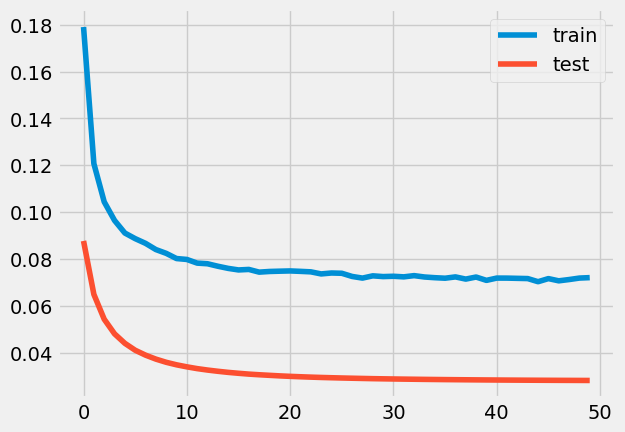

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 6s 88ms/step - loss: 0.1221 - accuracy: 2.8197e-04 - val_loss: 0.0433 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 54ms/step - loss: 0.0849 - accuracy: 0.0037 - val_loss: 0.0340 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [====

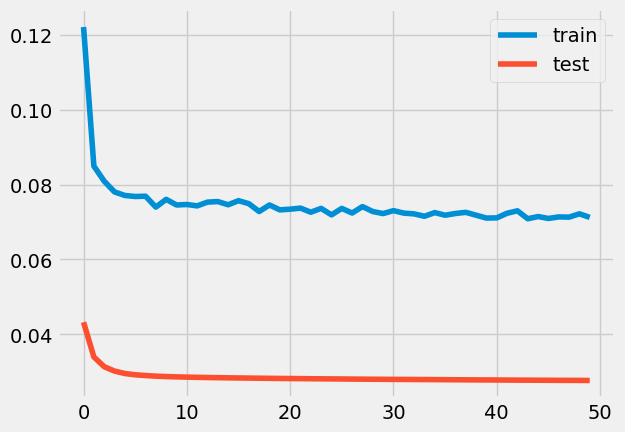

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 7s 90ms/step - loss: 0.1365 - accuracy: 1.6393e-05 - val_loss: 0.0546 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 58ms/step - loss: 0.0928 - accuracy: 6.8852e-04 - val_loss: 0.0412 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

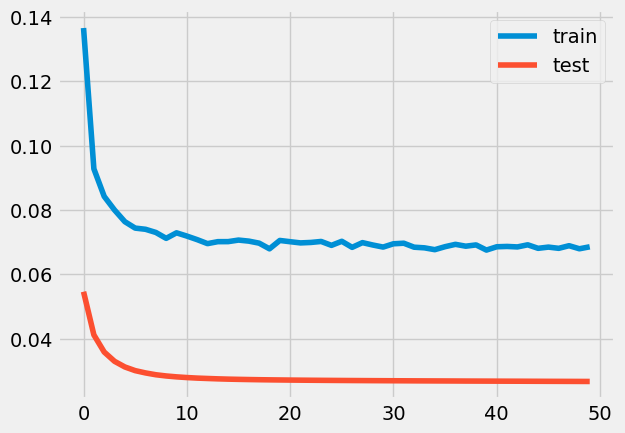

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 6s 90ms/step - loss: 0.0934 - accuracy: 0.0038 - val_loss: 0.0294 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 55ms/step - loss: 0.0760 - accuracy: 0.0042 - val_loss: 0.0285 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [========

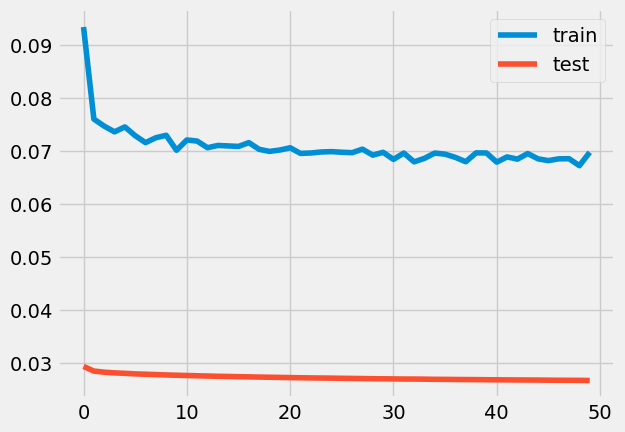

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 6s 86ms/step - loss: 0.2152 - accuracy: 0.0000e+00 - val_loss: 0.1159 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 54ms/step - loss: 0.1442 - accuracy: 0.0000e+00 - val_loss: 0.0900 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

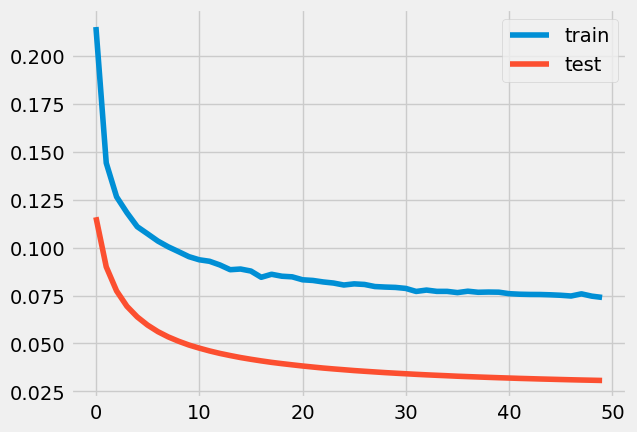

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 6s 101ms/step - loss: 0.3224 - accuracy: 0.0000e+00 - val_loss: 0.2146 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 59ms/step - loss: 0.2286 - accuracy: 0.0000e+00 - val_loss: 0.1746 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 

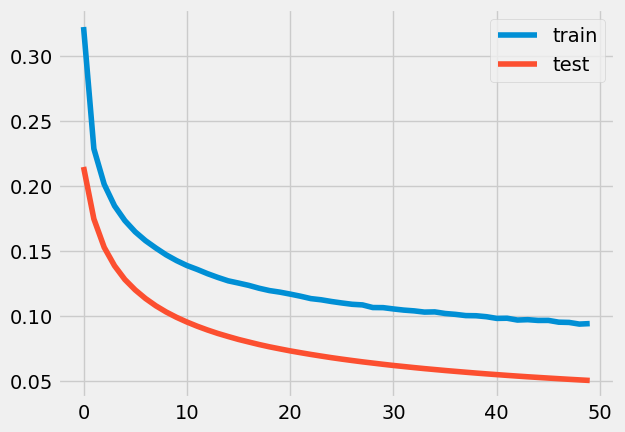

1.550386638723033e-11
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 6s 91ms/step - loss: 0.4076 - accuracy: 0.0000e+00 - val_loss: 0.2863 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 57ms/step - loss: 0.2862 - accuracy: 0.0000e+00 - val_loss: 0.2334 - val_accuracy: 0.0000e

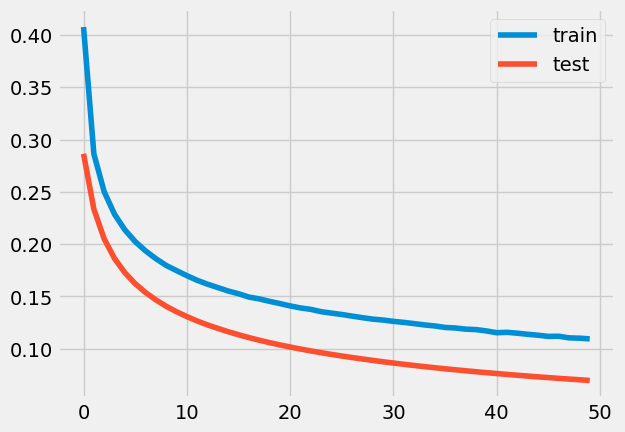

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 6s 91ms/step - loss: 0.3106 - accuracy: 0.0000e+00 - val_loss: 0.2274 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 59ms/step - loss: 0.2459 - accuracy: 0.0000e+00 - val_loss: 0.1975 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

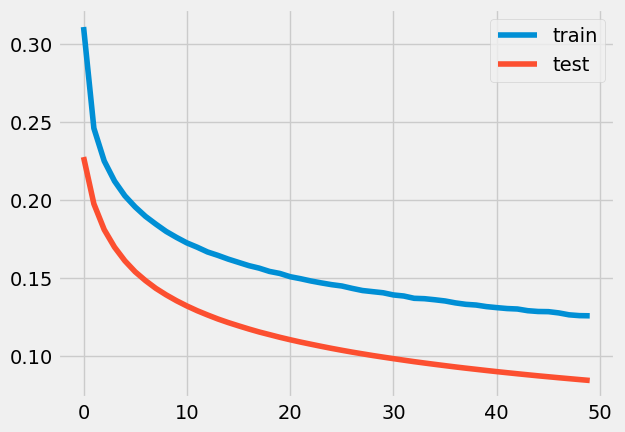

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 6s 89ms/step - loss: 0.1656 - accuracy: 0.0000e+00 - val_loss: 0.0798 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 59ms/step - loss: 0.1141 - accuracy: 4.1729e-05 - val_loss: 0.0601 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

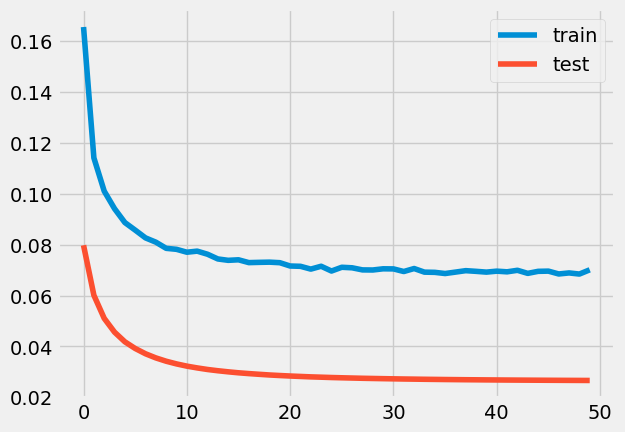

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 6s 91ms/step - loss: 0.3586 - accuracy: 0.0000e+00 - val_loss: 0.2628 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 60ms/step - loss: 0.2724 - accuracy: 0.0000e+00 - val_loss: 0.2226 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

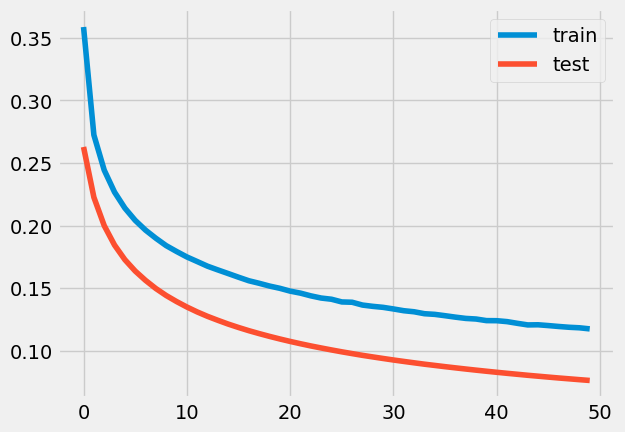

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 6s 96ms/step - loss: 0.2125 - accuracy: 0.0000e+00 - val_loss: 0.1246 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 56ms/step - loss: 0.1557 - accuracy: 0.0000e+00 - val_loss: 0.1008 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [


loss: 3.36%



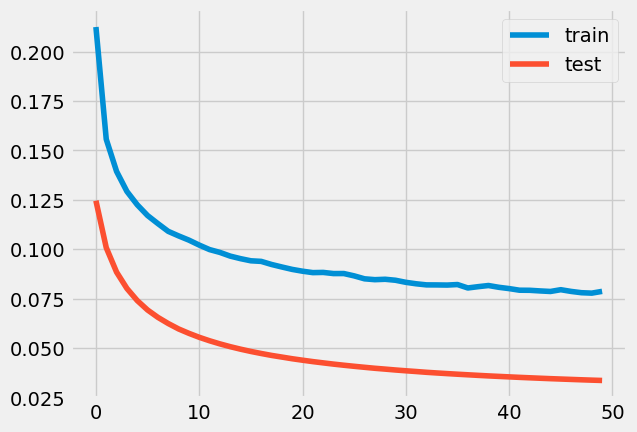

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 7s 104ms/step - loss: 0.1877 - accuracy: 0.0000e+00 - val_loss: 0.1024 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 2s 66ms/step - loss: 0.1351 - accuracy: 0.0000e+00 - val_loss: 0.0795 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 

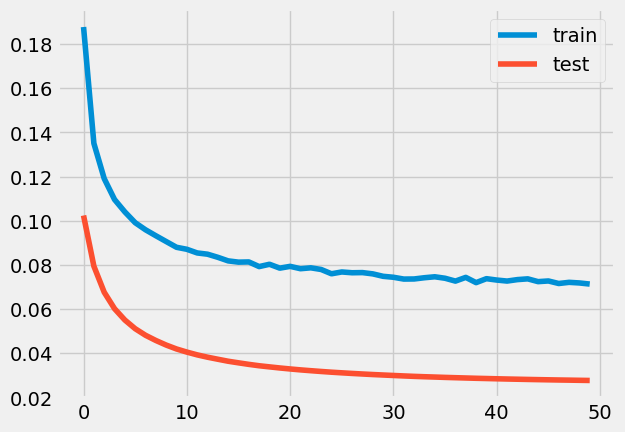

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 6s 94ms/step - loss: 0.3824 - accuracy: 0.0000e+00 - val_loss: 0.2741 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 2s 76ms/step - loss: 0.2784 - accuracy: 0.0000e+00 - val_loss: 0.2249 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

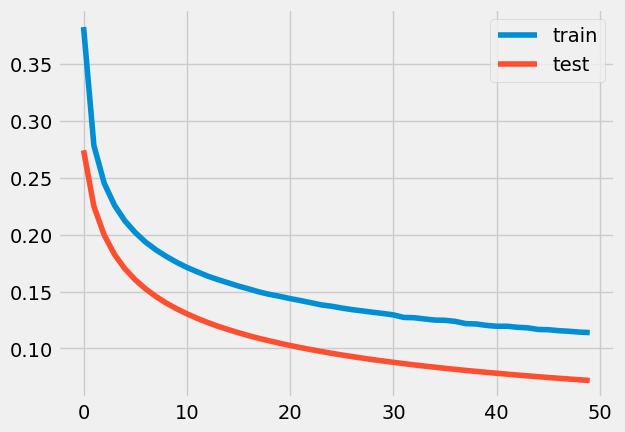

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 6s 107ms/step - loss: 0.2523 - accuracy: 0.0000e+00 - val_loss: 0.1520 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 2s 75ms/step - loss: 0.1759 - accuracy: 0.0000e+00 - val_loss: 0.1196 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 


loss: 3.54%



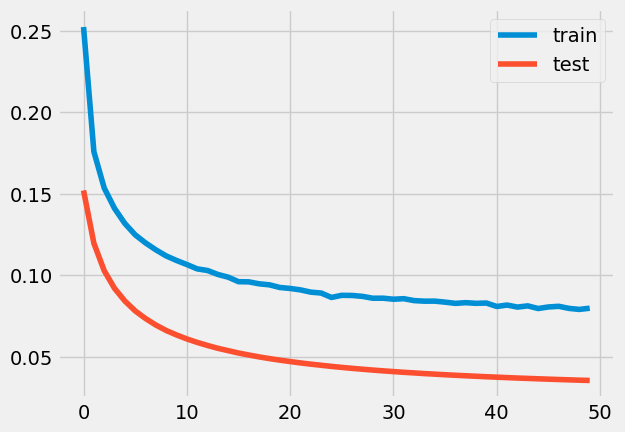

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 5s 86ms/step - loss: 0.1721 - accuracy: 0.0000e+00 - val_loss: 0.0739 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 51ms/step - loss: 0.1080 - accuracy: 9.8361e-05 - val_loss: 0.0530 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

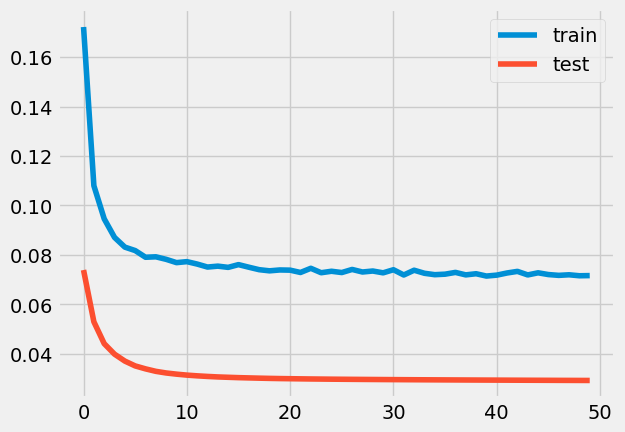

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 6s 108ms/step - loss: 0.1700 - accuracy: 0.0000e+00 - val_loss: 0.0874 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 66ms/step - loss: 0.1248 - accuracy: 0.0000e+00 - val_loss: 0.0694 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 

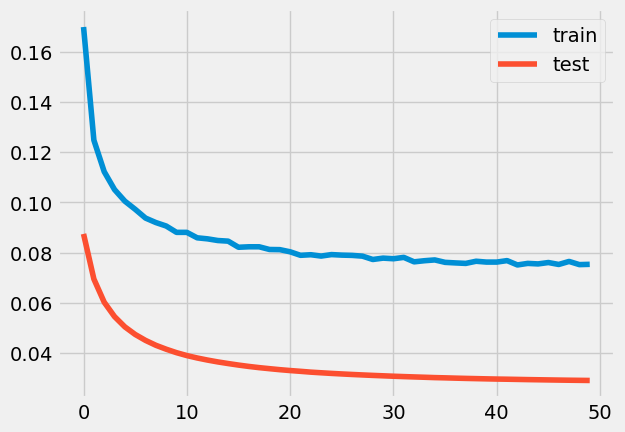

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 5s 102ms/step - loss: 0.2276 - accuracy: 0.0000e+00 - val_loss: 0.1381 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 67ms/step - loss: 0.1652 - accuracy: 0.0000e+00 - val_loss: 0.1106 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 

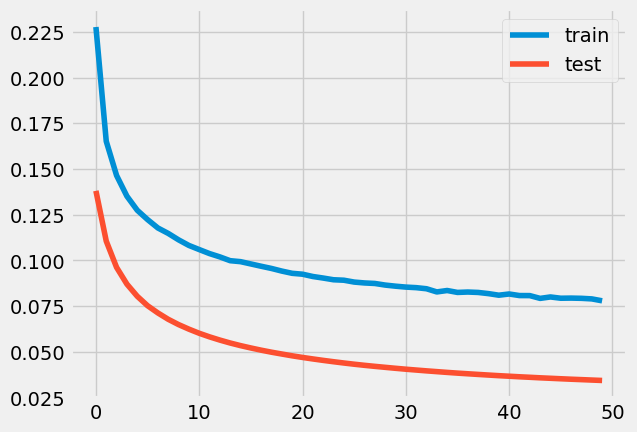

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 6s 100ms/step - loss: 0.1917 - accuracy: 0.0000e+00 - val_loss: 0.1103 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 71ms/step - loss: 0.1430 - accuracy: 0.0000e+00 - val_loss: 0.0898 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 

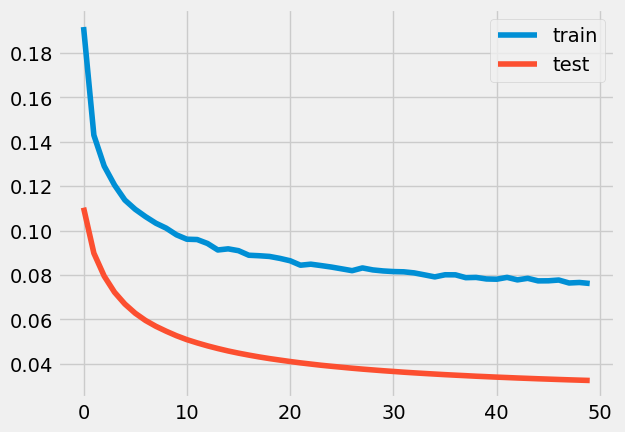

0.000390625
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 6s 97ms/step - loss: 0.2584 - accuracy: 0.0000e+00 - val_loss: 0.1593 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 66ms/step - loss: 0.1805 - accuracy: 0.0000e+00 - val_loss: 0.1262 - val_accuracy: 0.0000e+00
Epoch 

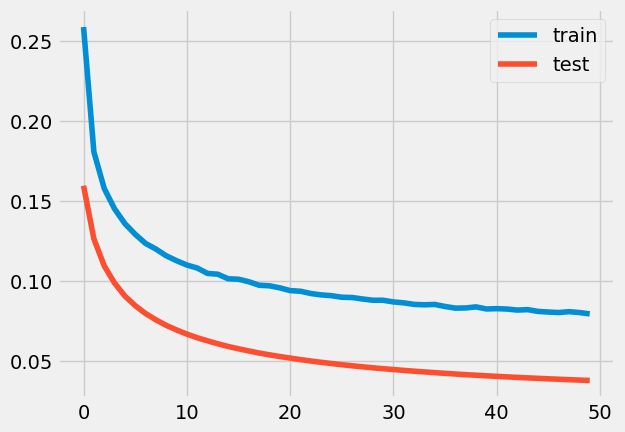

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 6s 109ms/step - loss: 0.2355 - accuracy: 0.0000e+00 - val_loss: 0.1477 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 67ms/step - loss: 0.1755 - accuracy: 0.0000e+00 - val_loss: 0.1203 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 

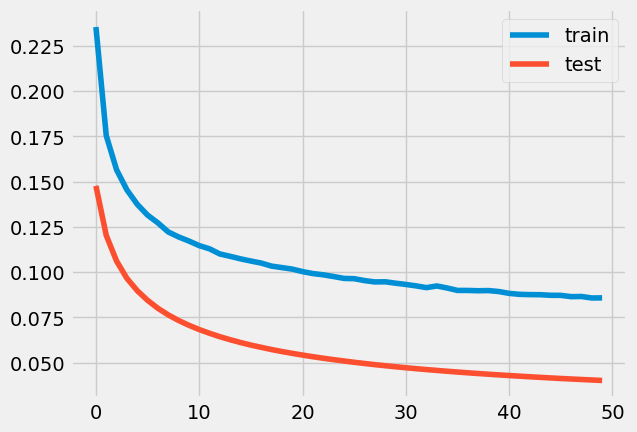

0.001854411589452872
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 6s 97ms/step - loss: 0.1957 - accuracy: 0.0000e+00 - val_loss: 0.1121 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 63ms/step - loss: 0.1450 - accuracy: 0.0000e+00 - val_loss: 0.0905 - val_accuracy: 0.0000e+


loss: 3.25%



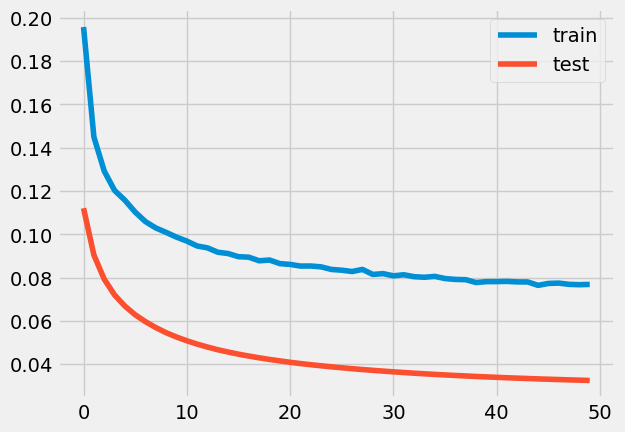

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 5s 98ms/step - loss: 0.1783 - accuracy: 0.0000e+00 - val_loss: 0.0896 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 2s 64ms/step - loss: 0.1237 - accuracy: 0.0000e+00 - val_loss: 0.0676 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

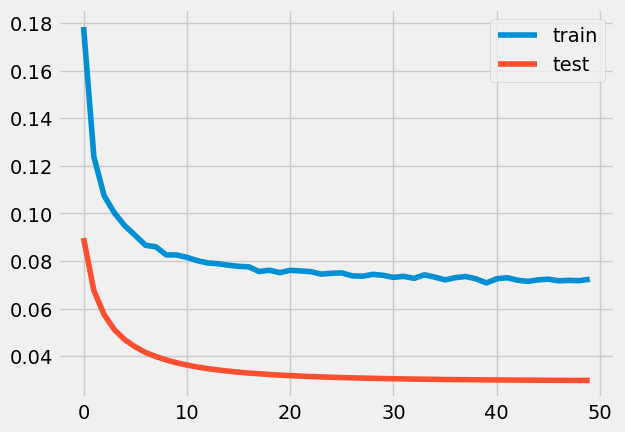

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 5s 93ms/step - loss: 0.1562 - accuracy: 0.0000e+00 - val_loss: 0.0709 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 59ms/step - loss: 0.1068 - accuracy: 2.3455e-04 - val_loss: 0.0531 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

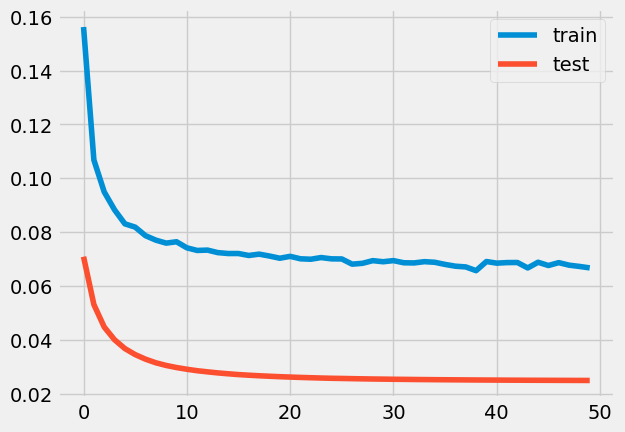

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 6s 128ms/step - loss: 0.1483 - accuracy: 1.3898e-04 - val_loss: 0.0604 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 67ms/step - loss: 0.1005 - accuracy: 4.2514e-04 - val_loss: 0.0454 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 

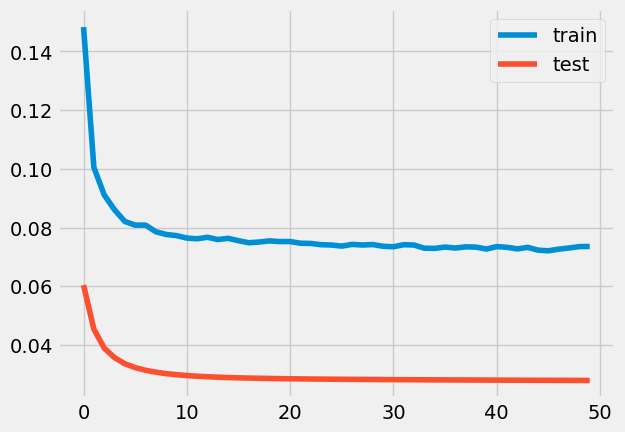

0.00040911134221366814
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 6s 102ms/step - loss: 0.3196 - accuracy: 0.0000e+00 - val_loss: 0.2204 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 2s 70ms/step - loss: 0.2360 - accuracy: 0.0000e+00 - val_loss: 0.1839 - val_accuracy: 0.000

24/24 [==============================] - 2s 65ms/step - loss: 0.1095 - accuracy: 0.0000e+00 - val_loss: 0.0665 - val_accuracy: 0.0000e+00

loss: 6.65%



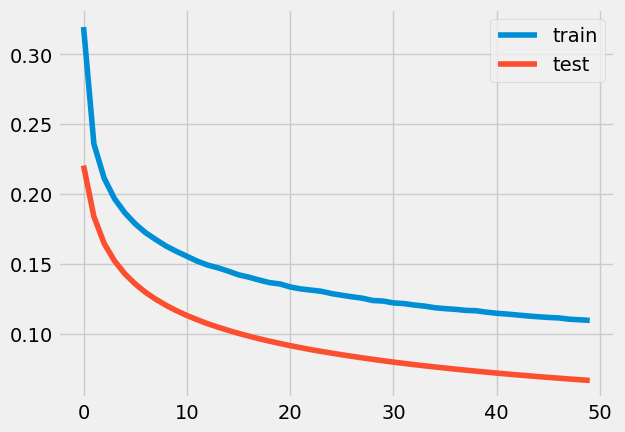

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 6s 107ms/step - loss: 0.2213 - accuracy: 0.0000e+00 - val_loss: 0.1238 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 2s 66ms/step - loss: 0.1526 - accuracy: 0.0000e+00 - val_loss: 0.0951 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 

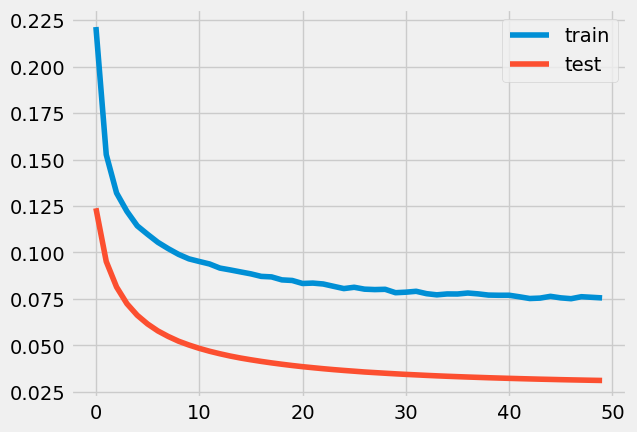

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 6s 102ms/step - loss: 0.2125 - accuracy: 0.0000e+00 - val_loss: 0.1194 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 2s 63ms/step - loss: 0.1477 - accuracy: 0.0000e+00 - val_loss: 0.0912 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 

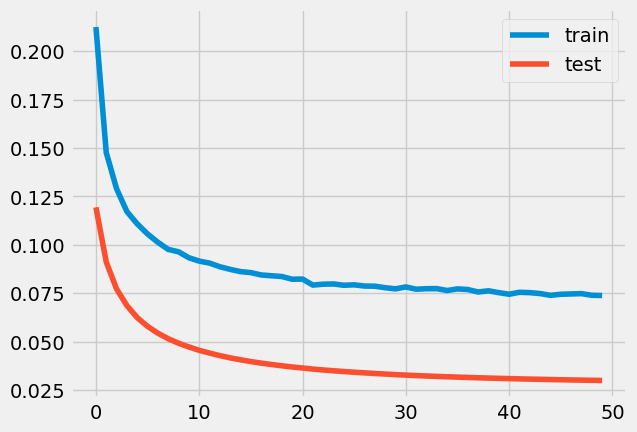

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 7s 92ms/step - loss: 0.2314 - accuracy: 0.0000e+00 - val_loss: 0.1351 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 67ms/step - loss: 0.1630 - accuracy: 0.0000e+00 - val_loss: 0.1075 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

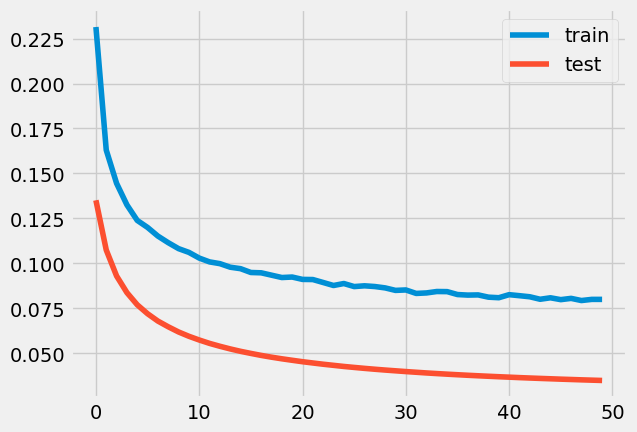

2.3286574493576215e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 6s 101ms/step - loss: 0.3162 - accuracy: 0.0000e+00 - val_loss: 0.2208 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 62ms/step - loss: 0.2385 - accuracy: 0.0000e+00 - val_loss: 0.1856 - val_accuracy: 0.000

24/24 [==============================] - 2s 66ms/step - loss: 0.1077 - accuracy: 0.0000e+00 - val_loss: 0.0626 - val_accuracy: 0.0000e+00

loss: 6.26%



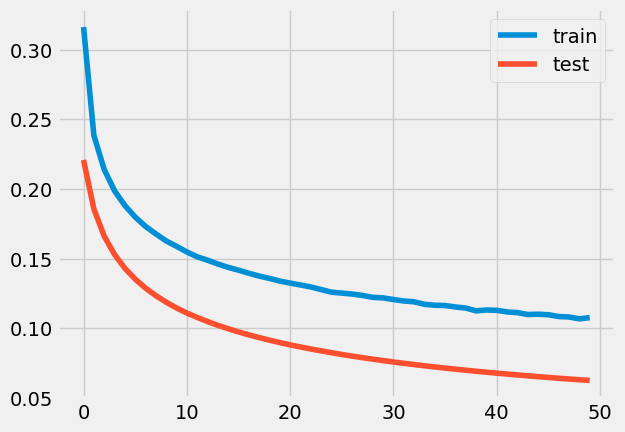

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 6s 106ms/step - loss: 0.1715 - accuracy: 0.0000e+00 - val_loss: 0.0831 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 2s 68ms/step - loss: 0.1188 - accuracy: 0.0000e+00 - val_loss: 0.0624 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 

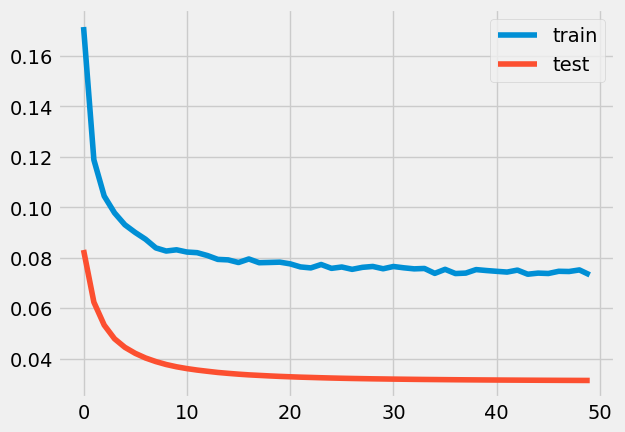

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 4s 71ms/step - loss: 0.1569 - accuracy: 0.0000e+00 - val_loss: 0.0678 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 48ms/step - loss: 0.1048 - accuracy: 3.6318e-04 - val_loss: 0.0500 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

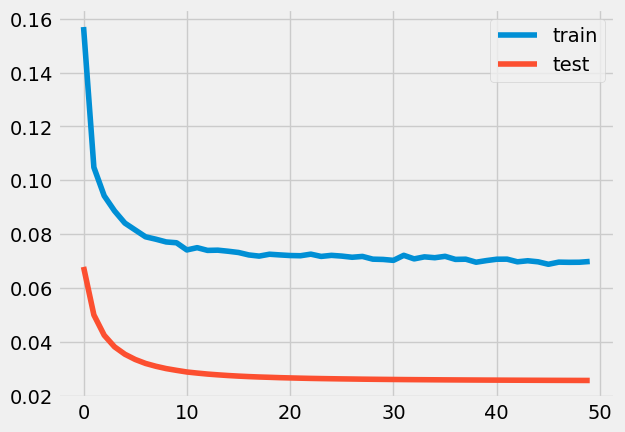

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 4s 69ms/step - loss: 0.1939 - accuracy: 0.0000e+00 - val_loss: 0.0990 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 51ms/step - loss: 0.1307 - accuracy: 0.0000e+00 - val_loss: 0.0746 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

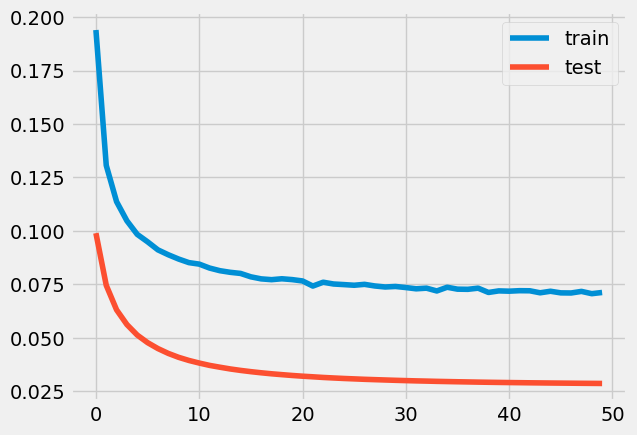

0.00041812432121370816
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 64ms/step - loss: 0.2038 - accuracy: 0.0000e+00 - val_loss: 0.1140 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 44ms/step - loss: 0.1449 - accuracy: 0.0000e+00 - val_loss: 0.0893 - val_accuracy: 0.0000

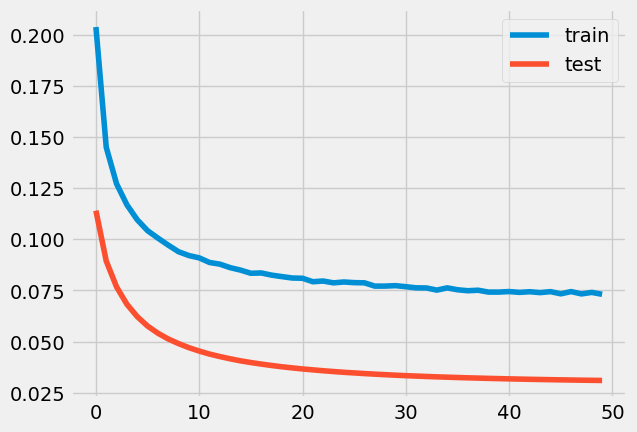

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 73ms/step - loss: 0.1470 - accuracy: 0.0000e+00 - val_loss: 0.0633 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1034 - accuracy: 1.2090e-04 - val_loss: 0.0480 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

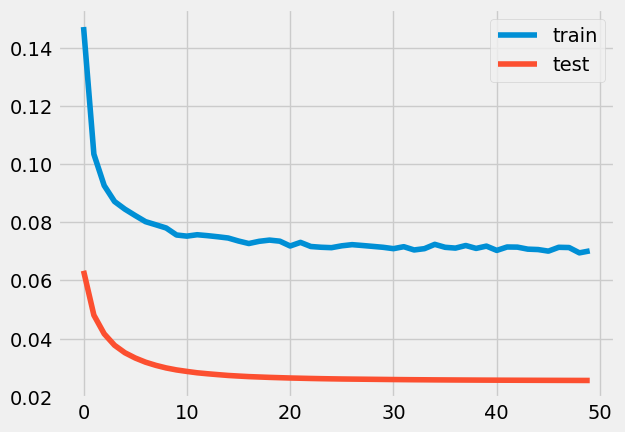

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.3486 - accuracy: 0.0000e+00 - val_loss: 0.2580 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.2725 - accuracy: 0.0000e+00 - val_loss: 0.2219 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

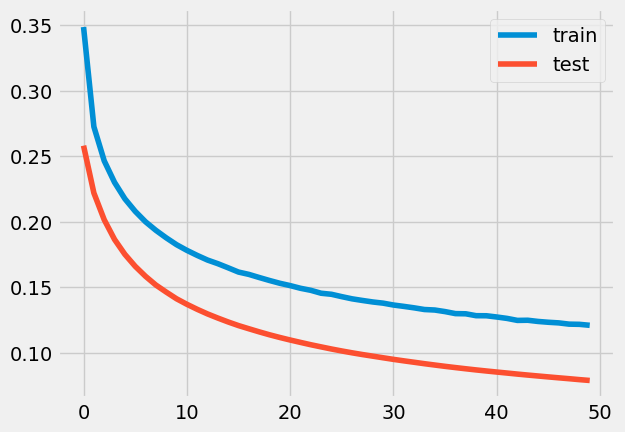

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 5s 76ms/step - loss: 0.2018 - accuracy: 0.0000e+00 - val_loss: 0.1052 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 47ms/step - loss: 0.1364 - accuracy: 0.0000e+00 - val_loss: 0.0809 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

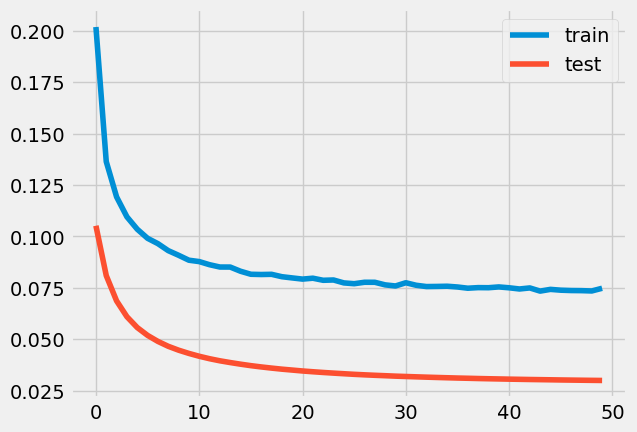

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 69ms/step - loss: 0.2483 - accuracy: 0.0000e+00 - val_loss: 0.1622 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 43ms/step - loss: 0.1894 - accuracy: 0.0000e+00 - val_loss: 0.1359 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

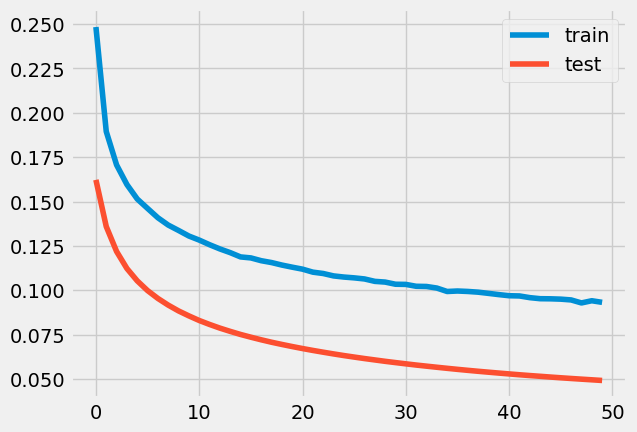

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 63ms/step - loss: 0.1456 - accuracy: 0.0000e+00 - val_loss: 0.0637 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 43ms/step - loss: 0.1034 - accuracy: 5.7251e-04 - val_loss: 0.0489 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

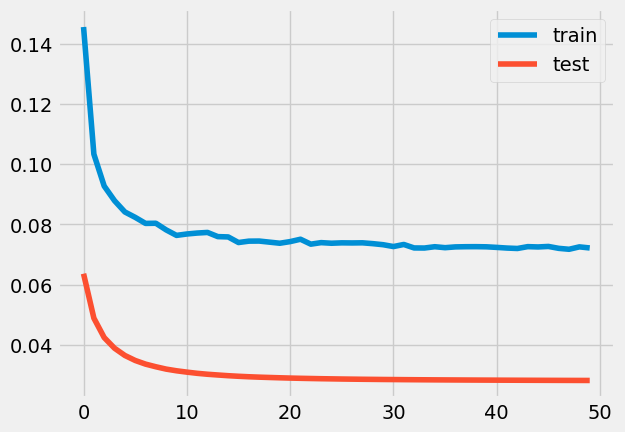

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 65ms/step - loss: 0.1222 - accuracy: 2.4968e-04 - val_loss: 0.0443 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 43ms/step - loss: 0.0879 - accuracy: 0.0010 - val_loss: 0.0342 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [====

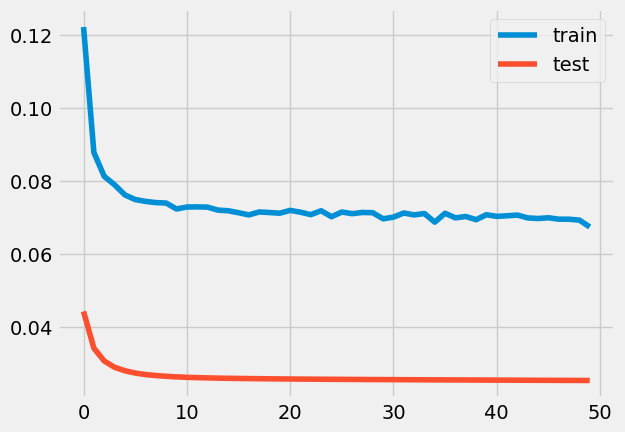

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 4s 78ms/step - loss: 0.3024 - accuracy: 0.0000e+00 - val_loss: 0.2120 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 50ms/step - loss: 0.2316 - accuracy: 0.0000e+00 - val_loss: 0.1799 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

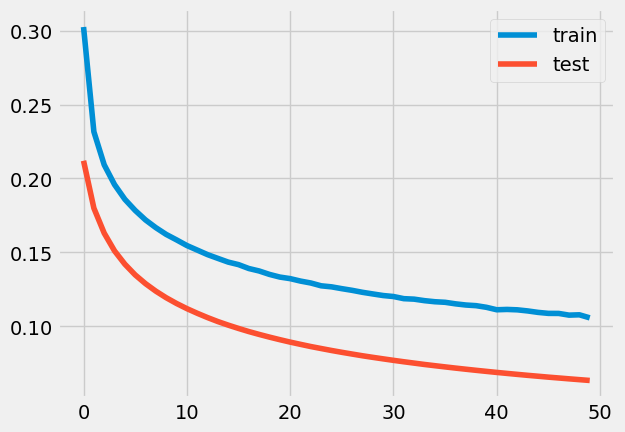

5.130623844667738e-43
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 67ms/step - loss: 0.1684 - accuracy: 0.0000e+00 - val_loss: 0.0815 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 45ms/step - loss: 0.1178 - accuracy: 2.1858e-05 - val_loss: 0.0625 - val_accuracy: 0.0000e

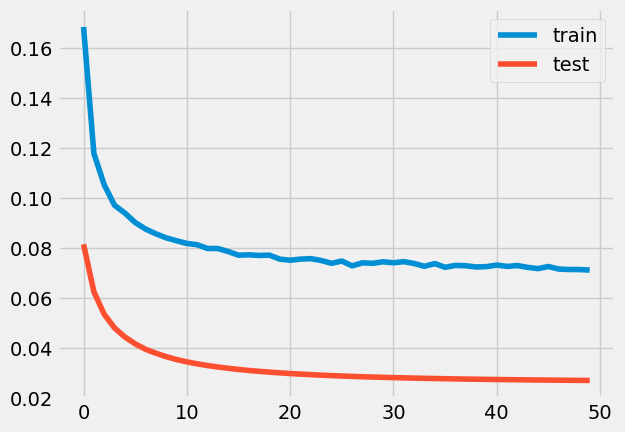

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 4s 59ms/step - loss: 0.1199 - accuracy: 7.5410e-05 - val_loss: 0.0433 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 1s 43ms/step - loss: 0.0867 - accuracy: 0.0013 - val_loss: 0.0344 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [====

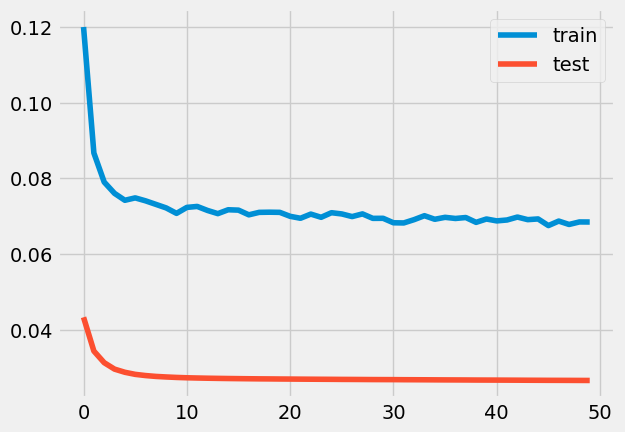

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 4s 57ms/step - loss: 0.2268 - accuracy: 0.0000e+00 - val_loss: 0.1284 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 1s 42ms/step - loss: 0.1548 - accuracy: 0.0000e+00 - val_loss: 0.0997 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

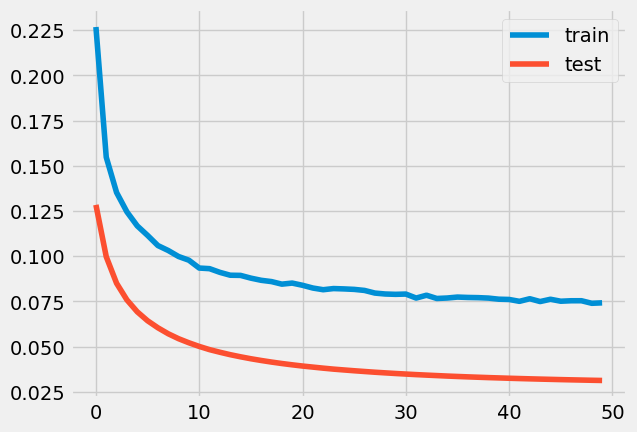

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 64ms/step - loss: 0.1614 - accuracy: 0.0000e+00 - val_loss: 0.0787 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 46ms/step - loss: 0.1145 - accuracy: 0.0000e+00 - val_loss: 0.0597 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

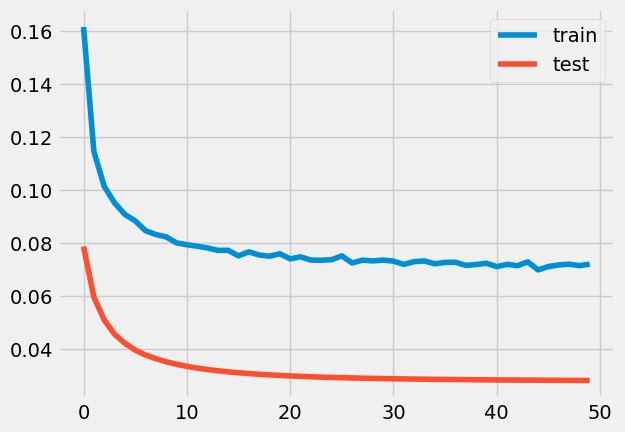

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 65ms/step - loss: 0.1720 - accuracy: 0.0000e+00 - val_loss: 0.0874 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 47ms/step - loss: 0.1242 - accuracy: 0.0000e+00 - val_loss: 0.0688 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

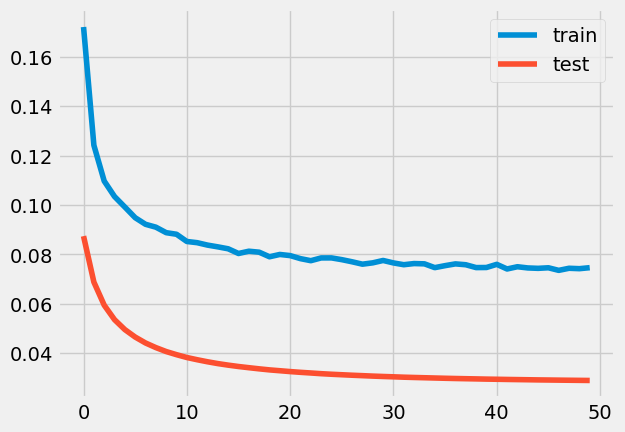

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 68ms/step - loss: 0.2663 - accuracy: 0.0000e+00 - val_loss: 0.1579 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 51ms/step - loss: 0.1773 - accuracy: 0.0000e+00 - val_loss: 0.1223 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [


loss: 3.33%



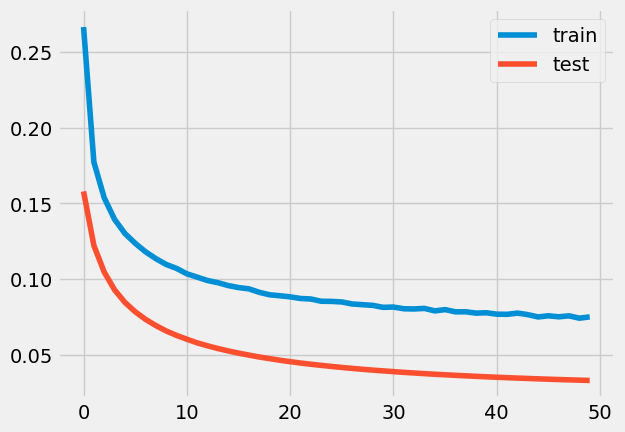

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 66ms/step - loss: 0.2757 - accuracy: 0.0000e+00 - val_loss: 0.1823 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 48ms/step - loss: 0.2052 - accuracy: 0.0000e+00 - val_loss: 0.1522 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

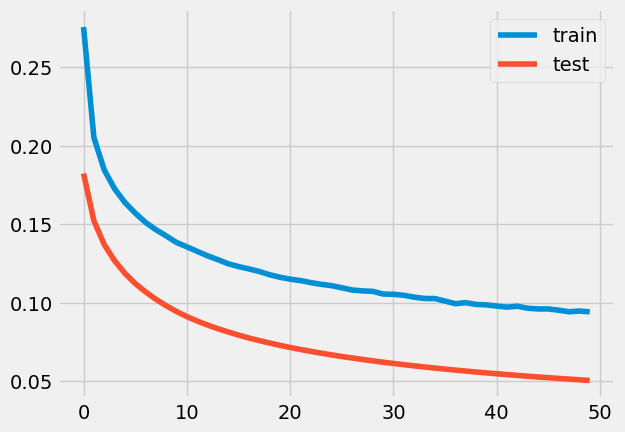

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 58ms/step - loss: 0.2064 - accuracy: 0.0000e+00 - val_loss: 0.1070 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 40ms/step - loss: 0.1349 - accuracy: 0.0000e+00 - val_loss: 0.0801 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

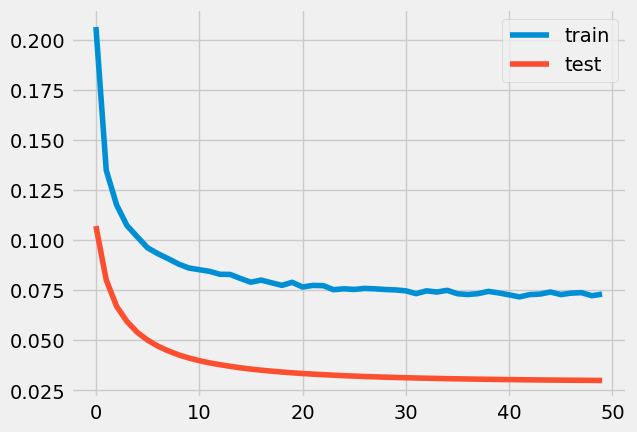

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 4s 72ms/step - loss: 0.2853 - accuracy: 0.0000e+00 - val_loss: 0.1758 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 48ms/step - loss: 0.1945 - accuracy: 0.0000e+00 - val_loss: 0.1378 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

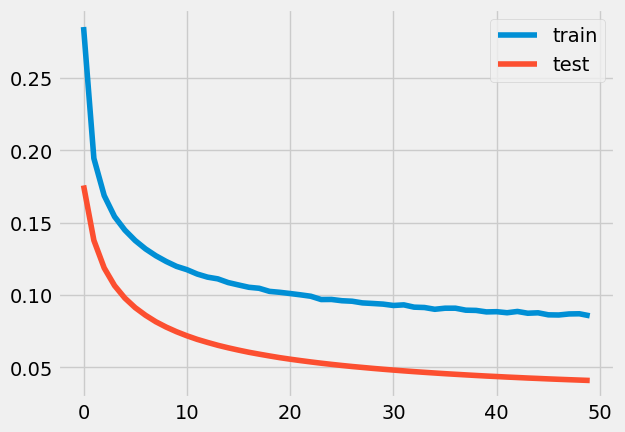

5.908015736146525e-13
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 70ms/step - loss: 0.1838 - accuracy: 0.0000e+00 - val_loss: 0.0999 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 57ms/step - loss: 0.1352 - accuracy: 0.0000e+00 - val_loss: 0.0802 - val_accuracy: 0.0000e

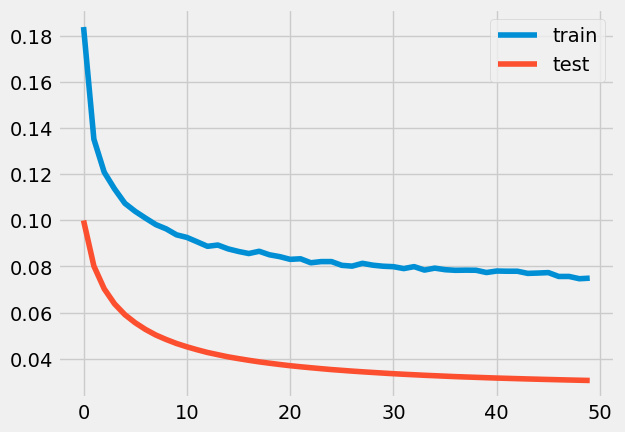

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 69ms/step - loss: 0.2315 - accuracy: 0.0000e+00 - val_loss: 0.1385 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 49ms/step - loss: 0.1675 - accuracy: 0.0000e+00 - val_loss: 0.1126 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [


loss: 3.78%



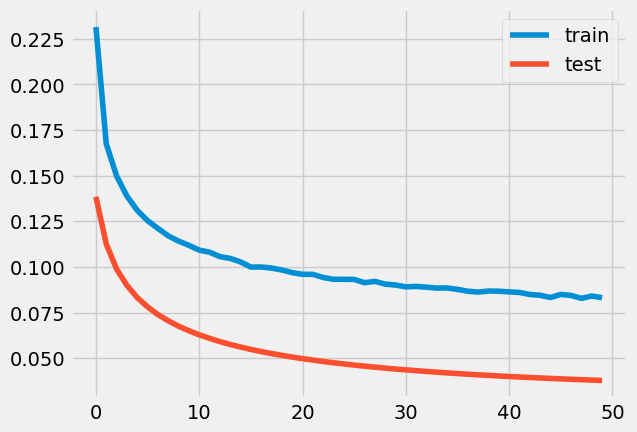

8.433886101975032e-09
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 61ms/step - loss: 0.1421 - accuracy: 1.4903e-05 - val_loss: 0.0631 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 44ms/step - loss: 0.1024 - accuracy: 2.8912e-04 - val_loss: 0.0489 - val_accuracy: 0.0000e

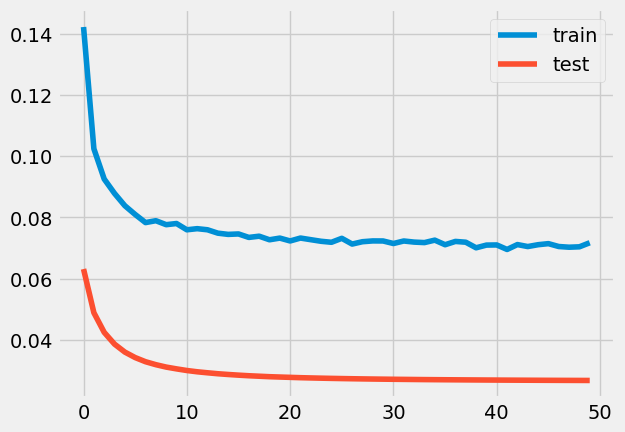

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 61ms/step - loss: 0.3002 - accuracy: 0.0000e+00 - val_loss: 0.1931 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 45ms/step - loss: 0.2086 - accuracy: 0.0000e+00 - val_loss: 0.1538 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

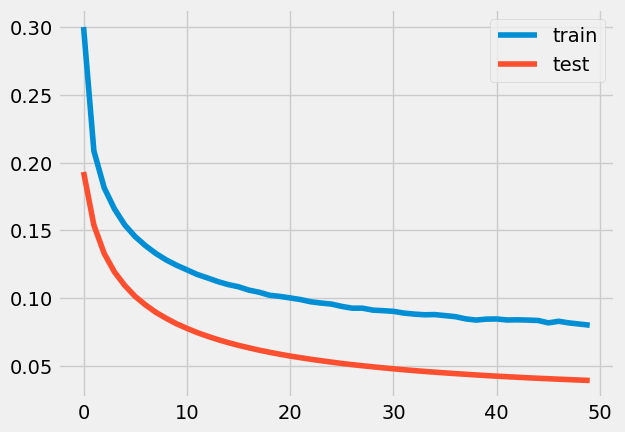

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 66ms/step - loss: 0.2188 - accuracy: 0.0000e+00 - val_loss: 0.1415 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 45ms/step - loss: 0.1741 - accuracy: 0.0000e+00 - val_loss: 0.1214 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

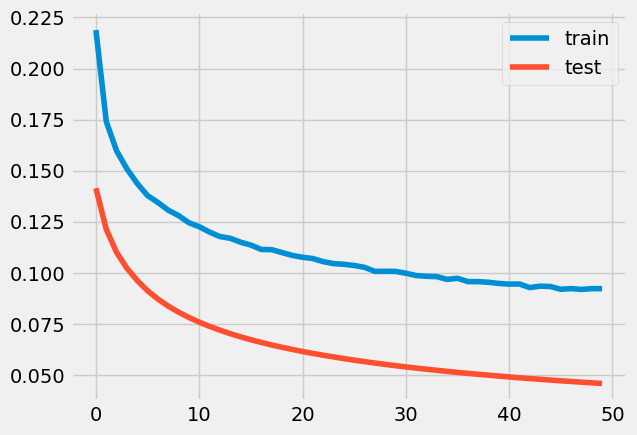

2.112385203766991e-08
0.0001953125
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 62ms/step - loss: 0.2802 - accuracy: 0.0000e+00 - val_loss: 0.1892 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 46ms/step - loss: 0.2109 - accuracy: 0.0000e+00 - val_loss: 0.1582 - val_accu

28/28 [==============================] - 1s 44ms/step - loss: 0.1012 - accuracy: 1.2519e-04 - val_loss: 0.0576 - val_accuracy: 0.0000e+00

loss: 5.76%



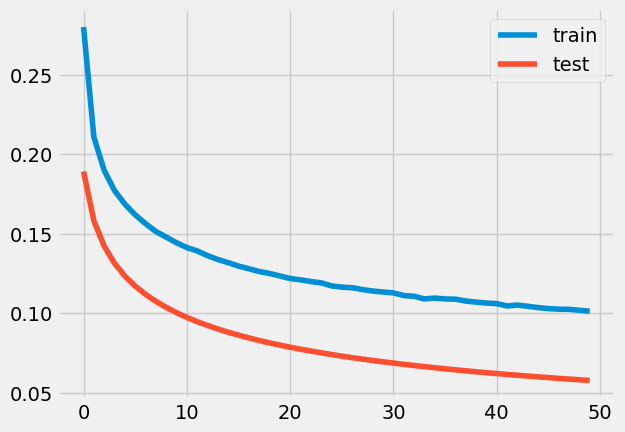

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 4s 58ms/step - loss: 0.1709 - accuracy: 0.0000e+00 - val_loss: 0.0879 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 1s 43ms/step - loss: 0.1237 - accuracy: 0.0000e+00 - val_loss: 0.0690 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

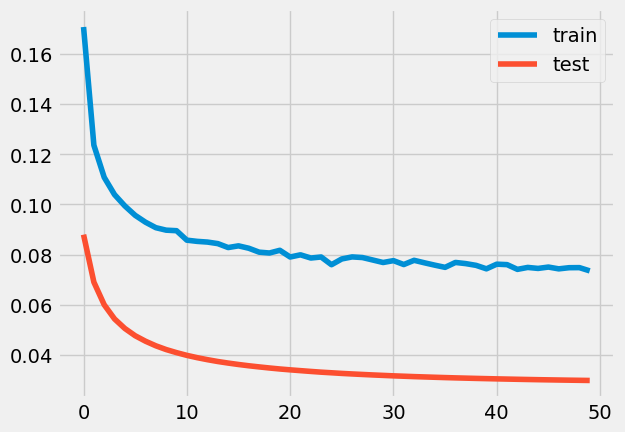

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 4s 58ms/step - loss: 0.1900 - accuracy: 0.0000e+00 - val_loss: 0.0949 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 1s 43ms/step - loss: 0.1273 - accuracy: 0.0000e+00 - val_loss: 0.0723 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

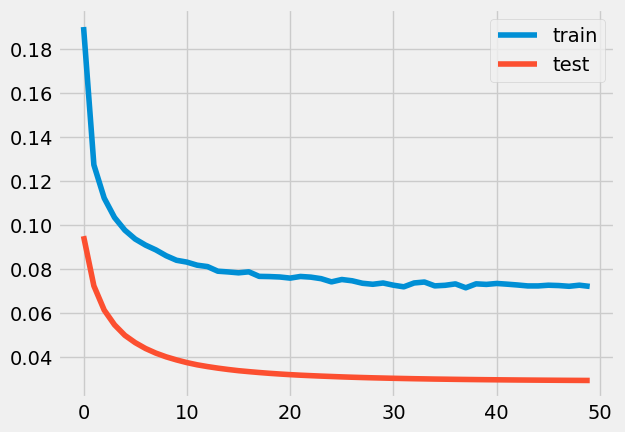

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 62ms/step - loss: 0.1331 - accuracy: 1.1028e-04 - val_loss: 0.0518 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 44ms/step - loss: 0.0921 - accuracy: 0.0010 - val_loss: 0.0395 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [====

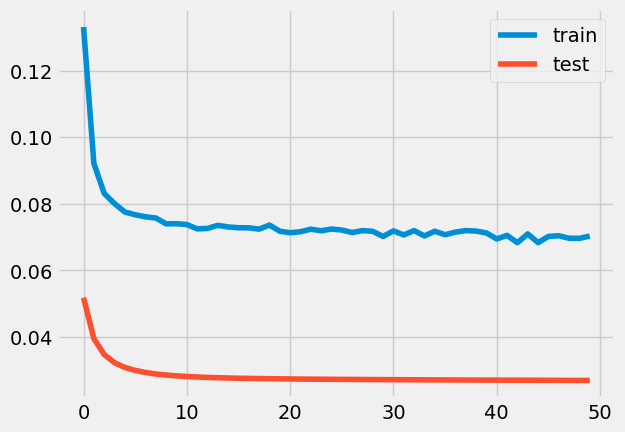

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 61ms/step - loss: 0.1850 - accuracy: 0.0000e+00 - val_loss: 0.0967 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 43ms/step - loss: 0.1280 - accuracy: 0.0000e+00 - val_loss: 0.0735 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

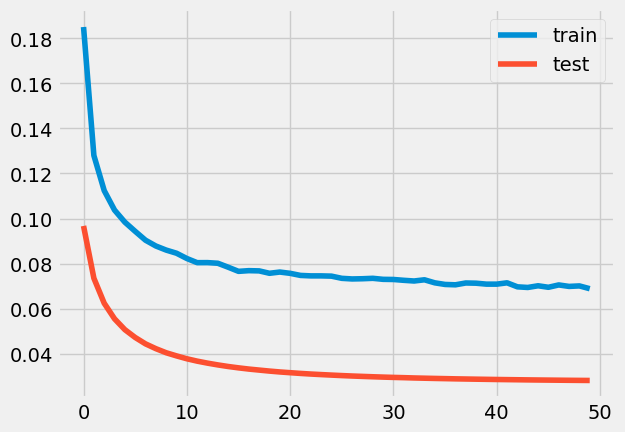

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 62ms/step - loss: 0.1400 - accuracy: 9.8361e-05 - val_loss: 0.0562 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 45ms/step - loss: 0.0945 - accuracy: 2.8316e-04 - val_loss: 0.0421 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

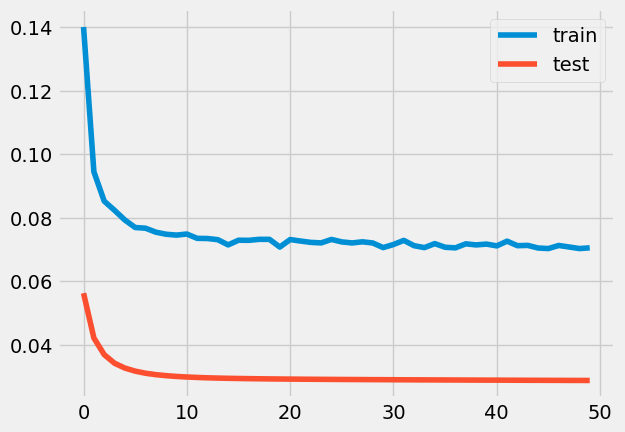

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 4s 82ms/step - loss: 0.2046 - accuracy: 0.0000e+00 - val_loss: 0.1151 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 58ms/step - loss: 0.1482 - accuracy: 0.0000e+00 - val_loss: 0.0924 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [

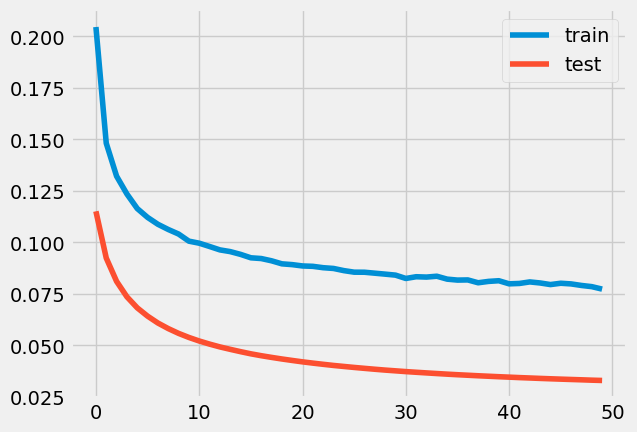

3.5255522914811204e-10
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 63ms/step - loss: 0.3028 - accuracy: 0.0000e+00 - val_loss: 0.2045 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 46ms/step - loss: 0.2219 - accuracy: 0.0000e+00 - val_loss: 0.1692 - val_accuracy: 0.0000

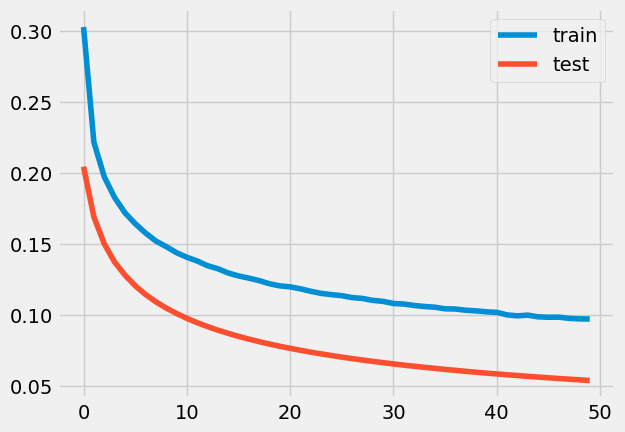

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 64ms/step - loss: 0.2174 - accuracy: 0.0000e+00 - val_loss: 0.1324 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 45ms/step - loss: 0.1618 - accuracy: 0.0000e+00 - val_loss: 0.1068 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [


loss: 3.68%



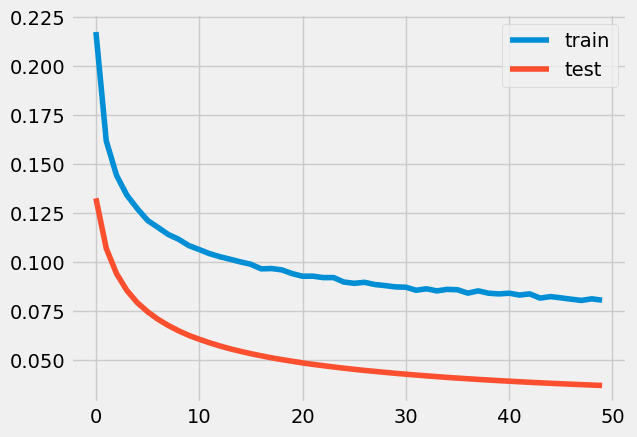

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 4s 72ms/step - loss: 0.1433 - accuracy: 1.0088e-05 - val_loss: 0.0634 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 45ms/step - loss: 0.1039 - accuracy: 6.8600e-04 - val_loss: 0.0493 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

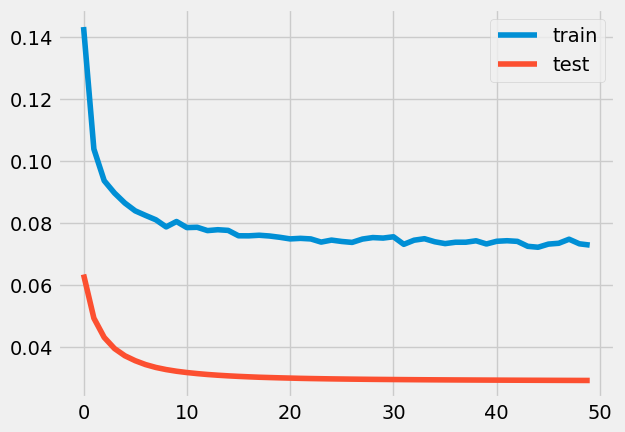

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 4s 67ms/step - loss: 0.1434 - accuracy: 0.0000e+00 - val_loss: 0.0591 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 46ms/step - loss: 0.0966 - accuracy: 4.4388e-04 - val_loss: 0.0445 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

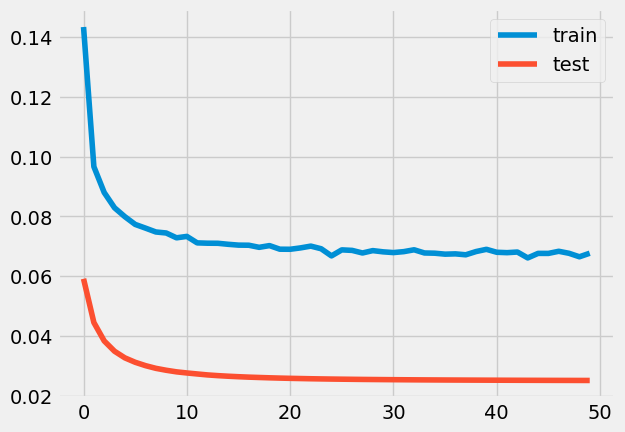

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 64ms/step - loss: 0.2180 - accuracy: 0.0000e+00 - val_loss: 0.1288 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 47ms/step - loss: 0.1554 - accuracy: 0.0000e+00 - val_loss: 0.1008 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

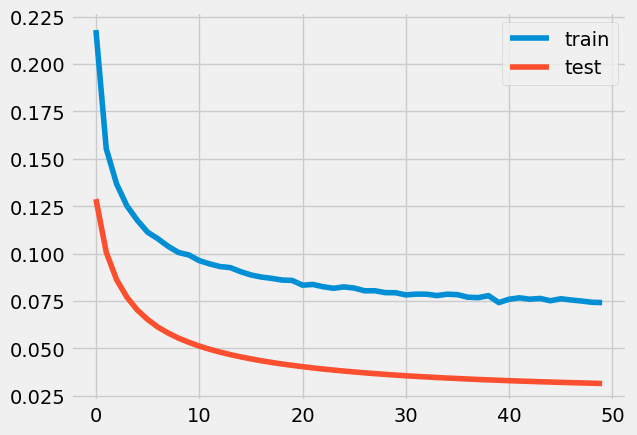

3.646389167274007e-15
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 69ms/step - loss: 0.1310 - accuracy: 1.5132e-04 - val_loss: 0.0481 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 48ms/step - loss: 0.0896 - accuracy: 6.0782e-04 - val_loss: 0.0366 - val_accuracy: 0.0000e

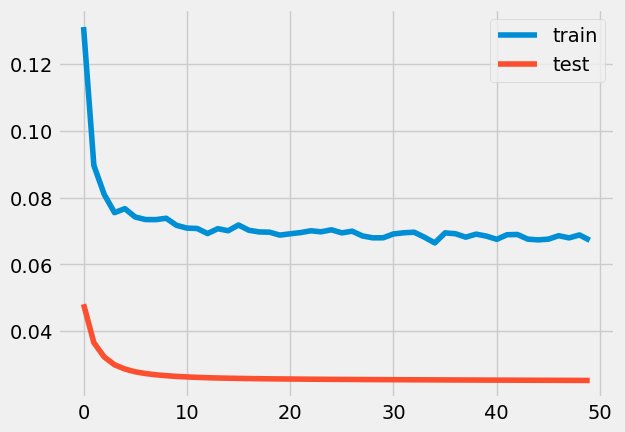

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 62ms/step - loss: 0.1421 - accuracy: 0.0000e+00 - val_loss: 0.0643 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 42ms/step - loss: 0.1054 - accuracy: 2.9274e-04 - val_loss: 0.0507 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

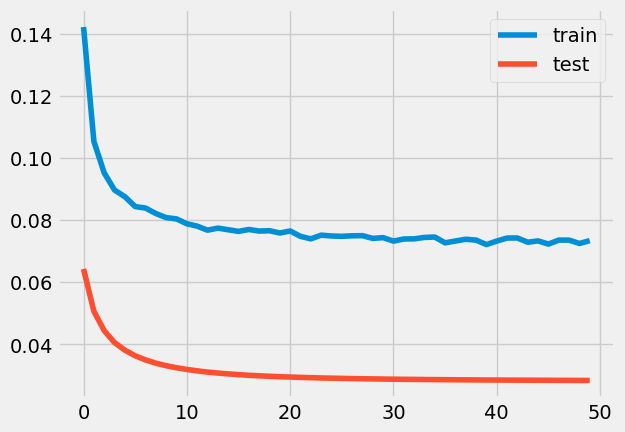

1.1150278056062228e-07
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 60ms/step - loss: 0.2833 - accuracy: 0.0000e+00 - val_loss: 0.1972 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 43ms/step - loss: 0.2184 - accuracy: 0.0000e+00 - val_loss: 0.1669 - val_accuracy: 0.0000

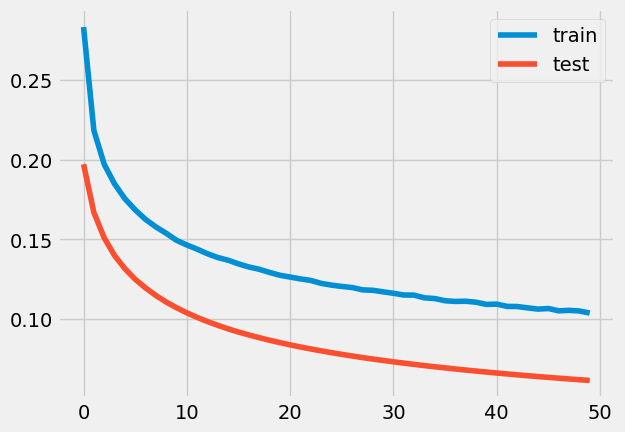

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 66ms/step - loss: 0.2973 - accuracy: 0.0000e+00 - val_loss: 0.2020 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 46ms/step - loss: 0.2201 - accuracy: 0.0000e+00 - val_loss: 0.1678 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

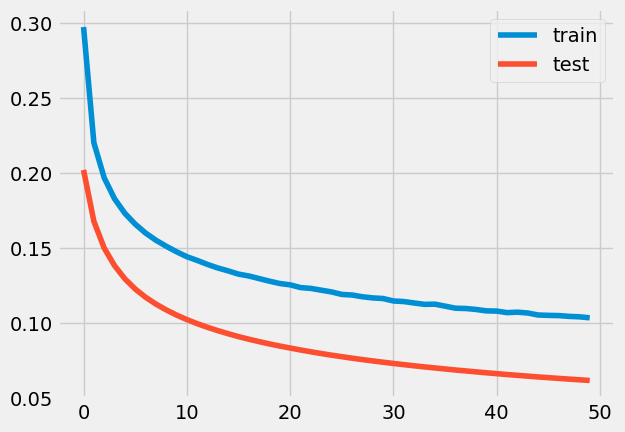

0.4270521459225252
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 65ms/step - loss: 0.1606 - accuracy: 0.0000e+00 - val_loss: 0.0694 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 44ms/step - loss: 0.1070 - accuracy: 6.0530e-05 - val_loss: 0.0523 - val_accuracy: 0.0000e+00

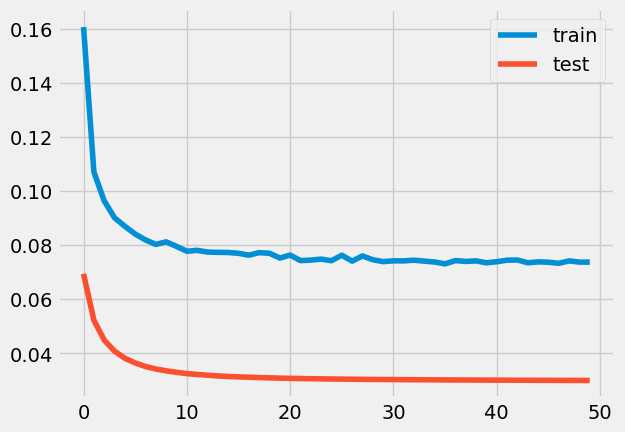

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 67ms/step - loss: 0.3283 - accuracy: 0.0000e+00 - val_loss: 0.2230 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 44ms/step - loss: 0.2350 - accuracy: 0.0000e+00 - val_loss: 0.1812 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

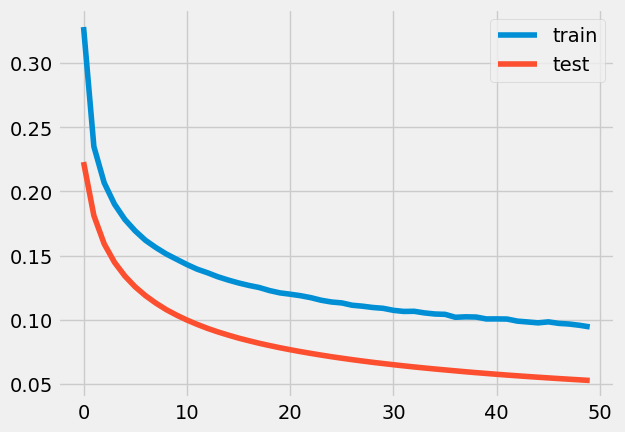

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 4s 78ms/step - loss: 0.1146 - accuracy: 6.3808e-04 - val_loss: 0.0379 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 56ms/step - loss: 0.0811 - accuracy: 0.0042 - val_loss: 0.0317 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [====

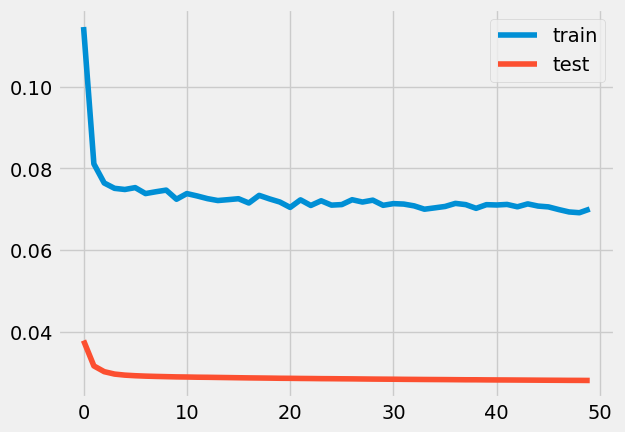

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 4s 71ms/step - loss: 0.1257 - accuracy: 2.4356e-04 - val_loss: 0.0508 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 52ms/step - loss: 0.0940 - accuracy: 0.0011 - val_loss: 0.0403 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [====

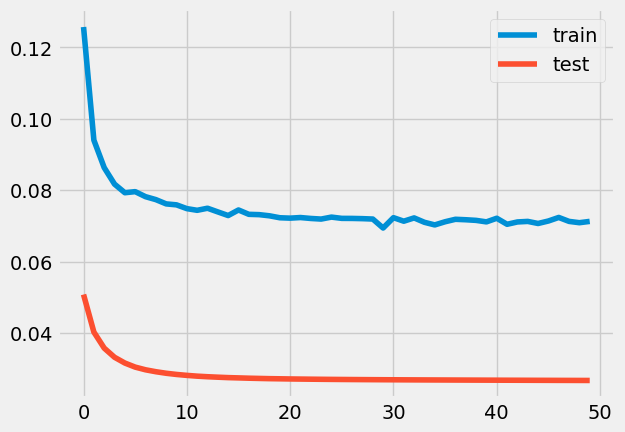

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 4s 76ms/step - loss: 0.2267 - accuracy: 0.0000e+00 - val_loss: 0.1429 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 53ms/step - loss: 0.1720 - accuracy: 0.0000e+00 - val_loss: 0.1185 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

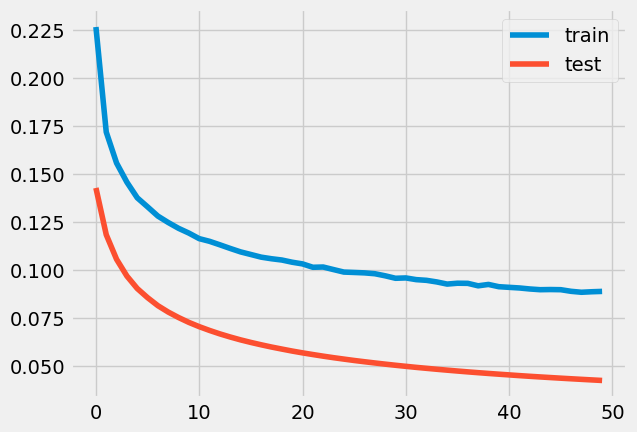

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 3s 85ms/step - loss: 0.1268 - accuracy: 4.8108e-04 - val_loss: 0.0449 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 59ms/step - loss: 0.0883 - accuracy: 0.0024 - val_loss: 0.0345 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 [====

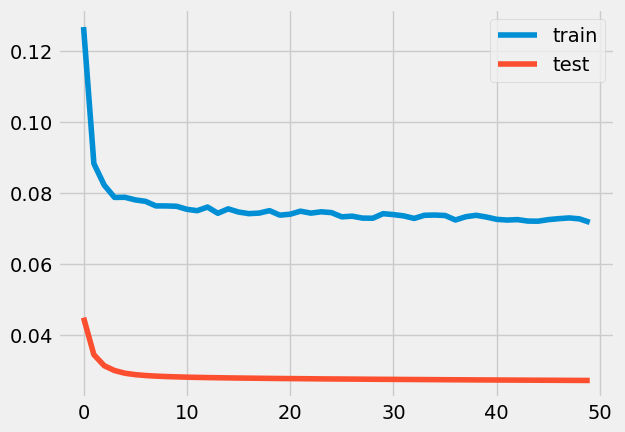

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 3s 96ms/step - loss: 0.2154 - accuracy: 0.0000e+00 - val_loss: 0.1097 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 60ms/step - loss: 0.1392 - accuracy: 0.0000e+00 - val_loss: 0.0818 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 [

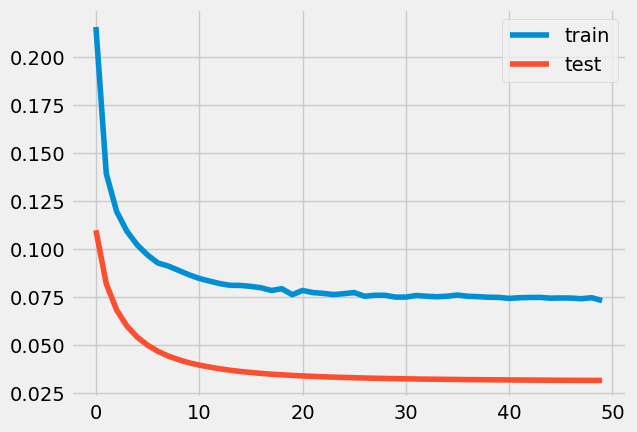

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 4s 77ms/step - loss: 0.2067 - accuracy: 0.0000e+00 - val_loss: 0.1133 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 52ms/step - loss: 0.1427 - accuracy: 0.0000e+00 - val_loss: 0.0865 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 [

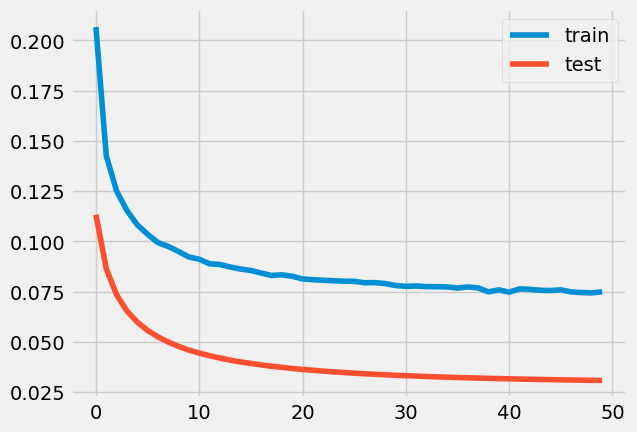

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 3s 79ms/step - loss: 0.1129 - accuracy: 2.5072e-04 - val_loss: 0.0371 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 53ms/step - loss: 0.0841 - accuracy: 0.0031 - val_loss: 0.0320 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 [====

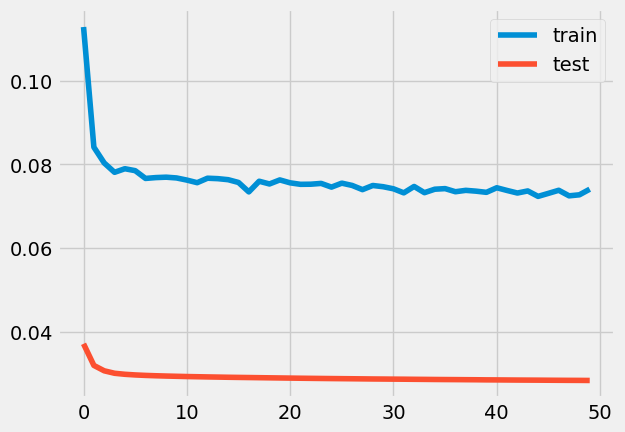

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 68ms/step - loss: 0.1092 - accuracy: 1.8970e-04 - val_loss: 0.0370 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 46ms/step - loss: 0.0799 - accuracy: 0.0033 - val_loss: 0.0306 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [====

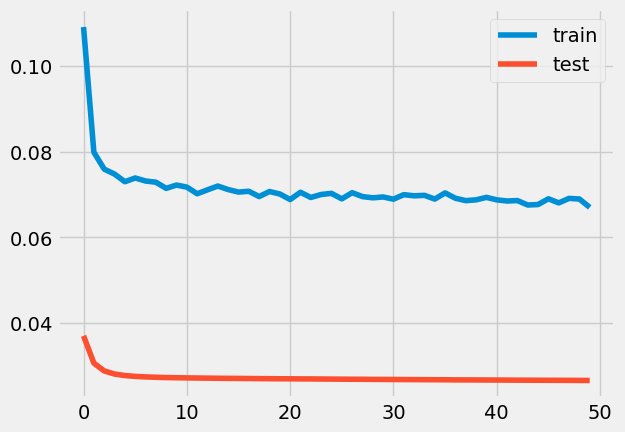

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 70ms/step - loss: 0.1983 - accuracy: 0.0000e+00 - val_loss: 0.1125 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 46ms/step - loss: 0.1435 - accuracy: 0.0000e+00 - val_loss: 0.0888 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

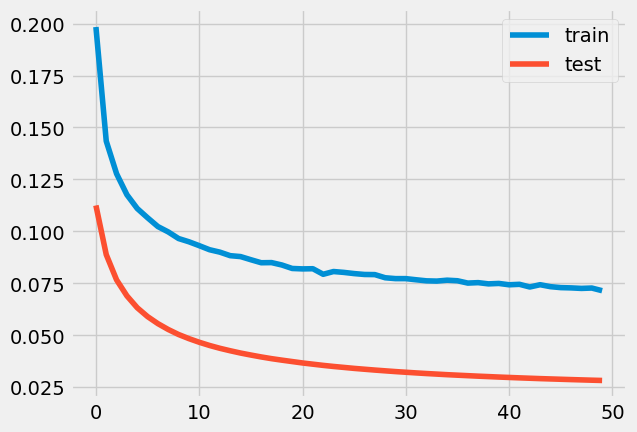

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 4s 65ms/step - loss: 0.2547 - accuracy: 0.0000e+00 - val_loss: 0.1670 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 44ms/step - loss: 0.1927 - accuracy: 0.0000e+00 - val_loss: 0.1394 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

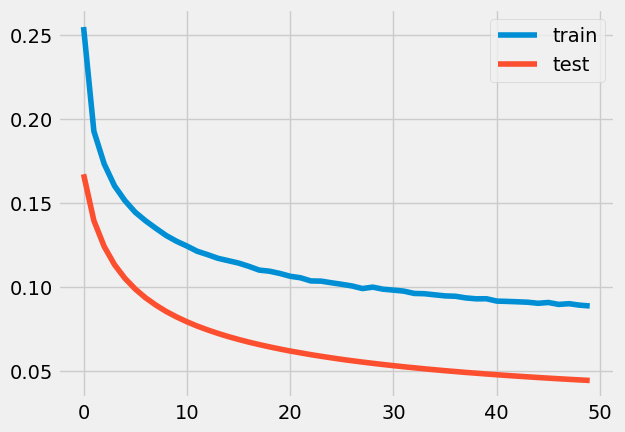

6.635031072130948e-36
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 5s 95ms/step - loss: 0.1519 - accuracy: 1.1923e-05 - val_loss: 0.0636 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 53ms/step - loss: 0.1014 - accuracy: 3.5363e-04 - val_loss: 0.0472 - val_accuracy: 0.0000e

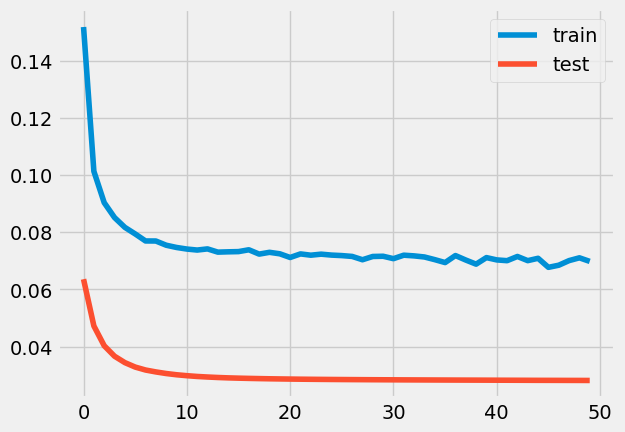

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 74ms/step - loss: 0.2191 - accuracy: 0.0000e+00 - val_loss: 0.1290 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1596 - accuracy: 0.0000e+00 - val_loss: 0.1033 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

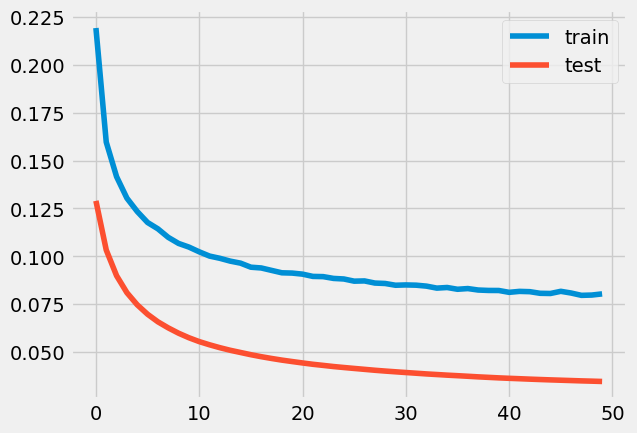

2.1270173326824786e-15
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 69ms/step - loss: 0.1701 - accuracy: 0.0000e+00 - val_loss: 0.0871 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 44ms/step - loss: 0.1219 - accuracy: 0.0000e+00 - val_loss: 0.0661 - val_accuracy: 0.0000

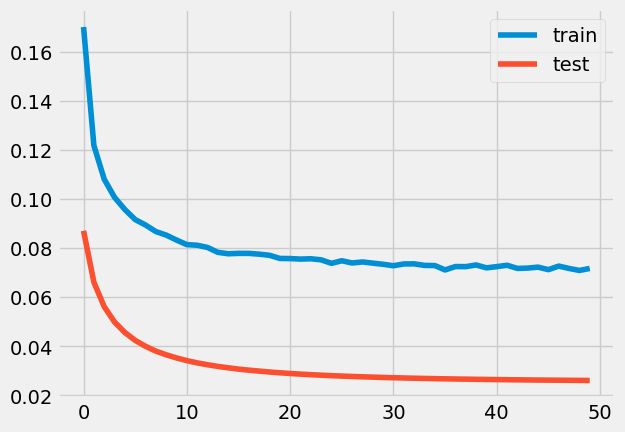

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 66ms/step - loss: 0.1571 - accuracy: 0.0000e+00 - val_loss: 0.0753 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 43ms/step - loss: 0.1124 - accuracy: 9.5628e-05 - val_loss: 0.0573 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

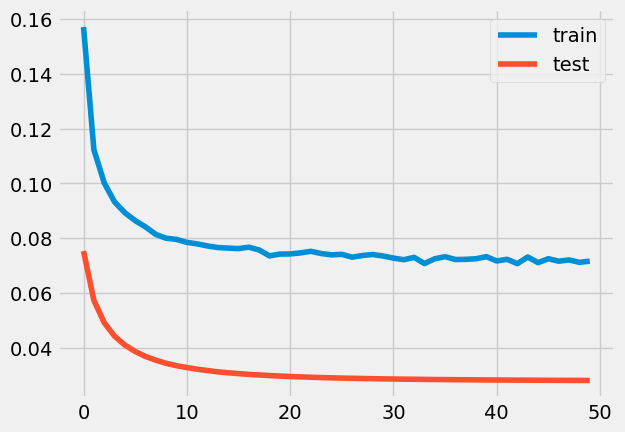

4.486150566925166e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 68ms/step - loss: 0.1291 - accuracy: 2.5293e-04 - val_loss: 0.0500 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 47ms/step - loss: 0.0916 - accuracy: 0.0011 - val_loss: 0.0380 - val_accuracy: 0.0000e+00


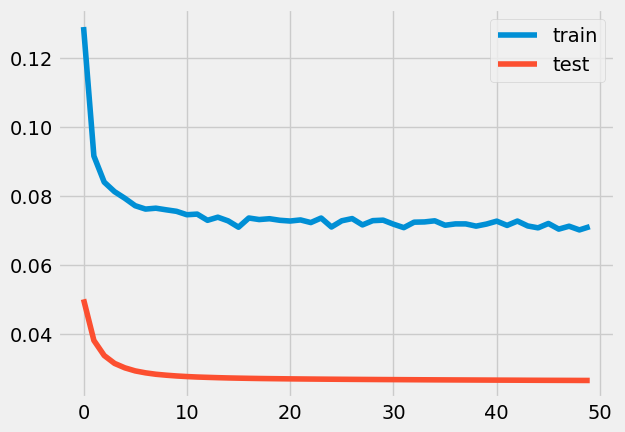

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 77ms/step - loss: 0.1235 - accuracy: 8.0874e-04 - val_loss: 0.0434 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 50ms/step - loss: 0.0834 - accuracy: 0.0023 - val_loss: 0.0339 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [====

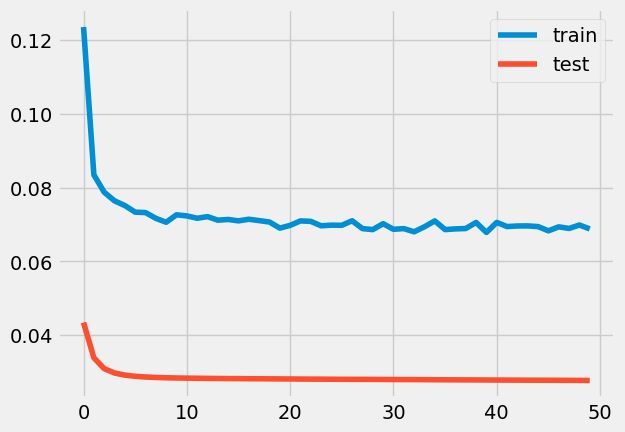

0.0009233386439938894
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 4s 72ms/step - loss: 0.1025 - accuracy: 7.3770e-04 - val_loss: 0.0330 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 50ms/step - loss: 0.0798 - accuracy: 0.0043 - val_loss: 0.0294 - val_accuracy: 0.0000e+00


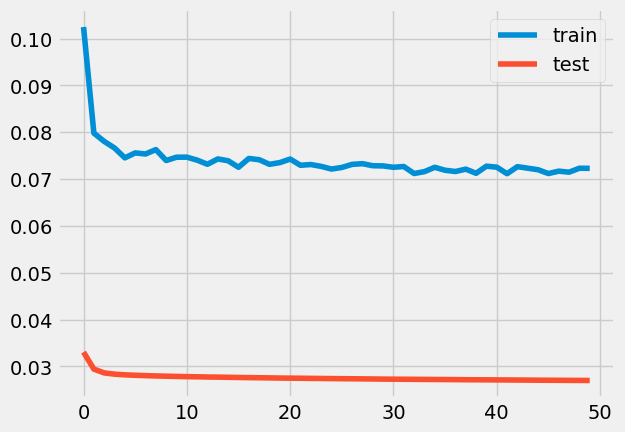

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 3s 82ms/step - loss: 0.3139 - accuracy: 0.0000e+00 - val_loss: 0.2198 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 53ms/step - loss: 0.2375 - accuracy: 0.0000e+00 - val_loss: 0.1843 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [

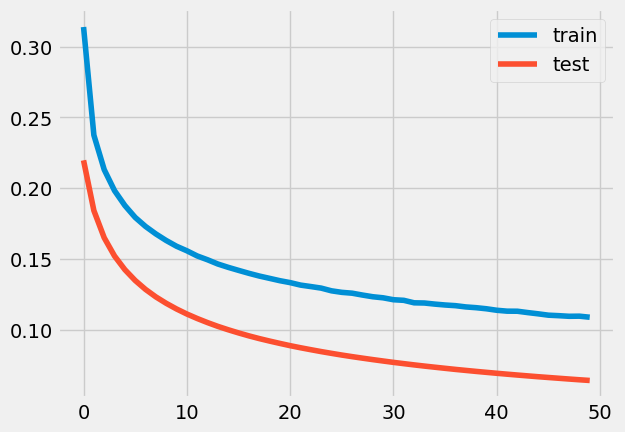

9.860352729413445e-84
9.765625e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 4s 83ms/step - loss: 0.1196 - accuracy: 2.9274e-04 - val_loss: 0.0411 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 58ms/step - loss: 0.0859 - accuracy: 0.0019 - val_loss: 0.0323 - val_accuracy

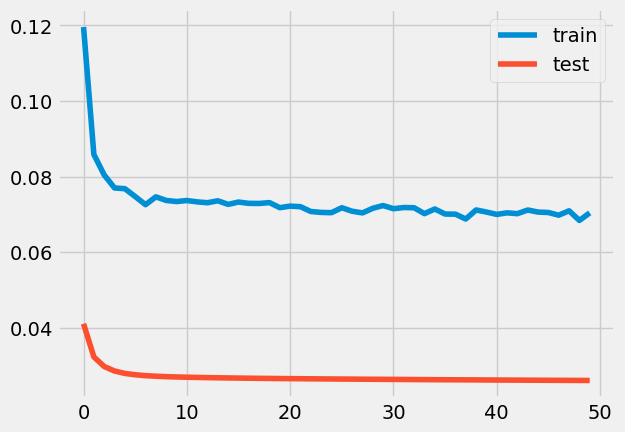

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 4s 84ms/step - loss: 0.1871 - accuracy: 0.0000e+00 - val_loss: 0.1040 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 66ms/step - loss: 0.1388 - accuracy: 0.0000e+00 - val_loss: 0.0832 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [

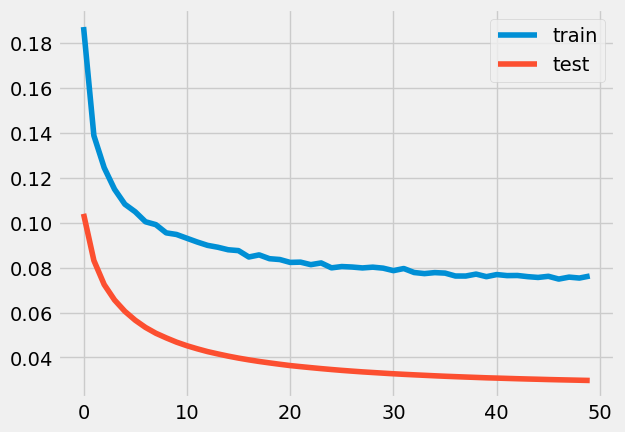

5.200888068443848e-17
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 4s 90ms/step - loss: 0.2276 - accuracy: 0.0000e+00 - val_loss: 0.1483 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 63ms/step - loss: 0.1769 - accuracy: 0.0000e+00 - val_loss: 0.1248 - val_accuracy: 0.0000e

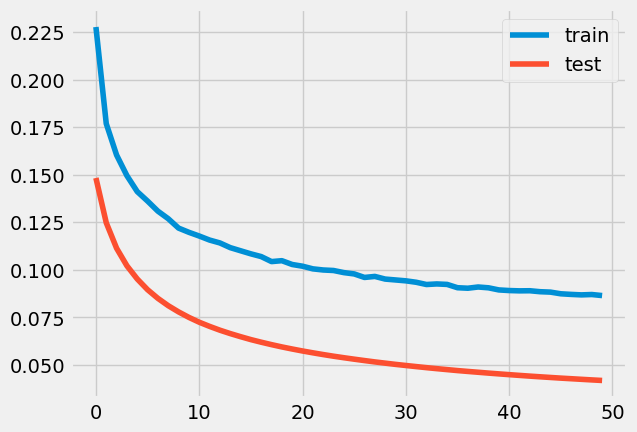

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 83ms/step - loss: 0.2244 - accuracy: 0.0000e+00 - val_loss: 0.1172 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.1438 - accuracy: 0.0000e+00 - val_loss: 0.0875 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

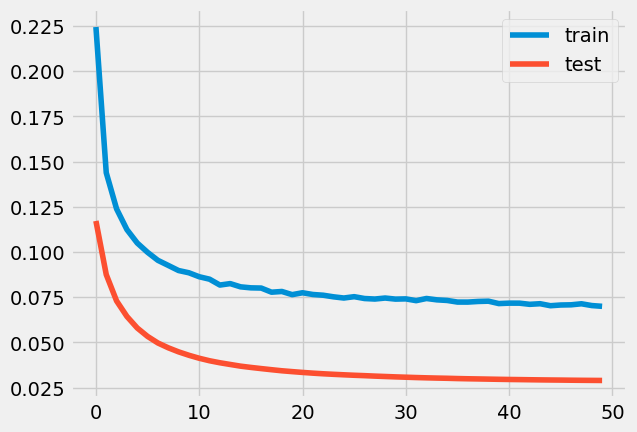

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.4508 - accuracy: 0.0000e+00 - val_loss: 0.3236 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.3217 - accuracy: 0.0000e+00 - val_loss: 0.2669 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

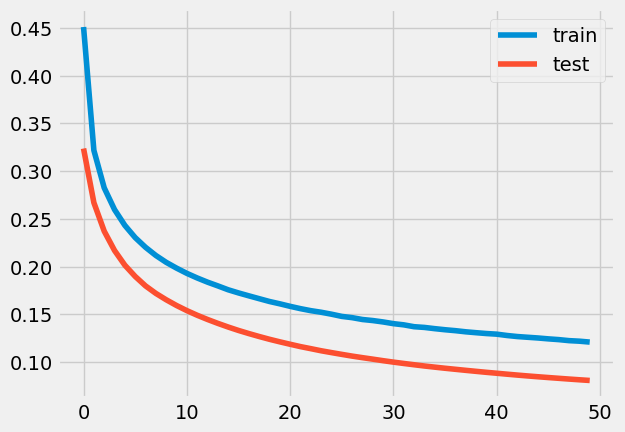

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 3s 77ms/step - loss: 0.1936 - accuracy: 0.0000e+00 - val_loss: 0.1059 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 54ms/step - loss: 0.1384 - accuracy: 0.0000e+00 - val_loss: 0.0837 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [

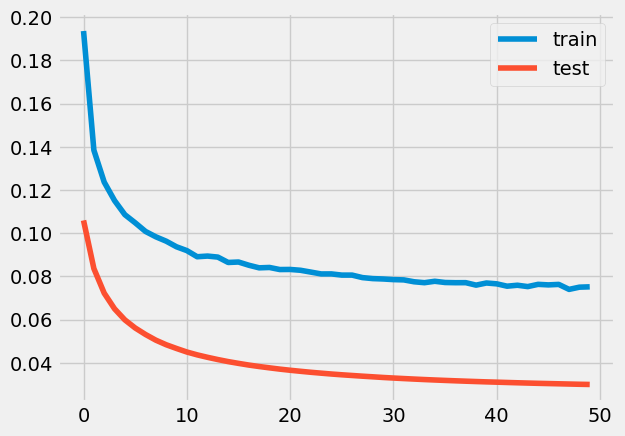

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 3s 77ms/step - loss: 0.1597 - accuracy: 0.0000e+00 - val_loss: 0.0688 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 54ms/step - loss: 0.1047 - accuracy: 3.7596e-04 - val_loss: 0.0498 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [

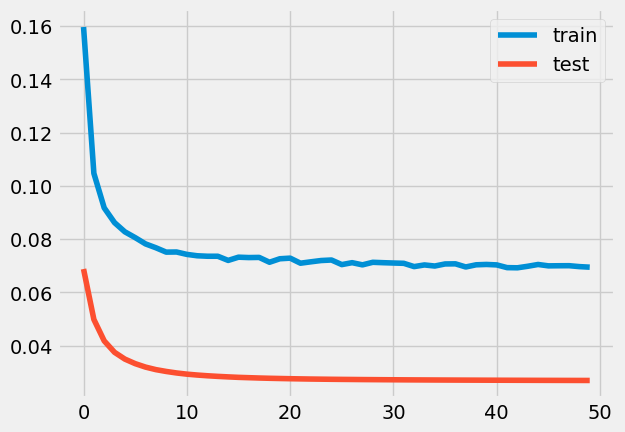

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 66ms/step - loss: 0.1080 - accuracy: 6.1997e-04 - val_loss: 0.0360 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 51ms/step - loss: 0.0814 - accuracy: 0.0027 - val_loss: 0.0305 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [====

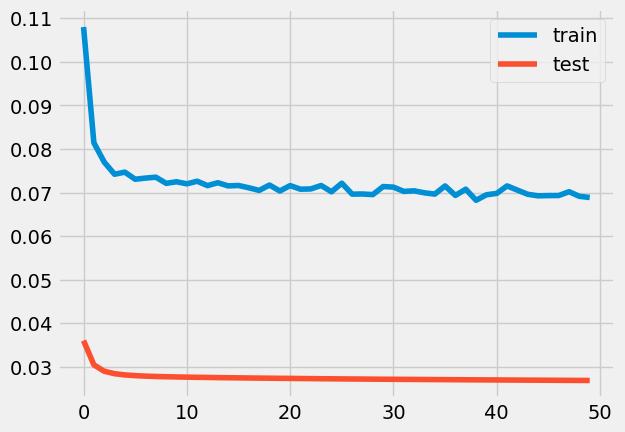

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 68ms/step - loss: 0.2231 - accuracy: 0.0000e+00 - val_loss: 0.1351 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 55ms/step - loss: 0.1625 - accuracy: 0.0000e+00 - val_loss: 0.1086 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

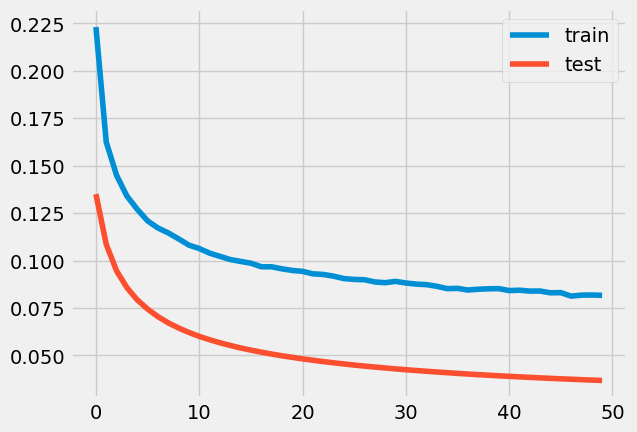

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 71ms/step - loss: 0.1707 - accuracy: 0.0000e+00 - val_loss: 0.0864 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 50ms/step - loss: 0.1233 - accuracy: 0.0000e+00 - val_loss: 0.0679 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

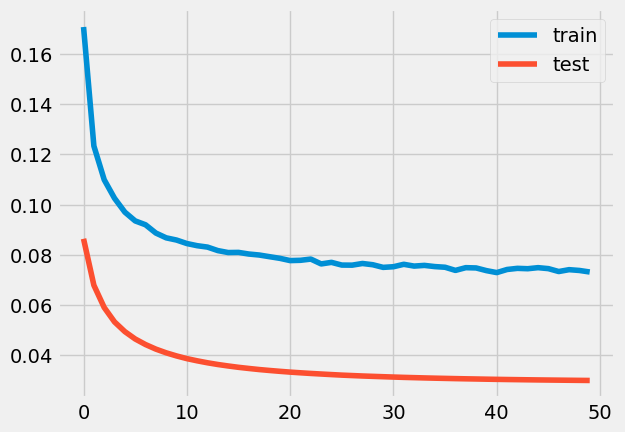

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 73ms/step - loss: 0.2663 - accuracy: 0.0000e+00 - val_loss: 0.1649 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 53ms/step - loss: 0.1859 - accuracy: 0.0000e+00 - val_loss: 0.1297 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [


loss: 3.58%



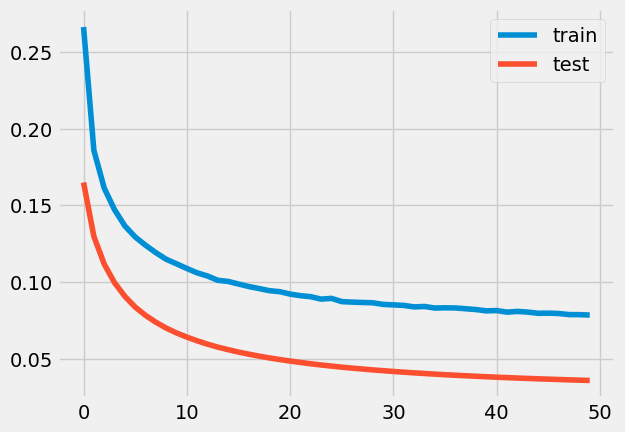

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 62ms/step - loss: 0.0879 - accuracy: 0.0025 - val_loss: 0.0302 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 43ms/step - loss: 0.0772 - accuracy: 0.0064 - val_loss: 0.0298 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [========

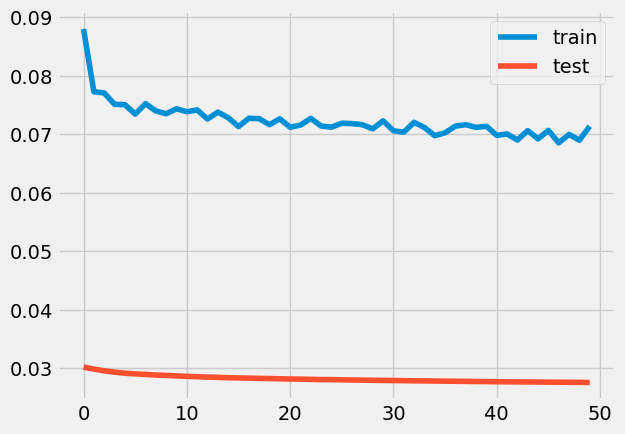

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 62ms/step - loss: 0.2390 - accuracy: 0.0000e+00 - val_loss: 0.1414 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 45ms/step - loss: 0.1663 - accuracy: 0.0000e+00 - val_loss: 0.1112 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

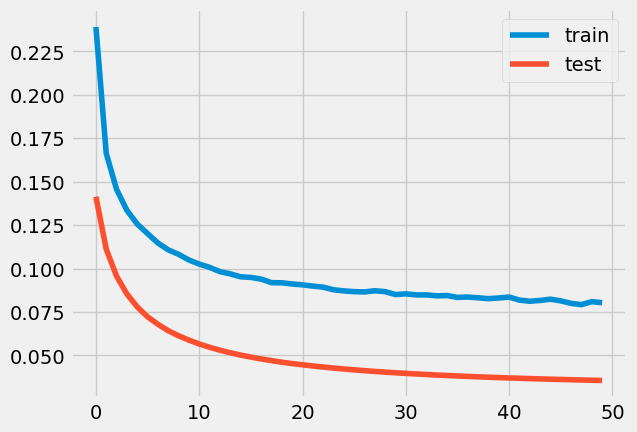

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 68ms/step - loss: 0.0968 - accuracy: 0.0013 - val_loss: 0.0312 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 54ms/step - loss: 0.0772 - accuracy: 0.0045 - val_loss: 0.0279 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [========

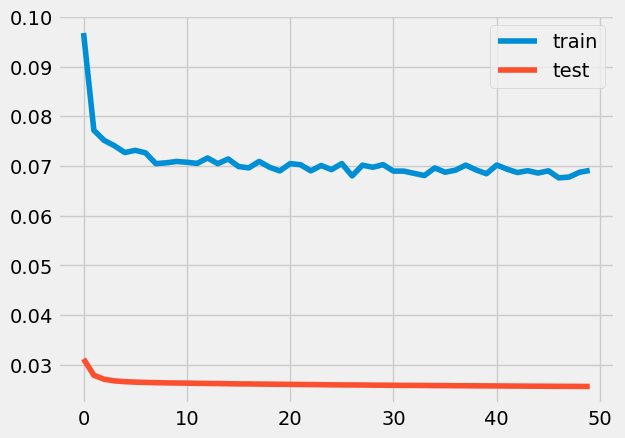

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 76ms/step - loss: 0.1618 - accuracy: 0.0000e+00 - val_loss: 0.0821 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 54ms/step - loss: 0.1192 - accuracy: 0.0000e+00 - val_loss: 0.0641 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

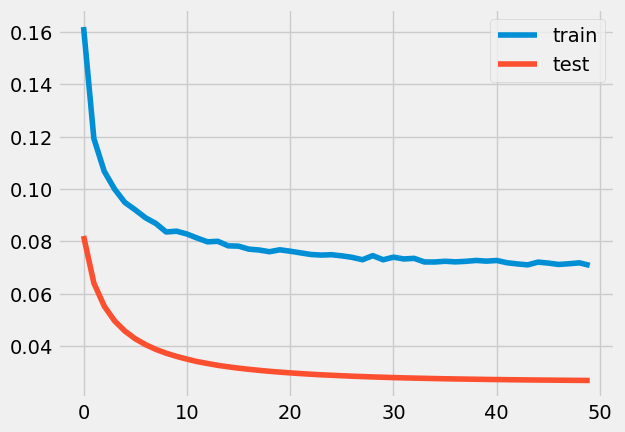

3.6855835171788317e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 82ms/step - loss: 0.2135 - accuracy: 0.0000e+00 - val_loss: 0.1183 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 59ms/step - loss: 0.1470 - accuracy: 0.0000e+00 - val_loss: 0.0910 - val_accuracy: 0.0000

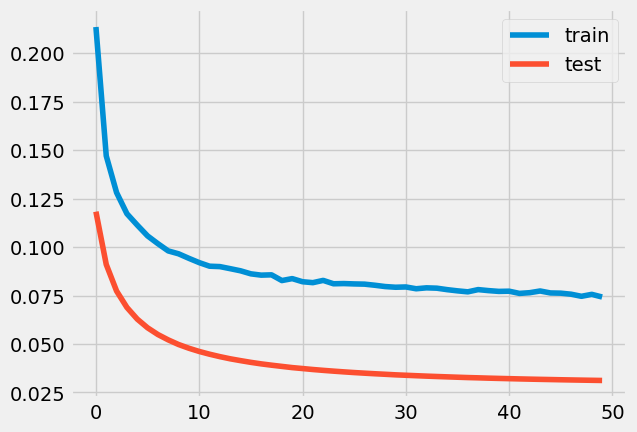

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 4s 87ms/step - loss: 0.1249 - accuracy: 3.9578e-04 - val_loss: 0.0453 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 53ms/step - loss: 0.0895 - accuracy: 0.0024 - val_loss: 0.0352 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [====

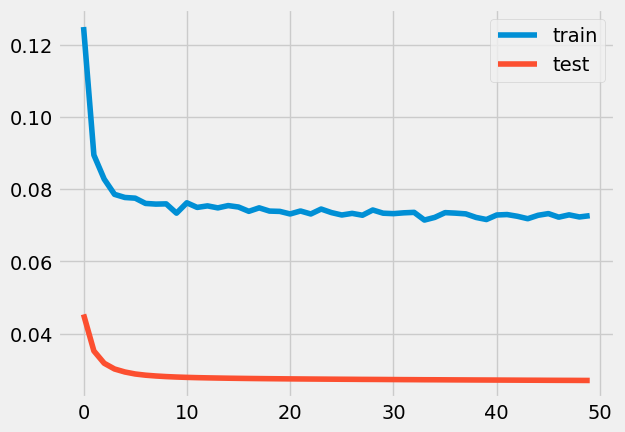

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 4s 74ms/step - loss: 0.3614 - accuracy: 0.0000e+00 - val_loss: 0.2534 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 55ms/step - loss: 0.2621 - accuracy: 0.0000e+00 - val_loss: 0.2087 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

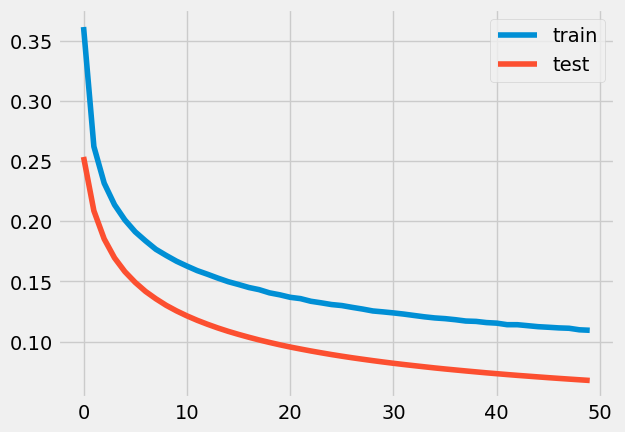

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 77ms/step - loss: 0.0923 - accuracy: 0.0013 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 53ms/step - loss: 0.0749 - accuracy: 0.0053 - val_loss: 0.0280 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [========

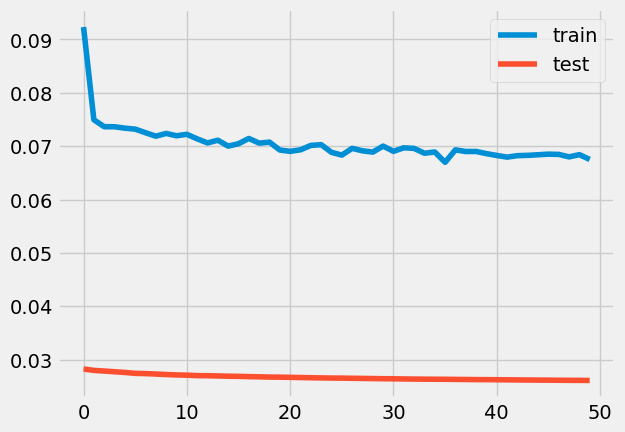

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 75ms/step - loss: 0.2479 - accuracy: 0.0000e+00 - val_loss: 0.1483 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 55ms/step - loss: 0.1711 - accuracy: 0.0000e+00 - val_loss: 0.1141 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

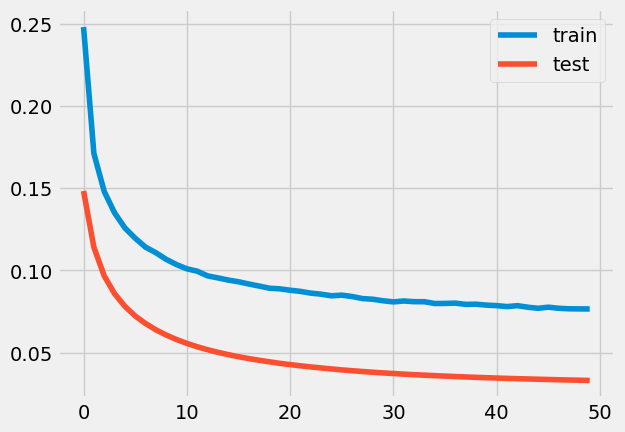

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 70ms/step - loss: 0.2441 - accuracy: 0.0000e+00 - val_loss: 0.1424 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 48ms/step - loss: 0.1651 - accuracy: 0.0000e+00 - val_loss: 0.1100 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [


loss: 3.23%



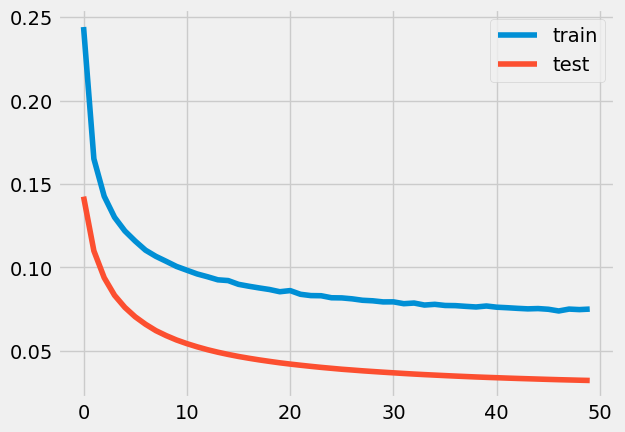

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 72ms/step - loss: 0.1760 - accuracy: 0.0000e+00 - val_loss: 0.0943 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 2s 58ms/step - loss: 0.1286 - accuracy: 0.0000e+00 - val_loss: 0.0741 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

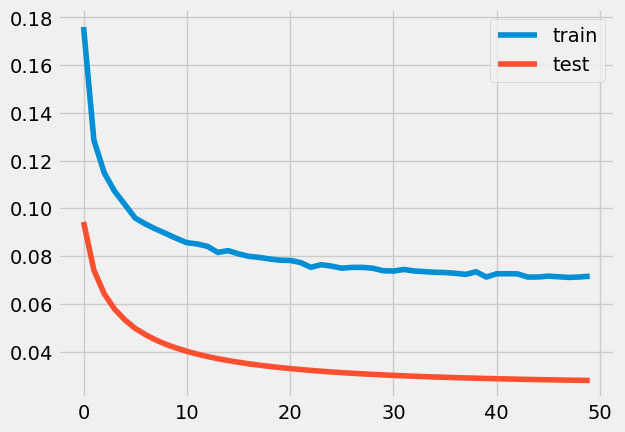

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 4s 63ms/step - loss: 0.2130 - accuracy: 0.0000e+00 - val_loss: 0.1095 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 1s 47ms/step - loss: 0.1356 - accuracy: 0.0000e+00 - val_loss: 0.0781 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

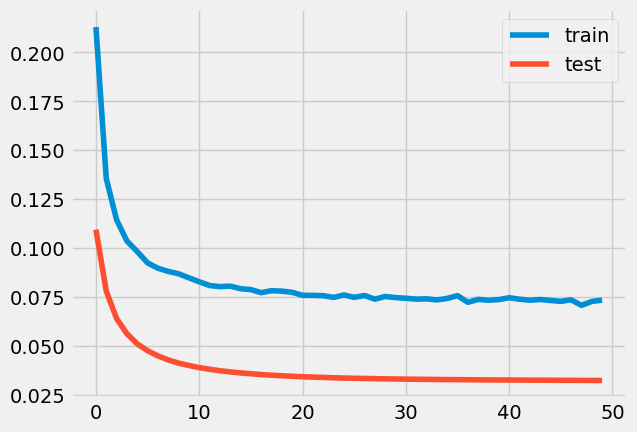

9.71970649582088e-21
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 63ms/step - loss: 0.2489 - accuracy: 0.0000e+00 - val_loss: 0.1594 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 45ms/step - loss: 0.1853 - accuracy: 0.0000e+00 - val_loss: 0.1322 - val_accuracy: 0.0000e+

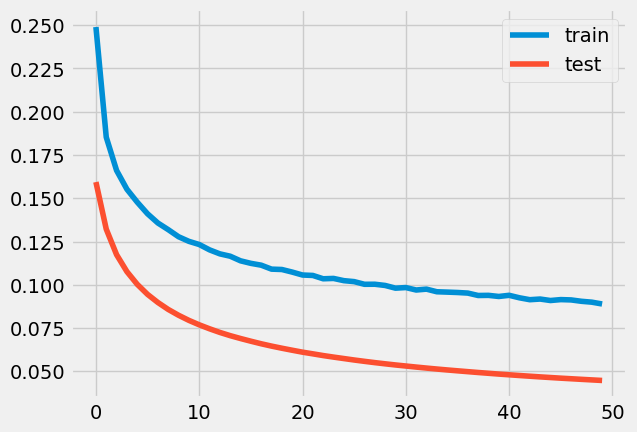

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 65ms/step - loss: 0.1743 - accuracy: 0.0000e+00 - val_loss: 0.0826 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 46ms/step - loss: 0.1153 - accuracy: 0.0000e+00 - val_loss: 0.0607 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

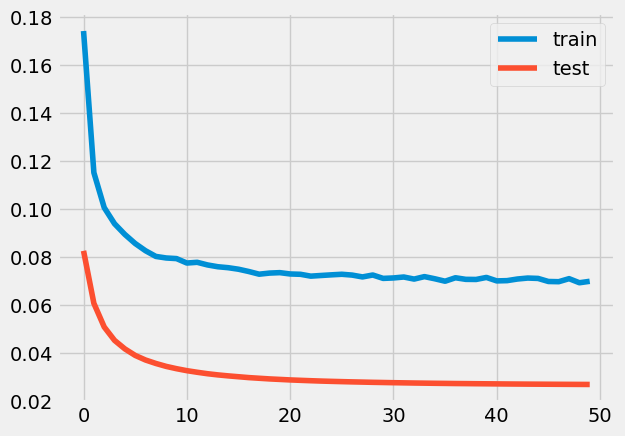

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 67ms/step - loss: 0.1982 - accuracy: 0.0000e+00 - val_loss: 0.0983 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 46ms/step - loss: 0.1281 - accuracy: 0.0000e+00 - val_loss: 0.0725 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

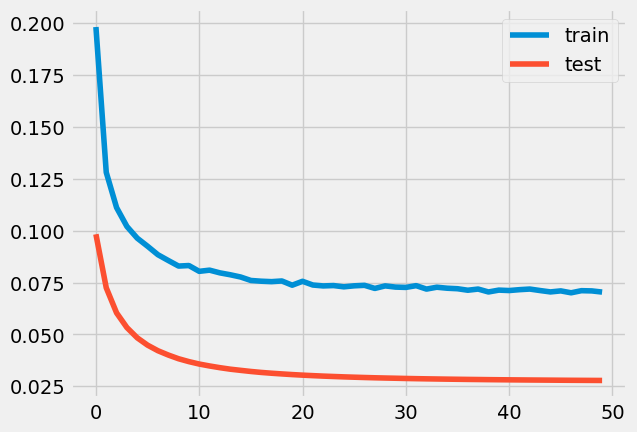

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 62ms/step - loss: 0.1756 - accuracy: 0.0000e+00 - val_loss: 0.0845 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 50ms/step - loss: 0.1190 - accuracy: 0.0000e+00 - val_loss: 0.0635 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

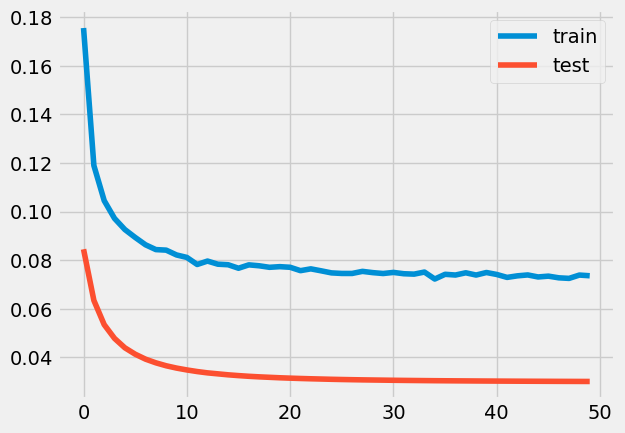

8.075408399253842e-11
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 62ms/step - loss: 0.2629 - accuracy: 0.0000e+00 - val_loss: 0.1687 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 45ms/step - loss: 0.1916 - accuracy: 0.0000e+00 - val_loss: 0.1376 - val_accuracy: 0.0000e

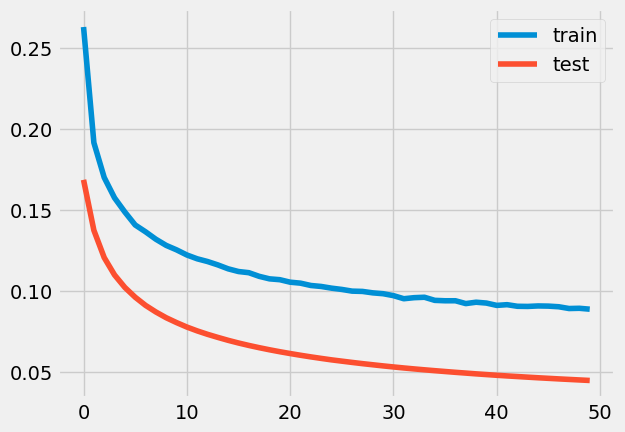

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 64ms/step - loss: 0.2054 - accuracy: 0.0000e+00 - val_loss: 0.1164 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 48ms/step - loss: 0.1480 - accuracy: 0.0000e+00 - val_loss: 0.0935 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

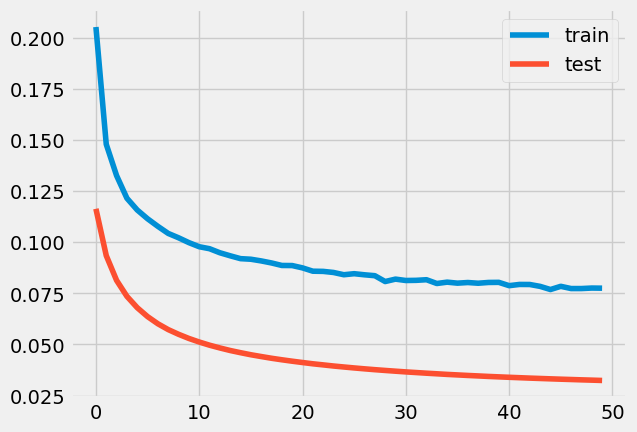

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 64ms/step - loss: 0.1393 - accuracy: 7.7496e-05 - val_loss: 0.0563 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 2s 53ms/step - loss: 0.0956 - accuracy: 1.6990e-04 - val_loss: 0.0424 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

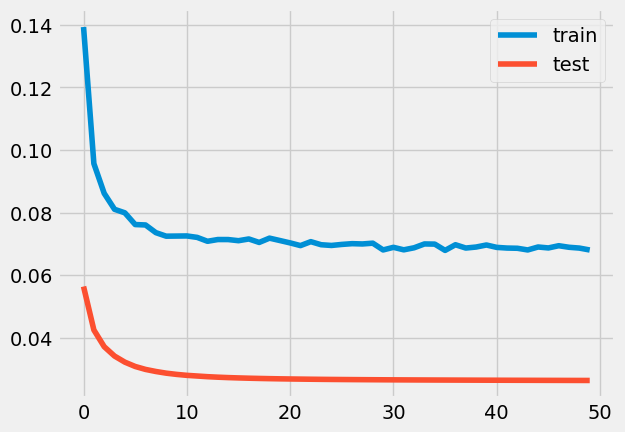

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 63ms/step - loss: 0.1582 - accuracy: 0.0000e+00 - val_loss: 0.0700 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 51ms/step - loss: 0.1062 - accuracy: 3.1297e-04 - val_loss: 0.0524 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

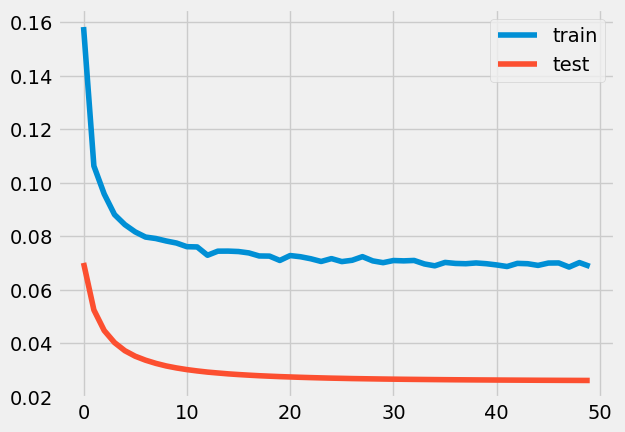

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 68ms/step - loss: 0.1073 - accuracy: 6.7339e-04 - val_loss: 0.0374 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 50ms/step - loss: 0.0849 - accuracy: 0.0054 - val_loss: 0.0334 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [====

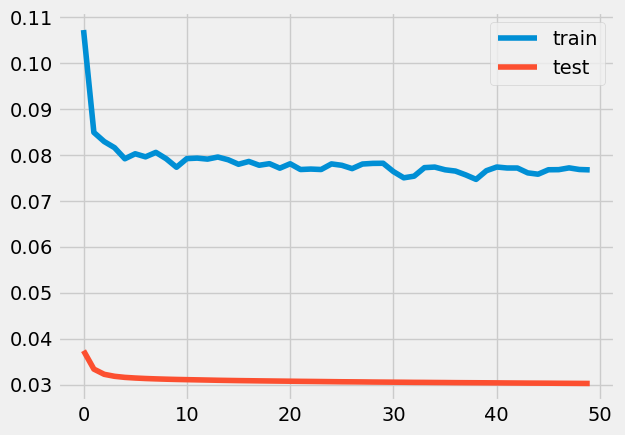

2.5672975197749216e-19
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 64ms/step - loss: 0.4316 - accuracy: 0.0000e+00 - val_loss: 0.3164 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 49ms/step - loss: 0.3122 - accuracy: 0.0000e+00 - val_loss: 0.2611 - val_accuracy: 0.0000

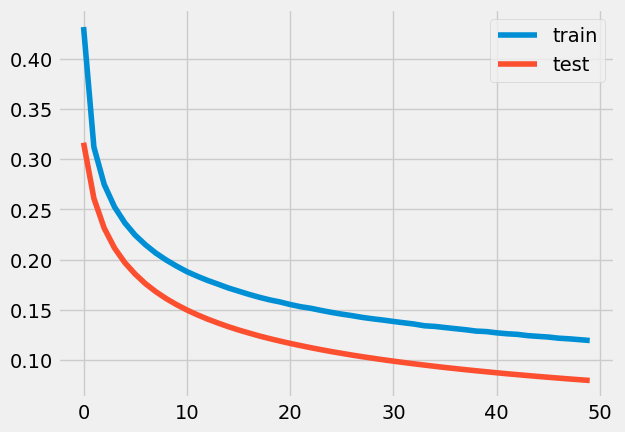

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 66ms/step - loss: 0.2589 - accuracy: 0.0000e+00 - val_loss: 0.1537 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 50ms/step - loss: 0.1762 - accuracy: 0.0000e+00 - val_loss: 0.1206 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [


loss: 3.43%



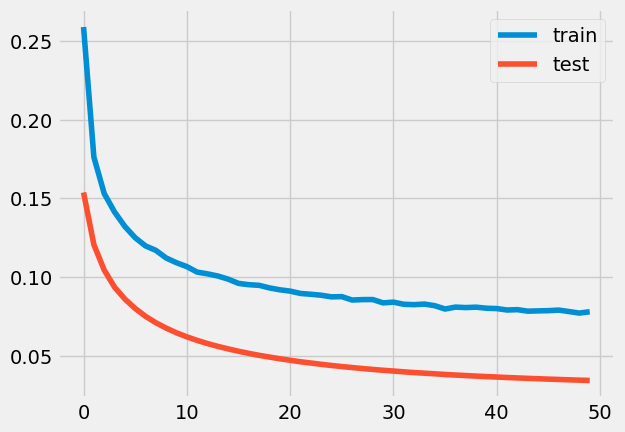

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 4s 68ms/step - loss: 0.1415 - accuracy: 0.0000e+00 - val_loss: 0.0625 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 51ms/step - loss: 0.1030 - accuracy: 5.0969e-04 - val_loss: 0.0492 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

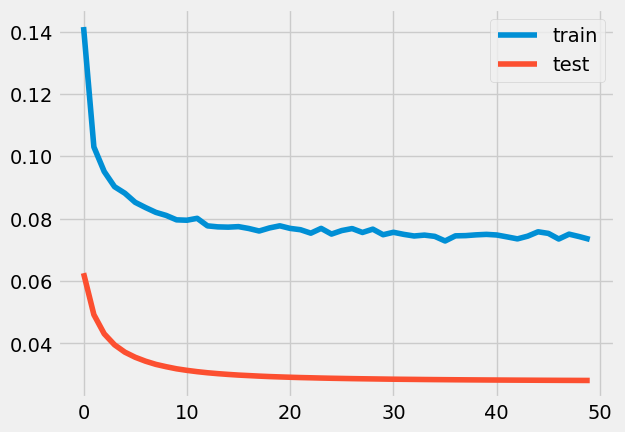

4.8828125e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 67ms/step - loss: 0.1469 - accuracy: 0.0000e+00 - val_loss: 0.0684 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 48ms/step - loss: 0.1059 - accuracy: 1.3711e-04 - val_loss: 0.0526 - val_accuracy: 0.0000e+00
Epoc

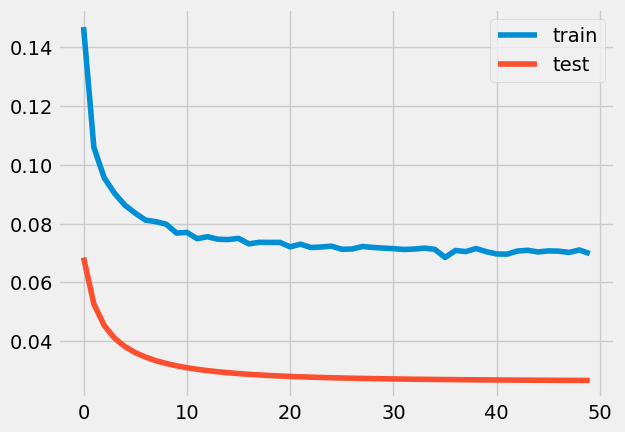

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 74ms/step - loss: 0.1788 - accuracy: 0.0000e+00 - val_loss: 0.0834 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 52ms/step - loss: 0.1162 - accuracy: 0.0000e+00 - val_loss: 0.0608 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

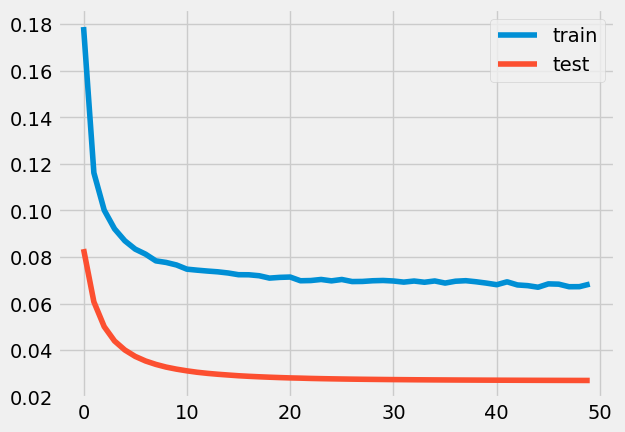

0.0009544782487901666
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 68ms/step - loss: 0.3635 - accuracy: 0.0000e+00 - val_loss: 0.2676 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 50ms/step - loss: 0.2759 - accuracy: 0.0000e+00 - val_loss: 0.2260 - val_accuracy: 0.0000e

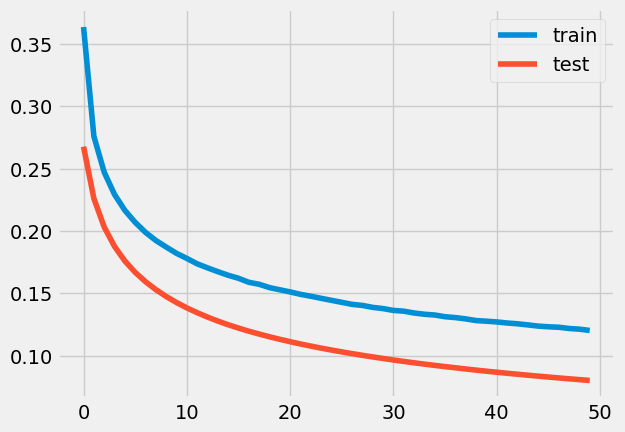

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 4s 64ms/step - loss: 0.1920 - accuracy: 0.0000e+00 - val_loss: 0.1031 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 48ms/step - loss: 0.1352 - accuracy: 0.0000e+00 - val_loss: 0.0797 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

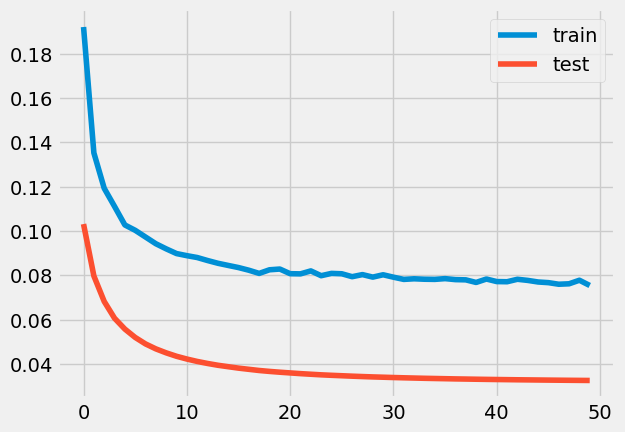

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 4s 65ms/step - loss: 0.1690 - accuracy: 0.0000e+00 - val_loss: 0.0835 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 2s 48ms/step - loss: 0.1176 - accuracy: 0.0000e+00 - val_loss: 0.0639 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

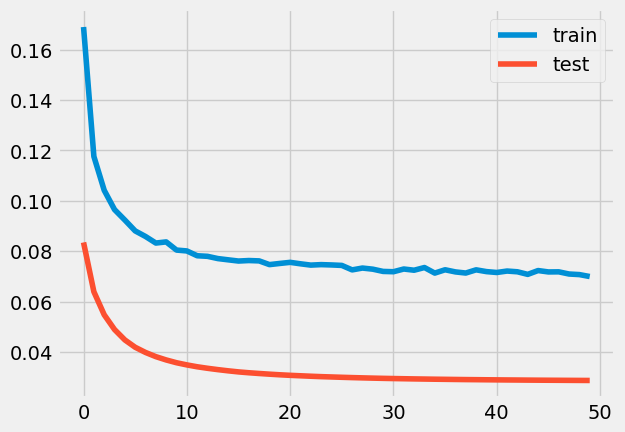

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 69ms/step - loss: 0.0879 - accuracy: 0.0041 - val_loss: 0.0284 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 50ms/step - loss: 0.0751 - accuracy: 0.0059 - val_loss: 0.0282 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [========

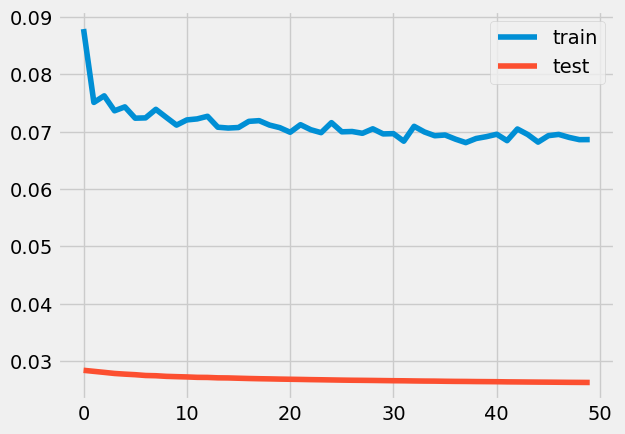

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 66ms/step - loss: 0.2197 - accuracy: 0.0000e+00 - val_loss: 0.1256 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 48ms/step - loss: 0.1529 - accuracy: 0.0000e+00 - val_loss: 0.0972 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

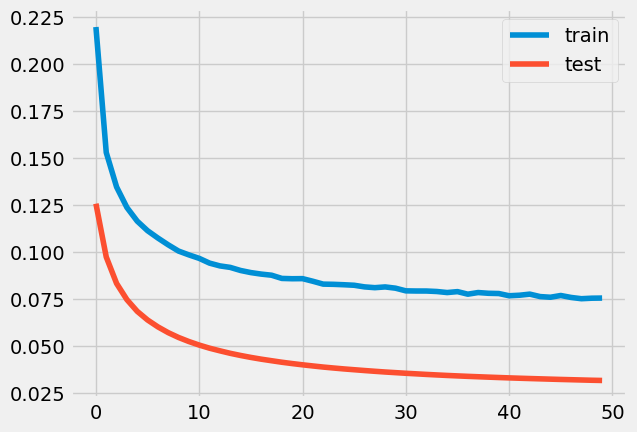

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 67ms/step - loss: 0.2745 - accuracy: 0.0000e+00 - val_loss: 0.1802 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 50ms/step - loss: 0.2015 - accuracy: 0.0000e+00 - val_loss: 0.1467 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

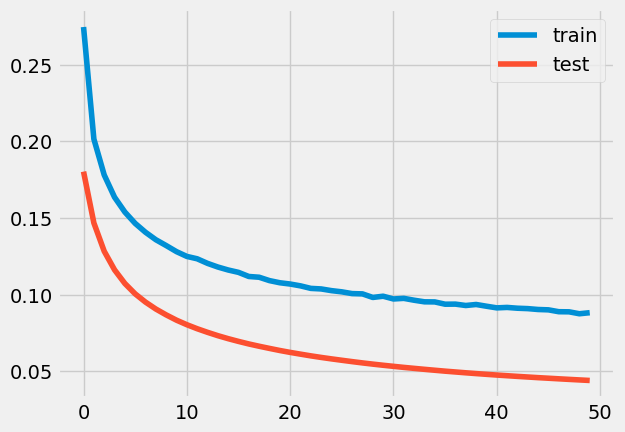

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 75ms/step - loss: 0.1947 - accuracy: 0.0000e+00 - val_loss: 0.1061 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1399 - accuracy: 0.0000e+00 - val_loss: 0.0826 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

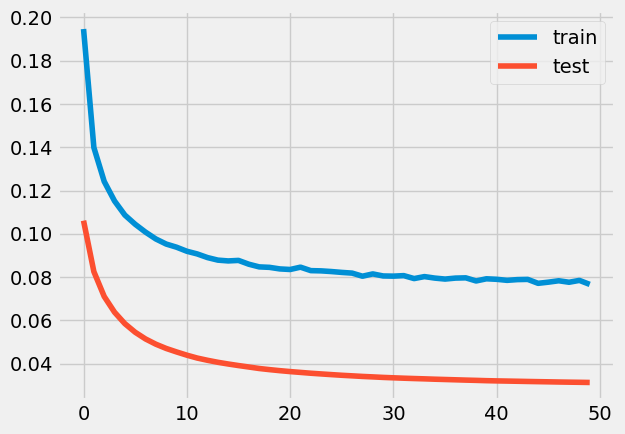

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 79ms/step - loss: 0.4362 - accuracy: 0.0000e+00 - val_loss: 0.3311 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 60ms/step - loss: 0.3337 - accuracy: 0.0000e+00 - val_loss: 0.2859 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

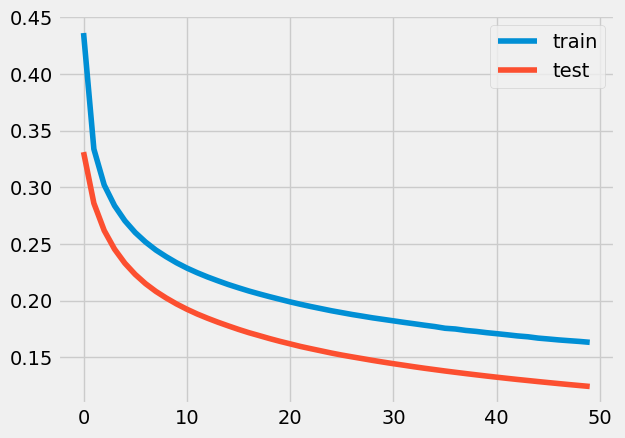

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 3s 83ms/step - loss: 0.1097 - accuracy: 5.2114e-04 - val_loss: 0.0342 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 54ms/step - loss: 0.0816 - accuracy: 0.0036 - val_loss: 0.0301 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [====

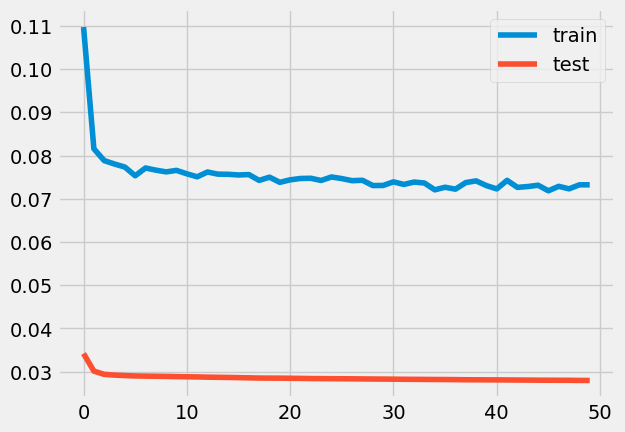

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 3s 88ms/step - loss: 0.2090 - accuracy: 0.0000e+00 - val_loss: 0.1228 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 59ms/step - loss: 0.1559 - accuracy: 0.0000e+00 - val_loss: 0.0993 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [


loss: 3.54%



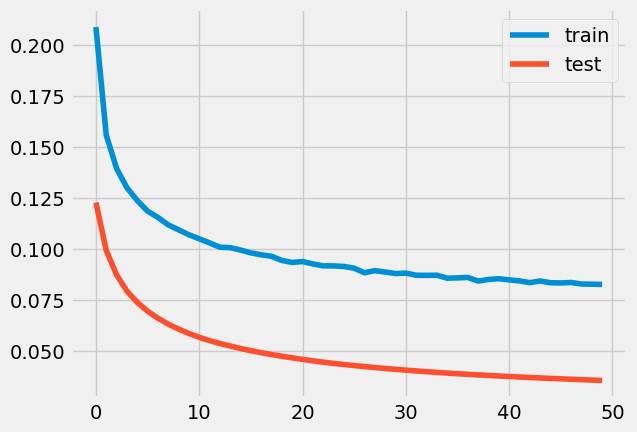

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 72ms/step - loss: 0.2071 - accuracy: 0.0000e+00 - val_loss: 0.1197 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 53ms/step - loss: 0.1514 - accuracy: 0.0000e+00 - val_loss: 0.0951 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

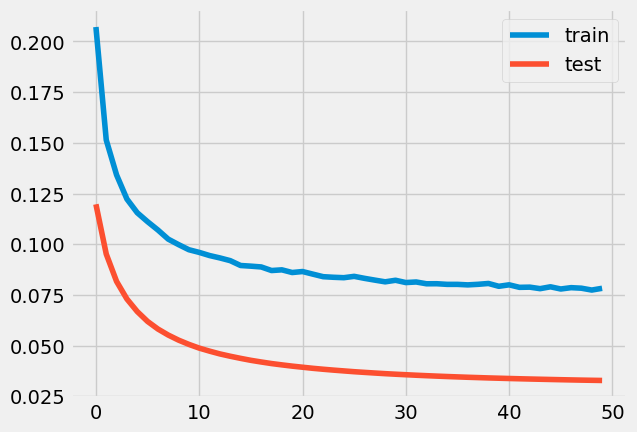

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 72ms/step - loss: 0.2248 - accuracy: 0.0000e+00 - val_loss: 0.1331 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 50ms/step - loss: 0.1607 - accuracy: 0.0000e+00 - val_loss: 0.1055 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [


loss: 3.15%



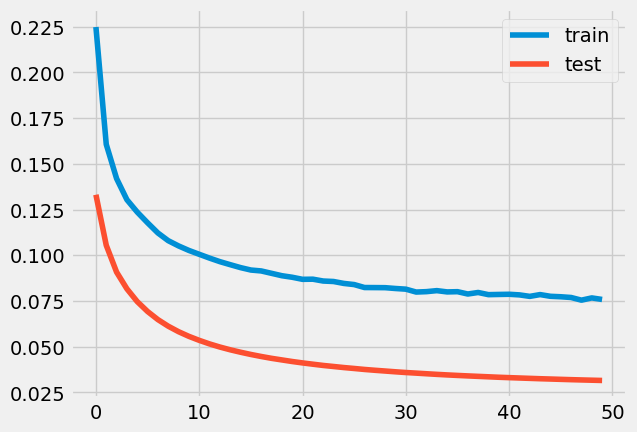

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 72ms/step - loss: 0.3427 - accuracy: 0.0000e+00 - val_loss: 0.2347 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 50ms/step - loss: 0.2443 - accuracy: 0.0000e+00 - val_loss: 0.1896 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

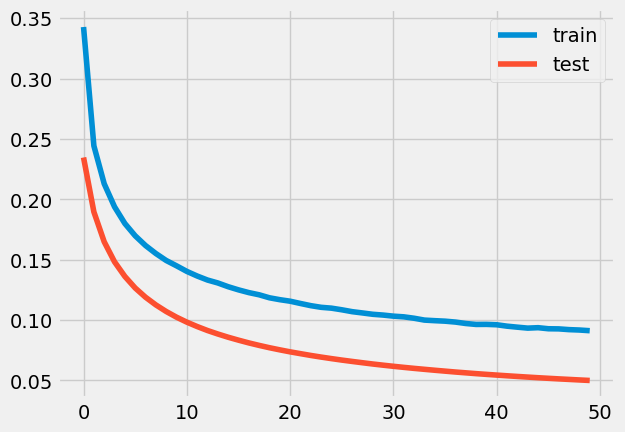

5.550871235450305e-165
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 69ms/step - loss: 0.1197 - accuracy: 4.7775e-04 - val_loss: 0.0435 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 48ms/step - loss: 0.0873 - accuracy: 0.0030 - val_loss: 0.0347 - val_accuracy: 0.0000e+00

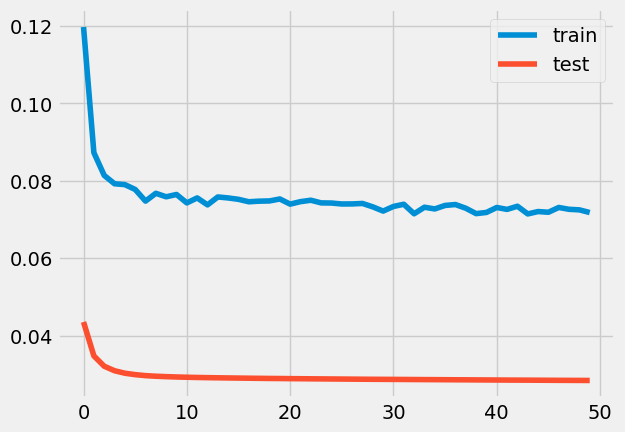

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.2051 - accuracy: 0.0000e+00 - val_loss: 0.1148 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1489 - accuracy: 0.0000e+00 - val_loss: 0.0922 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

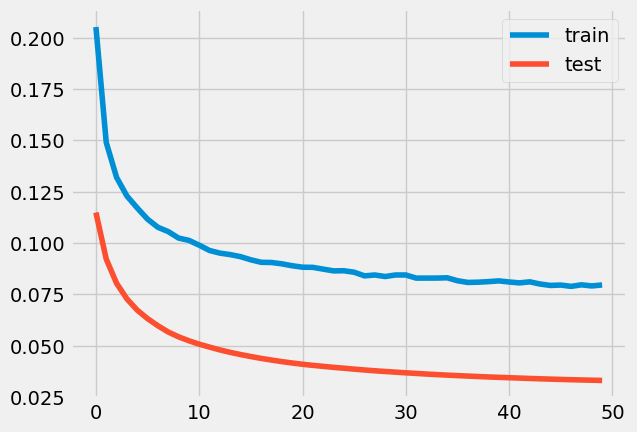

1.803145180984544e-42
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 75ms/step - loss: 0.1948 - accuracy: 0.0000e+00 - val_loss: 0.0998 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 52ms/step - loss: 0.1317 - accuracy: 0.0000e+00 - val_loss: 0.0760 - val_accuracy: 0.0000e

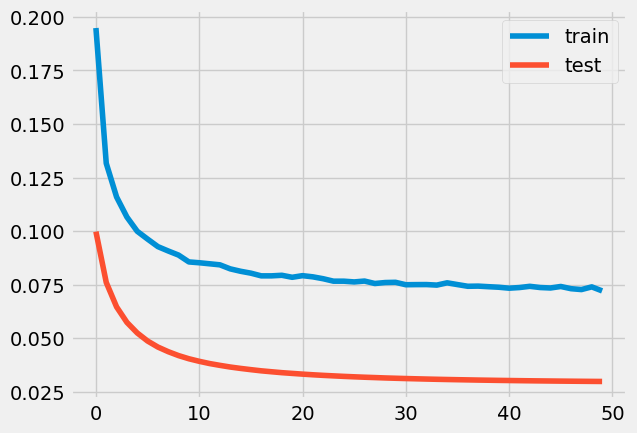

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 73ms/step - loss: 0.2110 - accuracy: 0.0000e+00 - val_loss: 0.1232 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 54ms/step - loss: 0.1532 - accuracy: 0.0000e+00 - val_loss: 0.0980 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [


loss: 3.19%



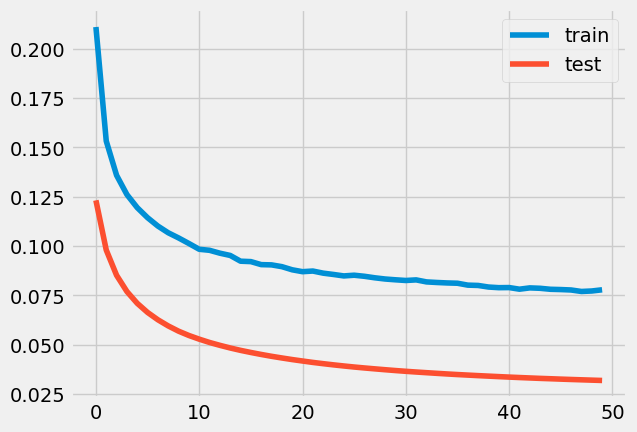

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 70ms/step - loss: 0.2934 - accuracy: 0.0000e+00 - val_loss: 0.1898 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 50ms/step - loss: 0.2068 - accuracy: 0.0000e+00 - val_loss: 0.1509 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

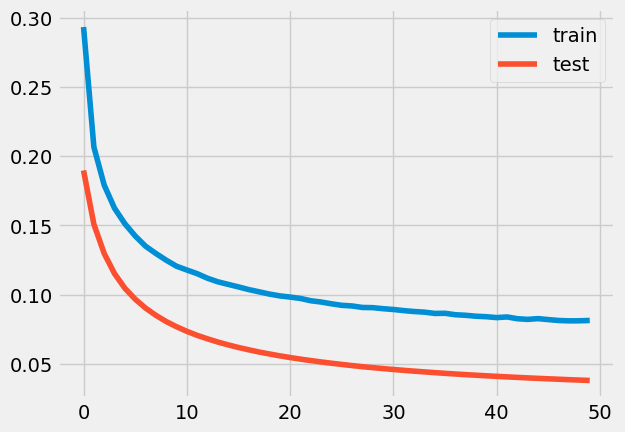

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 4s 68ms/step - loss: 0.1504 - accuracy: 0.0000e+00 - val_loss: 0.0622 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 50ms/step - loss: 0.0992 - accuracy: 1.7213e-04 - val_loss: 0.0463 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

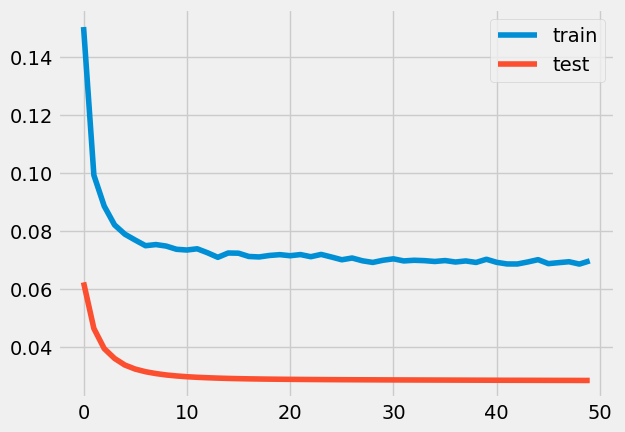

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 65ms/step - loss: 0.1579 - accuracy: 0.0000e+00 - val_loss: 0.0741 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 47ms/step - loss: 0.1110 - accuracy: 1.4536e-04 - val_loss: 0.0563 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

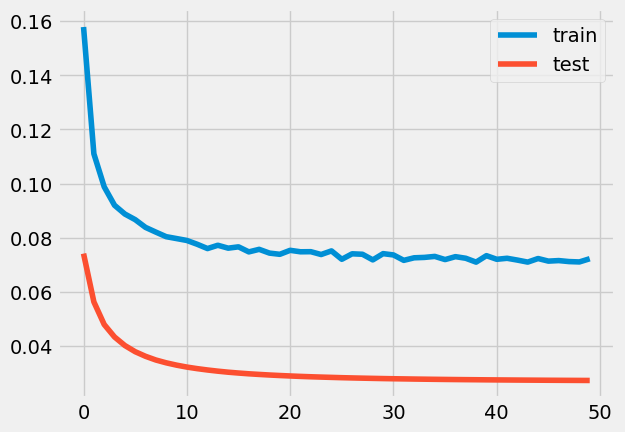

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 66ms/step - loss: 0.1891 - accuracy: 0.0000e+00 - val_loss: 0.1004 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 50ms/step - loss: 0.1321 - accuracy: 0.0000e+00 - val_loss: 0.0768 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

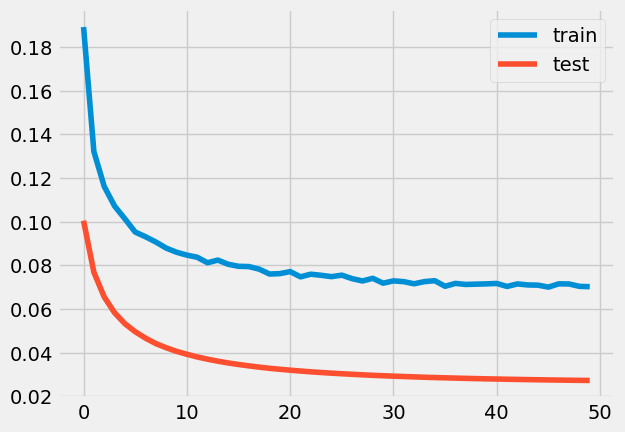

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 63ms/step - loss: 0.2266 - accuracy: 0.0000e+00 - val_loss: 0.1209 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 46ms/step - loss: 0.1477 - accuracy: 0.0000e+00 - val_loss: 0.0889 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

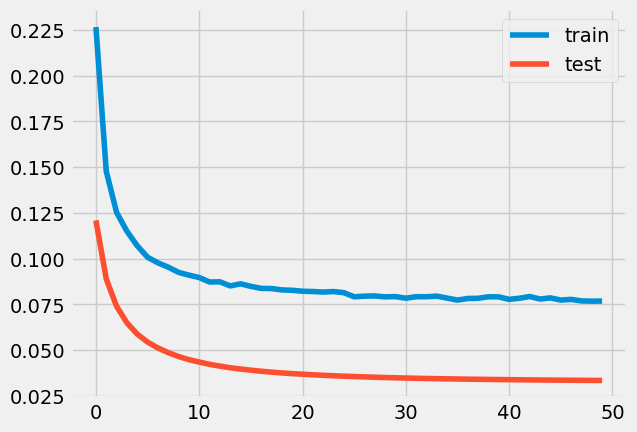

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 72ms/step - loss: 0.0885 - accuracy: 0.0037 - val_loss: 0.0294 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 49ms/step - loss: 0.0771 - accuracy: 0.0050 - val_loss: 0.0292 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [========

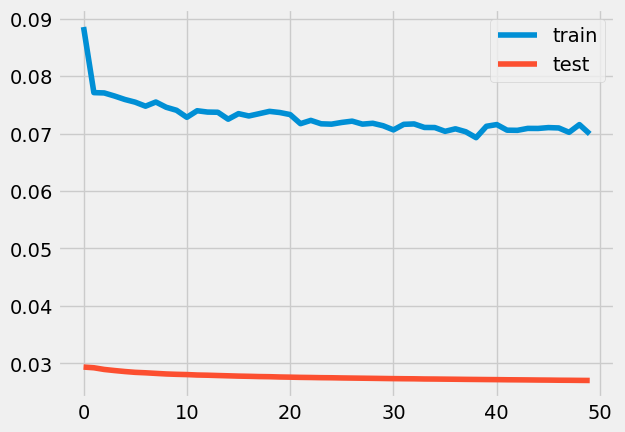

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 69ms/step - loss: 0.2318 - accuracy: 0.0000e+00 - val_loss: 0.1393 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 50ms/step - loss: 0.1666 - accuracy: 0.0000e+00 - val_loss: 0.1105 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [


loss: 3.28%



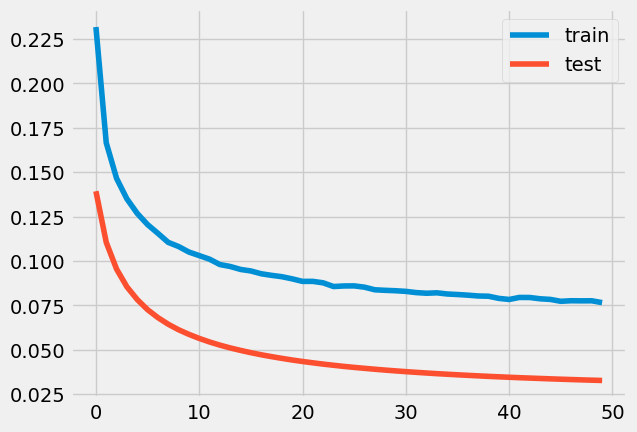

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 65ms/step - loss: 0.2798 - accuracy: 0.0000e+00 - val_loss: 0.1642 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 48ms/step - loss: 0.1796 - accuracy: 0.0000e+00 - val_loss: 0.1196 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

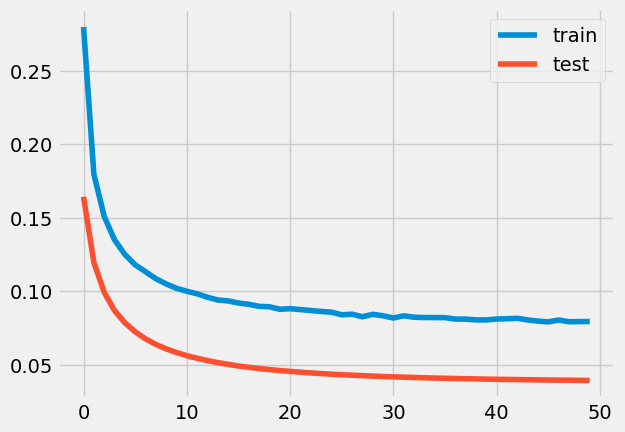

8.268101153455668e-58
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 69ms/step - loss: 0.3182 - accuracy: 0.0000e+00 - val_loss: 0.2249 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 48ms/step - loss: 0.2413 - accuracy: 0.0000e+00 - val_loss: 0.1886 - val_accuracy: 0.0000e

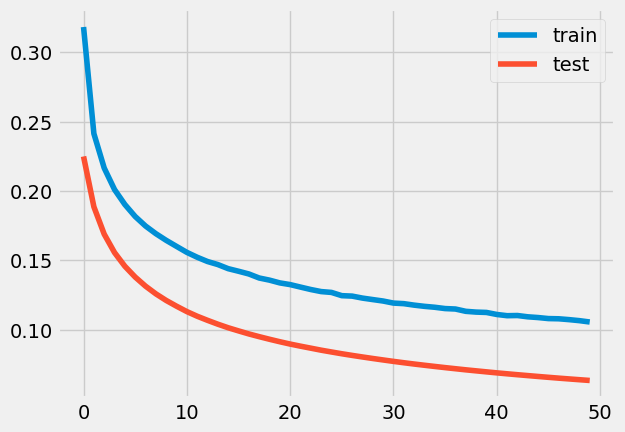

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 61ms/step - loss: 0.1969 - accuracy: 0.0000e+00 - val_loss: 0.1066 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 48ms/step - loss: 0.1375 - accuracy: 0.0000e+00 - val_loss: 0.0813 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

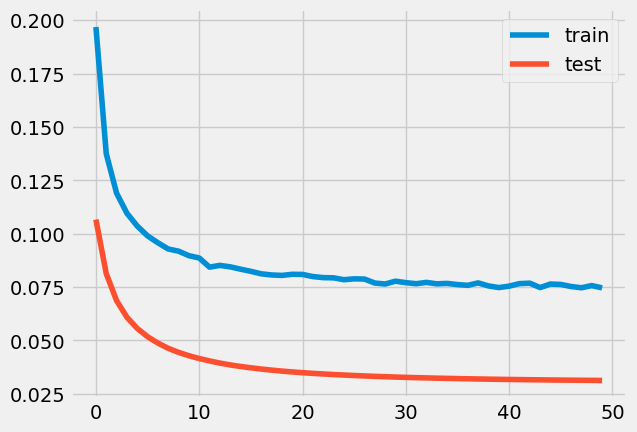

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 62ms/step - loss: 0.1595 - accuracy: 0.0000e+00 - val_loss: 0.0732 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 46ms/step - loss: 0.1082 - accuracy: 4.1729e-05 - val_loss: 0.0542 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

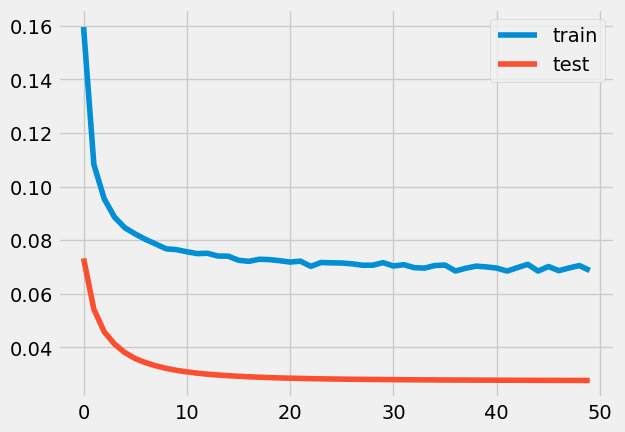

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 70ms/step - loss: 0.1228 - accuracy: 5.6674e-04 - val_loss: 0.0409 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 48ms/step - loss: 0.0840 - accuracy: 0.0020 - val_loss: 0.0327 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [====

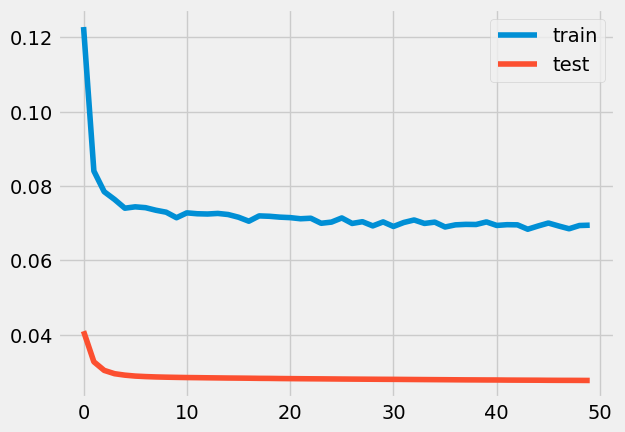

0.883197403829075
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 76ms/step - loss: 0.3193 - accuracy: 0.0000e+00 - val_loss: 0.2114 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 54ms/step - loss: 0.2241 - accuracy: 0.0000e+00 - val_loss: 0.1688 - val_accuracy: 0.0000e+00


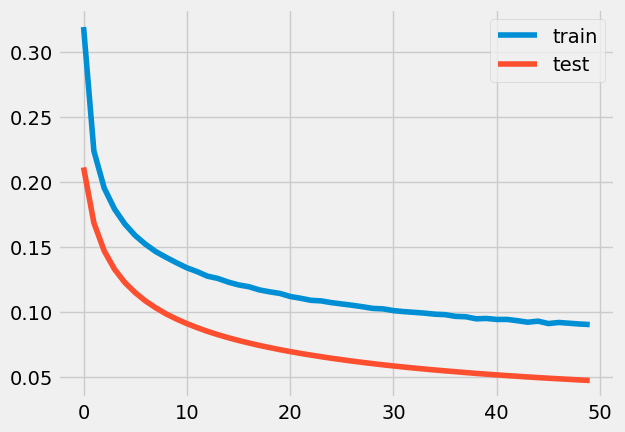

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 3s 65ms/step - loss: 0.4393 - accuracy: 0.0000e+00 - val_loss: 0.3447 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 46ms/step - loss: 0.3452 - accuracy: 0.0000e+00 - val_loss: 0.2978 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

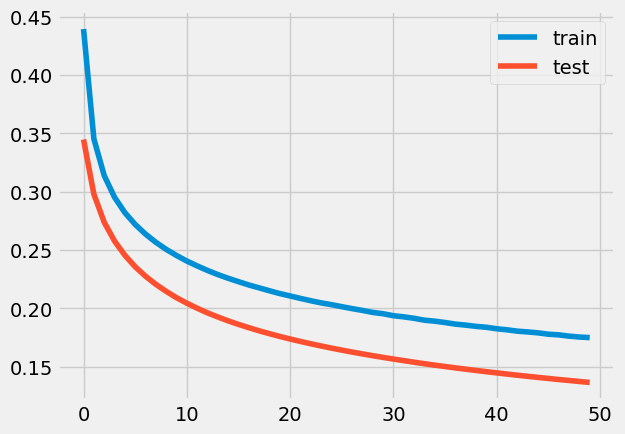

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 3s 80ms/step - loss: 0.1758 - accuracy: 0.0000e+00 - val_loss: 0.0874 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 58ms/step - loss: 0.1228 - accuracy: 0.0000e+00 - val_loss: 0.0675 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 [

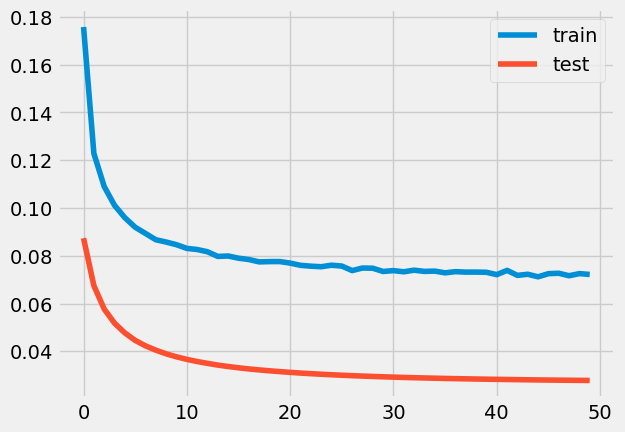

2.44140625e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 3s 80ms/step - loss: 0.1971 - accuracy: 0.0000e+00 - val_loss: 0.0971 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 56ms/step - loss: 0.1280 - accuracy: 0.0000e+00 - val_loss: 0.0695 - val_accuracy: 0.0000e+00
Epo

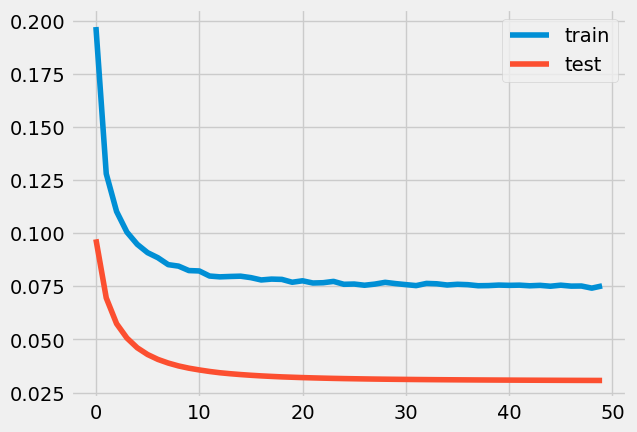

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 3s 72ms/step - loss: 0.1549 - accuracy: 0.0000e+00 - val_loss: 0.0775 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 50ms/step - loss: 0.1156 - accuracy: 6.3388e-05 - val_loss: 0.0616 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [

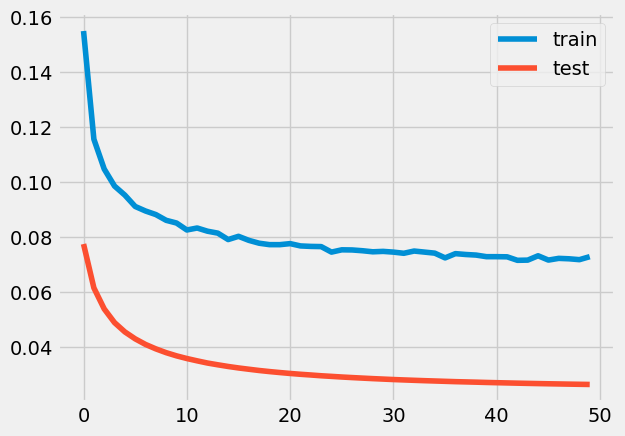

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 3s 70ms/step - loss: 0.3535 - accuracy: 0.0000e+00 - val_loss: 0.2321 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 50ms/step - loss: 0.2379 - accuracy: 0.0000e+00 - val_loss: 0.1802 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [

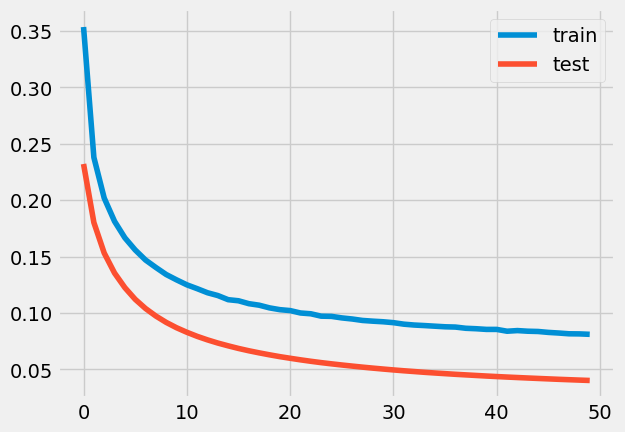

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 3s 83ms/step - loss: 0.1015 - accuracy: 0.0024 - val_loss: 0.0298 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 56ms/step - loss: 0.0787 - accuracy: 0.0044 - val_loss: 0.0294 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [========

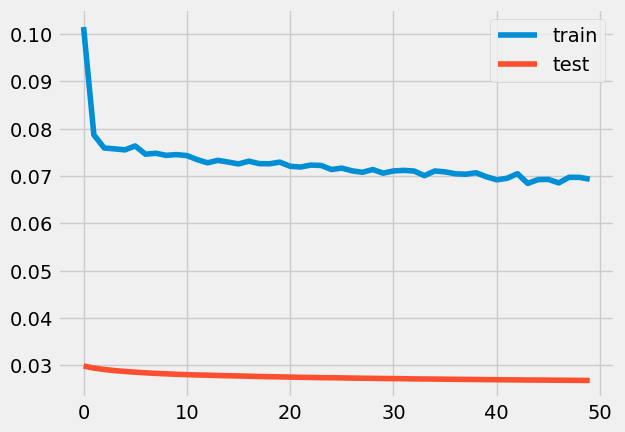

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 3s 81ms/step - loss: 0.1513 - accuracy: 0.0000e+00 - val_loss: 0.0714 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 55ms/step - loss: 0.1111 - accuracy: 1.4390e-04 - val_loss: 0.0561 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [

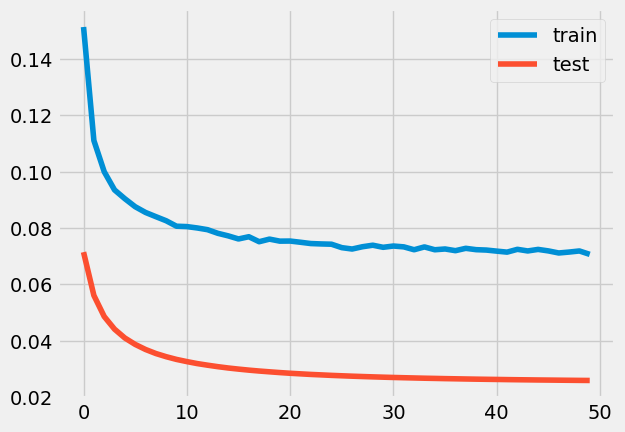

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 66ms/step - loss: 0.2026 - accuracy: 0.0000e+00 - val_loss: 0.0970 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 48ms/step - loss: 0.1277 - accuracy: 0.0000e+00 - val_loss: 0.0700 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

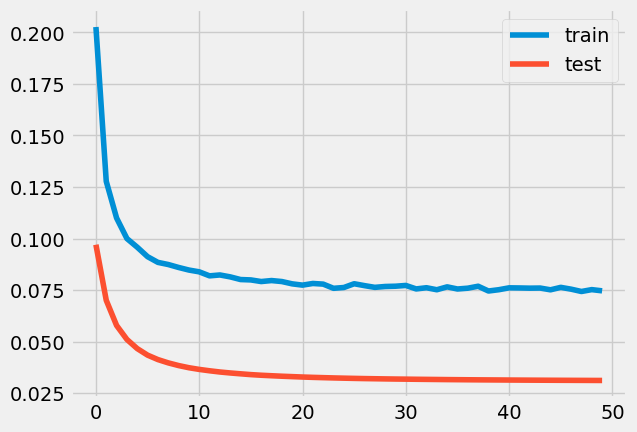

2.2614701233544245e-94
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 3s 77ms/step - loss: 0.2768 - accuracy: 0.0000e+00 - val_loss: 0.1912 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 48ms/step - loss: 0.2135 - accuracy: 0.0000e+00 - val_loss: 0.1611 - val_accuracy: 0.0000

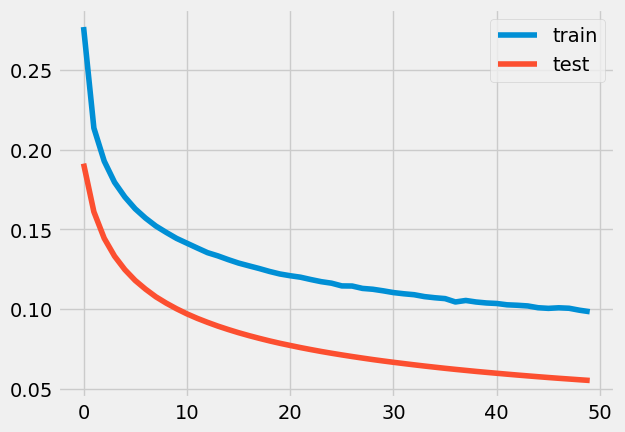

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 3s 78ms/step - loss: 0.1287 - accuracy: 3.5701e-04 - val_loss: 0.0513 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 51ms/step - loss: 0.0943 - accuracy: 0.0014 - val_loss: 0.0395 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [====

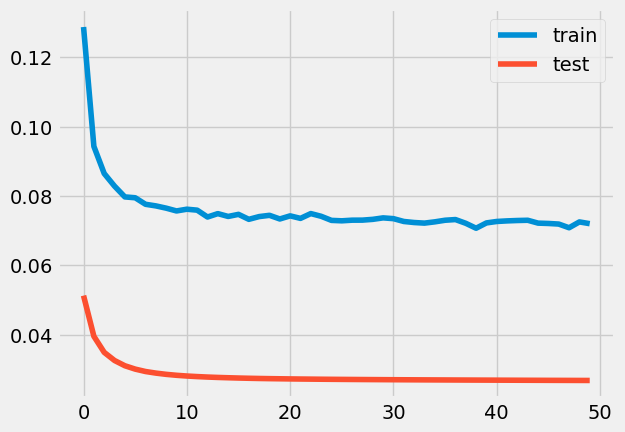

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 3s 78ms/step - loss: 0.3980 - accuracy: 0.0000e+00 - val_loss: 0.3099 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 51ms/step - loss: 0.3175 - accuracy: 0.0000e+00 - val_loss: 0.2698 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [

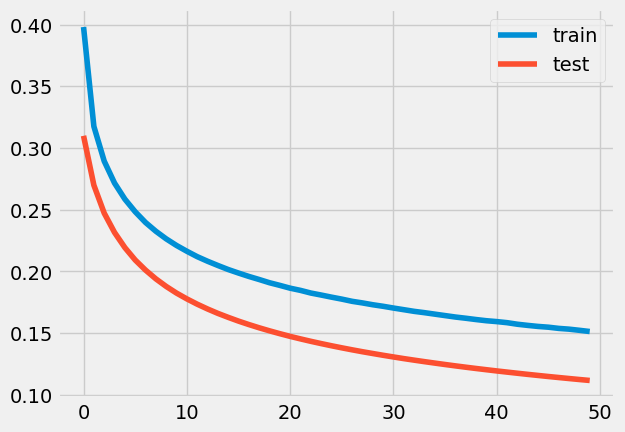

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 3s 73ms/step - loss: 0.1664 - accuracy: 0.0000e+00 - val_loss: 0.0791 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 49ms/step - loss: 0.1163 - accuracy: 1.9286e-05 - val_loss: 0.0597 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 [

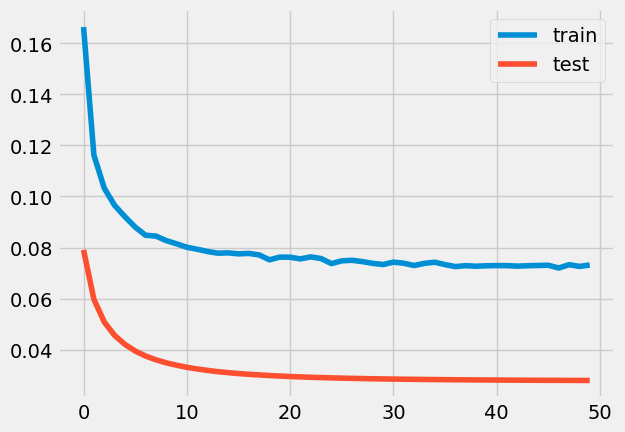

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 3s 74ms/step - loss: 0.1647 - accuracy: 0.0000e+00 - val_loss: 0.0767 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 50ms/step - loss: 0.1131 - accuracy: 3.0858e-05 - val_loss: 0.0574 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 [

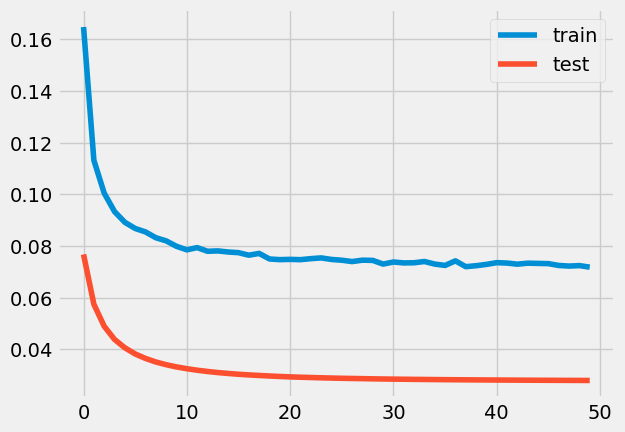

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 3s 80ms/step - loss: 0.1009 - accuracy: 0.0018 - val_loss: 0.0297 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 1s 56ms/step - loss: 0.0778 - accuracy: 0.0035 - val_loss: 0.0263 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16 [========

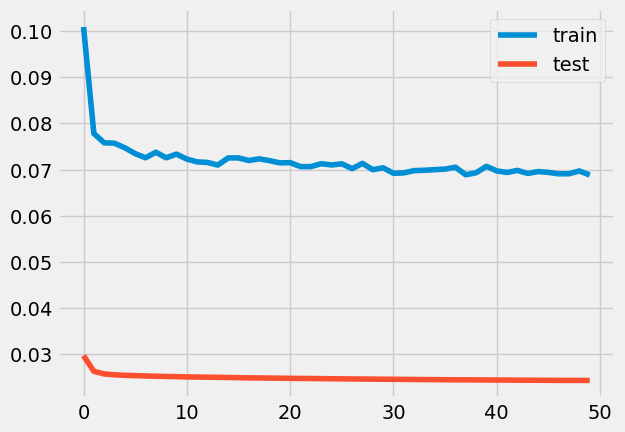

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
16/16 [==============================] - 3s 94ms/step - loss: 0.3559 - accuracy: 0.0000e+00 - val_loss: 0.2645 - val_accuracy: 0.0000e+00
Epoch 2/50
16/16 [==============================] - 1s 66ms/step - loss: 0.2778 - accuracy: 0.0000e+00 - val_loss: 0.2266 - val_accuracy: 0.0000e+00
Epoch 3/50
16/16 [

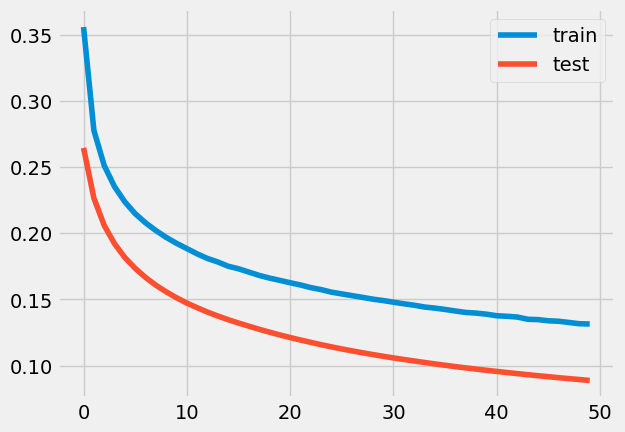

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 85ms/step - loss: 0.1974 - accuracy: 0.0000e+00 - val_loss: 0.1092 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 61ms/step - loss: 0.1436 - accuracy: 0.0000e+00 - val_loss: 0.0876 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

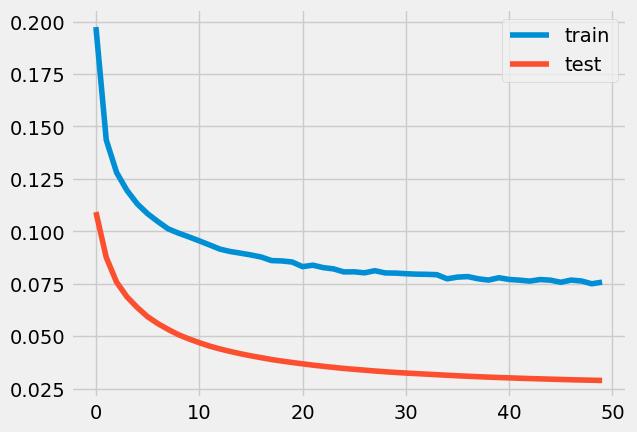

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 79ms/step - loss: 0.0873 - accuracy: 0.0041 - val_loss: 0.0295 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0797 - accuracy: 0.0051 - val_loss: 0.0295 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

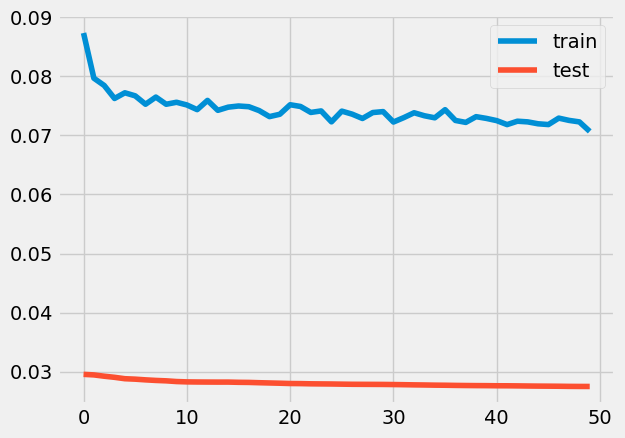

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 50ms/step - loss: 0.1577 - accuracy: 0.0000e+00 - val_loss: 0.0711 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 34ms/step - loss: 0.1076 - accuracy: 2.2248e-04 - val_loss: 0.0525 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

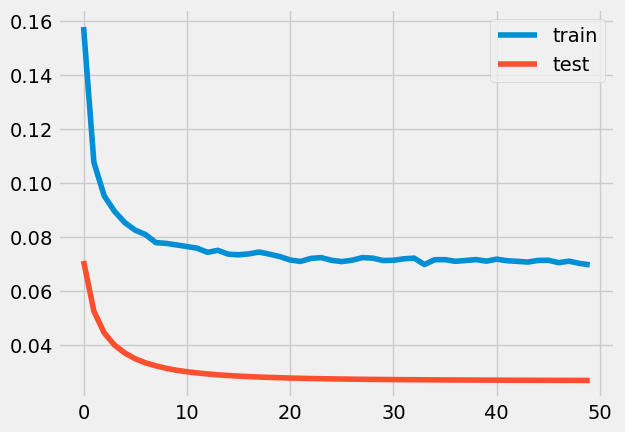

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 51ms/step - loss: 0.2583 - accuracy: 0.0000e+00 - val_loss: 0.1622 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 35ms/step - loss: 0.1859 - accuracy: 0.0000e+00 - val_loss: 0.1310 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

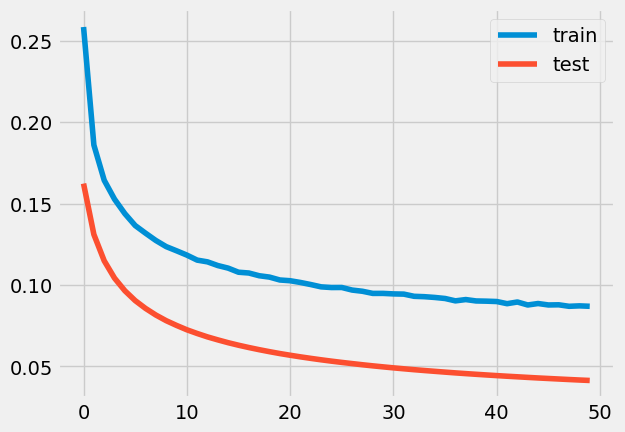

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 50ms/step - loss: 0.2057 - accuracy: 0.0000e+00 - val_loss: 0.1156 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 36ms/step - loss: 0.1458 - accuracy: 0.0000e+00 - val_loss: 0.0912 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

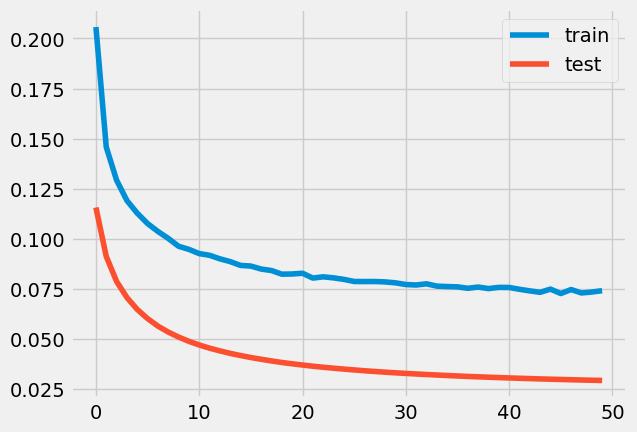

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 50ms/step - loss: 0.1124 - accuracy: 6.9321e-04 - val_loss: 0.0393 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 35ms/step - loss: 0.0839 - accuracy: 0.0029 - val_loss: 0.0320 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [====

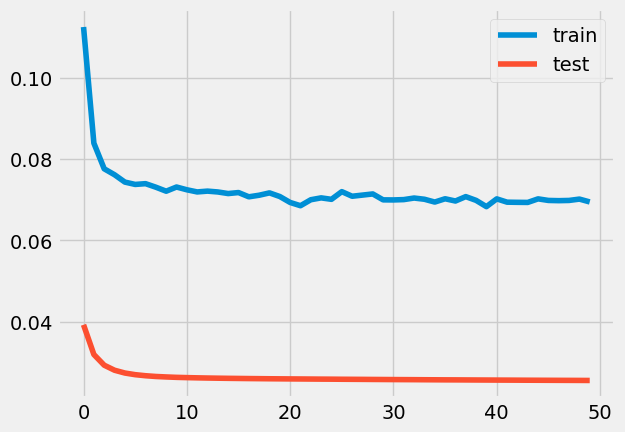

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 2s 52ms/step - loss: 0.2873 - accuracy: 0.0000e+00 - val_loss: 0.1906 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.2132 - accuracy: 0.0000e+00 - val_loss: 0.1573 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

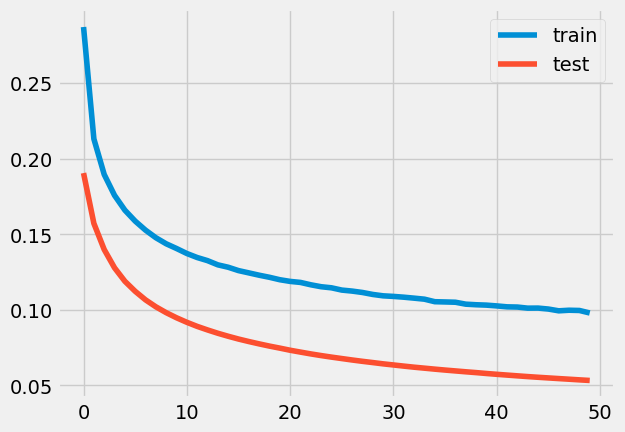

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 49ms/step - loss: 0.2044 - accuracy: 0.0000e+00 - val_loss: 0.1114 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 34ms/step - loss: 0.1416 - accuracy: 0.0000e+00 - val_loss: 0.0852 - val_accuracy: 0.0000e+00
Epoch 3/50
22/

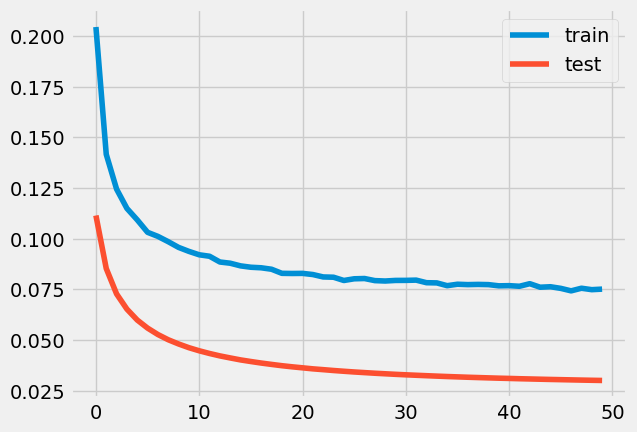

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 2s 45ms/step - loss: 0.3375 - accuracy: 0.0000e+00 - val_loss: 0.2239 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 32ms/step - loss: 0.2345 - accuracy: 0.0000e+00 - val_loss: 0.1800 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

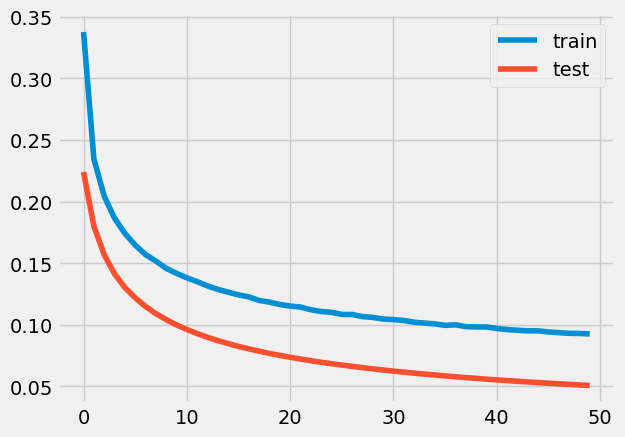

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 48ms/step - loss: 0.1705 - accuracy: 0.0000e+00 - val_loss: 0.0816 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 32ms/step - loss: 0.1159 - accuracy: 2.9806e-05 - val_loss: 0.0604 - val_accuracy: 0.0000e+00
Epoch 3/50
22/

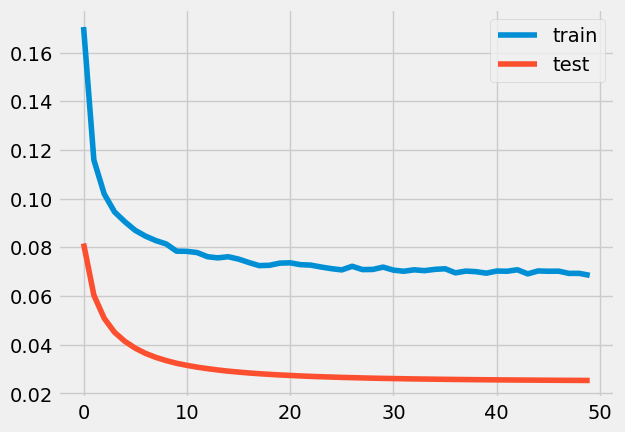

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 2s 45ms/step - loss: 0.1602 - accuracy: 0.0000e+00 - val_loss: 0.0780 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 35ms/step - loss: 0.1149 - accuracy: 3.5768e-05 - val_loss: 0.0607 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

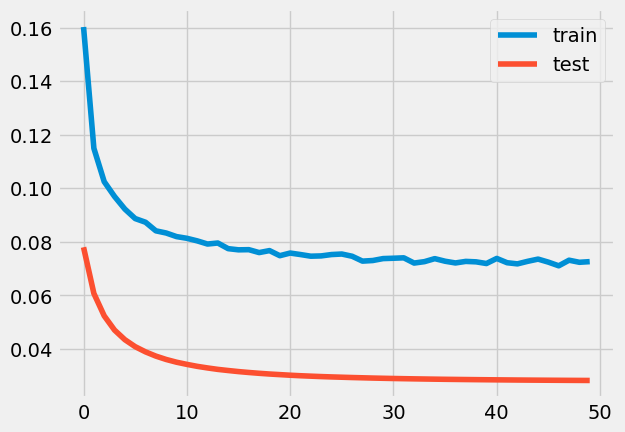

2.322030000870607e-52
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 53ms/step - loss: 0.1279 - accuracy: 1.5457e-04 - val_loss: 0.0501 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 37ms/step - loss: 0.0935 - accuracy: 7.7752e-04 - val_loss: 0.0394 - val_accuracy: 0.0000e

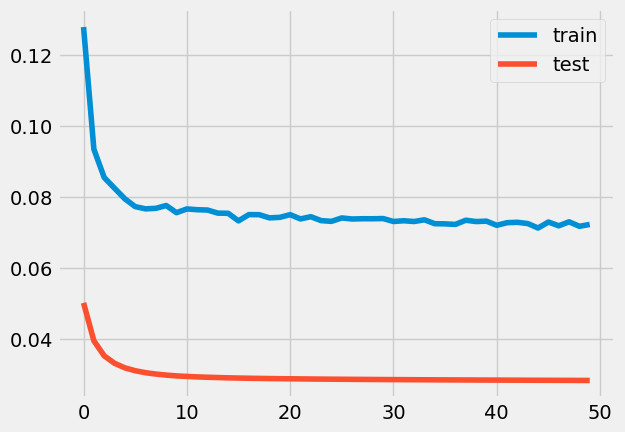

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
18/18 [==============================] - 2s 58ms/step - loss: 0.2426 - accuracy: 0.0000e+00 - val_loss: 0.1416 - val_accuracy: 0.0000e+00
Epoch 2/50
18/18 [==============================] - 1s 40ms/step - loss: 0.1668 - accuracy: 0.0000e+00 - val_loss: 0.1098 - val_accuracy: 0.0000e+00
Epoch 3/50
18/18 [

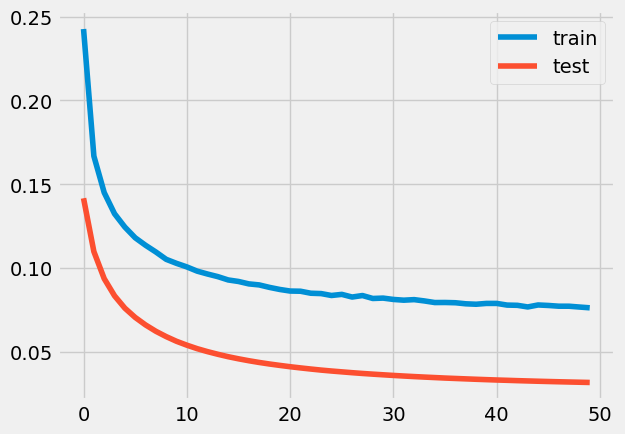

3.278684449760315e-61
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 52ms/step - loss: 0.2083 - accuracy: 0.0000e+00 - val_loss: 0.1219 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 36ms/step - loss: 0.1526 - accuracy: 0.0000e+00 - val_loss: 0.0977 - val_accuracy: 0.0000e

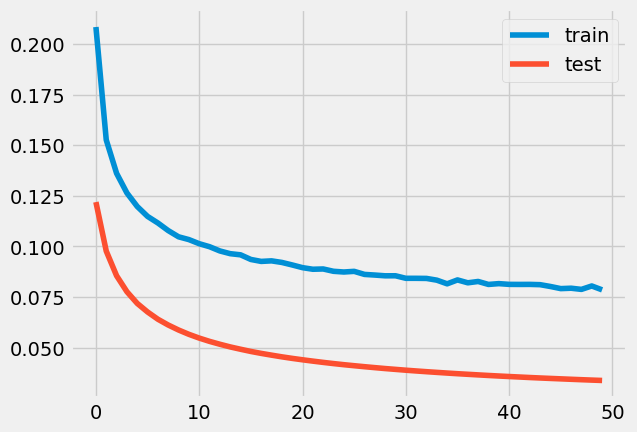

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 3s 46ms/step - loss: 0.2424 - accuracy: 0.0000e+00 - val_loss: 0.1461 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 1s 36ms/step - loss: 0.1682 - accuracy: 0.0000e+00 - val_loss: 0.1133 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [


loss: 3.10%



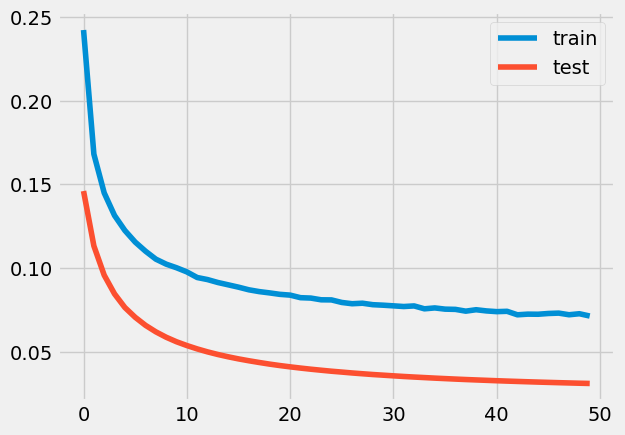

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 3s 46ms/step - loss: 0.2283 - accuracy: 0.0000e+00 - val_loss: 0.1321 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 1s 35ms/step - loss: 0.1579 - accuracy: 0.0000e+00 - val_loss: 0.1027 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

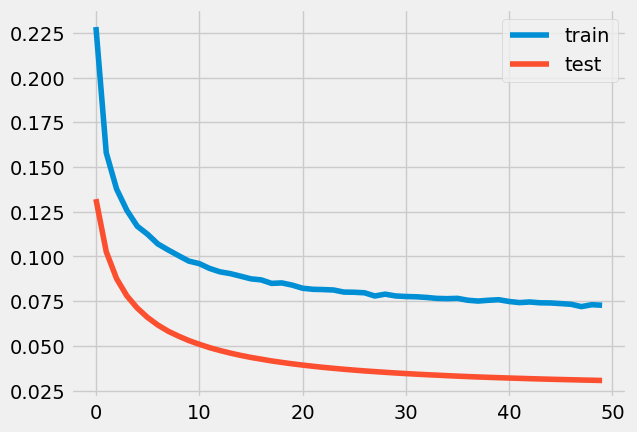

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
31/31 [==============================] - 3s 47ms/step - loss: 0.1410 - accuracy: 2.6230e-05 - val_loss: 0.0617 - val_accuracy: 0.0000e+00
Epoch 2/50
31/31 [==============================] - 1s 35ms/step - loss: 0.1015 - accuracy: 8.0000e-04 - val_loss: 0.0471 - val_accuracy: 0.0000e+00
Epoch 3/50
31/31 [

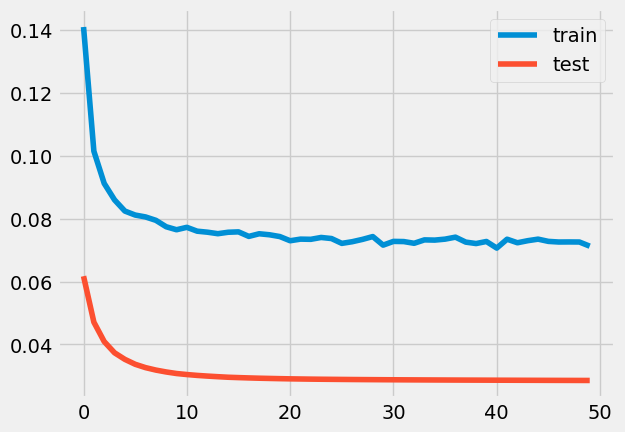

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 51ms/step - loss: 0.1849 - accuracy: 0.0000e+00 - val_loss: 0.0936 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 35ms/step - loss: 0.1264 - accuracy: 0.0000e+00 - val_loss: 0.0714 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

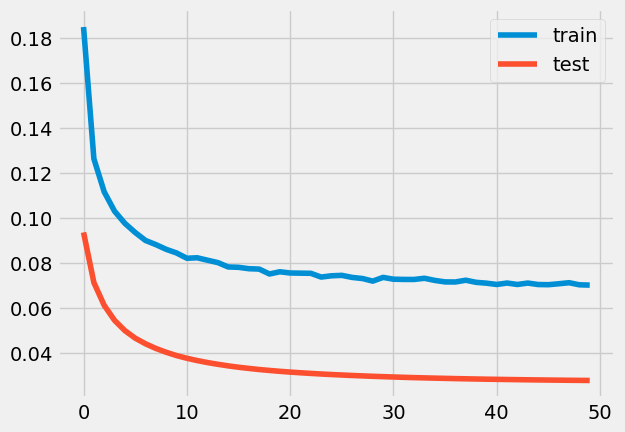

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 2s 49ms/step - loss: 0.1149 - accuracy: 8.3060e-04 - val_loss: 0.0403 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 36ms/step - loss: 0.0860 - accuracy: 0.0029 - val_loss: 0.0334 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [====

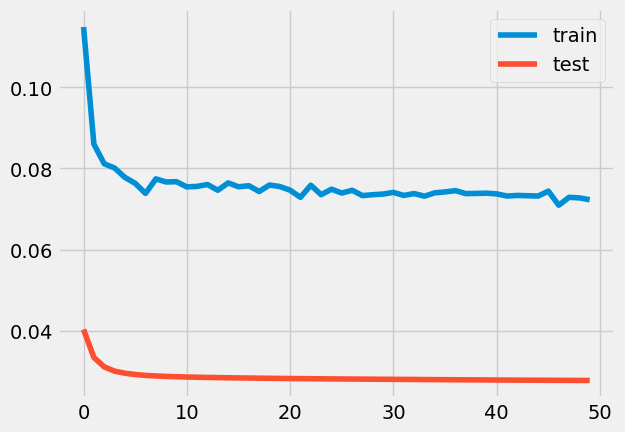

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 2s 49ms/step - loss: 0.1453 - accuracy: 0.0000e+00 - val_loss: 0.0621 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 36ms/step - loss: 0.0997 - accuracy: 6.0109e-04 - val_loss: 0.0466 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

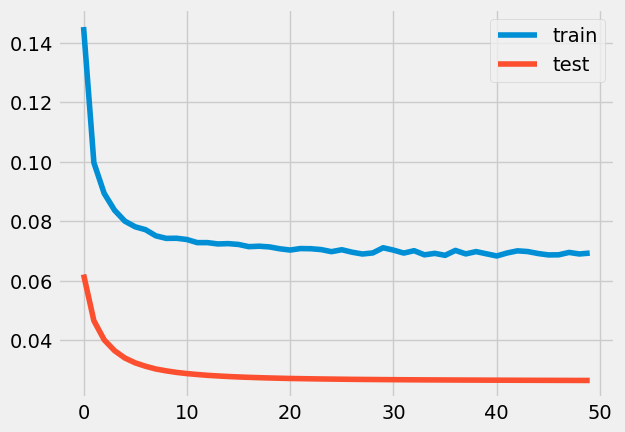

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 2s 49ms/step - loss: 0.1585 - accuracy: 0.0000e+00 - val_loss: 0.0766 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 36ms/step - loss: 0.1133 - accuracy: 1.6393e-05 - val_loss: 0.0586 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

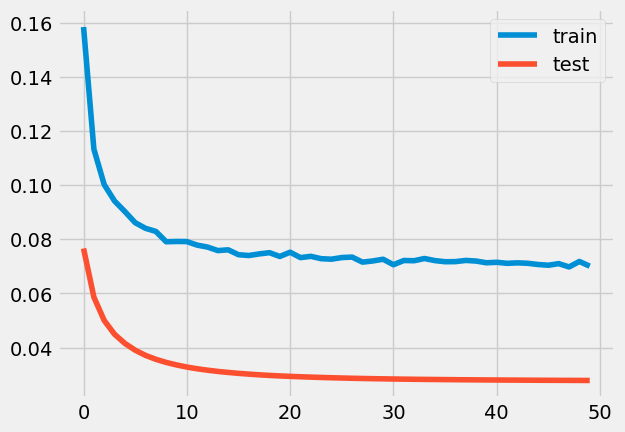

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 2s 49ms/step - loss: 0.1630 - accuracy: 0.0000e+00 - val_loss: 0.0775 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 34ms/step - loss: 0.1147 - accuracy: 2.7322e-05 - val_loss: 0.0595 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

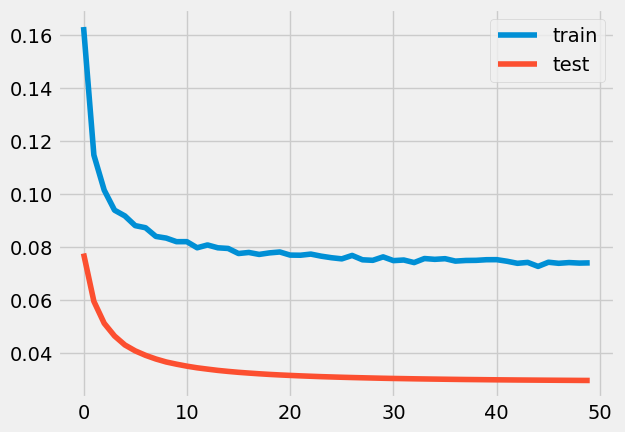

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 2s 49ms/step - loss: 0.1976 - accuracy: 0.0000e+00 - val_loss: 0.1056 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 35ms/step - loss: 0.1365 - accuracy: 0.0000e+00 - val_loss: 0.0811 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

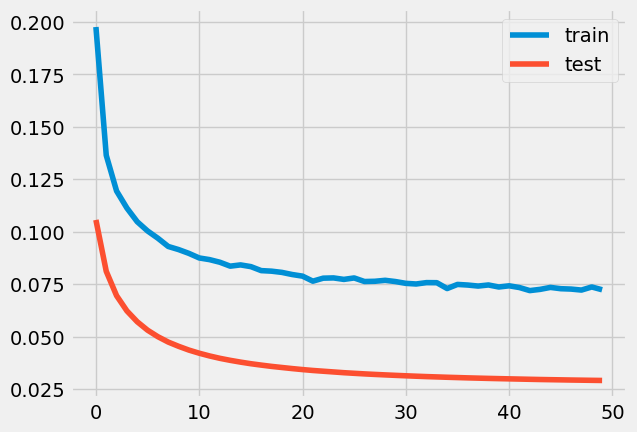

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 2s 50ms/step - loss: 0.1767 - accuracy: 0.0000e+00 - val_loss: 0.0862 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 36ms/step - loss: 0.1203 - accuracy: 0.0000e+00 - val_loss: 0.0650 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

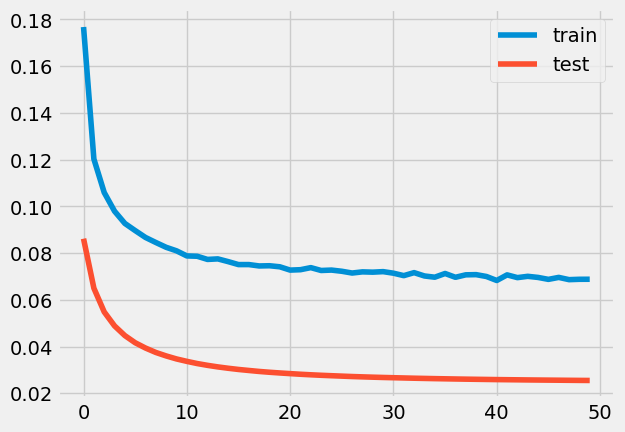

1.220703125e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 2s 50ms/step - loss: 0.2003 - accuracy: 0.0000e+00 - val_loss: 0.1099 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 36ms/step - loss: 0.1420 - accuracy: 0.0000e+00 - val_loss: 0.0869 - val_accuracy: 0.0000e+00
Ep

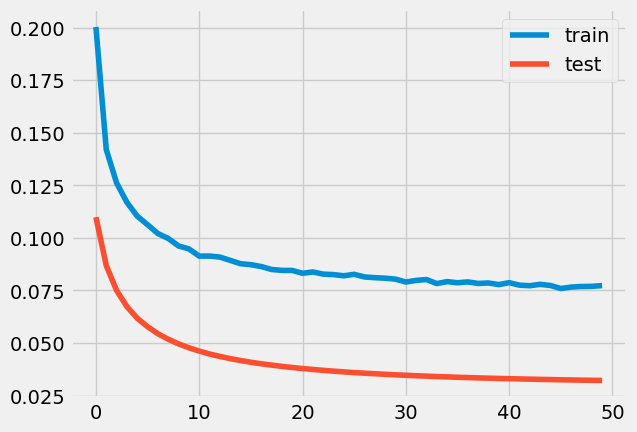

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 51ms/step - loss: 0.1132 - accuracy: 4.4496e-04 - val_loss: 0.0407 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 36ms/step - loss: 0.0849 - accuracy: 0.0021 - val_loss: 0.0326 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [====

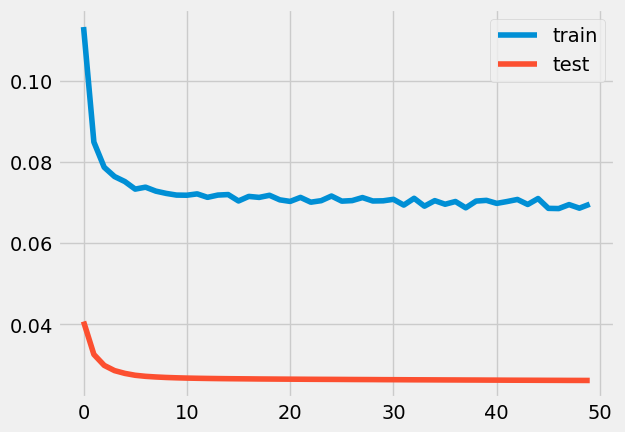

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 52ms/step - loss: 0.2344 - accuracy: 0.0000e+00 - val_loss: 0.1428 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 34ms/step - loss: 0.1700 - accuracy: 0.0000e+00 - val_loss: 0.1152 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

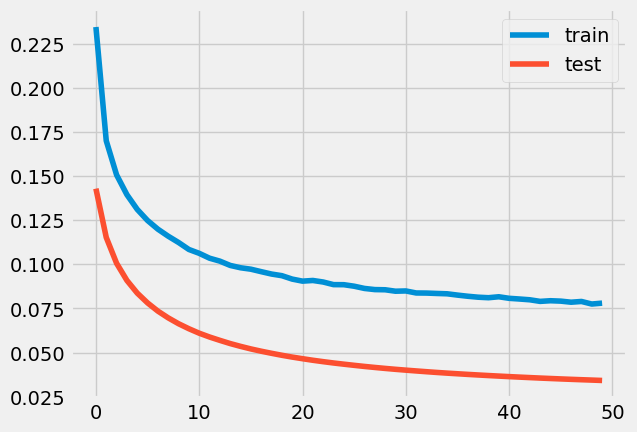

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 2s 55ms/step - loss: 0.2552 - accuracy: 0.0000e+00 - val_loss: 0.1631 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.1889 - accuracy: 0.0000e+00 - val_loss: 0.1333 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

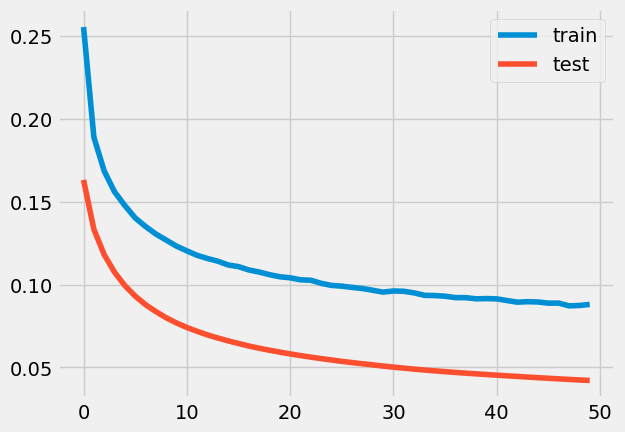

2.1488136991612883e-284
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 53ms/step - loss: 0.2643 - accuracy: 0.0000e+00 - val_loss: 0.1668 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 37ms/step - loss: 0.1889 - accuracy: 0.0000e+00 - val_loss: 0.1336 - val_accuracy: 0.000

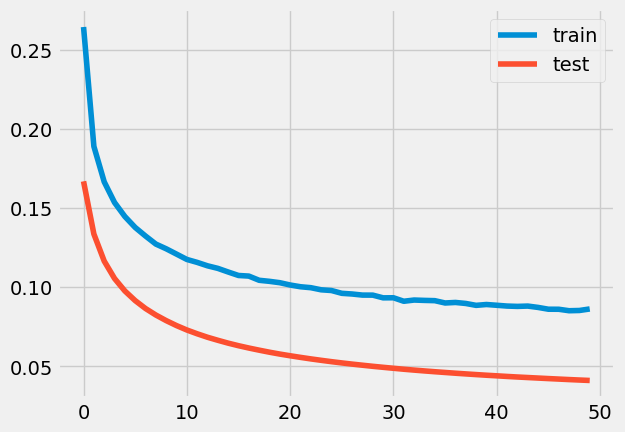

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 52ms/step - loss: 0.2179 - accuracy: 0.0000e+00 - val_loss: 0.1193 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 36ms/step - loss: 0.1491 - accuracy: 0.0000e+00 - val_loss: 0.0937 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

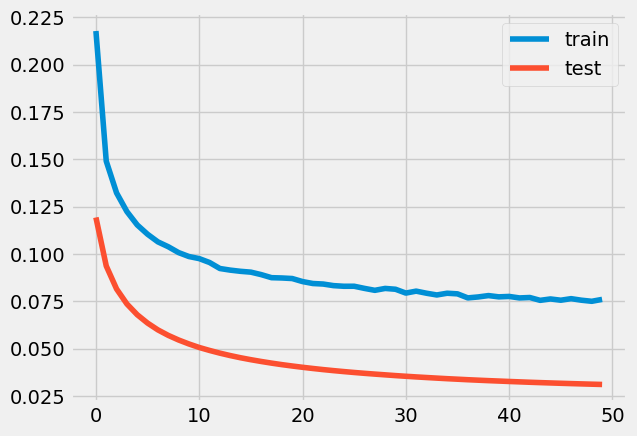

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 50ms/step - loss: 0.2056 - accuracy: 0.0000e+00 - val_loss: 0.1190 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 34ms/step - loss: 0.1484 - accuracy: 0.0000e+00 - val_loss: 0.0931 - val_accuracy: 0.0000e+00
Epoch 3/50
22/22 [

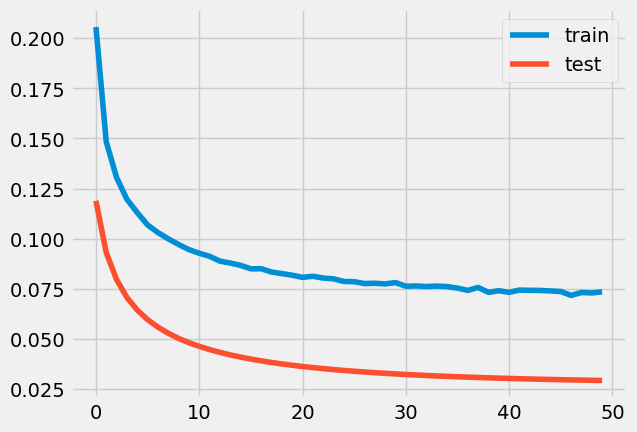

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 47ms/step - loss: 0.2391 - accuracy: 0.0000e+00 - val_loss: 0.1425 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 35ms/step - loss: 0.1679 - accuracy: 0.0000e+00 - val_loss: 0.1132 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [


loss: 3.63%



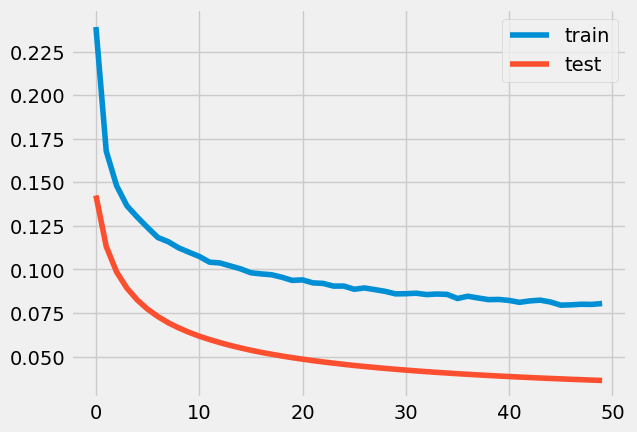

1.7970939960584648e-246
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
22/22 [==============================] - 2s 53ms/step - loss: 0.1867 - accuracy: 0.0000e+00 - val_loss: 0.1007 - val_accuracy: 0.0000e+00
Epoch 2/50
22/22 [==============================] - 1s 37ms/step - loss: 0.1348 - accuracy: 0.0000e+00 - val_loss: 0.0797 - val_accuracy: 0.000

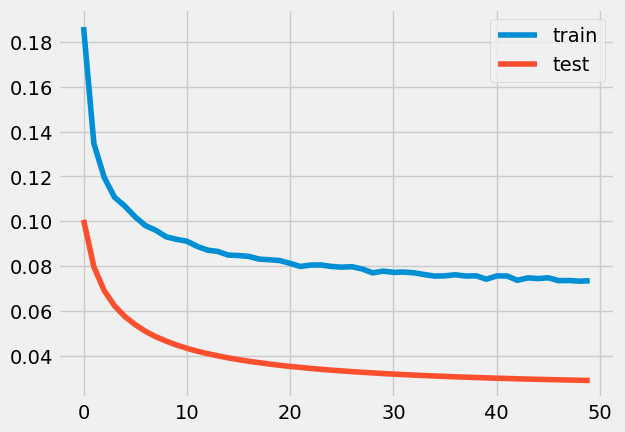

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 2s 61ms/step - loss: 0.1824 - accuracy: 0.0000e+00 - val_loss: 0.0983 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 39ms/step - loss: 0.1336 - accuracy: 0.0000e+00 - val_loss: 0.0772 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [

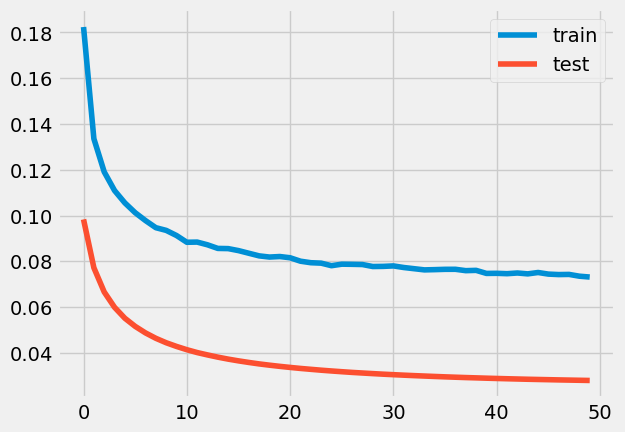

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 2s 61ms/step - loss: 0.1333 - accuracy: 7.2860e-06 - val_loss: 0.0540 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 39ms/step - loss: 0.0969 - accuracy: 7.1767e-04 - val_loss: 0.0417 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [

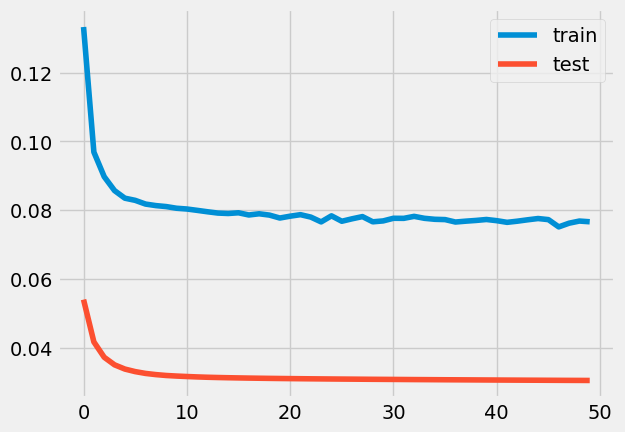

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 2s 59ms/step - loss: 0.2481 - accuracy: 0.0000e+00 - val_loss: 0.1464 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 39ms/step - loss: 0.1728 - accuracy: 0.0000e+00 - val_loss: 0.1156 - val_accuracy: 0.0000e+00
Epoch 3/50
17/17 [


loss: 3.56%



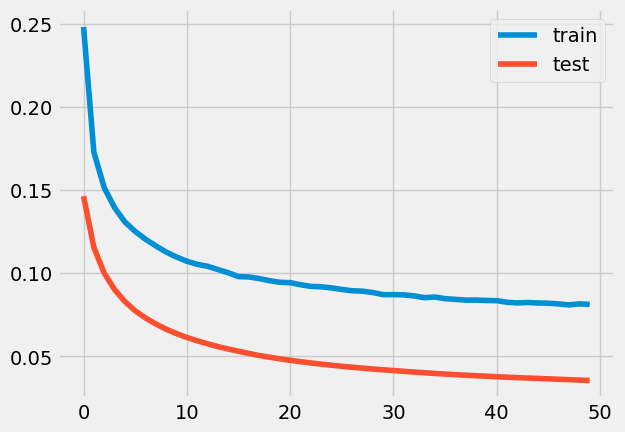

2.4397479916101186e-181
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
17/17 [==============================] - 2s 62ms/step - loss: 0.2886 - accuracy: 0.0000e+00 - val_loss: 0.2059 - val_accuracy: 0.0000e+00
Epoch 2/50
17/17 [==============================] - 1s 40ms/step - loss: 0.2296 - accuracy: 0.0000e+00 - val_loss: 0.1788 - val_accuracy: 0.000

17/17 [==============================] - 1s 40ms/step - loss: 0.1195 - accuracy: 0.0000e+00 - val_loss: 0.0752 - val_accuracy: 0.0000e+00

loss: 7.52%



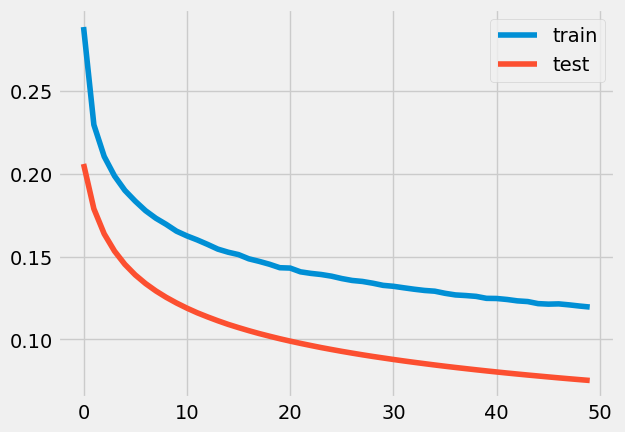

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 2s 51ms/step - loss: 0.1380 - accuracy: 0.0000e+00 - val_loss: 0.0540 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 34ms/step - loss: 0.0964 - accuracy: 0.0012 - val_loss: 0.0412 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [====

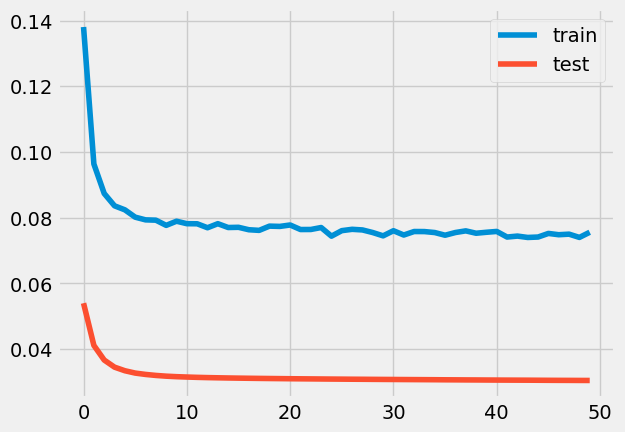

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 2s 50ms/step - loss: 0.1290 - accuracy: 5.6831e-05 - val_loss: 0.0492 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 33ms/step - loss: 0.0909 - accuracy: 8.0000e-04 - val_loss: 0.0371 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [

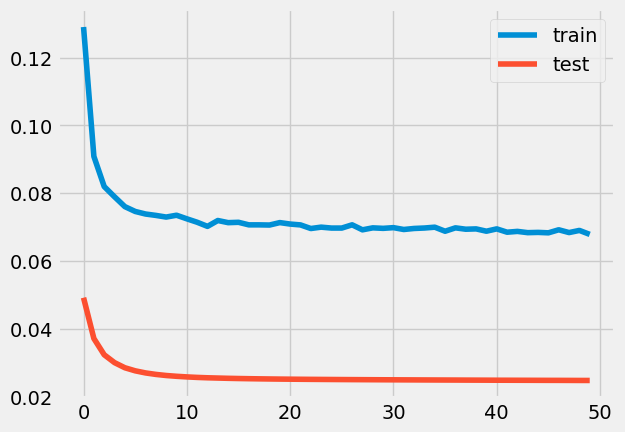

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 47ms/step - loss: 0.3479 - accuracy: 0.0000e+00 - val_loss: 0.2477 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 35ms/step - loss: 0.2574 - accuracy: 0.0000e+00 - val_loss: 0.2054 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

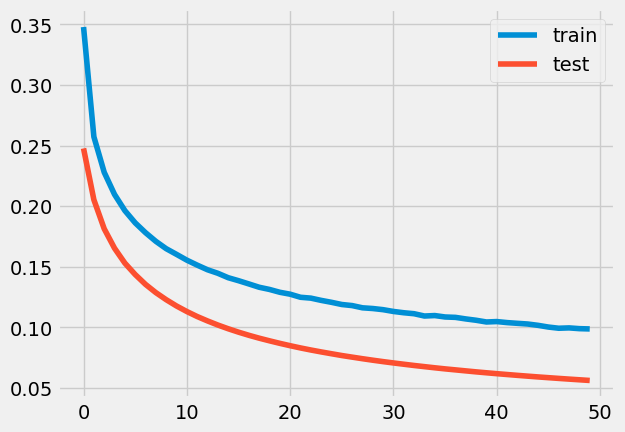

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 2s 52ms/step - loss: 0.2623 - accuracy: 0.0000e+00 - val_loss: 0.1595 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 36ms/step - loss: 0.1814 - accuracy: 0.0000e+00 - val_loss: 0.1271 - val_accuracy: 0.0000e+00
Epoch 3/50
21/

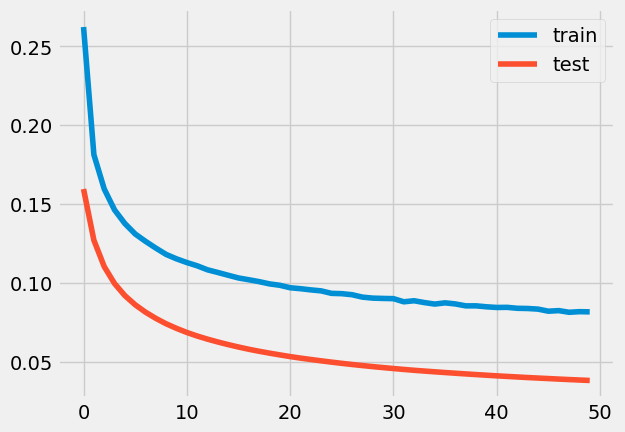

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 2s 46ms/step - loss: 0.1310 - accuracy: 4.9454e-04 - val_loss: 0.0507 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 32ms/step - loss: 0.0911 - accuracy: 0.0018 - val_loss: 0.0390 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [====

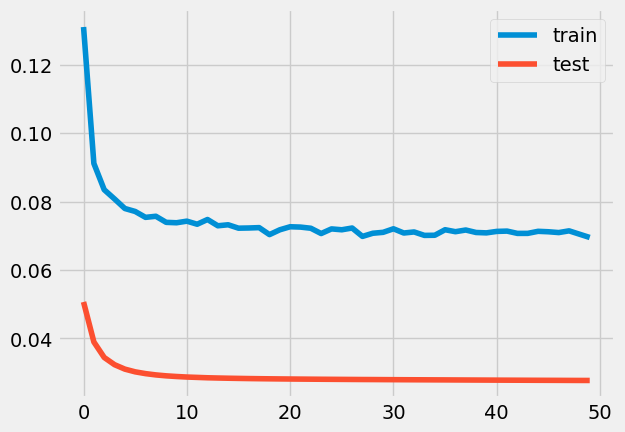

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 2s 45ms/step - loss: 0.2049 - accuracy: 0.0000e+00 - val_loss: 0.1159 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 30ms/step - loss: 0.1490 - accuracy: 0.0000e+00 - val_loss: 0.0925 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

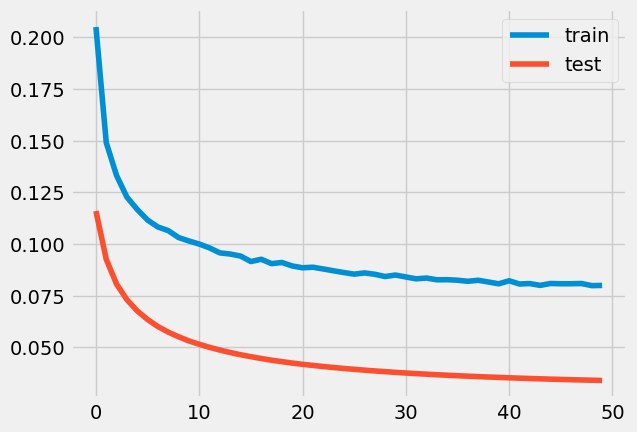

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 2s 57ms/step - loss: 0.1305 - accuracy: 0.0000e+00 - val_loss: 0.0488 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0934 - accuracy: 0.0012 - val_loss: 0.0380 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

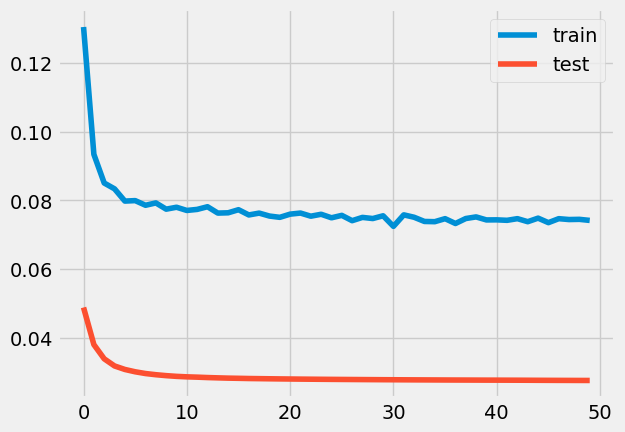

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 2s 55ms/step - loss: 0.1352 - accuracy: 2.3156e-04 - val_loss: 0.0518 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0930 - accuracy: 0.0011 - val_loss: 0.0391 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

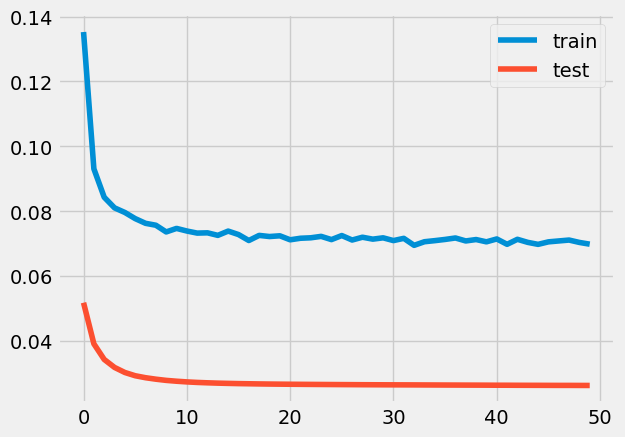

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 2s 47ms/step - loss: 0.3391 - accuracy: 0.0000e+00 - val_loss: 0.2335 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 33ms/step - loss: 0.2445 - accuracy: 0.0000e+00 - val_loss: 0.1916 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

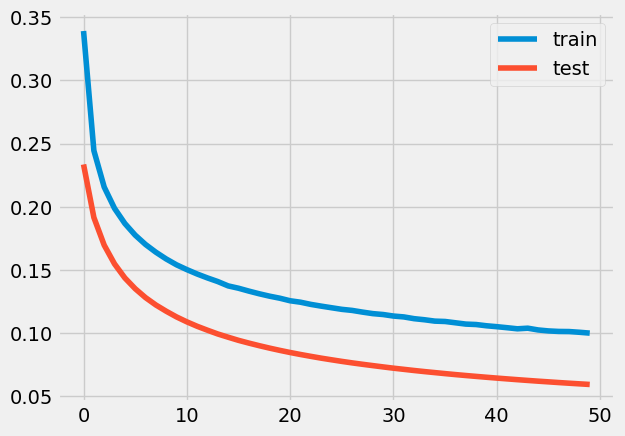

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 2s 53ms/step - loss: 0.2346 - accuracy: 0.0000e+00 - val_loss: 0.1332 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.1616 - accuracy: 0.0000e+00 - val_loss: 0.1035 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

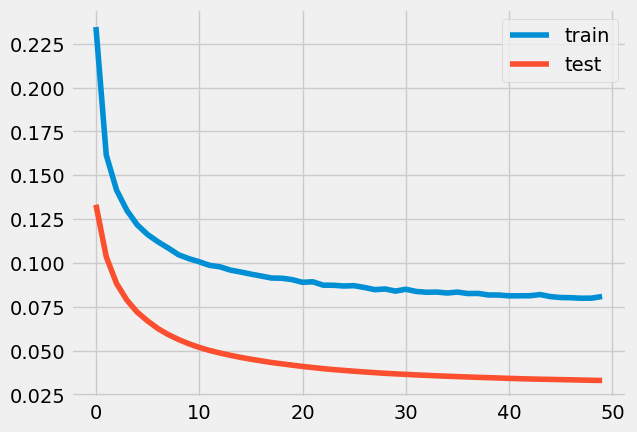

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 2s 55ms/step - loss: 0.1637 - accuracy: 0.0000e+00 - val_loss: 0.0711 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.1075 - accuracy: 2.0082e-04 - val_loss: 0.0512 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

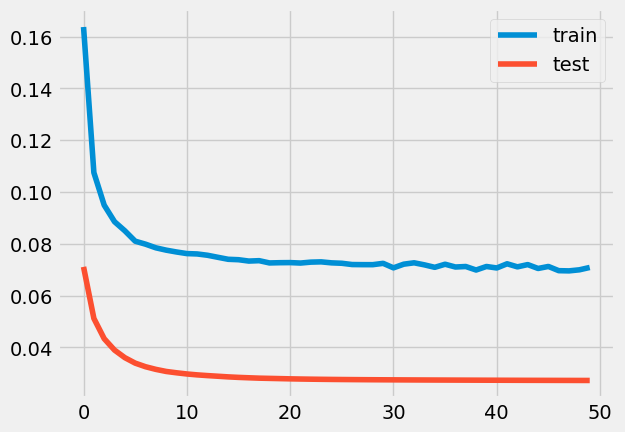

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 2s 54ms/step - loss: 0.1308 - accuracy: 3.7705e-04 - val_loss: 0.0415 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0838 - accuracy: 0.0026 - val_loss: 0.0325 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

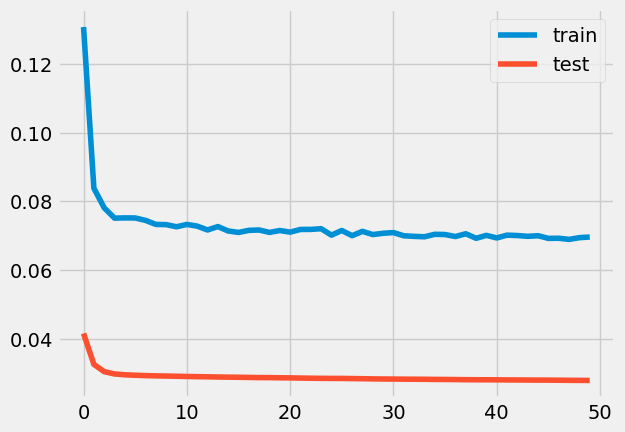

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 2s 45ms/step - loss: 0.1149 - accuracy: 1.0929e-04 - val_loss: 0.0435 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 31ms/step - loss: 0.0870 - accuracy: 0.0017 - val_loss: 0.0354 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [====

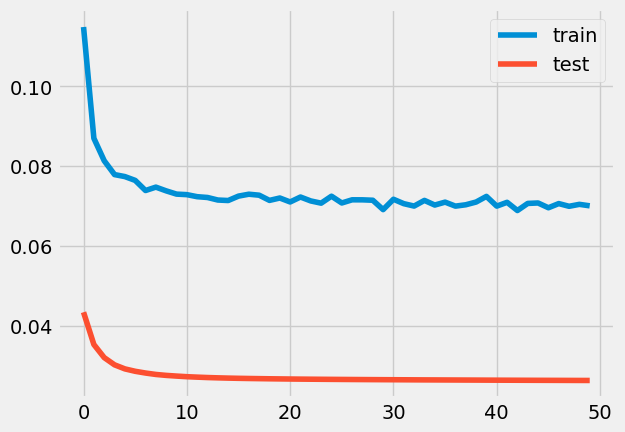

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 65ms/step - loss: 0.1339 - accuracy: 3.2787e-05 - val_loss: 0.0587 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 48ms/step - loss: 0.0994 - accuracy: 4.0710e-04 - val_loss: 0.0464 - val_accuracy: 0.0000e+00
Epoch 3/50
26/26 [

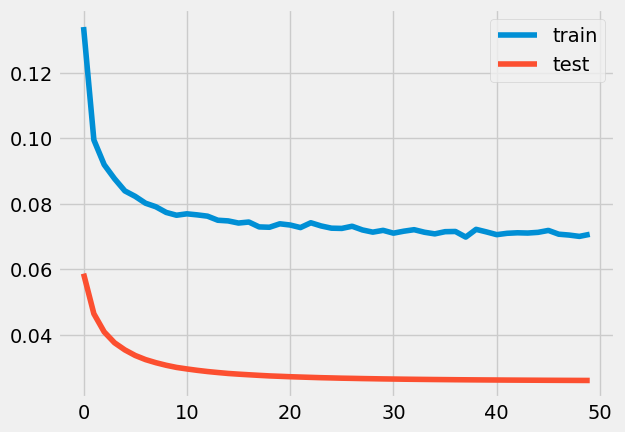

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
24/24 [==============================] - 3s 68ms/step - loss: 0.2736 - accuracy: 0.0000e+00 - val_loss: 0.1863 - val_accuracy: 0.0000e+00
Epoch 2/50
24/24 [==============================] - 1s 46ms/step - loss: 0.2098 - accuracy: 0.0000e+00 - val_loss: 0.1571 - val_accuracy: 0.0000e+00
Epoch 3/50
24/24 [

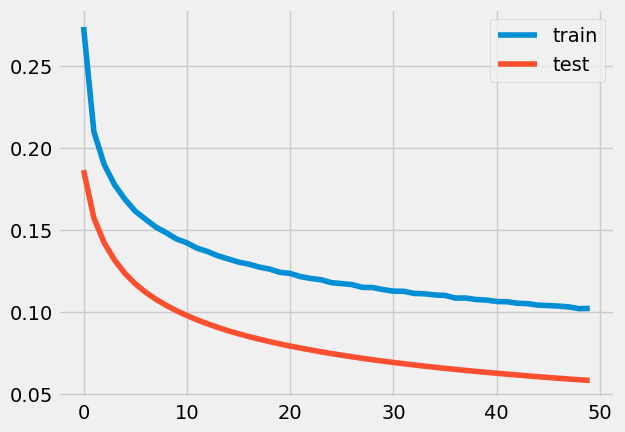

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 65ms/step - loss: 0.1721 - accuracy: 0.0000e+00 - val_loss: 0.0856 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 48ms/step - loss: 0.1213 - accuracy: 0.0000e+00 - val_loss: 0.0654 - val_accuracy: 0.0000e+00
Epoch 3/50
26/

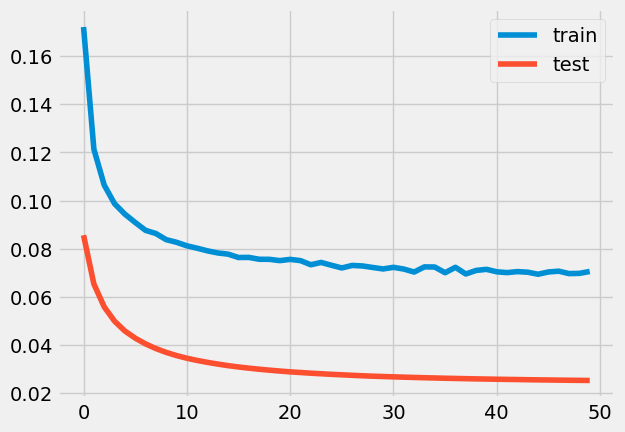

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 76ms/step - loss: 0.1136 - accuracy: 0.0011 - val_loss: 0.0352 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0797 - accuracy: 0.0051 - val_loss: 0.0293 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

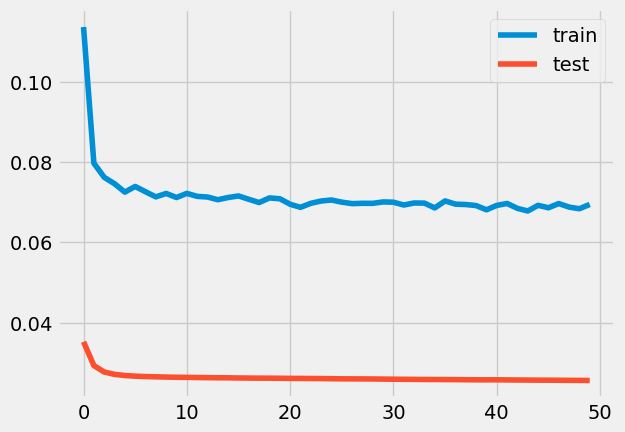

6.876896556320287e-11
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
26/26 [==============================] - 3s 65ms/step - loss: 0.1500 - accuracy: 0.0000e+00 - val_loss: 0.0616 - val_accuracy: 0.0000e+00
Epoch 2/50
26/26 [==============================] - 1s 44ms/step - loss: 0.0994 - accuracy: 7.6776e-04 - val_loss: 0.0457 - val_accuracy: 0.0000e

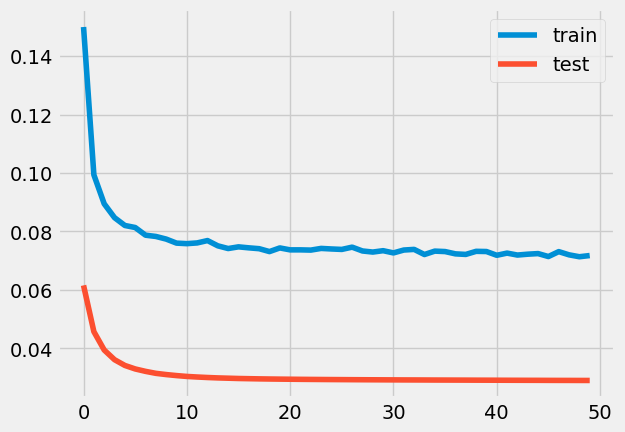

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 62ms/step - loss: 0.0867 - accuracy: 0.0030 - val_loss: 0.0290 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 47ms/step - loss: 0.0743 - accuracy: 0.0050 - val_loss: 0.0289 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [========

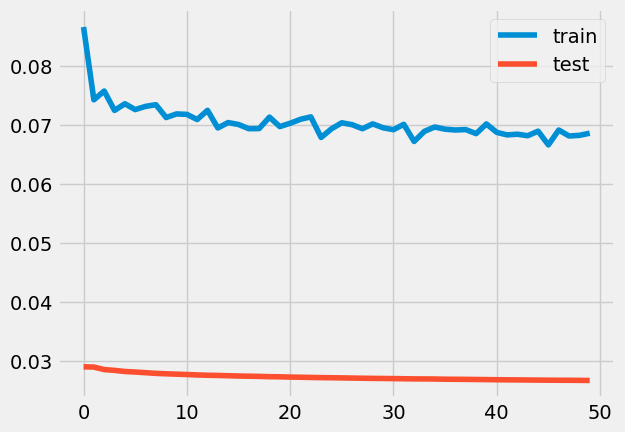

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 64ms/step - loss: 0.2619 - accuracy: 0.0000e+00 - val_loss: 0.1614 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 47ms/step - loss: 0.1848 - accuracy: 0.0000e+00 - val_loss: 0.1300 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [


loss: 3.72%



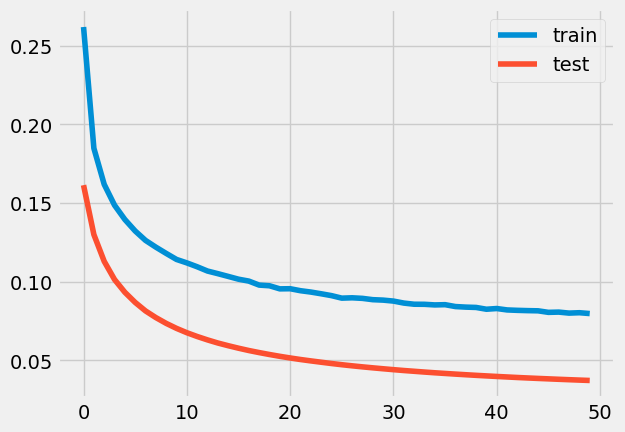

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 64ms/step - loss: 0.2120 - accuracy: 0.0000e+00 - val_loss: 0.1157 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 46ms/step - loss: 0.1434 - accuracy: 0.0000e+00 - val_loss: 0.0883 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

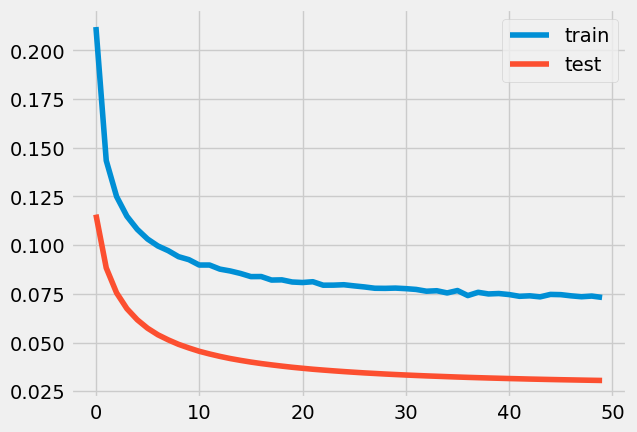

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
28/28 [==============================] - 3s 58ms/step - loss: 0.1678 - accuracy: 0.0000e+00 - val_loss: 0.0775 - val_accuracy: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 1s 44ms/step - loss: 0.1095 - accuracy: 1.1923e-05 - val_loss: 0.0556 - val_accuracy: 0.0000e+00
Epoch 3/50
28/28 [

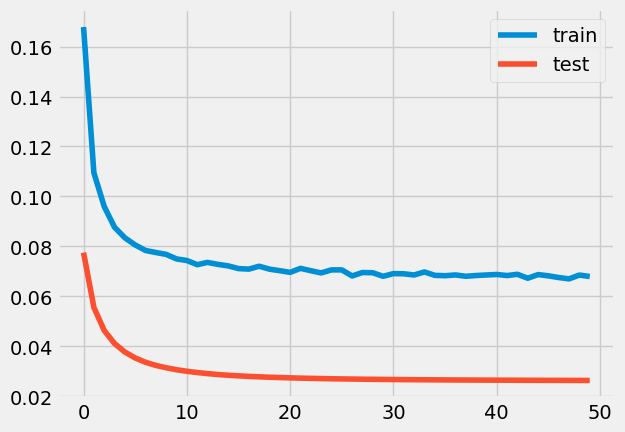

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 3s 74ms/step - loss: 0.1649 - accuracy: 0.0000e+00 - val_loss: 0.0758 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 49ms/step - loss: 0.1116 - accuracy: 1.0055e-04 - val_loss: 0.0558 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [

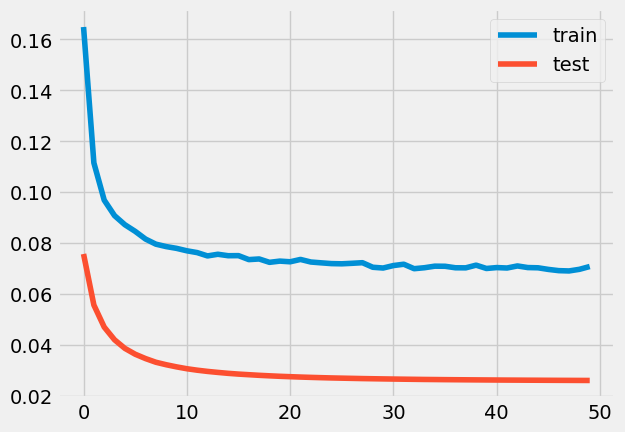

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 3s 71ms/step - loss: 0.1073 - accuracy: 0.0014 - val_loss: 0.0358 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 52ms/step - loss: 0.0826 - accuracy: 0.0039 - val_loss: 0.0305 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [========

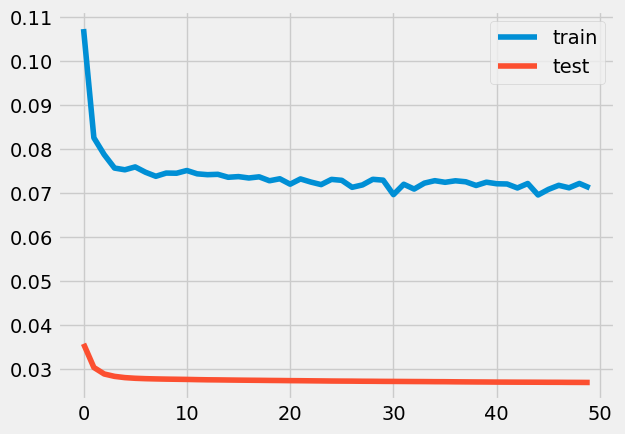

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 3s 69ms/step - loss: 0.2157 - accuracy: 0.0000e+00 - val_loss: 0.1206 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 48ms/step - loss: 0.1510 - accuracy: 0.0000e+00 - val_loss: 0.0937 - val_accuracy: 0.0000e+00
Epoch 3/50
21/21 [

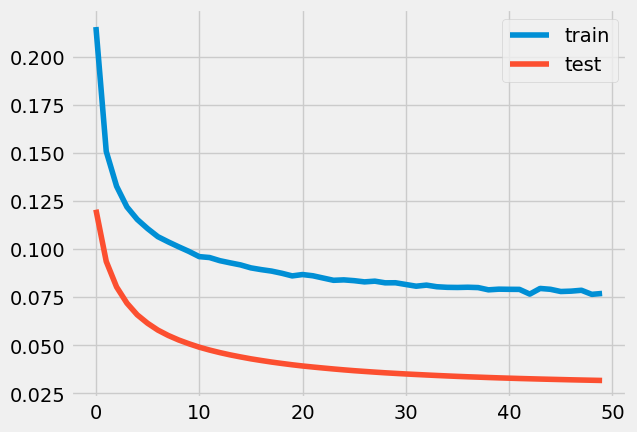

5.607434701566454e-167
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
21/21 [==============================] - 3s 70ms/step - loss: 0.2002 - accuracy: 0.0000e+00 - val_loss: 0.1016 - val_accuracy: 0.0000e+00
Epoch 2/50
21/21 [==============================] - 1s 46ms/step - loss: 0.1319 - accuracy: 0.0000e+00 - val_loss: 0.0758 - val_accuracy: 0.0000

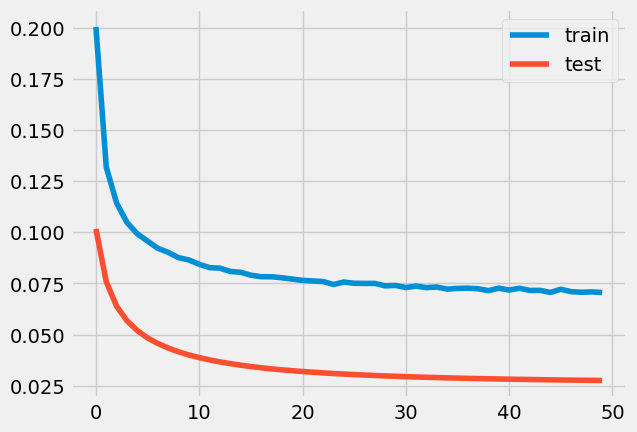

15 0.02754848077893257
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 2

In [18]:
T =0.1 # initiate temperature
Tmin =0.00001 # minimum value of terperature
x = np.random.randint(low=10, high=100)  # initiate x
k = 20  # times of internal circulation
y = 0  # initiate result
t = 0  # time

history = {'y': [], 'iteration': [], 'x': [], 'p': []}

while T >= Tmin:
    print(T)
    for i in range(k):
        history["iteration"].append(t)
        # calculate y
        y = fitness(x)
        history["y"].append(y)
        # generate a new x in the neighboorhood of x by transform function
        xNew = np.abs(x + np.random.randint(low=-5, high=5))
        if (10 <= xNew and xNew <= 100):
            yNew = fitness(xNew)
            if yNew - y < 0:
                x = xNew
                history["x"].append(x)
            else:
                # metropolis principle
                p = math.exp(-(yNew - y) / T)
                print(p)
                history["p"].append(p)
                r = np.random.uniform(low=0, high=1)
                if r < p:
                    x = xNew
        t += 1
    T = 0.5*T  #降温函数，也可使用T=0.9T或TK=λTK-1,λ取值一般在0.8~0.99

print(x,fitness(x))  

print(history["iteration"])
print(history["y"])
print(history["x"])



In [19]:
history

{'y': [0.06360682100057602,
  0.05471070483326912,
  0.06062885746359825,
  0.0248155128210783,
  0.024619359523057938,
  0.02664436399936676,
  0.029349714517593384,
  0.029423383995890617,
  0.029362833127379417,
  0.027175698429346085,
  0.025745972990989685,
  0.03281047195196152,
  0.05004942789673805,
  0.04629037529230118,
  0.0403166338801384,
  0.02672991342842579,
  0.05622734874486923,
  0.042880114167928696,
  0.026629293337464333,
  0.02933482639491558,
  0.04461376741528511,
  0.026514096185564995,
  0.037300415337085724,
  0.03234986960887909,
  0.030350740998983383,
  0.04554281383752823,
  0.02777433581650257,
  0.07019606977701187,
  0.027296477928757668,
  0.03584003448486328,
  0.027827171608805656,
  0.02771875448524952,
  0.029066504910588264,
  0.02791115827858448,
  0.029701419174671173,
  0.11198025196790695,
  0.030248679220676422,
  0.06063413619995117,
  0.026328273117542267,
  0.03157076984643936,
  0.037634048610925674,
  0.0710892304778099,
  0.0289224032

In [20]:
output = pd.DataFrame(history['y'],history['iteration'])
output.to_csv('SA_BZ.csv', index = None, encoding = "utf-8_sig", header = None)

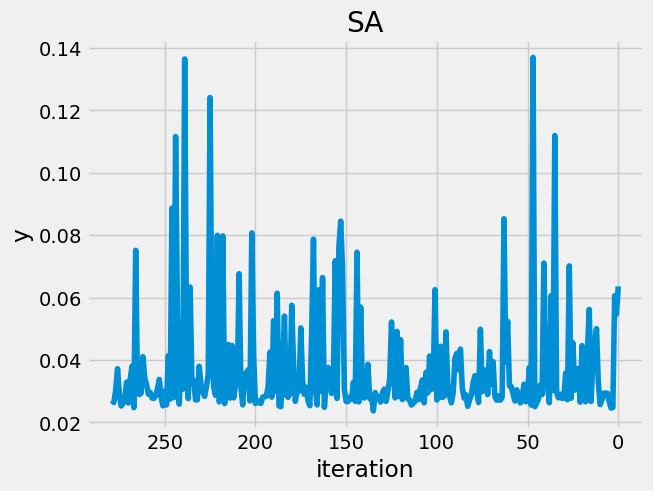

In [25]:
plt.plot(history['iteration'], history['y'])
plt.title('SA')
plt.xlabel('iteration')
plt.ylabel('y')
plt.gca().invert_xaxis()
plt.show()